In [1]:
import numpy as np
import pandas as pd
from datetime import datetime
import matplotlib.pyplot as plt
import pylab
from sklearn.cluster import KMeans
#from fcmeans import FCM
from scipy import interpolate
from statsmodels.tsa.arima.model import ARIMA 

In [2]:
path = 'Downloads\iqds\iqds'
'''
case.csv – таблица с описанием подтверждённых аномалий. Содержит информацию по связанному с аномалией оборудованию ("equipment_id") и объекту ("facility_id").
equipment.csv – таблица, показывающая из каких датчиков ("io_id") состоит оборудование.
facility.csv – таблица, показывающая из каких датчиков микроклимата ("io_id") состоит объект.
*_ data_meter_*.csv – таблицы, содержащие данные для соответствующих датчиков.
'''

'\ncase.csv – таблица с описанием подтверждённых аномалий. Содержит информацию по связанному с аномалией оборудованию ("equipment_id") и объекту ("facility_id").\nequipment.csv – таблица, показывающая из каких датчиков ("io_id") состоит оборудование.\nfacility.csv – таблица, показывающая из каких датчиков микроклимата ("io_id") состоит объект.\n*_ data_meter_*.csv – таблицы, содержащие данные для соответствующих датчиков.\n'

In [2]:
elec = pd.read_csv('Downloads/iqds/iqds/0_data_meter_electricity.csv')
hum = pd.read_csv('Downloads/iqds/iqds/0_data_meter_humidity.csv')
temp = pd.read_csv('Downloads/iqds/iqds/0_data_meter_temperature.csv')
case = pd.read_csv('Downloads/iqds/iqds/case.csv')
equipment = pd.read_csv('Downloads/iqds/iqds/equipment.csv')
facility = pd.read_csv('Downloads/iqds/iqds/facility.csv')

c:\users\lomonosova\appdata\local\programs\python\python38\lib\site-packages\IPython\core\interactiveshell.py:3145: DtypeWarning: Columns (9,10,11,12,13,16,24,25,26,27,28,31,39,40,41,42,43,46) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [4]:
def gr(data, col1, col2, c):
    date = data[col1]
    x = data[col2]
    plt.figure(figsize=(20,12))

#plt.title('Зависимость кол-ва выпущенных фильмов от года выпуска', fontsize=10)

    plt.plot(date, x, linestyle='-', color=c)

    plt.grid(True) 

#plt.yticks(range(min(x), max(x), 30))
#plt.xticks(range(1925, 2021, 6))

#plt.ylabel('quantity',  fontsize=10)
#plt.xlabel('release year',  fontsize=10)


    plt.show()

# 0_data_meter_electricity.csv 
event_timestamp: Unix time. 2020-12-31 21:00:33 - 2022-01-31 20:59:54 \
Известно: 19.01.2022 – корректная работа оборудования, 20.01.2022 – повышенное энергопотребление.\
Вкл: \
Выкл:

In [5]:
elec

,event_timestamp,io_id,Urms,Irms,P,AP_energy,RP_energy,S_energy,NP_energy,Total_P,...,S_energy_max,NP_energy_max,Total_P_max,Total_AP_energy_max,Total_RP_energy_max,Total_S_energy_max,Total_NP_energy_max,Phase_angle_max,Voltage_angle_max,Frequency_max
0,1609448433,5e03a7a2832a17ee33585ea4,"[233.4525,233.3976,233.4744]","[0.177588888888889,0.122588888888889,0.1229333...","[9.62666666666667,-0.0342857142857143,-0.095]","[15693.054695,14515.16532,14633.57355]",[],[],[],9.497381,...,[],[],9.63,44841.7936,\N,\N,\N,"[-77.3,-90,-90]","[0,-119.9,120]",49.97
1,1609448553,5e03a7a2832a17ee33585ea4,"[230.827,230.6709,230.8078]","[0.1754,0.1221,0.1223625]","[9.63714285714286,-0.095,-0.03]","[15693.055025,14515.16532,14633.57355]",[],[],[],9.512143,...,[],[],9.63,44841.79393,\N,\N,\N,"[-77.1,-90.1,-90]","[0,-120.1,120]",50.01
2,1609448673,5e03a7a2832a17ee33585ea4,"[230.835,230.743,230.8648]","[0.1745,0.122085714285714,0.122444444444444]","[9.455,-0.03,-0.03]","[15693.05534,14515.16532,14633.57355]",[],[],[],9.395,...,[],[],9.5,44841.79424,\N,\N,\N,"[-77.3,-90.1,-90.1]","[0,-120,120]",49.99
3,1609448793,5e03a7a2832a17ee33585ea4,"[230.79,230.818,230.6922]","[0.179128571428571,0.12,0.1223]","[10.262,0.0475,-0.3775]","[15693.055655,14515.16532,14633.57355]",[],[],[],9.932,...,[],[],10.13,44841.79456,\N,\N,\N,"[-76.6,-89.7,-90]","[0,-119.9,120]",49.97
4,1609448913,5e03a7a2832a17ee33585ea4,"[230.9387,230.9392,230.8515]","[0.18305,0.12134,0.1224125]","[10.5,0.088,-0.31]","[15693.056,14515.16532,14633.57355]",[],[],[],10.278,...,[],[],10.38,44841.79491,\N,\N,\N,"[-76.5,-89.6,-90.5]","[0,-120,120]",49.98
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279660,1643662314,5e03a7a2832a17ee33585ea4,"[230.144,230.034,230.427]","[0.2,0.1,0.1]","[9.88,-0.25,0.06]","[45109.13062,41172.24145,41483.49999]","[344.03577,166.16952,192.81239]","[46750.14248,42543.40906,42818.74515]","[4212.0699,704.8758,580.5031]",9.69,...,"[46750.14248,42543.40906,42818.74515]","[4212.0699,704.8758,580.5031]",10.12,127764.87206,703.01768,132112.29669,5497.4488,"[-76.4,-90.4,-89.9]","[0,-120.1,119.7]",49.98
279661,1643662434,5e03a7a2832a17ee33585ea4,"[230.225,230.125,230.528]","[0.2,0.1,0.1]","[10.06,-0.13,0]","[45109.13095,41172.24145,41483.49999]","[344.03577,166.16952,192.81239]","[46750.14379,42543.40997,42818.74606]","[4212.0699,704.8758,580.5031]",9.93,...,"[46750.14379,42543.40997,42818.74606]","[4212.0699,704.8758,580.5031]",10.13,127764.87239,703.01768,132112.29982,5497.4488,"[-76.4,-90.4,-89.8]","[0,-120.3,119.5]",49.97
279662,1643662554,5e03a7a2832a17ee33585ea4,"[230.449,230.165,230.52]","[0.2,0.1,0.1]","[9.69,-0.25,0]","[45109.13128,41172.24145,41483.49999]","[344.03577,166.16952,192.81239]","[46750.14515,42543.41092,42818.74702]","[4212.0699,704.8758,580.5031]",9.44,...,"[46750.14515,42543.41092,42818.74702]","[4212.0699,704.8758,580.5031]",9.99,127764.87272,703.01768,132112.30309,5497.4488,"[-76.5,-90.3,-89.9]","[0,-120.2,119.6]",50.0
279663,1643662674,5e03a7a2832a17ee33585ea4,"[230.549,230.305,230.686]","[0.2,0.1,0.1]","[9.75,-0.19,0]","[45109.13161,41172.24145,41483.49999]","[344.03577,166.16952,192.81239]","[46750.1465,42543.41186,42818.74797]","[4212.0699,704.8758,580.5031]",9.56,...,"[46750.1465,42543.41186,42818.74797]","[4212.0699,704.8758,580.5031]",9.87,127764.87305,703.01768,132112.30633,5497.4488,"[-76.6,-90.3,-89.9]","[0,-120.2,119.6]",50.03


In [4]:
for i, j in enumerate(elec['event_timestamp']):
    #print(j)
    elec['event_timestamp'][i] = datetime.utcfromtimestamp(j).strftime('%Y-%m-%d %H:%M:%S')
    #print(i, j, elec['event_timestamp'][i])
#print(datetime.utcfromtimestamp(elec['event_timestamp']).strftime('%Y-%m-%d %H:%M:%S'))

<ipython-input-4-68459c45819d>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  elec['event_timestamp'][i] = datetime.utcfromtimestamp(j).strftime('%Y-%m-%d %H:%M:%S')
c:\users\lomonosova\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [49]:
elec['event_timestamp'].to_csv('event_timestamp.csv')

In [5]:
ind = elec[elec['event_timestamp'].str.contains('2022-01-20', regex=False) == True].index
print(ind)
curr = elec[ind[0] : ind[ind.shape[0] - 1]]
curr['Total_P'].mean()

Int64Index([271115, 271116, 271117, 271118, 271119, 271120, 271121, 271122,
            271123, 271124,
            ...
            271825, 271826, 271827, 271828, 271829, 271830, 271831, 271832,
            271833, 271834],
           dtype='int64', length=720)


9028.349318497912

# Total_P

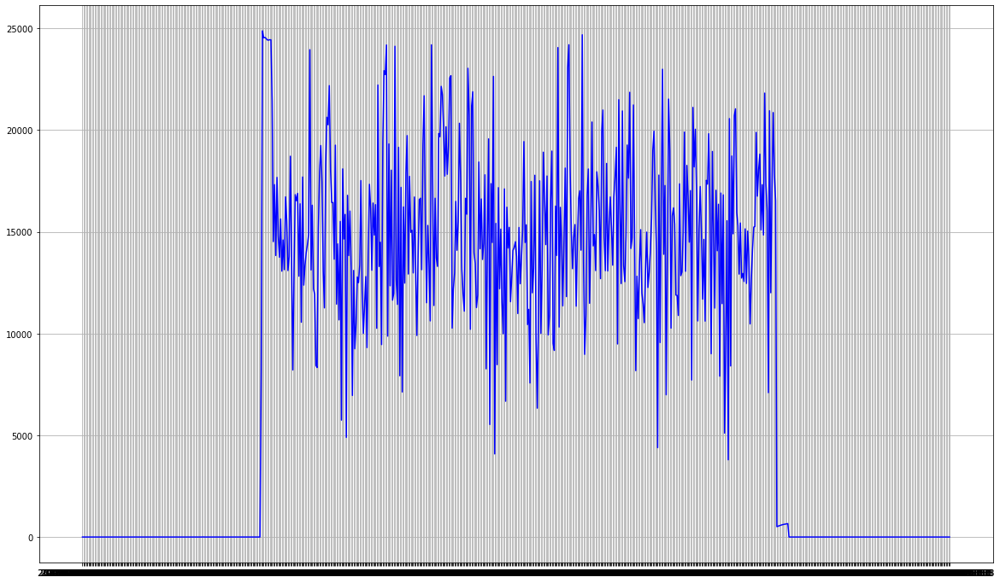

In [38]:
gr(curr, 'event_timestamp', 'Total_P', 'b')

In [47]:
ind = elec[elec['event_timestamp'].str.contains('2022-08-15', regex=False) == True].index
#anom = elec[ind[0] : ind[719]]
ind

Int64Index([], dtype='int64')

In [73]:
norm['Total_P'].mean()

8113.056425591104

In [74]:
anom['Total_P'].mean()

9028.349318497912

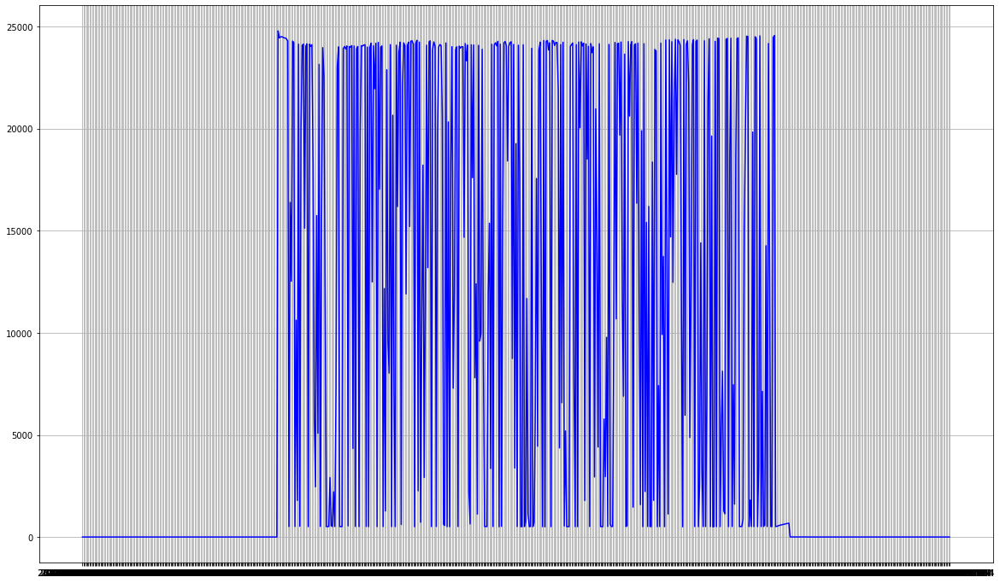

In [68]:
gr(norm, 'event_timestamp', 'Total_P', 'b')

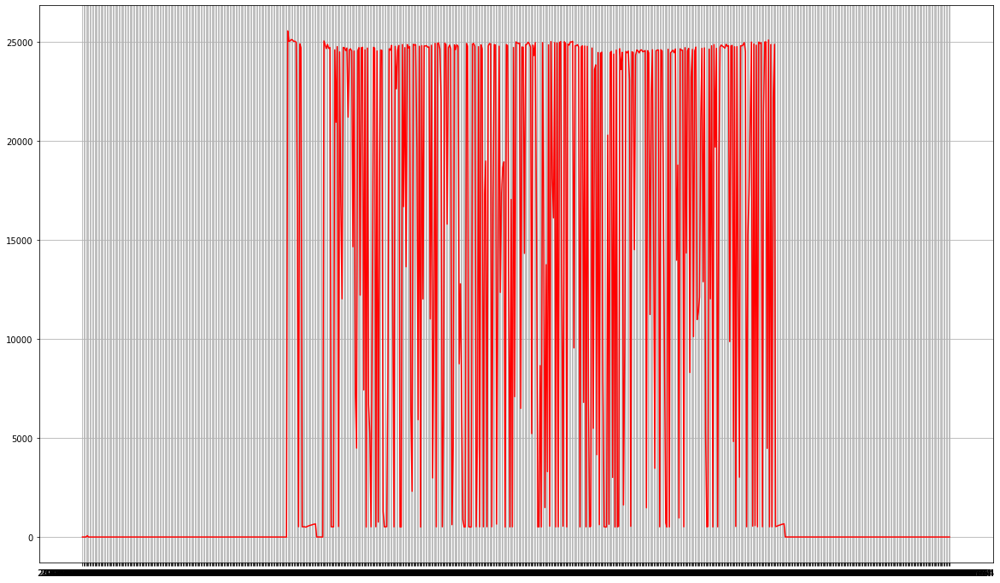

In [69]:
gr(anom, 'event_timestamp', 'Total_P', 'r')

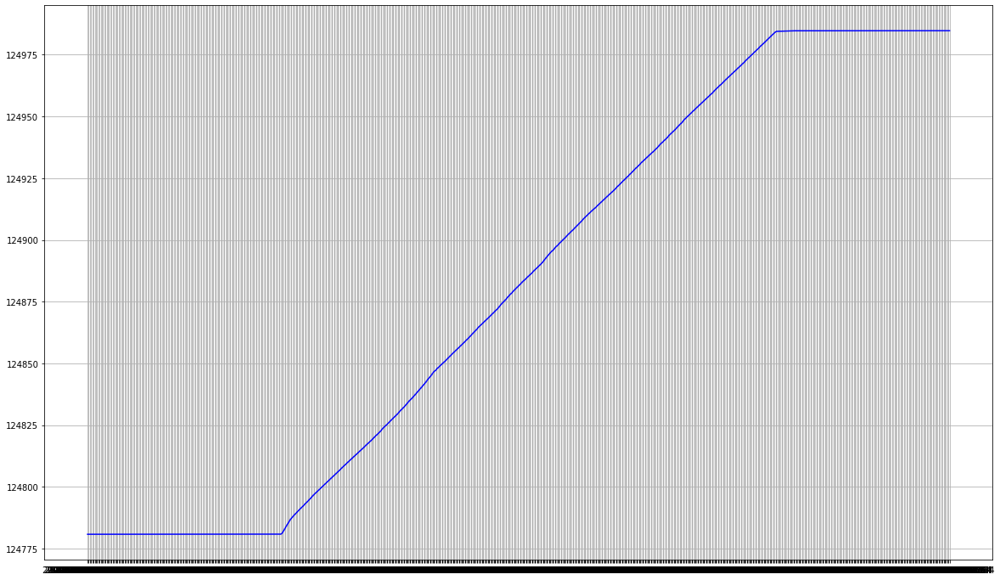

In [71]:
gr(norm, 'event_timestamp', 'Total_AP_energy', 'b')

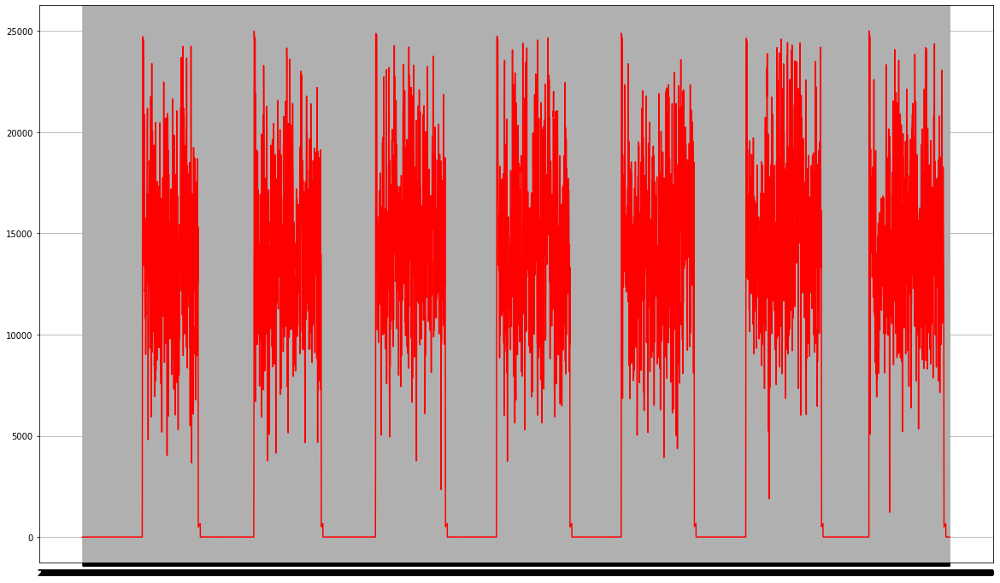

In [14]:
gr(elec[:5000], 'event_timestamp', 'Total_P', 'r')

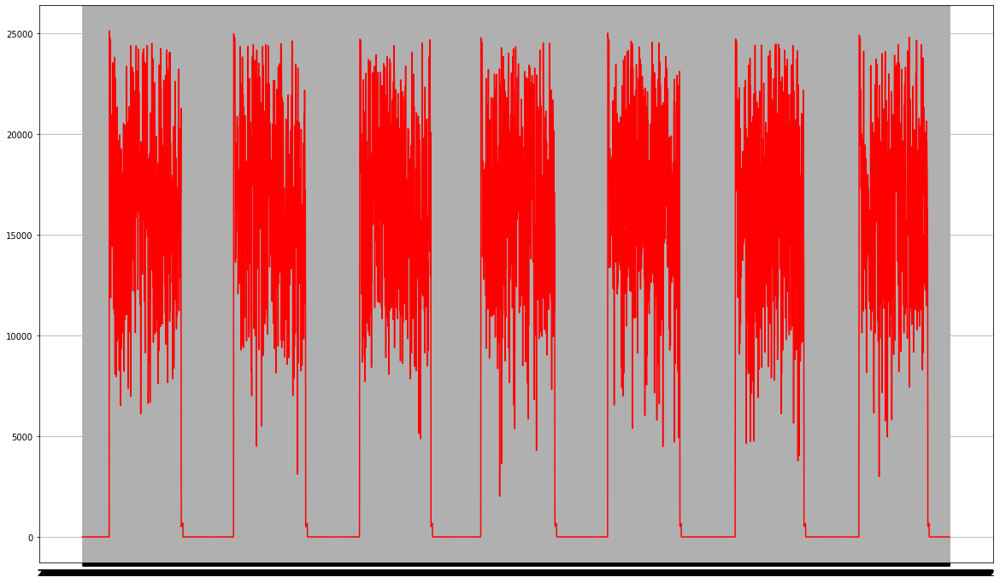

In [51]:
gr(elec[27243:32243], 'event_timestamp', 'Total_P', 'r')

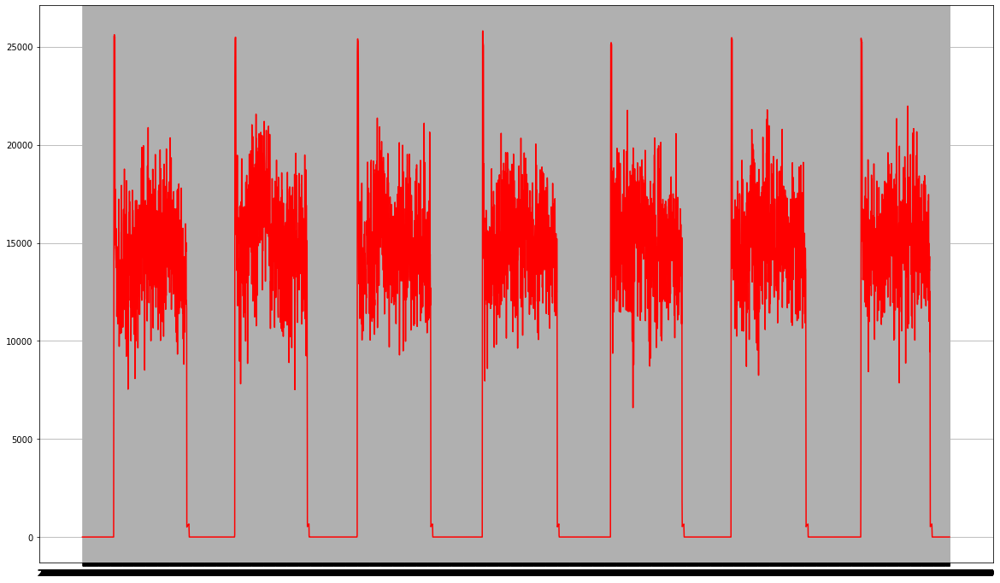

In [52]:
gr(elec[91930:96930], 'event_timestamp', 'Total_P', 'r') #май

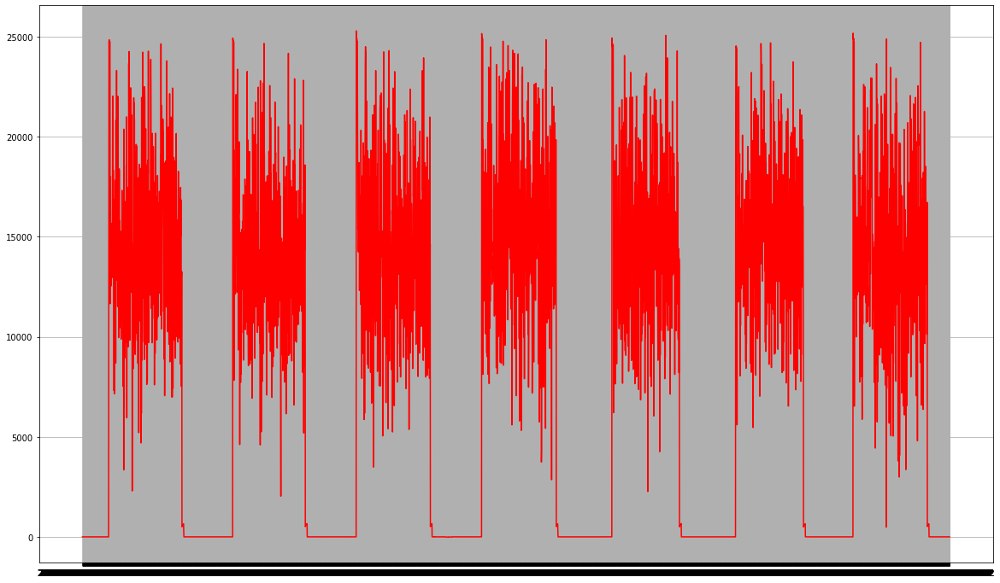

In [53]:
gr(elec[12984:17984], 'event_timestamp', 'Total_P', 'r')

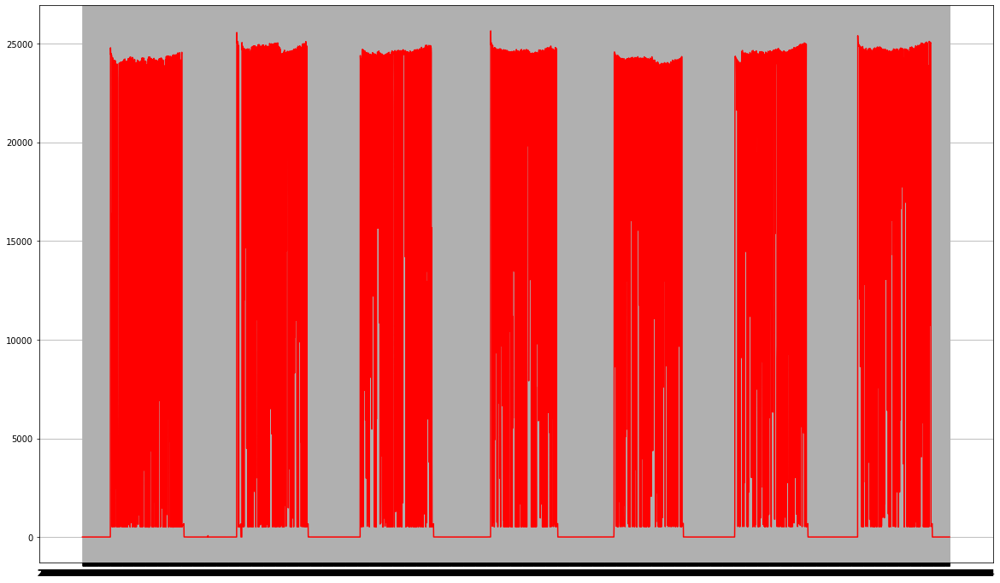

In [40]:
gr(elec[270395:275395], 'event_timestamp', 'Total_P', 'r')

In [90]:
elec[238118:241118]

,event_timestamp,io_id,Urms,Irms,P,AP_energy,RP_energy,S_energy,NP_energy,Total_P,...,S_energy_max,NP_energy_max,Total_P_max,Total_AP_energy_max,Total_RP_energy_max,Total_S_energy_max,Total_NP_energy_max,Phase_angle_max,Voltage_angle_max,Frequency_max
238118,2021-12-05 03:59:35,5e03a7a2832a17ee33585ea4,"[228.85,228.53,229.013]","[0.2,0.1,0.1]","[9.56,-0.13,0]","[40938.82947,37382.9575,37672.10531]","[319.70139,166.04913,192.81233]","[42424.05532,38627.6971,38884.5052]","[3828.7573,633.5144,567.3959]",9.43,...,"[42424.05532,38627.6971,38884.5052]","[3828.7573,633.5144,567.3959]",9.57,115993.89227999999,678.56285,119936.25762,5029.667600000001,"[-76.7,-90.1,-89.9]","[0,-120,119.9]",49.97
238119,2021-12-05 04:01:35,5e03a7a2832a17ee33585ea4,"[228.751,228.389,228.82]","[0.2,0.1,0.1]","[9.44,-0.13,0]","[40938.82979,37382.9575,37672.10531]","[319.70139,166.04913,192.81233]","[42424.05667,38627.69803,38884.50614]","[3828.7573,633.5144,567.3959]",9.309999999999999,...,"[42424.05667,38627.69803,38884.50614]","[3828.7573,633.5144,567.3959]",9.57,115993.8926,678.56285,119936.26083999999,5029.667600000001,"[-76.8,-90.1,-90]","[0,-119.9,120]",49.96
238120,2021-12-05 04:03:35,5e03a7a2832a17ee33585ea4,"[228.999,228.602,229.061]","[0.2,0.1,0.1]","[9.5,-0.06,-0.06]","[40938.8301,37382.9575,37672.10531]","[319.70139,166.04913,192.81233]","[42424.05796,38627.69893,38884.50705]","[3828.7573,633.5144,567.3959]",9.379999999999999,...,"[42424.05796,38627.69893,38884.50705]","[3828.7573,633.5144,567.3959]",9.629999999999999,115993.89291,678.56285,119936.26393999999,5029.667600000001,"[-76.7,-90.2,-89.9]","[0,-120,119.9]",49.97
238121,2021-12-05 04:05:35,5e03a7a2832a17ee33585ea4,"[228.949,228.493,229.121]","[0.2,0.1,0.1]","[9.63,-0.19,0]","[40938.83042,37382.9575,37672.10531]","[319.70139,166.04913,192.81233]","[42424.0593,38627.69987,38884.50799]","[3828.7573,633.5144,567.3959]",9.440000000000001,...,"[42424.0593,38627.69987,38884.50799]","[3828.7573,633.5144,567.3959]",9.629999999999999,115993.89323,678.56285,119936.26716,5029.667600000001,"[-76.7,-90.2,-89.9]","[0,-120,120]",49.99
238122,2021-12-05 04:07:35,5e03a7a2832a17ee33585ea4,"[228.801,228.601,229]","[0.2,0.1,0.1]","[10.31,-0.19,0]","[40938.83075,37382.9575,37672.10531]","[319.70139,166.04913,192.81233]","[42424.06064,38627.7008,38884.50892]","[3828.7573,633.5144,567.3959]",10.120000000000001,...,"[42424.06064,38627.7008,38884.50892]","[3828.7573,633.5144,567.3959]",10.18,115993.89356,678.56285,119936.27036,5029.667600000001,"[-75.8,-90.2,-89.9]","[0,-120,119.9]",49.96
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241113,2021-12-09 07:49:35,5e03a7a2832a17ee33585ea4,"[232.835,232.007,233.606]","[6.6,4.9,4.6]","[1058.5,620.56,631.63]","[41253.9728,37668.94222,37961.40978]","[321.48383,166.0521,192.81233]","[42750.57299,38923.03944,39182.95278]","[3857.3019,637.0097,568.2697]",2310.69,...,"[42750.57299,38923.03944,39182.95278]","[3857.3019,637.0097,568.2697]",25082.98,116884.3248,680.34826,120856.56521,5062.5813,"[13.4,-0.1,-0.1]","[0,-120.1,119.9]",49.95
241114,2021-12-09 07:51:35,5e03a7a2832a17ee33585ea4,"[232.94,232.19,233.817]","[3,0.1,0.1]","[528.44,0,0.56]","[41254.14031,37669.09296,37961.56269]","[321.4849,166.0521,192.81233]","[42750.74661,38923.19506,39183.11045]","[3857.3019,637.0097,568.2697]",529,...,"[42750.74661,38923.19506,39183.11045]","[3857.3019,637.0097,568.2697]",25108.41,116884.79595999999,680.34933,120857.05212000001,5062.5813,"[12.3,-0.1,-0.1]","[0,-119.9,119.9]",49.98
241115,2021-12-09 07:53:35,5e03a7a2832a17ee33585ea4,"[232.444,232.015,233.105]","[37.1,34.9,35.2]","[8491.64,7960.2,8081.32]","[41254.31942,37669.25462,37961.72665]","[321.48592,166.0521,192.81233]","[42750.93213,38923.36198,39183.27955]","[3857.3019,637.0097,568.2697]",24533.16,...,"[42750.93213,38923.36198,39183.27955]","[3857.3019,637.0097,568.2697]",25139.47,116885.30069,680.35035,120857.57366,5062.5813,"[12.8,1.1,0.8]","[0,-120,120]",49.97
241116,2021-12-09 07:55

In [96]:
#2021
el1 = elec.Total_P[90:3090] 
el2 = elec.Total_P[22289:25289]
el3 = elec.Total_P[42270:45270]

el4 = elec.Total_P[64471:67471] 
el5 = elec.Total_P[83059:86059]
el6 = elec.Total_P[103413:106413]

el7 = elec.Total_P[124943:127943] 
el8 = elec.Total_P[146959:149959]
el9 = elec.Total_P[172823:175823]

el10 = elec.Total_P[191337:194337] 
el11 = elec.Total_P[213579:216579]
el12 = elec.Total_P[238118:241118]

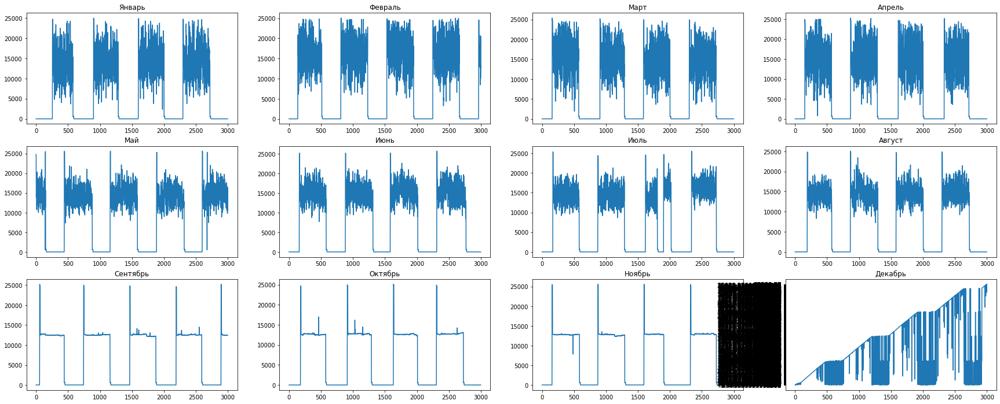

In [97]:
y = np.arange(0, 3000)
plt.figure(figsize=(30,12))
plt.subplot(3, 4, 1)
plt.title('Январь')
plt.plot(y, el1)  
plt.subplot(3, 4, 2)
plt.title('Февраль')
plt.plot(y, el2)
plt.subplot(3, 4, 3)
plt.title('Март')
plt.plot(y, el3)

plt.subplot(3, 4, 4)
plt.title('Апрель')
plt.plot(y, el4)
plt.subplot(3, 4, 5)
plt.title('Май')
plt.plot(y, el5)
plt.subplot(3, 4, 6)
plt.title('Июнь')
plt.plot(y, el6)

plt.subplot(3, 4, 7)
plt.title('Июль')
plt.plot(y, el7)
plt.subplot(3, 4, 8)
plt.title('Август')
plt.plot(y, el8)
plt.subplot(3, 4, 9)
plt.title('Сентябрь')
plt.plot(y, el9)

plt.subplot(3, 4, 10)
plt.title('Октябрь')
plt.plot(y, el10)
plt.subplot(3, 4, 11)
plt.title('Ноябрь')
plt.plot(y, el11)
plt.subplot(3, 4, 12)
plt.title('Декабрь')
plt.plot(y, el12)

plt.savefig('Total_P_year.png')

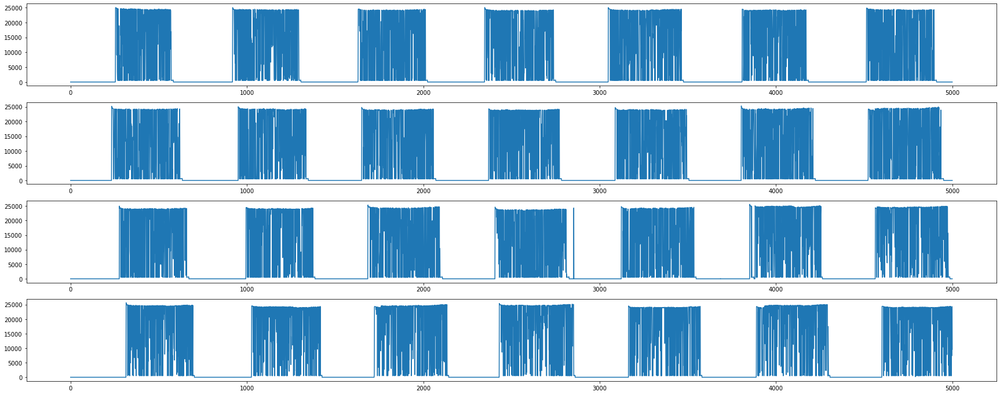

In [98]:
el1 = elec.Total_P[257434:262434] 
el2 = elec.Total_P[262434:267434]
el3 = elec.Total_P[267434:272434]
el4 = elec.Total_P[272434:277434]
y = np.arange(5000)
#el3 = elec.Total_P[257434:257434]

plt.figure(figsize=(30,12))
plt.subplot(4, 1, 1)
plt.plot(y, el1)  
plt.subplot(4, 1, 2)
plt.plot(y, el2)
plt.subplot(4, 1, 3)
plt.plot(y, el3)
plt.subplot(4, 1, 4)
plt.plot(y, el4)

plt.savefig('Total_P_2022.png')

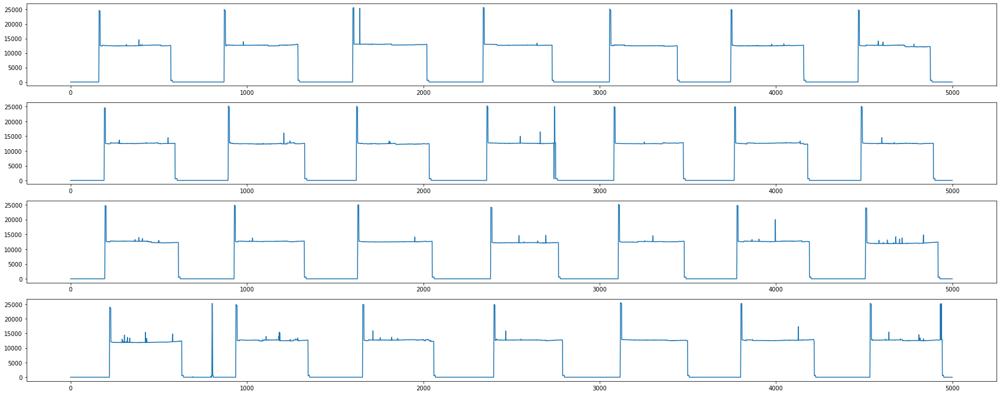

In [93]:
x = 5000
s = 169823
el1 = elec.Total_P[s:s + x] 
el2 = elec.Total_P[s + x:s + 2*x]
el3 = elec.Total_P[s + 2 *x:s + 3 * x]
el4 = elec.Total_P[s + 3 * x:s + 4*x]
y = np.arange(5000)
#el3 = elec.Total_P[257434:257434]

plt.figure(figsize=(30,12))
plt.subplot(4, 1, 1)
plt.plot(y, el1)  
plt.subplot(4, 1, 2)
plt.plot(y, el2)
plt.subplot(4, 1, 3)
plt.plot(y, el3)
plt.subplot(4, 1, 4)
plt.plot(y, el4)

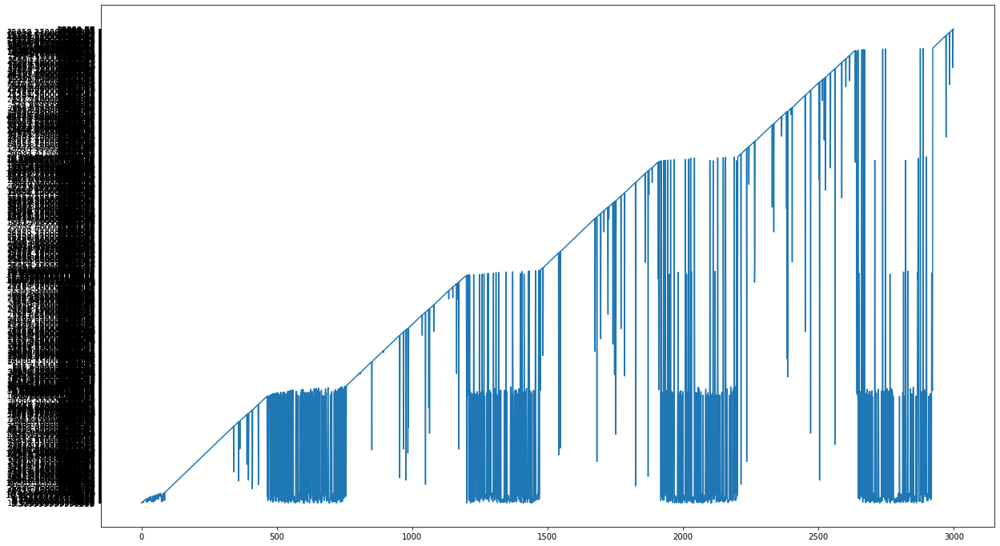

In [99]:
plt.figure(figsize=(20,12))
#plt.subplot(3, 4, 1)
y = np.arange(3000)
plt.plot(y, el12)

plt.savefig('Total_P_decemb.png')

In [82]:
off = []
for i in range(279665):
    #print(elec['Total_P'][i])
    if type(elec['Total_P'][i]) == float and elec['Total_P'][i] < 1500:
        off.append(elec['event_timestamp'][i])

In [83]:
off

['2020-12-31 21:00:33',
 '2020-12-31 21:02:33',
 '2020-12-31 21:04:33',
 '2020-12-31 21:06:33',
 '2020-12-31 21:08:33',
 '2020-12-31 21:10:33',
 '2020-12-31 21:12:33',
 '2020-12-31 21:14:33',
 '2020-12-31 21:16:33',
 '2020-12-31 21:18:33',
 '2020-12-31 21:20:33',
 '2020-12-31 21:22:33',
 '2020-12-31 21:24:33',
 '2020-12-31 21:26:33',
 '2020-12-31 21:28:33',
 '2020-12-31 21:30:33',
 '2020-12-31 21:32:33',
 '2020-12-31 21:34:33',
 '2020-12-31 21:36:33',
 '2020-12-31 21:38:33',
 '2020-12-31 21:40:33',
 '2020-12-31 21:42:33',
 '2020-12-31 21:44:33',
 '2020-12-31 21:46:33',
 '2020-12-31 21:48:33',
 '2020-12-31 21:50:33',
 '2020-12-31 21:52:33',
 '2020-12-31 21:54:33',
 '2020-12-31 21:56:33',
 '2020-12-31 21:58:33',
 '2020-12-31 22:00:33',
 '2020-12-31 22:02:33',
 '2020-12-31 22:04:33',
 '2020-12-31 22:06:33',
 '2020-12-31 22:08:33',
 '2020-12-31 22:10:33',
 '2020-12-31 22:12:33',
 '2020-12-31 22:14:33',
 '2020-12-31 22:16:33',
 '2020-12-31 22:18:33',
 '2020-12-31 22:20:33',
 '2020-12-31 22:

In [98]:
#delta = timedelta('0:30:0', '%H:%M:%S')
for i in range(len(off) - 1):
    d1 = datetime.strptime(off[i], '%Y-%m-%d %H:%M:%S')
    d2 = datetime.strptime(off[i + 1], '%Y-%m-%d %H:%M:%S')
    #print(d2-d1, (d2 - d1).total_seconds())
    if (d2 - d1).total_seconds() > 1800:
        print(off[i], off[i + 1])
        print()

2021-01-01 08:36:27 2021-01-01 19:22:27

2021-01-02 06:07:39 2021-01-02 19:13:39

2021-01-03 05:43:44 2021-01-03 19:11:44

2021-01-04 05:05:40 2021-01-04 19:13:40

2021-01-05 05:09:39 2021-01-05 19:13:39

2021-01-06 05:11:23 2021-01-06 19:45:23

2021-01-07 04:57:40 2021-01-07 08:55:40

2021-01-07 08:55:40 2021-01-07 19:23:40

2021-01-08 05:10:37 2021-01-08 19:14:37

2021-01-09 05:56:20 2021-01-09 19:22:20

2021-01-10 06:01:22 2021-01-10 19:17:22

2021-01-11 05:03:56 2021-01-11 12:57:56

2021-01-11 12:57:56 2021-01-11 19:09:56

2021-01-12 05:09:26 2021-01-12 19:25:26

2021-01-13 04:59:38 2021-01-13 19:13:38

2021-01-14 05:05:50 2021-01-14 19:15:50

2021-01-15 05:10:16 2021-01-15 08:38:16

2021-01-15 08:38:16 2021-01-15 19:40:16

2021-01-16 05:47:29 2021-01-16 16:41:29

2021-01-16 16:41:29 2021-01-16 19:39:29

2021-01-17 06:08:31 2021-01-17 19:36:31

2021-01-18 05:10:35 2021-01-18 19:16:35

2021-01-19 05:08:12 2021-01-19 19:22:12

2021-01-20 05:12:36 2021-01-20 19:12:36

2021-01-21 05:04

2021-09-01 05:27:38 2021-09-01 19:05:38

2021-09-02 05:12:46 2021-09-02 19:17:09

2021-09-03 05:35:09 2021-09-03 19:39:09

2021-09-04 06:18:37 2021-09-04 19:24:37

2021-09-05 06:16:56 2021-09-05 19:08:56

2021-09-06 05:17:48 2021-09-06 19:07:48

2021-09-07 05:27:48 2021-09-07 19:07:48

2021-09-08 05:43:39 2021-09-08 19:08:51

2021-09-09 05:13:46 2021-09-09 19:43:46

2021-09-10 05:32:44 2021-09-10 19:20:44

2021-09-11 06:15:40 2021-09-11 18:59:40

2021-09-12 06:23:46 2021-09-12 19:33:46

2021-09-13 05:15:58 2021-09-13 19:15:58

2021-09-14 05:22:54 2021-09-14 19:06:54

2021-09-15 05:13:45 2021-09-15 19:09:45

2021-09-16 05:44:43 2021-09-16 19:06:43

2021-09-17 05:13:37 2021-09-17 19:21:37

2021-09-18 06:27:59 2021-09-18 19:19:59

2021-09-19 06:40:43 2021-09-19 19:14:57

2021-09-20 05:13:58 2021-09-20 18:59:58

2021-09-21 05:37:37 2021-09-21 19:23:10

2021-09-22 05:29:56 2021-09-22 19:11:56

2021-09-23 05:27:55 2021-09-23 19:09:55

2021-09-24 05:31:58 2021-09-24 19:01:58

2021-09-25 06:25

# 0_data_meter_humidity.csv

In [7]:
hum

,event_timestamp,io_id,value,value_min,value_max
0,1610136637,5e03a7a4832a17ee33585eb0,35.89,35.89,35.89
1,1610283082,5e03a7a4832a17ee33585eb0,35.89,35.89,35.89
2,1612209511,5e03a7a4832a17ee33585eb0,35.89,35.89,35.89
3,1613705374,5e03a7a4832a17ee33585eb0,35.89,35.89,35.89
4,1615915770,5e03a7a4832a17ee33585eb0,35.89,35.89,35.89
...,...,...,...,...,...
193251,1643662314,5e03a7a4832a17ee33585eb0,23.69,23.69,23.69
193252,1643662434,5e03a7a4832a17ee33585eb0,23.47,23.47,23.69
193253,1643662554,5e03a7a4832a17ee33585eb0,23.47,23.47,23.47
193254,1643662674,5e03a7a4832a17ee33585eb0,23.47,23.47,23.47


# 0_data_meter_temperature.csv

In [10]:
temp

,event_timestamp,io_id,value,value_min,value_max
0,2021-01-08 20:10:37,5e03a7a4832a17ee33585eaf,30.38,30.38,30.38
1,2021-01-10 12:51:22,5e03a7a4832a17ee33585eaf,30.38,30.38,30.38
2,2021-02-01 19:58:31,5e03a7a4832a17ee33585eaf,30.38,30.38,30.38
3,2021-02-19 03:29:34,5e03a7a4832a17ee33585eaf,30.38,30.38,30.38
4,2021-03-16 17:29:30,5e03a7a4832a17ee33585eaf,30.38,30.38,30.38
...,...,...,...,...,...
193261,2022-01-31 20:51:54,5e03a7a4832a17ee33585eaf,24.65,24.65,24.65
193262,2022-01-31 20:53:54,5e03a7a4832a17ee33585eaf,24.13,24.13,24.65
193263,2022-01-31 20:55:54,5e03a7a4832a17ee33585eaf,24.13,24.13,24.13
193264,2022-01-31 20:57:54,5e03a7a4832a17ee33585eaf,24.13,24.13,24.13


In [23]:
elec[86100:]

,event_timestamp,io_id,Urms,Irms,P,AP_energy,RP_energy,S_energy,NP_energy,Total_P,...,S_energy_max,NP_energy_max,Total_P_max,Total_AP_energy_max,Total_RP_energy_max,Total_S_energy_max,Total_NP_energy_max,Phase_angle_max,Voltage_angle_max,Frequency_max
86100,2021-05-07 19:58:17,5e03a7a2832a17ee33585ea4,"[233.840864864865,233.717081081081,233.8509729...","[0.2,0.1,0.1]","[9.41782608695652,-0.245454545454545,0]","[25129.658245,23055.00549,23243.55414]",[],[],[],9.172372,...,[],[],9.43,71428.21803,\N,\N,\N,"[-77.5,-90.2,-89.9]","[0,-119.9,119.9]",49.98
86101,2021-05-07 20:00:17,5e03a7a2832a17ee33585ea4,"[233.838166666667,233.670861111111,233.8684444...","[0.2,0.1,0.1]","[10.1130434782609,-0.293157894736842,-0.012]","[25129.6585758064,23055.00549,23243.55414]",[],[],[],9.807886,...,[],[],10.43,71428.21837,\N,\N,\N,"[-76.4,-90.3,-89.9]","[0,-119.9,119.9]",50.0
86102,2021-05-07 20:02:17,5e03a7a2832a17ee33585ea4,"[233.967444444444,233.915805555556,233.9750277...","[0.2,0.1,0.1]","[10.2488888888889,-0.289285714285714,0.03]","[25129.6589106452,23055.00549,23243.55414]",[],[],[],9.989603,...,[],[],10.25,71428.21871,\N,\N,\N,"[-76.4,-90.4,-89.9]","[0,-120,119.9]",50.0
86103,2021-05-07 20:04:17,5e03a7a2832a17ee33585ea4,"[234.027083333333,234.012638888889,233.9556388...","[0.2,0.1,0.1]","[9.93037037037037,-0.237142857142857,0]","[25129.6592545161,23055.00549,23243.55414]",[],[],[],9.693228,...,[],[],10.25,71428.21905,\N,\N,\N,"[-76.4,-90.3,-89.9]","[0,-120,119.9]",49.99
86104,2021-05-07 20:06:17,5e03a7a2832a17ee33585ea4,"[231.726459459459,231.818405405405,231.7450270...","[0.2,0.1,0.1]","[9.48357142857143,-0.19,-0.03]","[25129.6595822222,23055.00549,23243.55414]",[],[],[],9.263571,...,[],[],9.56,71428.21936,\N,\N,\N,"[-77.1,-90.2,-89.9]","[0,-120,119.9]",49.97
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279660,2022-01-31 20:51:54,5e03a7a2832a17ee33585ea4,"[230.144,230.034,230.427]","[0.2,0.1,0.1]","[9.88,-0.25,0.06]","[45109.13062,41172.24145,41483.49999]","[344.03577,166.16952,192.81239]","[46750.14248,42543.40906,42818.74515]","[4212.0699,704.8758,580.5031]",9.69,...,"[46750.14248,42543.40906,42818.74515]","[4212.0699,704.8758,580.5031]",10.12,127764.87206,703.01768,132112.29669,5497.4488,"[-76.4,-90.4,-89.9]","[0,-120.1,119.7]",49.98
279661,2022-01-31 20:53:54,5e03a7a2832a17ee33585ea4,"[230.225,230.125,230.528]","[0.2,0.1,0.1]","[10.06,-0.13,0]","[45109.13095,41172.24145,41483.49999]","[344.03577,166.16952,192.81239]","[46750.14379,42543.40997,42818.74606]","[4212.0699,704.8758,580.5031]",9.93,...,"[46750.14379,42543.40997,42818.74606]","[4212.0699,704.8758,580.5031]",10.13,127764.87239,703.01768,132112.29982,5497.4488,"[-76.4,-90.4,-89.8]","[0,-120.3,119.5]",49.97
279662,2022-01-31 20:55:54,5e03a7a2832a17ee33585ea4,"[230.449,230.165,230.52]","[0.2,0.1,0.1]","[9.69,-0.25,0]","[45109.13128,41172.24145,41483.49999]","[344.03577,166.16952,192.81239]","[46750.14515,42543.41092,42818.74702]","[4212.0699,704.8758,580.5031]",9.44,...,"[46750.14515,42543.41092,42818.74702]","[4212.0699,704.8758,580.5031]",9.99,127764.87272,703.01768,132112.30309,5497.4488,"[-76.5,-90.3,-89.9]","[0,-120.2,119.6]",50.0
279663,2022-01-31 20:57:54,5e03a7a2832a17ee33585ea4,"[230.549,230.305,230.686]","[0.2,0.1,0.1]","[9.75,-0.19,0]","[45109.13161,41172.24145,41483.49999]","[344.03577,166.16952,192.81239]","[46750.1465,42543.41186,42818.74797]","[4212.0699,704.8758,580.5031]",9.56,...,"[46750.1465,42543.41186,42818.74797]","[4212.0699,704.8758,580.5031]",9.87,127764.87305,703.01768,132112.30633,5497.4488,"[-76.6,-90.3,-89.9]","[0,-120.2,119.6]",50.03


In [9]:
for i, j in enumerate(temp['event_timestamp']):
    #print(j)
    temp['event_timestamp'][i] = datetime.utcfromtimestamp(j).strftime('%Y-%m-%d %H:%M:%S')

<ipython-input-9-1bdaacc53f35>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp['event_timestamp'][i] = datetime.utcfromtimestamp(j).strftime('%Y-%m-%d %H:%M:%S')
c:\users\lomonosova\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [9]:
case

,id,description,equipment_id,facility_id
0,0,Неправильно собранное оборудование (печь) посл...,5e03a7a7832a17ee33585ecf,5e03a79d832a17ee33585e8a


In [14]:
case['description'][0]

'Неправильно собранное оборудование (печь) после обслуживания. 19.01.2022 – корректная работа оборудования, 20.01.2022 – повышенное энергопотребление.'

In [10]:
equipment

,id,io_id,weight
0,5e03a7a7832a17ee33585ecf,5e03a7a2832a17ee33585ea4,1


In [11]:
facility

,id,io_id,type
0,5e03a79d832a17ee33585e8a,5e03a7a4832a17ee33585eaf,meter_temperature
1,5e03a79d832a17ee33585e8a,5e03a7a4832a17ee33585eb0,meter_humidity


In [19]:
data = pd.DataFrame({'date': [], 'time': [], 'Total_P':[], 'temp': [], 'hum': []})

In [20]:
data

,date,time,Total_P,temp,hum


In [25]:
t = np.array(temp['event_timestamp'])
e = np.array(elec['event_timestamp'])

In [29]:
for i in range(e.shape[0]):
    for j in range(t.shape[0]):

<ipython-input-29-6fe0b6c035a1>:1: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  t == e


False

In [28]:
t

array(['2021-01-08 20:10:37', '2021-01-10 12:51:22',
       '2021-02-01 19:58:31', ..., '2022-01-31 20:55:54',
       '2022-01-31 20:57:54', '2022-01-31 20:59:54'], dtype=object)

Что надо сделать:
Соединить данные и поиграть с графиками

# Total_AP_max

In [8]:
elec.columns

Index(['event_timestamp', 'io_id', 'Urms', 'Irms', 'P', 'AP_energy',
       'RP_energy', 'S_energy', 'NP_energy', 'Total_P', 'Total_AP_energy',
       'Total_RP_energy', 'Total_S_energy', 'Total_NP_energy', 'Phase_angle',
       'Voltage_angle', 'Frequency', 'Urms_min', 'Irms_min', 'P_min',
       'AP_energy_min', 'RP_energy_min', 'S_energy_min', 'NP_energy_min',
       'Total_P_min', 'Total_AP_energy_min', 'Total_RP_energy_min',
       'Total_S_energy_min', 'Total_NP_energy_min', 'Phase_angle_min',
       'Voltage_angle_min', 'Frequency_min', 'Urms_max', 'Irms_max', 'P_max',
       'AP_energy_max', 'RP_energy_max', 'S_energy_max', 'NP_energy_max',
       'Total_P_max', 'Total_AP_energy_max', 'Total_RP_energy_max',
       'Total_S_energy_max', 'Total_NP_energy_max', 'Phase_angle_max',
       'Voltage_angle_max', 'Frequency_max'],
      dtype='object')

In [315]:
t = elec['event_timestamp']
t = pd.to_datetime(t)
dt = []
for i, j in enumerate(t):
    i += 1
    try:
        dt.append(t[i] - t[i - 1])
    except KeyError:
        continue
        
for i in range(len(dt)):
    dt[i] = dt[i].total_seconds()
dt = np.array(dt)
dt[np.where(dt == 0)] = 0.001

AP = elec['Total_AP_energy_max']
a = []
for j, i in enumerate(elec['Total_AP_energy_max'][:279664]):
    try:
        i = float(i)
    except ValueError:
        a.append(j)
for i in a:
    AP[i] = AP[i - 1]
AP = np.array(AP, dtype = float)
dAP = -1 * AP[:-1] + AP[1:]
dAP *= 1000
X = dAP/dt

In [316]:
el1 = X[90:3090] 
el2 = X[22289:25289]
el3 = X[42270:45270]

el4 = X[64471:67471] 
el5 = X[83059:86059]
el6 = X[103413:106413]

el7 = X[124943:127943] 
el8 = X[146959:149959]
el9 = X[172823:175823]

el10 = X[191337:194337] 
el11 = X[213579:216579]
el12 = X[238118:241118]

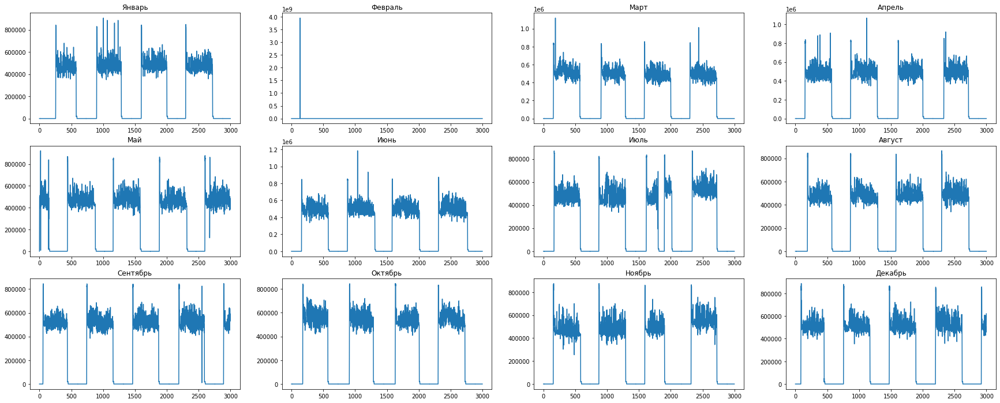

In [317]:
y = np.arange(0, 3000)
plt.figure(figsize=(30,12))
plt.subplot(3, 4, 1)
plt.title('Январь')
plt.plot(y, el1)  
plt.subplot(3, 4, 2)
plt.title('Февраль')
plt.plot(y, el2)
plt.subplot(3, 4, 3)
plt.title('Март')
plt.plot(y, el3)

plt.subplot(3, 4, 4)
plt.title('Апрель')
plt.plot(y, el4)
plt.subplot(3, 4, 5)
plt.title('Май')
plt.plot(y, el5)
plt.subplot(3, 4, 6)
plt.title('Июнь')
plt.plot(y, el6)

plt.subplot(3, 4, 7)
plt.title('Июль')
plt.plot(y, el7)
plt.subplot(3, 4, 8)
plt.title('Август')
plt.plot(y, el8)
plt.subplot(3, 4, 9)
plt.title('Сентябрь')
plt.plot(y, el9)

plt.subplot(3, 4, 10)
plt.title('Октябрь')
plt.plot(y, el10)
plt.subplot(3, 4, 11)
plt.title('Ноябрь')
plt.plot(y, el11)
plt.subplot(3, 4, 12)
plt.title('Декабрь')
plt.plot(y, el12)

#plt.savefig('AP_max_year.png')

<ipython-input-313-22e1cb0054da>:88: RuntimeWarning: divide by zero encountered in true_divide
  X = dAP/dt
<ipython-input-313-22e1cb0054da>:88: RuntimeWarning: invalid value encountered in true_divide
  X = dAP/dt


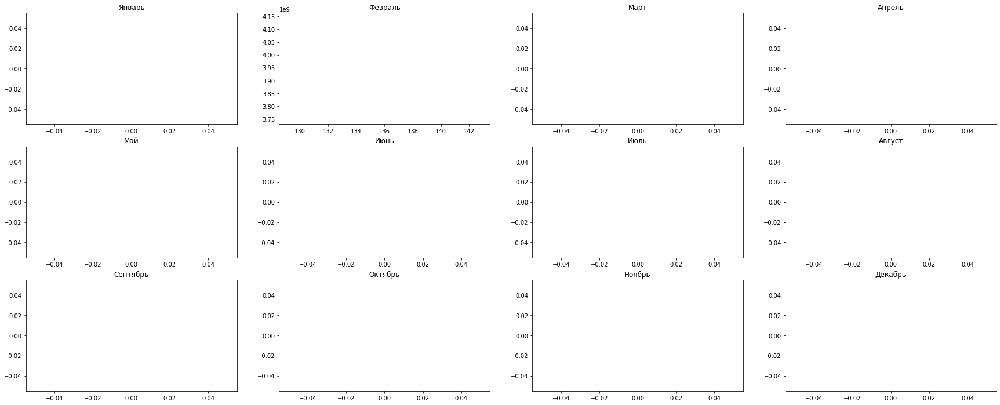

In [313]:
AP = elec['Total_AP_energy_max']#np.array(elec['Total_AP_energy_max'][:279664]) - np.array(elec['Total_AP_energy_max'][1:])
t = elec['event_timestamp']


# In[42]:


a = []
#AP[28618] = AP[28618 - 1]
for j, i in enumerate(elec['Total_AP_energy_max'][:279664]):
    #print(j, i)
    try:
        i = float(i)
    except ValueError:
        a.append(j)
    #if type(i) != float:
        #print(i)


# In[43]:


for i in a:
    AP[i] = AP[i - 1]


# 152677,2021-08-08 19:24:00 - 153242,2021-08-09 04:54:00

# In[44]:


AP = np.array(AP, dtype = float)


# In[47]:


dAP = -1 * AP[:-1] + AP[1:]


# In[48]:


dAP


# In[61]:


#t_dt = datetime.strptime(t, '%Y-%m-%d %h:%M:%s')
t = pd.to_datetime(t)
t


# In[62]:


dt = []
for i, j in enumerate(t):
    i += 1
    try:
        dt.append(t[i] - t[i - 1])
    except KeyError:
        continue

# In[66]:


for i in range(len(dt)):
    dt[i] = dt[i].total_seconds()


# In[68]:


len(dt)


# In[72]:


dAP *= 1000


# In[73]:


X = dAP/dt


# In[74]:


X


# In[77]:


el1 = X[90:3090] 
el2 = X[22289:25289]
el3 = X[42270:45270]

el4 = X[64471:67471] 
el5 = X[83059:86059]
el6 = X[103413:106413]

el7 = X[124943:127943] 
el8 = X[146959:149959]
el9 = X[172823:175823]

el10 = X[191337:194337] 
el11 = X[213579:216579]
el12 = X[238118:241118]


# In[79]:


y = np.arange(0, 3000)
plt.figure(figsize=(30,12))
plt.subplot(3, 4, 1)
plt.title('Январь')
plt.plot(y, el1)  
plt.subplot(3, 4, 2)
plt.title('Февраль')
plt.plot(y, el2)
plt.subplot(3, 4, 3)
plt.title('Март')
plt.plot(y, el3)

plt.subplot(3, 4, 4)
plt.title('Апрель')
plt.plot(y, el4)
plt.subplot(3, 4, 5)
plt.title('Май')
plt.plot(y, el5)
plt.subplot(3, 4, 6)
plt.title('Июнь')
plt.plot(y, el6)

plt.subplot(3, 4, 7)
plt.title('Июль')
plt.plot(y, el7)
plt.subplot(3, 4, 8)
plt.title('Август')
plt.plot(y, el8)
plt.subplot(3, 4, 9)
plt.title('Сентябрь')
plt.plot(y, el9)

plt.subplot(3, 4, 10)
plt.title('Октябрь')
plt.plot(y, el10)
plt.subplot(3, 4, 11)
plt.title('Ноябрь')
plt.plot(y, el11)
plt.subplot(3, 4, 12)
plt.title('Декабрь')
plt.plot(y, el12)


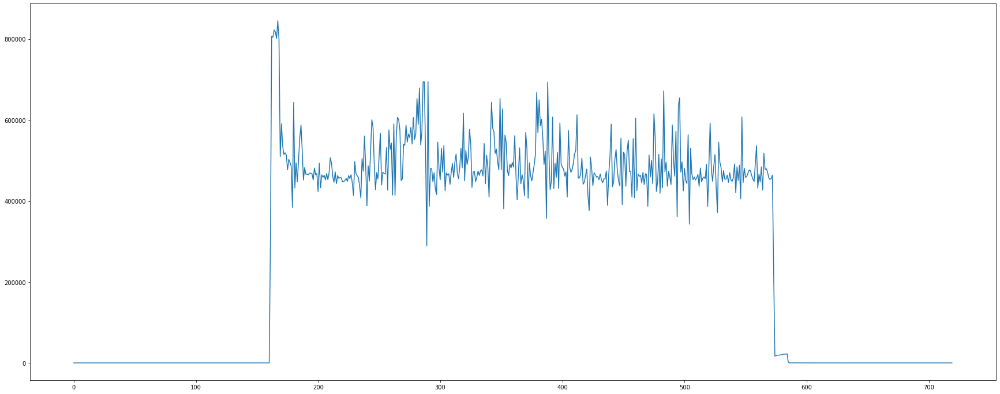

In [311]:
norm = X[270395:270395 + 720]
y = np.arange(720)
plt.figure(figsize=(30,12))
plt.plot(y, norm)

#plt.savefig('AP_max_norm.png')

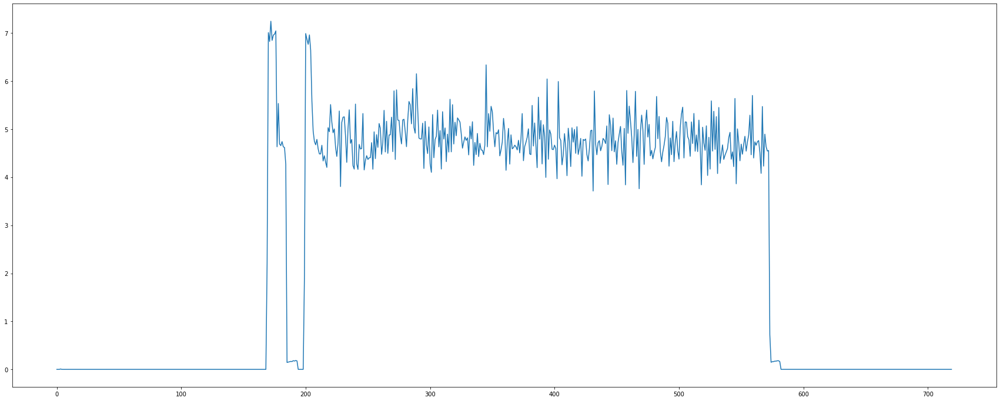

In [88]:
anom = X[270395 + 720:270395 + 2 *720]
y = np.arange(720)
plt.figure(figsize=(30,12))
plt.plot(y, anom)
#plt.savefig('AP_max_anom.png')

In [82]:
norm.mean()

2.360136458333323

In [83]:
anom.mean()

2.6257032407406933

In [85]:
norm[np.where(norm > 1)].mean()

4.107953793381519

In [86]:
anom[np.where(anom > 1)].mean()

4.835971581196334

ValueError: x and y must have same first dimension, but have shapes (5000,) and (4539,)

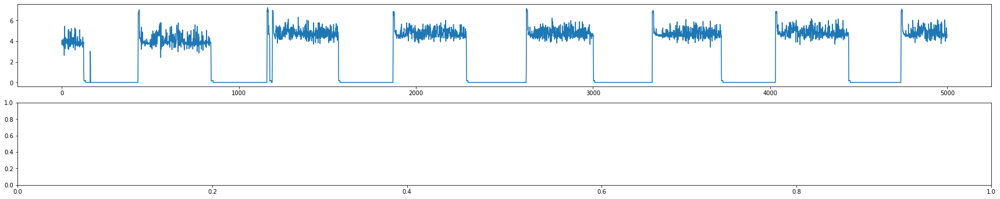

In [100]:
x = 5000
s = 270125
el1 = X[s:s + x] 
el2 = X[s + x:s + 2*x]
el3 = X[s + 2 *x:s + 3 * x]
el4 = X[s + 3 * x:s + 4*x]
y = np.arange(5000)
#el3 = elec.Total_P[257434:257434]

plt.figure(figsize=(30,12))
plt.subplot(4, 1, 1)
plt.plot(y, el1)  
plt.subplot(4, 1, 2)
plt.plot(y, el2)
plt.subplot(4, 1, 3)
plt.plot(y, el3)
plt.subplot(4, 1, 4)
plt.plot(y, el4)

# K-means

X - нужное значение total AP max

In [150]:
X[np.where(np.isnan(X) == True)] = 0

In [256]:
#X = X[:100000]
X = X[124943:127943]
X.shape

(3000,)

In [251]:
h_time = []
for i in t:
    #i += 1
    h_time.append(i.hour)


In [252]:
type(X[10])

IndexError: index 10 is out of bounds for axis 0 with size 0

In [175]:
for i in X:
    if type(i) != np.float64:
        print(111, i)

In [257]:
z = np.array(np.column_stack([X, h_time[124943:127943]]))

In [258]:
km = KMeans(n_clusters=2, random_state=0).fit(z)

In [178]:
np.any(np.isnan(z))

False

In [179]:
np.all(np.isfinite(z))

True

In [259]:
pred = km.predict(z)

In [181]:
#np.where(pred == 0)
pred.sum()

57142

In [182]:
z

array([[2.75000002e+00, 2.10000000e+01],
       [2.58333336e+00, 2.10000000e+01],
       [2.66666666e+00, 2.10000000e+01],
       ...,
       [6.91541667e+03, 5.00000000e+00],
       [6.69708333e+03, 5.00000000e+00],
       [4.28850000e+03, 5.00000000e+00]])

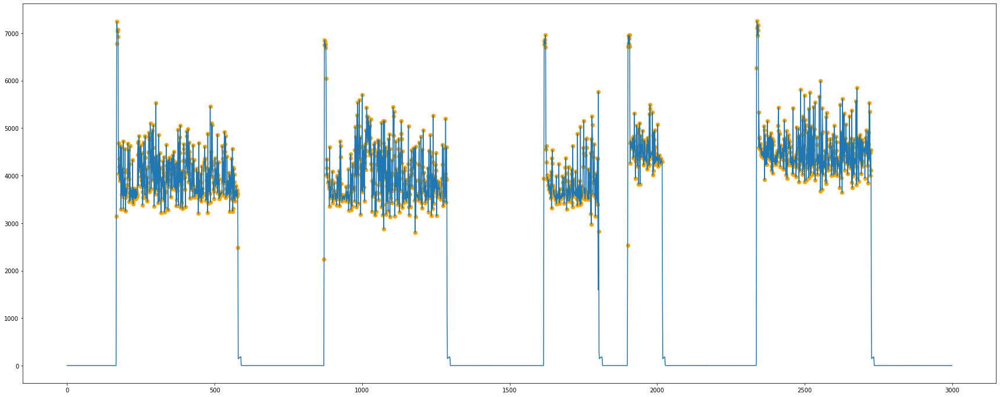

In [261]:
delta = 3000
y = np.arange(delta)
plt.figure(figsize=(30,12))
plt.plot(y, X[:delta])
plt.scatter(y[np.where(pred[:delta] == 1)], X[np.where(pred[:delta] == 1)], color='orange', s=40, marker='o')

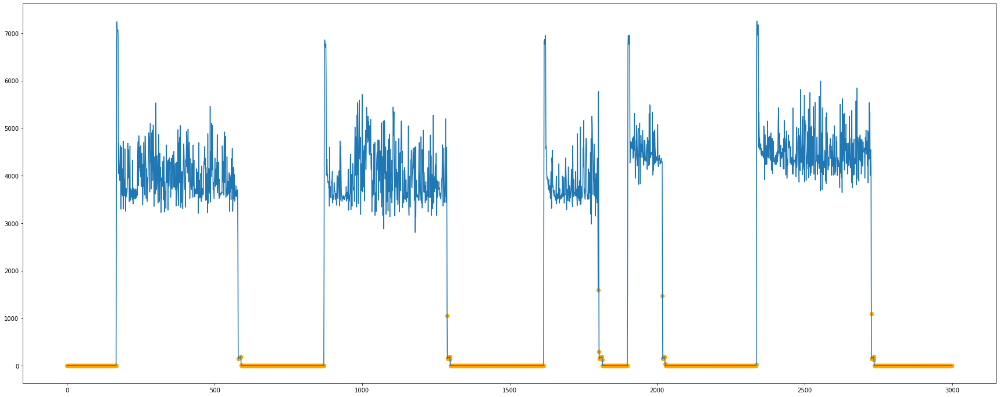

In [262]:
plt.figure(figsize=(30,12))
plt.plot(y, X[:delta])
plt.scatter(y[np.where(pred[:delta] == 0)], X[np.where(pred[:delta] == 0)], color='orange', s=40, marker='o')

Данные: [total_AP_max, час в сутках]\
Алгоритм: KMeans\
Выводы: аномалии выделяются во второй половине дня (нужно сделать one hot encoding)\
Применять алгоритм только в часы работы (!) может быть плохой идеей для решения с другими видами оборудования \
Применить скользящее окно

# One hot encoding

In [103]:
enc_time = []
for i in h_time:
    curr = np.zeros(24)
    curr[i] = 1
    enc_time.append(curr)

In [106]:
z = np.array(np.column_stack([X, enc_time[:100000]]))

In [110]:
km = KMeans(n_clusters=2, random_state=0).fit(z)
pred = km.predict(z)

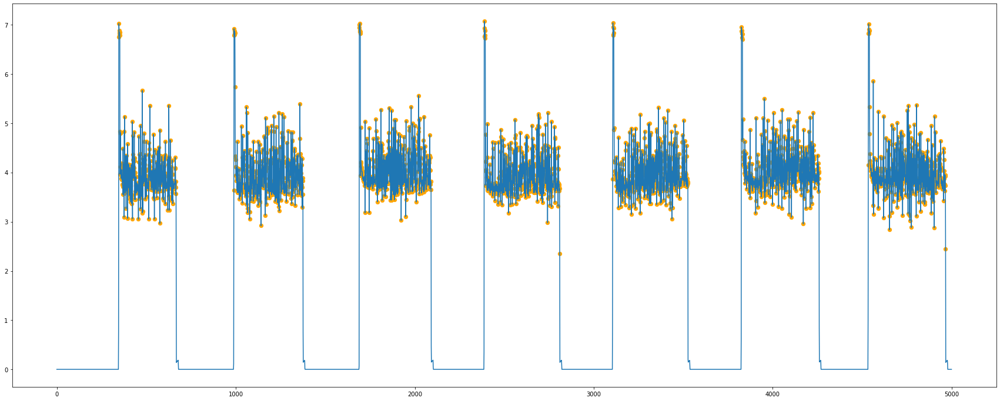

In [114]:
delta = 5000
y = np.arange(delta)
plt.figure(figsize=(30,12))
plt.plot(y, X[:delta])
plt.scatter(y[np.where(pred[:delta] == 0)], X[np.where(pred[:delta] == 0)], color='orange', s=40, marker='o')

# Скользящее окно

In [132]:
WS = 40
km = KMeans(n_clusters=2, random_state=0).fit(z)
#fcm.fit(X)
#ans_soft = np.zeros((X.shape[0], 2))
ans = np.zeros(X.shape[0])
for i in range(X.shape[0] - WS):
    curr_z = z[i : i + WS]
    #pred_soft = fcm.soft_predict(curr_x)
    pred = km.predict(curr_z)
    #ans_soft[i : i + WS] += pred_soft
    ans[i : i + WS] += pred
    
for i in range(WS):
    #ans_soft[i] /= (i + 1)
    #ans_soft[ans_soft.shape[0] - (i + 1)] /= (i + 1)
    ans[i] /= (i + 1)
    ans[ans.shape[0] - (i + 1)] /= (i + 1)
#ans_soft[WS:-WS] /= WS
ans[WS:-WS] /= WS
ans[ans >= 0.5] = 1
ans[ans < 0.5] = 0

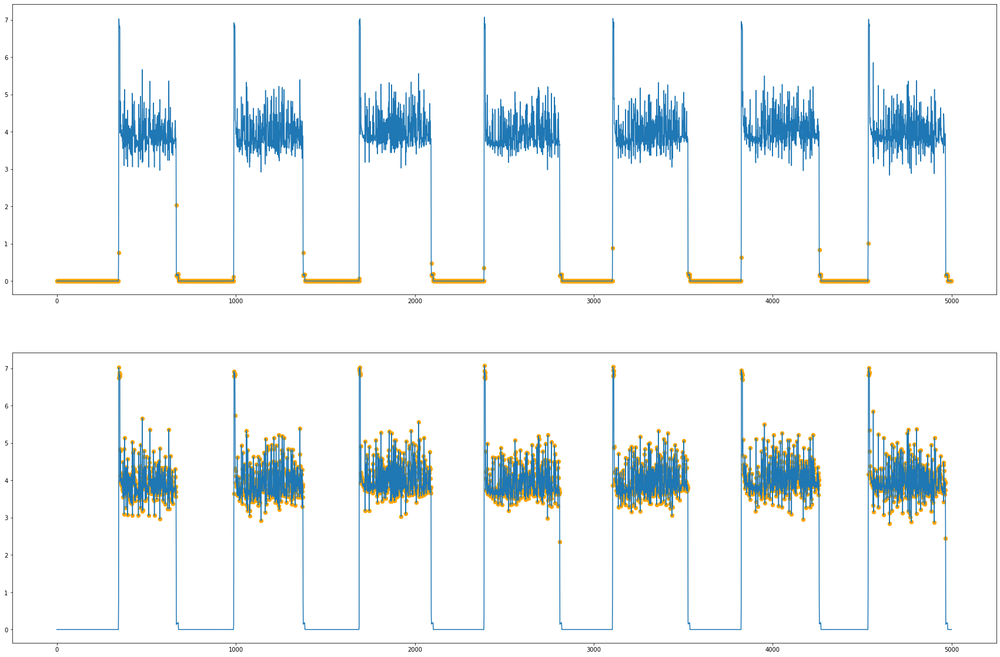

In [137]:
delta = 5000
y = np.arange(delta)
plt.figure(figsize=(30,20))
plt.subplot(2, 1, 1)
plt.plot(y, X[:delta])
plt.scatter(y[np.where(ans[:delta] == 1)], X[np.where(ans[:delta] == 1)], color='orange', s=40, marker='o')
plt.subplot(2, 1, 2)
plt.plot(y, X[:delta])
plt.scatter(y[np.where(ans[:delta] == 0)], X[np.where(ans[:delta] == 0)], color='orange', s=40, marker='o')

In [140]:
WS = 100
km = KMeans(n_clusters=2, random_state=0).fit(z)

ans = np.zeros(X.shape[0])
for i in range(X.shape[0] - WS):
    curr_z = z[i : i + WS]
    pred = km.predict(curr_z)
    ans[i : i + WS] += pred
    
for i in range(WS):
    ans[i] /= (i + 1)
    ans[ans.shape[0] - (i + 1)] /= (i + 1)

ans[WS:-WS] /= WS
ans[ans >= 0.5] = 1
ans[ans < 0.5] = 0

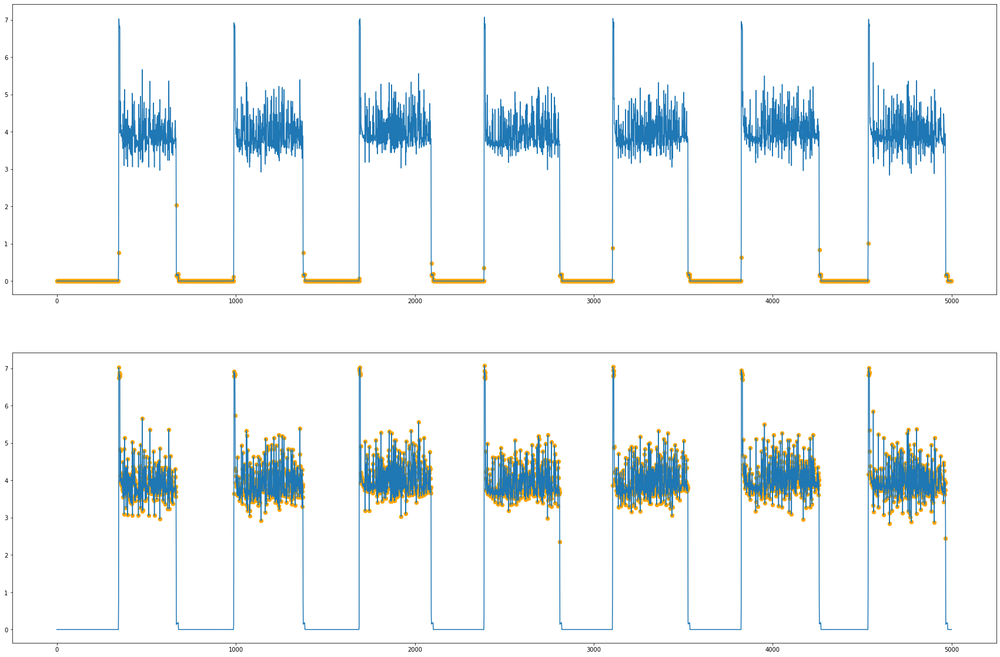

In [141]:
delta = 5000
y = np.arange(delta)
plt.figure(figsize=(30,20))
plt.subplot(2, 1, 1)
plt.plot(y, X[:delta])
plt.scatter(y[np.where(ans[:delta] == 1)], X[np.where(ans[:delta] == 1)], color='orange', s=40, marker='o')
plt.subplot(2, 1, 2)
plt.plot(y, X[:delta])
plt.scatter(y[np.where(ans[:delta] == 0)], X[np.where(ans[:delta] == 0)], color='orange', s=40, marker='o')

# Часы работы: усреднить, когда выкл

In [144]:
X[np.where(X < 1)] = 4

In [146]:
z = np.array(np.column_stack([X, enc_time[:100000]]))

In [147]:
km = KMeans(n_clusters=2, random_state=0).fit(z)
pred = km.predict(z)

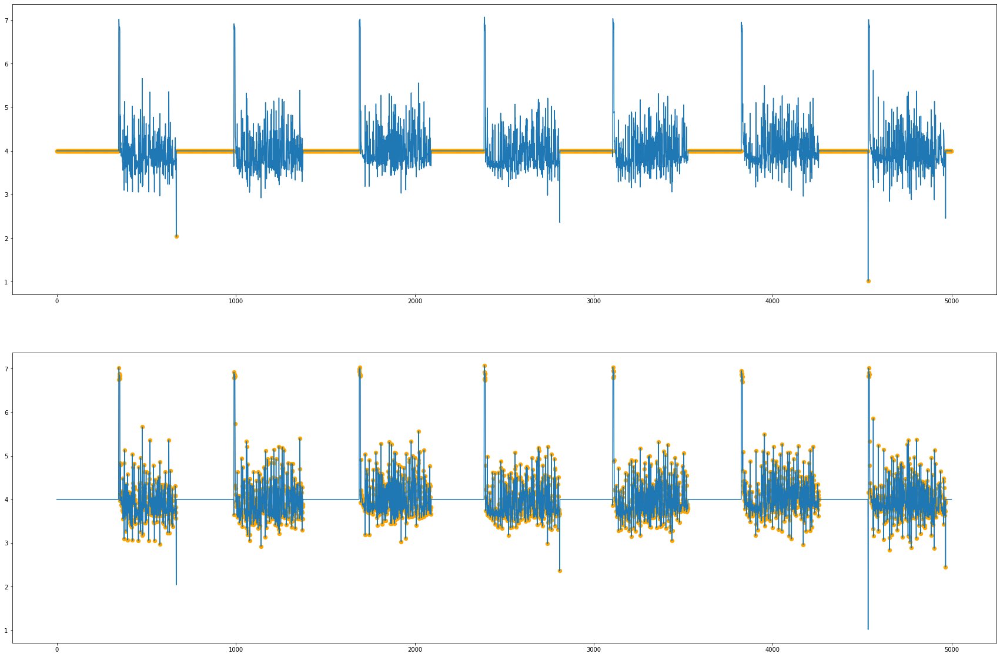

In [148]:
delta = 5000
y = np.arange(delta)
plt.figure(figsize=(30,20))
plt.subplot(2, 1, 1)
plt.plot(y, X[:delta])
plt.scatter(y[np.where(ans[:delta] == 1)], X[np.where(ans[:delta] == 1)], color='orange', s=40, marker='o')
plt.subplot(2, 1, 2)
plt.plot(y, X[:delta])
plt.scatter(y[np.where(ans[:delta] == 0)], X[np.where(ans[:delta] == 0)], color='orange', s=40, marker='o')

# Часы работы: удалить, когда выкл

In [212]:
not_zer = np.array(np.where(X > 1000))
not_zer = not_zer[0,: ]

In [215]:
work_X = []
work_time = []
for i in not_zer:
    #print(i)
    #print(enc_time[i])
    work_X.append(X[i])
    work_time.append(enc_time[i])
work_X = np.array(work_X)
#work_X = np.array(work_X[0,: ])
work_time = np.array(work_time)
#work_time = np.array(work_time[0,: ])

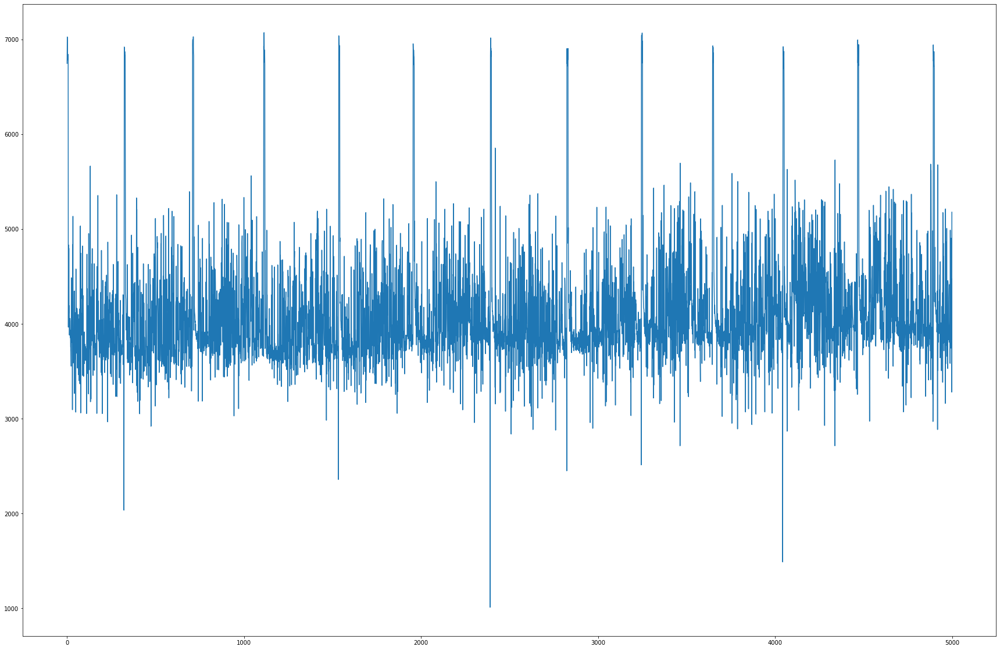

In [217]:
delta = 5000
y = np.arange(delta)
plt.figure(figsize=(30,20))
plt.plot(y, work_X[:delta])

In [218]:
z = np.array(np.column_stack([work_X, work_time]))

In [223]:
WS = 100
km = KMeans(n_clusters=3, random_state=0).fit(z)

ans = np.zeros(z.shape[0])
for i in range(z.shape[0] - WS):
    curr_z = z[i : i + WS]
    pred = km.predict(curr_z)
    ans[i : i + WS] += pred
    
for i in range(WS):
    ans[i] /= (i + 1)
    ans[ans.shape[0] - (i + 1)] /= (i + 1)

ans[WS:-WS] /= WS
ans[ans >= 0.5] = 1
ans[ans < 0.5] = 0

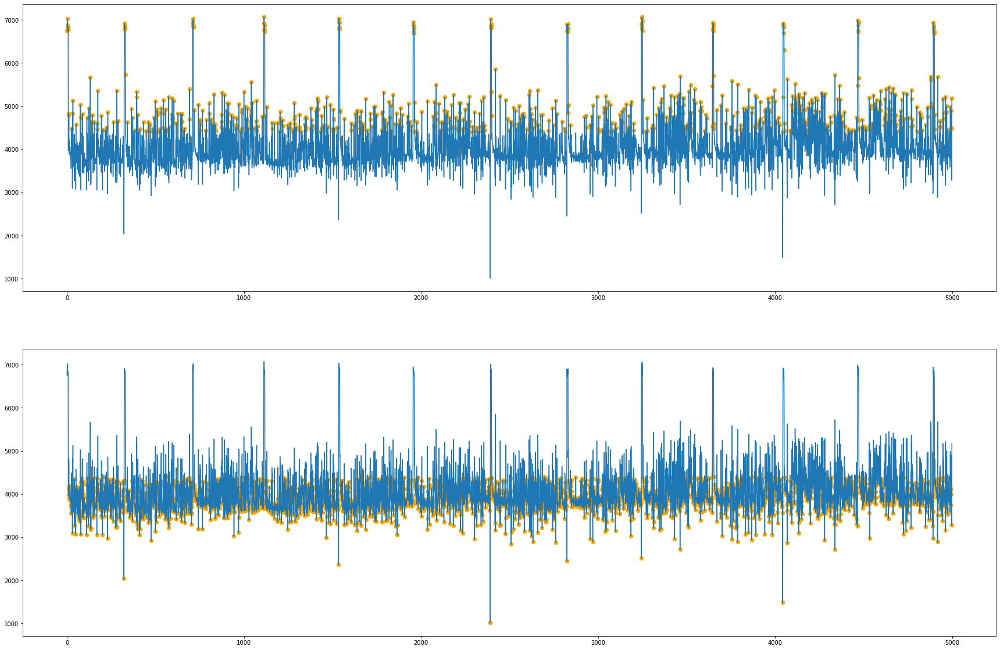

In [222]:
delta = 5000
y = np.arange(delta)
plt.figure(figsize=(30,20))
plt.subplot(2, 1, 1)
plt.plot(y, work_X[:delta])
plt.scatter(y[np.where(ans[:delta] == 1)], work_X[np.where(ans[:delta] == 1)], color='orange', s=40, marker='o')
plt.subplot(2, 1, 2)
plt.plot(y, work_X[:delta])
plt.scatter(y[np.where(ans[:delta] == 0)], work_X[np.where(ans[:delta] == 0)], color='orange', s=40, marker='o')

In [224]:
km = KMeans(n_clusters=3, random_state=0).fit(z)
pred = km.predict(z)

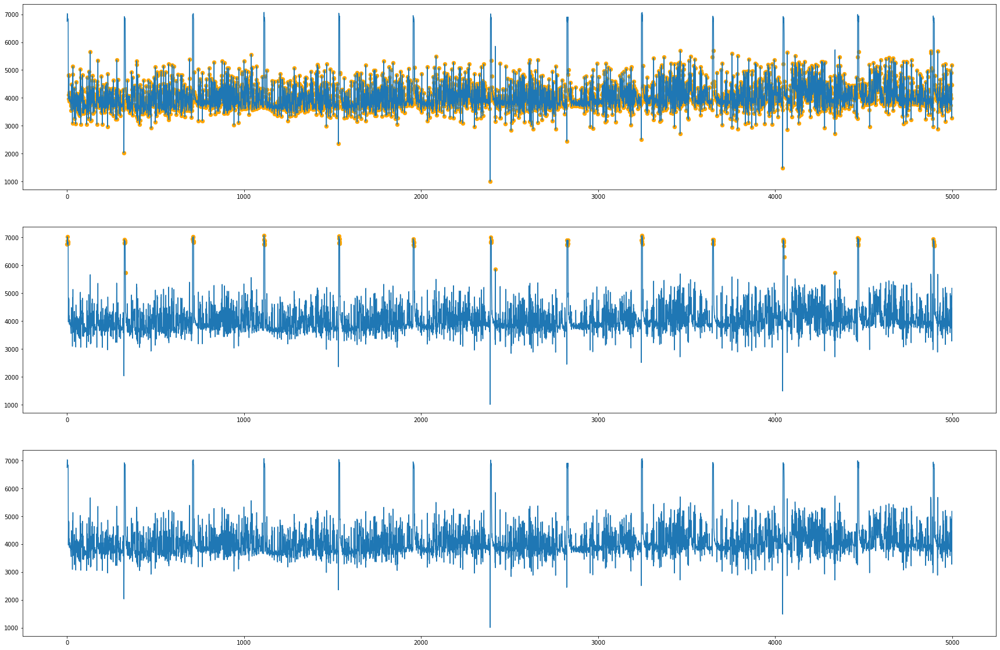

In [225]:
delta = 5000
y = np.arange(delta)
plt.figure(figsize=(30,20))
plt.subplot(3, 1, 1)
plt.plot(y, work_X[:delta])
plt.scatter(y[np.where(ans[:delta] == 1)], work_X[np.where(ans[:delta] == 1)], color='orange', s=40, marker='o')
plt.subplot(3, 1, 2)
plt.plot(y, work_X[:delta])
plt.scatter(y[np.where(ans[:delta] == 0)], work_X[np.where(ans[:delta] == 0)], color='orange', s=40, marker='o')
plt.subplot(3, 1, 3)
plt.plot(y, work_X[:delta])
plt.scatter(y[np.where(ans[:delta] == 2)], work_X[np.where(ans[:delta] == 2)], color='orange', s=40, marker='o')

# C  means

In [233]:
z = np.array(np.column_stack([X, enc_time[:100000]]))
fcm = FCM(n_clusters=2)
fcm.fit(z)
pred_soft = fcm.soft_predict(z)

In [234]:
pred_soft

array([[9.99987892e-01, 1.21079271e-05],
       [9.99987617e-01, 1.23828788e-05],
       [9.99987755e-01, 1.22450183e-05],
       ...,
       [1.32348350e-01, 8.67651650e-01],
       [1.20780953e-01, 8.79219047e-01],
       [2.47288064e-04, 9.99752712e-01]])

In [246]:
pred = []
for i in pred_soft:
    if i[0] < i[1]:
        pred.append(1)
    else:
        pred.append(0)
pred = np.array(pred)

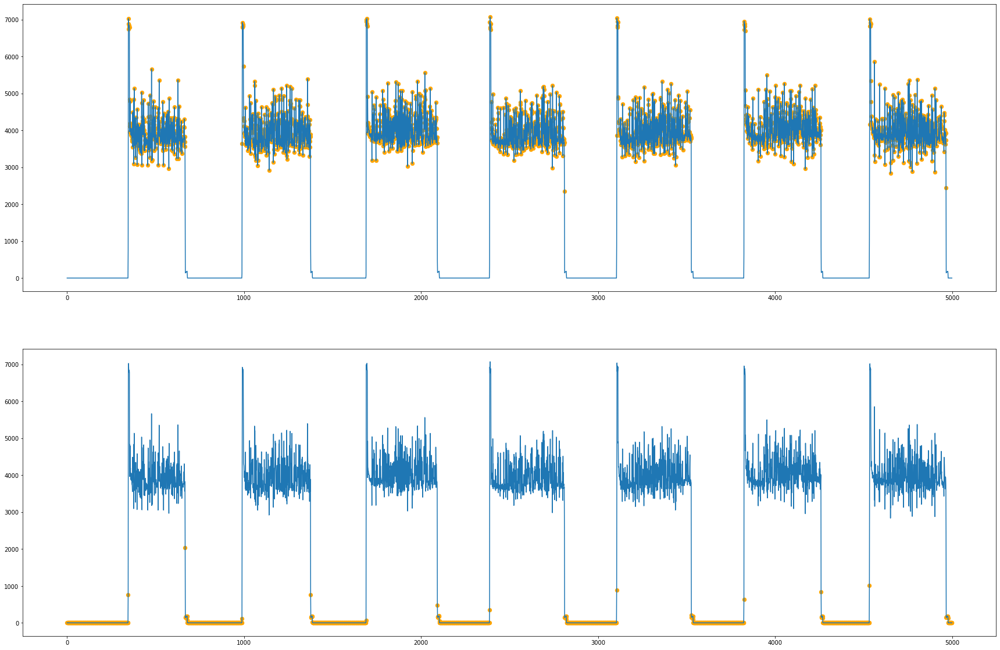

In [248]:
delta = 5000
y = np.arange(delta)
plt.figure(figsize=(30,20))
plt.subplot(2, 1, 1)
plt.plot(y, X[:delta])
plt.scatter(y[np.where(pred[:delta] == 1)], X[np.where(pred[:delta] == 1)], color='orange', s=40, marker='o')
plt.subplot(2, 1, 2)
plt.plot(y, X[:delta])
plt.scatter(y[np.where(pred[:delta] == 0)], X[np.where(pred[:delta] == 0)], color='orange', s=40, marker='o')

# Многомерные данные

X - первые 100к total AP max\
enc_time - первые 100к времени в кодировке


In [277]:
i = 0
j = 0
data = []
while (i <= len(elec) - 1) and (j <= len(temp)):
    print(i, j)
    if elec.event_timestamp[i] < temp.event_timestamp[j]:
        #data.append([elec.event_timestamp[i], X[i], np.NaN])
        i += 1
        #j += 1
    if elec.event_timestamp[i] == temp.event_timestamp[j]:
        data.append([elec.event_timestamp[i], X[i], temp.event_timestamp[j]])
        i += 1
        j += 1
    if elec.event_timestamp[i] > temp.event_timestamp[j]:
        i += 1

0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
15 0
16 0
17 0
18 0
19 0
20 0
21 0
22 0
23 0
24 0
25 0
26 0
27 0
28 0
29 0
30 0
31 0
32 0
33 0
34 0
35 0
36 0
37 0
38 0
39 0
40 0
41 0
42 0
43 0
44 0
45 0
46 0
47 0
48 0
49 0
50 0
51 0
52 0
53 0
54 0
55 0
56 0
57 0
58 0
59 0
60 0
61 0
62 0
63 0
64 0
65 0
66 0
67 0
68 0
69 0
70 0
71 0
72 0
73 0
74 0
75 0
76 0
77 0
78 0
79 0
80 0
81 0
82 0
83 0
84 0
85 0
86 0
87 0
88 0
89 0
90 0
91 0
92 0
93 0
94 0
95 0
96 0
97 0
98 0
99 0
100 0
101 0
102 0
103 0
104 0
105 0
106 0
107 0
108 0
109 0
110 0
111 0
112 0
113 0
114 0
115 0
116 0
117 0
118 0
119 0
120 0
121 0
122 0
123 0
124 0
125 0
126 0
127 0
128 0
129 0
130 0
131 0
132 0
133 0
134 0
135 0
136 0
137 0
138 0
139 0
140 0
141 0
142 0
143 0
144 0
145 0
146 0
147 0
148 0
149 0
150 0
151 0
152 0
153 0
154 0
155 0
156 0
157 0
158 0
159 0
160 0
161 0
162 0
163 0
164 0
165 0
166 0
167 0
168 0
169 0
170 0
171 0
172 0
173 0
174 0
175 0
176 0
177 0
178 0
179 0
180 0
181 0
182 0
183 0
184 0


1547 0
1548 0
1549 0
1550 0
1551 0
1552 0
1553 0
1554 0
1555 0
1556 0
1557 0
1558 0
1559 0
1560 0
1561 0
1562 0
1563 0
1564 0
1565 0
1566 0
1567 0
1568 0
1569 0
1570 0
1571 0
1572 0
1573 0
1574 0
1575 0
1576 0
1577 0
1578 0
1579 0
1580 0
1581 0
1582 0
1583 0
1584 0
1585 0
1586 0
1587 0
1588 0
1589 0
1590 0
1591 0
1592 0
1593 0
1594 0
1595 0
1596 0
1597 0
1598 0
1599 0
1600 0
1601 0
1602 0
1603 0
1604 0
1605 0
1606 0
1607 0
1608 0
1609 0
1610 0
1611 0
1612 0
1613 0
1614 0
1615 0
1616 0
1617 0
1618 0
1619 0
1620 0
1621 0
1622 0
1623 0
1624 0
1625 0
1626 0
1627 0
1628 0
1629 0
1630 0
1631 0
1632 0
1633 0
1634 0
1635 0
1636 0
1637 0
1638 0
1639 0
1640 0
1641 0
1642 0
1643 0
1644 0
1645 0
1646 0
1647 0
1648 0
1649 0
1650 0
1651 0
1652 0
1653 0
1654 0
1655 0
1656 0
1657 0
1658 0
1659 0
1660 0
1661 0
1662 0
1663 0
1664 0
1665 0
1666 0
1667 0
1668 0
1669 0
1670 0
1671 0
1672 0
1673 0
1674 0
1675 0
1676 0
1677 0
1678 0
1679 0
1680 0
1681 0
1682 0
1683 0
1684 0
1685 0
1686 0
1687 0
1688 0
1689 0

3233 0
3234 0
3235 0
3236 0
3237 0
3238 0
3239 0
3240 0
3241 0
3242 0
3243 0
3244 0
3245 0
3246 0
3247 0
3248 0
3249 0
3250 0
3251 0
3252 0
3253 0
3254 0
3255 0
3256 0
3257 0
3258 0
3259 0
3260 0
3261 0
3262 0
3263 0
3264 0
3265 0
3266 0
3267 0
3268 0
3269 0
3270 0
3271 0
3272 0
3273 0
3274 0
3275 0
3276 0
3277 0
3278 0
3279 0
3280 0
3281 0
3282 0
3283 0
3284 0
3285 0
3286 0
3287 0
3288 0
3289 0
3290 0
3291 0
3292 0
3293 0
3294 0
3295 0
3296 0
3297 0
3298 0
3299 0
3300 0
3301 0
3302 0
3303 0
3304 0
3305 0
3306 0
3307 0
3308 0
3309 0
3310 0
3311 0
3312 0
3313 0
3314 0
3315 0
3316 0
3317 0
3318 0
3319 0
3320 0
3321 0
3322 0
3323 0
3324 0
3325 0
3326 0
3327 0
3328 0
3329 0
3330 0
3331 0
3332 0
3333 0
3334 0
3335 0
3336 0
3337 0
3338 0
3339 0
3340 0
3341 0
3342 0
3343 0
3344 0
3345 0
3346 0
3347 0
3348 0
3349 0
3350 0
3351 0
3352 0
3353 0
3354 0
3355 0
3356 0
3357 0
3358 0
3359 0
3360 0
3361 0
3362 0
3363 0
3364 0
3365 0
3366 0
3367 0
3368 0
3369 0
3370 0
3371 0
3372 0
3373 0
3374 0
3375 0

4948 0
4949 0
4950 0
4951 0
4952 0
4953 0
4954 0
4955 0
4956 0
4957 0
4958 0
4959 0
4960 0
4961 0
4962 0
4963 0
4964 0
4965 0
4966 0
4967 0
4968 0
4969 0
4970 0
4971 0
4972 0
4973 0
4974 0
4975 0
4976 0
4977 0
4978 0
4979 0
4980 0
4981 0
4982 0
4983 0
4984 0
4985 0
4986 0
4987 0
4988 0
4989 0
4990 0
4991 0
4992 0
4993 0
4994 0
4995 0
4996 0
4997 0
4998 0
4999 0
5000 0
5001 0
5002 0
5003 0
5004 0
5005 0
5006 0
5007 0
5008 0
5009 0
5010 0
5011 0
5012 0
5013 0
5014 0
5015 0
5016 0
5017 0
5018 0
5019 0
5020 0
5021 0
5022 0
5023 0
5024 0
5025 0
5026 0
5027 0
5028 0
5029 0
5030 0
5031 0
5032 0
5033 0
5034 0
5035 0
5036 0
5037 0
5038 0
5039 0
5040 0
5041 0
5042 0
5043 0
5044 0
5045 0
5046 0
5047 0
5048 0
5049 0
5050 0
5051 0
5052 0
5053 0
5054 0
5055 0
5056 0
5057 0
5058 0
5059 0
5060 0
5061 0
5062 0
5063 0
5064 0
5065 0
5066 0
5067 0
5068 0
5069 0
5070 0
5071 0
5072 0
5073 0
5074 0
5075 0
5076 0
5077 0
5078 0
5079 0
5080 0
5081 0
5082 0
5083 0
5084 0
5085 0
5086 0
5087 0
5088 0
5089 0
5090 0

6611 1
6612 1
6613 1
6614 1
6615 1
6616 1
6617 1
6618 1
6619 1
6620 1
6621 1
6622 1
6623 1
6624 1
6625 1
6626 1
6627 1
6628 1
6629 1
6630 1
6631 1
6632 1
6633 1
6634 1
6635 1
6636 1
6637 1
6638 1
6639 1
6640 1
6641 1
6642 1
6643 1
6644 1
6645 1
6646 1
6647 1
6648 1
6649 1
6650 1
6651 1
6652 1
6653 1
6654 1
6655 1
6656 1
6657 1
6658 1
6659 1
6660 1
6661 1
6662 1
6663 1
6664 1
6665 1
6666 1
6667 1
6668 1
6669 1
6670 1
6671 1
6672 1
6673 1
6674 1
6675 1
6676 1
6677 1
6678 1
6679 1
6680 1
6681 1
6682 1
6683 1
6684 1
6685 1
6686 1
6687 1
6688 1
6689 1
6690 1
6691 1
6692 1
6693 1
6694 1
6695 1
6696 1
6697 1
6698 1
6699 1
6700 1
6701 1
6702 1
6703 1
6704 1
6705 1
6706 1
6707 1
6708 1
6709 1
6710 1
6711 1
6712 1
6713 1
6714 1
6715 1
6716 1
6717 1
6718 1
6719 1
6720 1
6721 1
6722 1
6723 1
6724 1
6725 1
6726 1
6727 1
6728 1
6729 1
6730 1
6731 1
6732 1
6733 1
6734 1
6735 1
6736 1
6737 1
6738 1
6739 1
6740 1
6741 1
6742 1
6743 1
6744 1
6745 1
6746 1
6747 1
6748 1
6749 1
6750 1
6751 1
6752 1
6753 1

8346 2
8347 2
8348 2
8349 2
8350 2
8351 2
8352 2
8353 2
8354 2
8355 2
8356 2
8357 2
8358 2
8359 2
8360 2
8361 2
8362 2
8363 2
8364 2
8365 2
8366 2
8367 2
8368 2
8369 2
8370 2
8371 2
8372 2
8373 2
8374 2
8375 2
8376 2
8377 2
8378 2
8379 2
8380 2
8381 2
8382 2
8383 2
8384 2
8385 2
8386 2
8387 2
8388 2
8389 2
8390 2
8391 2
8392 2
8393 2
8394 2
8395 2
8396 2
8397 2
8398 2
8399 2
8400 2
8401 2
8402 2
8403 2
8404 2
8405 2
8406 2
8407 2
8408 2
8409 2
8410 2
8411 2
8412 2
8413 2
8414 2
8415 2
8416 2
8417 2
8418 2
8419 2
8420 2
8421 2
8422 2
8423 2
8424 2
8425 2
8426 2
8427 2
8428 2
8429 2
8430 2
8431 2
8432 2
8433 2
8434 2
8435 2
8436 2
8437 2
8438 2
8439 2
8440 2
8441 2
8442 2
8443 2
8444 2
8445 2
8446 2
8447 2
8448 2
8449 2
8450 2
8451 2
8452 2
8453 2
8454 2
8455 2
8456 2
8457 2
8458 2
8459 2
8460 2
8461 2
8462 2
8463 2
8464 2
8465 2
8466 2
8467 2
8468 2
8469 2
8470 2
8471 2
8472 2
8473 2
8474 2
8475 2
8476 2
8477 2
8478 2
8479 2
8480 2
8481 2
8482 2
8483 2
8484 2
8485 2
8486 2
8487 2
8488 2

10111 2
10112 2
10113 2
10114 2
10115 2
10116 2
10117 2
10118 2
10119 2
10120 2
10121 2
10122 2
10123 2
10124 2
10125 2
10126 2
10127 2
10128 2
10129 2
10130 2
10131 2
10132 2
10133 2
10134 2
10135 2
10136 2
10137 2
10138 2
10139 2
10140 2
10141 2
10142 2
10143 2
10144 2
10145 2
10146 2
10147 2
10148 2
10149 2
10150 2
10151 2
10152 2
10153 2
10154 2
10155 2
10156 2
10157 2
10158 2
10159 2
10160 2
10161 2
10162 2
10163 2
10164 2
10165 2
10166 2
10167 2
10168 2
10169 2
10170 2
10171 2
10172 2
10173 2
10174 2
10175 2
10176 2
10177 2
10178 2
10179 2
10180 2
10181 2
10182 2
10183 2
10184 2
10185 2
10186 2
10187 2
10188 2
10189 2
10190 2
10191 2
10192 2
10193 2
10194 2
10195 2
10196 2
10197 2
10198 2
10199 2
10200 2
10201 2
10202 2
10203 2
10204 2
10205 2
10206 2
10207 2
10208 2
10209 2
10210 2
10211 2
10212 2
10213 2
10214 2
10215 2
10216 2
10217 2
10218 2
10219 2
10220 2
10221 2
10222 2
10223 2
10224 2
10225 2
10226 2
10227 2
10228 2
10229 2
10230 2
10231 2
10232 2
10233 2
10234 2
10235 2


11959 2
11960 2
11961 2
11962 2
11963 2
11964 2
11965 2
11966 2
11967 2
11968 2
11969 2
11970 2
11971 2
11972 2
11973 2
11974 2
11975 2
11976 2
11977 2
11978 2
11979 2
11980 2
11981 2
11982 2
11983 2
11984 2
11985 2
11986 2
11987 2
11988 2
11989 2
11990 2
11991 2
11992 2
11993 2
11994 2
11995 2
11996 2
11997 2
11998 2
11999 2
12000 2
12001 2
12002 2
12003 2
12004 2
12005 2
12006 2
12007 2
12008 2
12009 2
12010 2
12011 2
12012 2
12013 2
12014 2
12015 2
12016 2
12017 2
12018 2
12019 2
12020 2
12021 2
12022 2
12023 2
12024 2
12025 2
12026 2
12027 2
12028 2
12029 2
12030 2
12031 2
12032 2
12033 2
12034 2
12035 2
12036 2
12037 2
12038 2
12039 2
12040 2
12041 2
12042 2
12043 2
12044 2
12045 2
12046 2
12047 2
12048 2
12049 2
12050 2
12051 2
12052 2
12053 2
12054 2
12055 2
12056 2
12057 2
12058 2
12059 2
12060 2
12061 2
12062 2
12063 2
12064 2
12065 2
12066 2
12067 2
12068 2
12069 2
12070 2
12071 2
12072 2
12073 2
12074 2
12075 2
12076 2
12077 2
12078 2
12079 2
12080 2
12081 2
12082 2
12083 2


13763 2
13764 2
13765 2
13766 2
13767 2
13768 2
13769 2
13770 2
13771 2
13772 2
13773 2
13774 2
13775 2
13776 2
13777 2
13778 2
13779 2
13780 2
13781 2
13782 2
13783 2
13784 2
13785 2
13786 2
13787 2
13788 2
13789 2
13790 2
13791 2
13792 2
13793 2
13794 2
13795 2
13796 2
13797 2
13798 2
13799 2
13800 2
13801 2
13802 2
13803 2
13804 2
13805 2
13806 2
13807 2
13808 2
13809 2
13810 2
13811 2
13812 2
13813 2
13814 2
13815 2
13816 2
13817 2
13818 2
13819 2
13820 2
13821 2
13822 2
13823 2
13824 2
13825 2
13826 2
13827 2
13828 2
13829 2
13830 2
13831 2
13832 2
13833 2
13834 2
13835 2
13836 2
13837 2
13838 2
13839 2
13840 2
13841 2
13842 2
13843 2
13844 2
13845 2
13846 2
13847 2
13848 2
13849 2
13850 2
13851 2
13852 2
13853 2
13854 2
13855 2
13856 2
13857 2
13858 2
13859 2
13860 2
13861 2
13862 2
13863 2
13864 2
13865 2
13866 2
13867 2
13868 2
13869 2
13870 2
13871 2
13872 2
13873 2
13874 2
13875 2
13876 2
13877 2
13878 2
13879 2
13880 2
13881 2
13882 2
13883 2
13884 2
13885 2
13886 2
13887 2


15547 2
15548 2
15549 2
15550 2
15551 2
15552 2
15553 2
15554 2
15555 2
15556 2
15557 2
15558 2
15559 2
15560 2
15561 2
15562 2
15563 2
15564 2
15565 2
15566 2
15567 2
15568 2
15569 2
15570 2
15571 2
15572 2
15573 2
15574 2
15575 2
15576 2
15577 2
15578 2
15579 2
15580 2
15581 2
15582 2
15583 2
15584 2
15585 2
15586 2
15587 2
15588 2
15589 2
15590 2
15591 2
15592 2
15593 2
15594 2
15595 2
15596 2
15597 2
15598 2
15599 2
15600 2
15601 2
15602 2
15603 2
15604 2
15605 2
15606 2
15607 2
15608 2
15609 2
15610 2
15611 2
15612 2
15613 2
15614 2
15615 2
15616 2
15617 2
15618 2
15619 2
15620 2
15621 2
15622 2
15623 2
15624 2
15625 2
15626 2
15627 2
15628 2
15629 2
15630 2
15631 2
15632 2
15633 2
15634 2
15635 2
15636 2
15637 2
15638 2
15639 2
15640 2
15641 2
15642 2
15643 2
15644 2
15645 2
15646 2
15647 2
15648 2
15649 2
15650 2
15651 2
15652 2
15653 2
15654 2
15655 2
15656 2
15657 2
15658 2
15659 2
15660 2
15661 2
15662 2
15663 2
15664 2
15665 2
15666 2
15667 2
15668 2
15669 2
15670 2
15671 2


17296 2
17297 2
17298 2
17299 2
17300 2
17301 2
17302 2
17303 2
17304 2
17305 2
17306 2
17307 2
17308 2
17309 2
17310 2
17311 2
17312 2
17313 2
17314 2
17315 2
17316 2
17317 2
17318 2
17319 2
17320 2
17321 2
17322 2
17323 2
17324 2
17325 2
17326 2
17327 2
17328 2
17329 2
17330 2
17331 2
17332 2
17333 2
17334 2
17335 2
17336 2
17337 2
17338 2
17339 2
17340 2
17341 2
17342 2
17343 2
17344 2
17345 2
17346 2
17347 2
17348 2
17349 2
17350 2
17351 2
17352 2
17353 2
17354 2
17355 2
17356 2
17357 2
17358 2
17359 2
17360 2
17361 2
17362 2
17363 2
17364 2
17365 2
17366 2
17367 2
17368 2
17369 2
17370 2
17371 2
17372 2
17373 2
17374 2
17375 2
17376 2
17377 2
17378 2
17379 2
17380 2
17381 2
17382 2
17383 2
17384 2
17385 2
17386 2
17387 2
17388 2
17389 2
17390 2
17391 2
17392 2
17393 2
17394 2
17395 2
17396 2
17397 2
17398 2
17399 2
17400 2
17401 2
17402 2
17403 2
17404 2
17405 2
17406 2
17407 2
17408 2
17409 2
17410 2
17411 2
17412 2
17413 2
17414 2
17415 2
17416 2
17417 2
17418 2
17419 2
17420 2


19109 2
19110 2
19111 2
19112 2
19113 2
19114 2
19115 2
19116 2
19117 2
19118 2
19119 2
19120 2
19121 2
19122 2
19123 2
19124 2
19125 2
19126 2
19127 2
19128 2
19129 2
19130 2
19131 2
19132 2
19133 2
19134 2
19135 2
19136 2
19137 2
19138 2
19139 2
19140 2
19141 2
19142 2
19143 2
19144 2
19145 2
19146 2
19147 2
19148 2
19149 2
19150 2
19151 2
19152 2
19153 2
19154 2
19155 2
19156 2
19157 2
19158 2
19159 2
19160 2
19161 2
19162 2
19163 2
19164 2
19165 2
19166 2
19167 2
19168 2
19169 2
19170 2
19171 2
19172 2
19173 2
19174 2
19175 2
19176 2
19177 2
19178 2
19179 2
19180 2
19181 2
19182 2
19183 2
19184 2
19185 2
19186 2
19187 2
19188 2
19189 2
19190 2
19191 2
19192 2
19193 2
19194 2
19195 2
19196 2
19197 2
19198 2
19199 2
19200 2
19201 2
19202 2
19203 2
19204 2
19205 2
19206 2
19207 2
19208 2
19209 2
19210 2
19211 2
19212 2
19213 2
19214 2
19215 2
19216 2
19217 2
19218 2
19219 2
19220 2
19221 2
19222 2
19223 2
19224 2
19225 2
19226 2
19227 2
19228 2
19229 2
19230 2
19231 2
19232 2
19233 2


20973 2
20974 2
20975 2
20976 2
20977 2
20978 2
20979 2
20980 2
20981 2
20982 2
20983 2
20984 2
20985 2
20986 2
20987 2
20988 2
20989 2
20990 2
20991 2
20992 2
20993 2
20994 2
20995 2
20996 2
20997 2
20998 2
20999 2
21000 2
21001 2
21002 2
21003 2
21004 2
21005 2
21006 2
21007 2
21008 2
21009 2
21010 2
21011 2
21012 2
21013 2
21014 2
21015 2
21016 2
21017 2
21018 2
21019 2
21020 2
21021 2
21022 2
21023 2
21024 2
21025 2
21026 2
21027 2
21028 2
21029 2
21030 2
21031 2
21032 2
21033 2
21034 2
21035 2
21036 2
21037 2
21038 2
21039 2
21040 2
21041 2
21042 2
21043 2
21044 2
21045 2
21046 2
21047 2
21048 2
21049 2
21050 2
21051 2
21052 2
21053 2
21054 2
21055 2
21056 2
21057 2
21058 2
21059 2
21060 2
21061 2
21062 2
21063 2
21064 2
21065 2
21066 2
21067 2
21068 2
21069 2
21070 2
21071 2
21072 2
21073 2
21074 2
21075 2
21076 2
21077 2
21078 2
21079 2
21080 2
21081 2
21082 2
21083 2
21084 2
21085 2
21086 2
21087 2
21088 2
21089 2
21090 2
21091 2
21092 2
21093 2
21094 2
21095 2
21096 2
21097 2


22796 2
22797 2
22798 2
22799 2
22800 2
22801 2
22802 2
22803 2
22804 2
22805 2
22806 2
22807 2
22808 2
22809 2
22810 2
22811 2
22812 2
22813 2
22814 2
22815 2
22816 2
22817 2
22818 2
22819 2
22820 2
22821 2
22822 2
22823 2
22824 2
22825 2
22826 2
22828 3
22829 3
22830 3
22831 3
22832 3
22833 3
22834 3
22835 3
22836 3
22837 3
22838 3
22839 3
22840 3
22841 3
22842 3
22843 3
22844 3
22845 3
22846 3
22847 3
22848 3
22849 3
22850 3
22851 3
22852 3
22853 3
22854 3
22855 3
22856 3
22857 3
22858 3
22859 3
22860 3
22861 3
22862 3
22863 3
22864 3
22865 3
22866 3
22867 3
22868 3
22869 3
22870 3
22871 3
22872 3
22873 3
22874 3
22875 3
22876 3
22877 3
22878 3
22879 3
22880 3
22881 3
22882 3
22883 3
22884 3
22885 3
22886 3
22887 3
22888 3
22889 3
22890 3
22891 3
22892 3
22893 3
22894 3
22895 3
22896 3
22897 3
22898 3
22899 3
22900 3
22901 3
22902 3
22903 3
22904 3
22905 3
22906 3
22907 3
22908 3
22909 3
22910 3
22911 3
22912 3
22913 3
22914 3
22915 3
22916 3
22917 3
22918 3
22919 3
22920 3
22921 3


24546 3
24547 3
24548 3
24549 3
24550 3
24551 3
24552 3
24553 3
24554 3
24555 3
24556 3
24557 3
24558 3
24559 3
24560 3
24561 3
24562 3
24563 3
24564 3
24565 3
24566 3
24567 3
24568 3
24569 3
24570 3
24571 3
24572 3
24573 3
24574 3
24575 3
24576 3
24577 3
24578 3
24579 3
24580 3
24581 3
24582 3
24583 3
24584 3
24585 3
24586 3
24587 3
24588 3
24589 3
24590 3
24591 3
24592 3
24593 3
24594 3
24595 3
24596 3
24597 3
24598 3
24599 3
24600 3
24601 3
24602 3
24603 3
24604 3
24605 3
24606 3
24607 3
24608 3
24609 3
24610 3
24611 3
24612 3
24613 3
24614 3
24615 3
24616 3
24617 3
24618 3
24619 3
24620 3
24621 3
24622 3
24623 3
24624 3
24625 3
24626 3
24627 3
24628 3
24629 3
24630 3
24631 3
24632 3
24633 3
24634 3
24635 3
24636 3
24637 3
24638 3
24639 3
24640 3
24641 3
24642 3
24643 3
24644 3
24645 3
24646 3
24647 3
24648 3
24649 3
24650 3
24651 3
24652 3
24653 3
24654 3
24655 3
24656 3
24657 3
24658 3
24659 3
24660 3
24661 3
24662 3
24663 3
24664 3
24665 3
24666 3
24667 3
24668 3
24669 3
24670 3


26366 3
26367 3
26368 3
26369 3
26370 3
26371 3
26372 3
26373 3
26374 3
26375 3
26376 3
26377 3
26378 3
26379 3
26380 3
26381 3
26382 3
26383 3
26384 3
26385 3
26386 3
26387 3
26388 3
26389 3
26390 3
26391 3
26392 3
26393 3
26394 3
26395 3
26396 3
26397 3
26398 3
26399 3
26400 3
26401 3
26402 3
26403 3
26404 3
26405 3
26406 3
26407 3
26408 3
26409 3
26410 3
26411 3
26412 3
26413 3
26414 3
26415 3
26416 3
26417 3
26418 3
26419 3
26420 3
26421 3
26422 3
26423 3
26424 3
26425 3
26426 3
26427 3
26428 3
26429 3
26430 3
26431 3
26432 3
26433 3
26434 3
26435 3
26436 3
26437 3
26438 3
26439 3
26440 3
26441 3
26442 3
26443 3
26444 3
26445 3
26446 3
26447 3
26448 3
26449 3
26450 3
26451 3
26452 3
26453 3
26454 3
26455 3
26456 3
26457 3
26458 3
26459 3
26460 3
26461 3
26462 3
26463 3
26464 3
26465 3
26466 3
26467 3
26468 3
26469 3
26470 3
26471 3
26472 3
26473 3
26474 3
26475 3
26476 3
26477 3
26478 3
26479 3
26480 3
26481 3
26482 3
26483 3
26484 3
26485 3
26486 3
26487 3
26488 3
26489 3
26490 3


28111 3
28112 3
28113 3
28114 3
28115 3
28116 3
28117 3
28118 3
28119 3
28120 3
28121 3
28122 3
28123 3
28124 3
28125 3
28126 3
28127 3
28128 3
28129 3
28130 3
28131 3
28132 3
28133 3
28134 3
28135 3
28136 3
28137 3
28138 3
28139 3
28140 3
28141 3
28142 3
28143 3
28144 3
28145 3
28146 3
28147 3
28148 3
28149 3
28150 3
28151 3
28152 3
28153 3
28154 3
28155 3
28156 3
28157 3
28158 3
28159 3
28160 3
28161 3
28162 3
28163 3
28164 3
28165 3
28166 3
28167 3
28168 3
28169 3
28170 3
28171 3
28172 3
28173 3
28174 3
28175 3
28176 3
28177 3
28178 3
28179 3
28180 3
28181 3
28182 3
28183 3
28184 3
28185 3
28186 3
28187 3
28188 3
28189 3
28190 3
28191 3
28192 3
28193 3
28194 3
28195 3
28196 3
28197 3
28198 3
28199 3
28200 3
28201 3
28202 3
28203 3
28204 3
28205 3
28206 3
28207 3
28208 3
28209 3
28210 3
28211 3
28212 3
28213 3
28214 3
28215 3
28216 3
28217 3
28218 3
28219 3
28220 3
28221 3
28222 3
28223 3
28224 3
28225 3
28226 3
28227 3
28228 3
28229 3
28230 3
28231 3
28232 3
28233 3
28234 3
28235 3


29943 3
29944 3
29945 3
29946 3
29947 3
29948 3
29949 3
29950 3
29951 3
29952 3
29953 3
29954 3
29955 3
29956 3
29957 3
29958 3
29959 3
29960 3
29961 3
29962 3
29963 3
29964 3
29965 3
29966 3
29967 3
29968 3
29969 3
29970 3
29971 3
29972 3
29973 3
29974 3
29975 3
29976 3
29977 3
29978 3
29979 3
29980 3
29981 3
29982 3
29983 3
29984 3
29985 3
29986 3
29987 3
29988 3
29989 3
29990 3
29991 3
29992 3
29993 3
29994 3
29995 3
29996 3
29997 3
29998 3
29999 3
30000 3
30001 3
30002 3
30003 3
30004 3
30005 3
30006 3
30007 3
30008 3
30009 3
30010 3
30011 3
30012 3
30013 3
30014 3
30015 3
30016 3
30017 3
30018 3
30019 3
30020 3
30021 3
30022 3
30023 3
30024 3
30025 3
30026 3
30027 3
30028 3
30029 3
30030 3
30031 3
30032 3
30033 3
30034 3
30035 3
30036 3
30037 3
30038 3
30039 3
30040 3
30041 3
30042 3
30043 3
30044 3
30045 3
30046 3
30047 3
30048 3
30049 3
30050 3
30051 3
30052 3
30053 3
30054 3
30055 3
30056 3
30057 3
30058 3
30059 3
30060 3
30061 3
30062 3
30063 3
30064 3
30065 3
30066 3
30067 3


31766 3
31767 3
31768 3
31769 3
31770 3
31771 3
31772 3
31773 3
31774 3
31775 3
31776 3
31777 3
31778 3
31779 3
31780 3
31781 3
31782 3
31783 3
31784 3
31785 3
31786 3
31787 3
31788 3
31789 3
31790 3
31791 3
31792 3
31793 3
31794 3
31795 3
31796 3
31797 3
31798 3
31799 3
31800 3
31801 3
31802 3
31803 3
31804 3
31805 3
31806 3
31807 3
31808 3
31809 3
31810 3
31811 3
31812 3
31813 3
31814 3
31815 3
31816 3
31817 3
31818 3
31819 3
31820 3
31821 3
31822 3
31823 3
31824 3
31825 3
31826 3
31827 3
31828 3
31829 3
31830 3
31831 3
31832 3
31833 3
31834 3
31835 3
31836 3
31837 3
31838 3
31839 3
31840 3
31841 3
31842 3
31843 3
31844 3
31845 3
31846 3
31847 3
31848 3
31849 3
31850 3
31851 3
31852 3
31853 3
31854 3
31855 3
31856 3
31857 3
31858 3
31859 3
31860 3
31861 3
31862 3
31863 3
31864 3
31865 3
31866 3
31867 3
31868 3
31869 3
31870 3
31871 3
31872 3
31873 3
31874 3
31875 3
31876 3
31877 3
31878 3
31879 3
31880 3
31881 3
31882 3
31883 3
31884 3
31885 3
31886 3
31887 3
31888 3
31889 3
31890 3


33503 3
33504 3
33505 3
33506 3
33507 3
33508 3
33509 3
33510 3
33511 3
33512 3
33513 3
33514 3
33515 3
33516 3
33517 3
33518 3
33519 3
33520 3
33521 3
33522 3
33523 3
33524 3
33525 3
33526 3
33527 3
33528 3
33529 3
33530 3
33531 3
33532 3
33533 3
33534 3
33535 3
33536 3
33537 3
33538 3
33539 3
33540 3
33541 3
33542 3
33543 3
33544 3
33545 3
33546 3
33547 3
33548 3
33549 3
33550 3
33551 3
33552 3
33553 3
33554 3
33555 3
33556 3
33557 3
33558 3
33559 3
33560 3
33561 3
33562 3
33563 3
33564 3
33565 3
33566 3
33567 3
33568 3
33569 3
33570 3
33571 3
33572 3
33573 3
33574 3
33575 3
33576 3
33577 3
33578 3
33579 3
33580 3
33581 3
33582 3
33583 3
33584 3
33585 3
33586 3
33587 3
33588 3
33589 3
33590 3
33591 3
33592 3
33593 3
33594 3
33595 3
33596 3
33597 3
33598 3
33599 3
33600 3
33601 3
33602 3
33603 3
33604 3
33605 3
33606 3
33607 3
33608 3
33609 3
33610 3
33611 3
33612 3
33613 3
33614 3
33615 3
33616 3
33617 3
33618 3
33619 3
33620 3
33621 3
33622 3
33623 3
33624 3
33625 3
33626 3
33627 3


35216 3
35217 3
35218 3
35219 3
35220 3
35221 3
35222 3
35223 3
35224 3
35225 3
35226 3
35227 3
35229 4
35230 4
35231 4
35232 4
35233 4
35234 4
35235 4
35236 4
35237 4
35238 4
35239 4
35240 4
35241 4
35242 4
35243 4
35244 4
35245 4
35246 4
35247 4
35248 4
35249 4
35250 4
35251 4
35252 4
35253 4
35254 4
35255 4
35256 4
35257 4
35258 4
35259 4
35260 4
35261 4
35262 4
35263 4
35264 4
35265 4
35266 4
35267 4
35268 4
35269 4
35270 4
35271 4
35272 4
35273 4
35274 4
35275 4
35276 4
35277 4
35278 4
35279 4
35280 4
35281 4
35282 4
35283 4
35284 4
35285 4
35286 4
35287 4
35288 4
35289 4
35290 4
35291 4
35292 4
35293 4
35294 4
35295 4
35296 4
35297 4
35298 4
35299 4
35300 4
35301 4
35302 4
35303 4
35304 4
35305 4
35306 4
35307 4
35308 4
35309 4
35310 4
35311 4
35312 4
35313 4
35314 4
35315 4
35316 4
35317 4
35318 4
35319 4
35320 4
35321 4
35322 4
35323 4
35324 4
35325 4
35326 4
35327 4
35328 4
35329 4
35330 4
35331 4
35332 4
35333 4
35334 4
35335 4
35336 4
35337 4
35338 4
35339 4
35340 4
35341 4


37037 4
37038 4
37039 4
37040 4
37041 4
37042 4
37043 4
37044 4
37045 4
37046 4
37047 4
37048 4
37049 4
37050 4
37051 4
37052 4
37053 4
37054 4
37055 4
37056 4
37057 4
37058 4
37059 4
37060 4
37061 4
37062 4
37063 4
37064 4
37065 4
37066 4
37067 4
37068 4
37069 4
37070 4
37071 4
37072 4
37073 4
37074 4
37075 4
37076 4
37077 4
37078 4
37079 4
37080 4
37081 4
37082 4
37083 4
37084 4
37085 4
37086 4
37087 4
37088 4
37089 4
37090 4
37091 4
37092 4
37093 4
37094 4
37095 4
37096 4
37097 4
37098 4
37099 4
37100 4
37101 4
37102 4
37103 4
37104 4
37105 4
37106 4
37107 4
37108 4
37109 4
37110 4
37111 4
37112 4
37113 4
37114 4
37115 4
37116 4
37117 4
37118 4
37119 4
37120 4
37121 4
37122 4
37123 4
37124 4
37125 4
37126 4
37127 4
37128 4
37129 4
37130 4
37131 4
37132 4
37133 4
37134 4
37135 4
37136 4
37137 4
37138 4
37139 4
37140 4
37141 4
37142 4
37143 4
37144 4
37145 4
37146 4
37147 4
37148 4
37149 4
37150 4
37151 4
37152 4
37153 4
37154 4
37155 4
37156 4
37157 4
37158 4
37159 4
37160 4
37161 4


38795 4
38796 4
38797 4
38798 4
38799 4
38800 4
38801 4
38802 4
38803 4
38804 4
38805 4
38806 4
38807 4
38808 4
38809 4
38810 4
38811 4
38812 4
38813 4
38814 4
38815 4
38816 4
38817 4
38818 4
38819 4
38820 4
38821 4
38822 4
38823 4
38824 4
38825 4
38826 4
38827 4
38828 4
38829 4
38830 4
38831 4
38832 4
38833 4
38834 4
38835 4
38836 4
38837 4
38838 4
38839 4
38840 4
38841 4
38842 4
38843 4
38844 4
38845 4
38846 4
38847 4
38848 4
38849 4
38850 4
38851 4
38852 4
38853 4
38854 4
38855 4
38856 4
38857 4
38858 4
38859 4
38860 4
38861 4
38862 4
38863 4
38864 4
38865 4
38866 4
38867 4
38868 4
38869 4
38870 4
38871 4
38872 4
38873 4
38874 4
38875 4
38876 4
38877 4
38878 4
38879 4
38880 4
38881 4
38882 4
38883 4
38884 4
38885 4
38886 4
38887 4
38888 4
38889 4
38890 4
38891 4
38892 4
38893 4
38894 4
38895 4
38896 4
38897 4
38898 4
38899 4
38900 4
38901 4
38902 4
38903 4
38904 4
38905 4
38906 4
38907 4
38908 4
38909 4
38910 4
38911 4
38912 4
38913 4
38914 4
38915 4
38916 4
38917 4
38918 4
38919 4


40515 4
40516 4
40517 4
40518 4
40519 4
40520 4
40521 4
40522 4
40523 4
40524 4
40525 4
40526 4
40527 4
40528 4
40529 4
40530 4
40531 4
40532 4
40533 4
40534 4
40535 4
40536 4
40537 4
40538 4
40539 4
40540 4
40541 4
40542 4
40543 4
40544 4
40545 4
40546 4
40547 4
40548 4
40549 4
40550 4
40551 4
40552 4
40553 4
40554 4
40555 4
40556 4
40557 4
40558 4
40559 4
40560 4
40561 4
40562 4
40563 4
40564 4
40565 4
40566 4
40567 4
40568 4
40569 4
40570 4
40571 4
40572 4
40573 4
40574 4
40575 4
40576 4
40577 4
40578 4
40579 4
40580 4
40581 4
40582 4
40583 4
40584 4
40585 4
40586 4
40587 4
40588 4
40589 4
40590 4
40591 4
40592 4
40593 4
40594 4
40595 4
40596 4
40597 4
40598 4
40599 4
40600 4
40601 4
40602 4
40603 4
40604 4
40605 4
40606 4
40607 4
40608 4
40609 4
40610 4
40611 4
40612 4
40613 4
40614 4
40615 4
40616 4
40617 4
40618 4
40619 4
40620 4
40621 4
40622 4
40623 4
40624 4
40625 4
40626 4
40627 4
40628 4
40629 4
40630 4
40631 4
40632 4
40633 4
40634 4
40635 4
40636 4
40637 4
40638 4
40639 4


42207 4
42208 4
42209 4
42210 4
42211 4
42212 4
42213 4
42214 4
42215 4
42216 4
42217 4
42218 4
42219 4
42220 4
42221 4
42222 4
42223 4
42224 4
42225 4
42226 4
42227 4
42228 4
42229 4
42230 4
42231 4
42232 4
42233 4
42234 4
42235 4
42236 4
42237 4
42238 4
42239 4
42240 4
42241 4
42242 4
42243 4
42244 4
42245 4
42246 4
42247 4
42248 4
42249 4
42250 4
42251 4
42252 4
42253 4
42254 4
42255 4
42256 4
42257 4
42258 4
42259 4
42260 4
42261 4
42262 4
42263 4
42264 4
42265 4
42266 4
42267 4
42268 4
42269 4
42270 4
42271 4
42272 4
42273 4
42274 4
42275 4
42276 4
42277 4
42278 4
42279 4
42280 4
42281 4
42282 4
42283 4
42284 4
42285 4
42286 4
42287 4
42288 4
42289 4
42290 4
42291 4
42292 4
42293 4
42294 4
42295 4
42296 4
42297 4
42298 4
42299 4
42300 4
42301 4
42302 4
42303 4
42304 4
42305 4
42306 4
42307 4
42308 4
42309 4
42310 4
42311 4
42312 4
42313 4
42314 4
42315 4
42316 4
42317 4
42318 4
42319 4
42320 4
42321 4
42322 4
42323 4
42324 4
42325 4
42326 4
42327 4
42328 4
42329 4
42330 4
42331 4


43962 4
43963 4
43964 4
43965 4
43966 4
43967 4
43968 4
43969 4
43970 4
43971 4
43972 4
43973 4
43974 4
43975 4
43976 4
43977 4
43978 4
43979 4
43980 4
43981 4
43982 4
43983 4
43984 4
43985 4
43986 4
43987 4
43988 4
43989 4
43990 4
43991 4
43992 4
43993 4
43994 4
43995 4
43996 4
43997 4
43998 4
43999 4
44000 4
44001 4
44002 4
44003 4
44004 4
44005 4
44006 4
44007 4
44008 4
44009 4
44010 4
44011 4
44012 4
44013 4
44014 4
44015 4
44016 4
44017 4
44018 4
44019 4
44020 4
44021 4
44022 4
44023 4
44024 4
44025 4
44026 4
44027 4
44028 4
44029 4
44030 4
44031 4
44032 4
44033 4
44034 4
44035 4
44036 4
44037 4
44038 4
44039 4
44040 4
44041 4
44042 4
44043 4
44044 4
44045 4
44046 4
44047 4
44048 4
44049 4
44050 4
44051 4
44052 4
44053 4
44054 4
44055 4
44056 4
44057 4
44058 4
44059 4
44060 4
44061 4
44062 4
44063 4
44064 4
44065 4
44066 4
44067 4
44068 4
44069 4
44070 4
44071 4
44072 4
44073 4
44074 4
44075 4
44076 4
44077 4
44078 4
44079 4
44080 4
44081 4
44082 4
44083 4
44084 4
44085 4
44086 4


45702 4
45703 4
45704 4
45705 4
45706 4
45707 4
45708 4
45709 4
45710 4
45711 4
45712 4
45713 4
45714 4
45715 4
45716 4
45717 4
45718 4
45719 4
45720 4
45721 4
45722 4
45723 4
45724 4
45725 4
45726 4
45727 4
45728 4
45729 4
45730 4
45731 4
45732 4
45733 4
45734 4
45735 4
45736 4
45737 4
45738 4
45739 4
45740 4
45741 4
45742 4
45743 4
45744 4
45745 4
45746 4
45747 4
45748 4
45749 4
45750 4
45751 4
45752 4
45753 4
45754 4
45755 4
45756 4
45757 4
45758 4
45759 4
45760 4
45761 4
45762 4
45763 4
45764 4
45765 4
45766 4
45767 4
45768 4
45769 4
45770 4
45771 4
45772 4
45773 4
45774 4
45775 4
45776 4
45777 4
45778 4
45779 4
45780 4
45781 4
45782 4
45783 4
45784 4
45785 4
45786 4
45787 4
45788 4
45789 4
45790 4
45791 4
45792 4
45793 4
45794 4
45795 4
45796 4
45797 4
45798 4
45799 4
45800 4
45801 4
45802 4
45803 4
45804 4
45805 4
45806 4
45807 4
45808 4
45809 4
45810 4
45811 4
45812 4
45813 4
45814 4
45815 4
45816 4
45817 4
45818 4
45819 4
45820 4
45821 4
45822 4
45823 4
45824 4
45825 4
45826 4


47433 4
47434 4
47435 4
47436 4
47437 4
47438 4
47439 4
47440 4
47441 4
47442 4
47443 4
47444 4
47445 4
47446 4
47447 4
47448 4
47449 4
47450 4
47451 4
47452 4
47453 4
47454 4
47455 4
47456 4
47457 4
47458 4
47459 4
47460 4
47461 4
47462 4
47463 4
47464 4
47465 4
47466 4
47467 4
47468 4
47469 4
47470 4
47471 4
47472 4
47473 4
47474 4
47475 4
47476 4
47477 4
47478 4
47479 4
47480 4
47481 4
47482 4
47483 4
47484 4
47485 4
47486 4
47487 4
47488 4
47489 4
47490 4
47491 4
47492 4
47493 4
47494 4
47495 4
47496 4
47497 4
47498 4
47499 4
47500 4
47501 4
47502 4
47503 4
47504 4
47505 4
47506 4
47507 4
47508 4
47509 4
47510 4
47511 4
47512 4
47513 4
47514 4
47515 4
47516 4
47517 4
47518 4
47519 4
47520 4
47521 4
47522 4
47523 4
47524 4
47525 4
47526 4
47527 4
47528 4
47529 4
47530 4
47531 4
47532 4
47533 4
47534 4
47535 4
47536 4
47537 4
47538 4
47539 4
47540 4
47541 4
47542 4
47543 4
47544 4
47545 4
47546 4
47547 4
47548 4
47549 4
47550 4
47551 4
47552 4
47553 4
47554 4
47555 4
47556 4
47557 4


49141 4
49142 4
49143 4
49144 4
49145 4
49146 4
49147 4
49148 4
49149 4
49150 4
49151 4
49152 4
49153 4
49154 4
49155 4
49156 4
49157 4
49158 4
49159 4
49160 4
49161 4
49162 4
49163 4
49164 4
49165 4
49166 4
49167 4
49168 4
49169 4
49170 4
49171 4
49172 4
49173 4
49174 4
49175 4
49176 4
49177 4
49178 4
49179 4
49180 4
49181 4
49182 4
49183 4
49184 4
49185 4
49186 4
49187 4
49188 4
49189 4
49190 4
49191 4
49192 4
49193 4
49194 4
49195 4
49196 4
49197 4
49198 4
49199 4
49200 4
49201 4
49202 4
49203 4
49204 4
49205 4
49206 4
49207 4
49208 4
49209 4
49210 4
49211 4
49212 4
49213 4
49214 4
49215 4
49216 4
49217 4
49218 4
49219 4
49220 4
49221 4
49222 4
49223 4
49224 4
49225 4
49226 4
49227 4
49228 4
49229 4
49230 4
49231 4
49232 4
49233 4
49234 4
49235 4
49236 4
49237 4
49238 4
49239 4
49240 4
49241 4
49242 4
49243 4
49244 4
49245 4
49246 4
49247 4
49248 4
49249 4
49250 4
49251 4
49252 4
49253 4
49254 4
49255 4
49256 4
49257 4
49258 4
49259 4
49260 4
49261 4
49262 4
49263 4
49264 4
49265 4


50961 4
50962 4
50963 4
50964 4
50965 4
50966 4
50967 4
50968 4
50969 4
50970 4
50971 4
50972 4
50973 4
50974 4
50975 4
50976 4
50977 4
50978 4
50979 4
50980 4
50981 4
50982 4
50983 4
50984 4
50985 4
50986 4
50987 4
50988 4
50989 4
50990 4
50991 4
50992 4
50993 4
50994 4
50995 4
50996 4
50997 4
50998 4
50999 4
51000 4
51001 4
51002 4
51003 4
51004 4
51005 4
51006 4
51007 4
51008 4
51009 4
51010 4
51011 4
51012 4
51013 4
51014 4
51015 4
51016 4
51017 4
51018 4
51019 4
51020 4
51021 4
51022 4
51023 4
51024 4
51025 4
51026 4
51027 4
51028 4
51029 4
51030 4
51031 4
51032 4
51033 4
51034 4
51035 4
51036 4
51037 4
51038 4
51039 4
51040 4
51041 4
51042 4
51043 4
51044 4
51045 4
51046 4
51047 4
51048 4
51049 4
51050 4
51051 4
51052 4
51053 4
51054 4
51055 4
51056 4
51057 4
51058 4
51059 4
51060 4
51061 4
51062 4
51063 4
51064 4
51065 4
51066 4
51067 4
51068 4
51069 4
51070 4
51071 4
51072 4
51073 4
51074 4
51075 4
51076 4
51077 4
51078 4
51079 4
51080 4
51081 4
51082 4
51083 4
51084 4
51085 4


52766 4
52767 4
52768 4
52769 4
52770 4
52771 4
52772 4
52773 4
52774 4
52775 4
52776 4
52777 4
52778 4
52779 4
52780 4
52781 4
52782 4
52783 4
52784 4
52785 4
52786 4
52787 4
52788 4
52789 4
52790 4
52791 4
52792 4
52793 4
52794 4
52795 4
52796 4
52797 4
52798 4
52799 4
52800 4
52801 4
52802 4
52803 4
52804 4
52805 4
52806 4
52807 4
52808 4
52809 4
52810 4
52811 4
52812 4
52813 4
52814 4
52815 4
52816 4
52817 4
52818 4
52819 4
52820 4
52821 4
52822 4
52823 4
52824 4
52825 4
52826 4
52827 4
52828 4
52829 4
52830 4
52831 4
52832 4
52833 4
52834 4
52835 4
52836 4
52837 4
52838 4
52839 4
52840 4
52841 4
52842 4
52843 4
52844 4
52845 4
52846 4
52847 4
52848 4
52849 4
52850 4
52851 4
52852 4
52853 4
52854 4
52855 4
52856 4
52857 4
52858 4
52859 4
52860 4
52861 4
52862 4
52863 4
52864 4
52865 4
52866 4
52867 4
52868 4
52869 4
52870 4
52871 4
52872 4
52873 4
52874 4
52875 4
52876 4
52877 4
52878 4
52879 4
52880 4
52881 4
52882 4
52883 4
52884 4
52885 4
52886 4
52887 4
52888 4
52889 4
52890 4


54541 5
54542 5
54543 5
54544 5
54545 5
54546 5
54547 5
54548 5
54549 5
54550 5
54551 5
54552 5
54553 5
54554 5
54555 5
54556 5
54557 5
54558 5
54559 5
54560 5
54561 5
54562 5
54563 5
54564 5
54565 5
54566 5
54567 5
54568 5
54569 5
54570 5
54571 5
54572 5
54573 5
54574 5
54575 5
54576 5
54577 5
54578 5
54579 5
54580 5
54581 5
54582 5
54583 5
54584 5
54585 5
54586 5
54587 5
54588 5
54589 5
54590 5
54591 5
54592 5
54593 5
54594 5
54595 5
54596 5
54597 5
54598 5
54599 5
54600 5
54601 5
54602 5
54603 5
54604 5
54605 5
54606 5
54607 5
54608 5
54609 5
54610 5
54611 5
54612 5
54613 5
54614 5
54615 5
54616 5
54617 5
54618 5
54619 5
54620 5
54621 5
54622 5
54623 5
54624 5
54625 5
54626 5
54627 5
54628 5
54629 5
54630 5
54631 5
54632 5
54633 5
54634 5
54635 5
54636 5
54637 5
54638 5
54639 5
54640 5
54641 5
54642 5
54643 5
54644 5
54645 5
54646 5
54647 5
54648 5
54649 5
54650 5
54651 5
54652 5
54653 5
54654 5
54655 5
54656 5
54657 5
54658 5
54659 5
54660 5
54661 5
54662 5
54663 5
54664 5
54665 5


56294 5
56295 5
56296 5
56297 5
56298 5
56299 5
56300 5
56301 5
56302 5
56303 5
56304 5
56305 5
56306 5
56307 5
56308 5
56309 5
56310 5
56311 5
56312 5
56313 5
56314 5
56315 5
56316 5
56317 5
56318 5
56319 5
56320 5
56321 5
56322 5
56323 5
56324 5
56325 5
56326 5
56327 5
56328 5
56329 5
56330 5
56331 5
56332 5
56333 5
56334 5
56335 5
56336 5
56337 5
56338 5
56339 5
56340 5
56341 5
56342 5
56343 5
56344 5
56345 5
56346 5
56347 5
56348 5
56349 5
56350 5
56351 5
56352 5
56353 5
56354 5
56355 5
56356 5
56357 5
56358 5
56359 5
56360 5
56361 5
56362 5
56363 5
56364 5
56365 5
56366 5
56367 5
56368 5
56369 5
56370 5
56371 5
56372 5
56373 5
56374 5
56375 5
56376 5
56377 5
56378 5
56379 5
56380 5
56381 5
56382 5
56383 5
56384 5
56385 5
56386 5
56387 5
56388 5
56389 5
56390 5
56391 5
56392 5
56393 5
56394 5
56395 5
56396 5
56397 5
56398 5
56399 5
56400 5
56401 5
56402 5
56403 5
56404 5
56405 5
56406 5
56407 5
56408 5
56409 5
56410 5
56411 5
56412 5
56413 5
56414 5
56415 5
56416 5
56417 5
56418 5


58088 5
58089 5
58090 5
58091 5
58092 5
58093 5
58094 5
58095 5
58096 5
58097 5
58098 5
58099 5
58100 5
58101 5
58102 5
58103 5
58104 5
58105 5
58106 5
58107 5
58108 5
58109 5
58110 5
58111 5
58112 5
58113 5
58114 5
58115 5
58116 5
58117 5
58118 5
58119 5
58120 5
58121 5
58122 5
58123 5
58124 5
58125 5
58126 5
58127 5
58128 5
58129 5
58130 5
58131 5
58132 5
58133 5
58134 5
58135 5
58136 5
58137 5
58138 5
58139 5
58140 5
58141 5
58142 5
58143 5
58144 5
58145 5
58146 5
58147 5
58148 5
58149 5
58150 5
58151 5
58152 5
58153 5
58154 5
58155 5
58156 5
58157 5
58158 5
58159 5
58160 5
58161 5
58162 5
58163 5
58164 5
58165 5
58166 5
58167 5
58168 5
58169 5
58170 5
58171 5
58172 5
58173 5
58174 5
58175 5
58176 5
58177 5
58178 5
58179 5
58180 5
58181 5
58182 5
58183 5
58184 5
58185 5
58186 5
58187 5
58188 5
58189 5
58190 5
58191 5
58192 5
58193 5
58194 5
58195 5
58196 5
58197 5
58198 5
58199 5
58200 5
58201 5
58202 5
58203 5
58204 5
58205 5
58206 5
58207 5
58208 5
58209 5
58210 5
58211 5
58212 5


59848 5
59849 5
59850 5
59851 5
59852 5
59853 5
59854 5
59855 5
59856 5
59857 5
59858 5
59859 5
59860 5
59861 5
59862 5
59863 5
59864 5
59865 5
59866 5
59867 5
59868 5
59869 5
59870 5
59871 5
59872 5
59873 5
59874 5
59875 5
59876 5
59877 5
59878 5
59879 5
59880 5
59881 5
59882 5
59883 5
59884 5
59885 5
59886 5
59887 5
59888 5
59889 5
59890 5
59891 5
59892 5
59893 5
59894 5
59895 5
59896 5
59897 5
59898 5
59899 5
59900 5
59901 5
59902 5
59903 5
59904 5
59905 5
59906 5
59907 5
59908 5
59909 5
59910 5
59911 5
59912 5
59913 5
59914 5
59915 5
59916 5
59917 5
59918 5
59919 5
59920 5
59921 5
59922 5
59923 5
59924 5
59925 5
59926 5
59927 5
59928 5
59929 5
59930 5
59931 5
59932 5
59933 5
59934 5
59935 5
59936 5
59937 5
59938 5
59939 5
59940 5
59941 5
59942 5
59943 5
59944 5
59945 5
59946 5
59947 5
59948 5
59949 5
59950 5
59951 5
59952 5
59953 5
59954 5
59955 5
59956 5
59957 5
59958 5
59959 5
59960 5
59961 5
59962 5
59963 5
59964 5
59965 5
59966 5
59967 5
59968 5
59969 5
59970 5
59971 5
59972 5


61499 6
61500 6
61501 6
61502 6
61503 6
61504 6
61505 6
61506 6
61507 6
61508 6
61509 6
61510 6
61511 6
61512 6
61513 6
61514 6
61515 6
61516 6
61517 6
61518 6
61519 6
61520 6
61521 6
61522 6
61523 6
61524 6
61525 6
61526 6
61527 6
61528 6
61529 6
61530 6
61531 6
61532 6
61533 6
61534 6
61535 6
61536 6
61537 6
61538 6
61539 6
61540 6
61541 6
61542 6
61543 6
61544 6
61545 6
61546 6
61547 6
61548 6
61549 6
61550 6
61551 6
61552 6
61553 6
61554 6
61555 6
61556 6
61557 6
61558 6
61559 6
61560 6
61561 6
61562 6
61563 6
61564 6
61565 6
61566 6
61567 6
61568 6
61569 6
61570 6
61571 6
61572 6
61573 6
61574 6
61575 6
61576 6
61577 6
61578 6
61579 6
61580 6
61581 6
61582 6
61583 6
61584 6
61585 6
61586 6
61587 6
61588 6
61589 6
61590 6
61591 6
61592 6
61593 6
61594 6
61595 6
61596 6
61597 6
61598 6
61599 6
61600 6
61601 6
61602 6
61603 6
61604 6
61605 6
61606 6
61607 6
61608 6
61609 6
61610 6
61611 6
61612 6
61613 6
61614 6
61615 6
61616 6
61617 6
61618 6
61619 6
61620 6
61621 6
61622 6
61623 6


63260 7
63261 7
63262 7
63263 7
63264 7
63265 7
63266 7
63267 7
63268 7
63269 7
63270 7
63271 7
63272 7
63273 7
63274 7
63275 7
63276 7
63277 7
63278 7
63279 7
63280 7
63281 7
63282 7
63283 7
63284 7
63285 7
63286 7
63287 7
63288 7
63289 7
63290 7
63291 7
63292 7
63293 7
63294 7
63295 7
63296 7
63297 7
63298 7
63299 7
63300 7
63301 7
63302 7
63303 7
63304 7
63305 7
63306 7
63307 7
63308 7
63309 7
63310 7
63311 7
63312 7
63313 7
63314 7
63315 7
63316 7
63317 7
63318 7
63319 7
63320 7
63321 7
63322 7
63323 7
63324 7
63325 7
63326 7
63327 7
63328 7
63329 7
63330 7
63331 7
63332 7
63333 7
63334 7
63335 7
63336 7
63337 7
63338 7
63339 7
63340 7
63341 7
63342 7
63343 7
63344 7
63345 7
63346 7
63347 7
63348 7
63349 7
63350 7
63351 7
63352 7
63353 7
63354 7
63355 7
63356 7
63357 7
63358 7
63359 7
63360 7
63361 7
63362 7
63363 7
63364 7
63365 7
63366 7
63367 7
63368 7
63369 7
63370 7
63371 7
63372 7
63373 7
63374 7
63375 7
63376 7
63377 7
63378 7
63379 7
63380 7
63381 7
63382 7
63383 7
63384 7


64864 7
64865 7
64866 7
64867 7
64868 7
64869 7
64870 7
64871 7
64872 7
64873 7
64874 7
64875 7
64876 7
64877 7
64878 7
64879 7
64880 7
64881 7
64882 7
64883 7
64884 7
64885 7
64886 7
64887 7
64888 7
64889 7
64890 7
64891 7
64892 7
64893 7
64894 7
64895 7
64896 7
64897 7
64898 7
64899 7
64900 7
64901 7
64902 7
64903 7
64904 7
64905 7
64906 7
64907 7
64908 7
64909 7
64910 7
64911 7
64912 7
64913 7
64914 7
64915 7
64916 7
64917 7
64918 7
64919 7
64920 7
64921 7
64922 7
64923 7
64924 7
64925 7
64926 7
64927 7
64928 7
64929 7
64930 7
64931 7
64932 7
64933 7
64934 7
64935 7
64936 7
64937 7
64938 7
64939 7
64940 7
64941 7
64942 7
64943 7
64944 7
64945 7
64946 7
64947 7
64948 7
64949 7
64950 7
64951 7
64952 7
64953 7
64954 7
64955 7
64956 7
64957 7
64958 7
64959 7
64960 7
64961 7
64962 7
64963 7
64964 7
64965 7
64966 7
64967 7
64968 7
64969 7
64970 7
64971 7
64972 7
64973 7
64974 7
64975 7
64976 7
64977 7
64978 7
64979 7
64980 7
64981 7
64982 7
64983 7
64984 7
64985 7
64986 7
64987 7
64988 7


66544 7
66545 7
66546 7
66547 7
66548 7
66549 7
66550 7
66551 7
66552 7
66553 7
66554 7
66555 7
66556 7
66557 7
66558 7
66559 7
66560 7
66561 7
66562 7
66563 7
66564 7
66565 7
66566 7
66567 7
66568 7
66569 7
66570 7
66571 7
66572 7
66573 7
66574 7
66575 7
66576 7
66577 7
66578 7
66579 7
66580 7
66581 7
66582 7
66583 7
66584 7
66585 7
66586 7
66587 7
66588 7
66589 7
66590 7
66591 7
66592 7
66593 7
66594 7
66595 7
66596 7
66597 7
66598 7
66599 7
66600 7
66601 7
66602 7
66603 7
66604 7
66605 7
66606 7
66607 7
66608 7
66609 7
66610 7
66611 7
66612 7
66613 7
66614 7
66615 7
66616 7
66617 7
66618 7
66619 7
66620 7
66621 7
66622 7
66623 7
66624 7
66625 7
66626 7
66627 7
66628 7
66629 7
66630 7
66631 7
66632 7
66633 7
66634 7
66635 7
66636 7
66637 7
66638 7
66639 7
66640 7
66641 7
66642 7
66643 7
66644 7
66645 7
66646 7
66647 7
66648 7
66649 7
66650 7
66651 7
66652 7
66653 7
66654 7
66655 7
66656 7
66657 7
66658 7
66659 7
66660 7
66661 7
66662 7
66663 7
66664 7
66665 7
66666 7
66667 7
66668 7


68294 7
68295 7
68296 7
68297 7
68298 7
68299 7
68300 7
68301 7
68302 7
68303 7
68304 7
68305 7
68306 7
68307 7
68308 7
68309 7
68310 7
68311 7
68312 7
68313 7
68314 7
68315 7
68316 7
68317 7
68318 7
68319 7
68320 7
68321 7
68322 7
68323 7
68324 7
68325 7
68326 7
68327 7
68328 7
68329 7
68330 7
68331 7
68332 7
68333 7
68334 7
68335 7
68336 7
68337 7
68338 7
68339 7
68340 7
68341 7
68342 7
68343 7
68344 7
68345 7
68346 7
68347 7
68348 7
68349 7
68350 7
68351 7
68352 7
68353 7
68354 7
68355 7
68356 7
68357 7
68358 7
68359 7
68360 7
68361 7
68362 7
68363 7
68364 7
68365 7
68366 7
68367 7
68368 7
68369 7
68370 7
68371 7
68372 7
68373 7
68374 7
68375 7
68376 7
68377 7
68378 7
68379 7
68380 7
68381 7
68382 7
68383 7
68384 7
68385 7
68386 7
68387 7
68388 7
68389 7
68390 7
68391 7
68392 7
68393 7
68394 7
68395 7
68396 7
68397 7
68398 7
68399 7
68400 7
68401 7
68402 7
68403 7
68404 7
68405 7
68406 7
68407 7
68408 7
68409 7
68410 7
68411 7
68412 7
68413 7
68414 7
68415 7
68416 7
68417 7
68418 7


70094 7
70095 7
70096 7
70097 7
70098 7
70099 7
70100 7
70101 7
70102 7
70103 7
70104 7
70105 7
70106 7
70107 7
70108 7
70109 7
70110 7
70111 7
70112 7
70113 7
70114 7
70115 7
70116 7
70117 7
70118 7
70119 7
70120 7
70121 7
70122 7
70123 7
70124 7
70125 7
70126 7
70127 7
70128 7
70129 7
70130 7
70131 7
70132 7
70133 7
70134 7
70135 7
70136 7
70137 7
70138 7
70139 7
70140 7
70141 7
70142 7
70143 7
70144 7
70145 7
70146 7
70147 7
70148 7
70149 7
70150 7
70151 7
70152 7
70153 7
70154 7
70155 7
70156 7
70157 7
70158 7
70159 7
70160 7
70161 7
70162 7
70163 7
70164 7
70165 7
70166 7
70167 7
70168 7
70169 7
70170 7
70171 7
70172 7
70173 7
70174 7
70175 7
70176 7
70177 7
70178 7
70179 7
70180 7
70181 7
70182 7
70183 7
70184 7
70185 7
70186 7
70187 7
70188 7
70189 7
70190 7
70191 7
70192 7
70193 7
70194 7
70195 7
70196 7
70197 7
70198 7
70199 7
70200 7
70201 7
70202 7
70203 7
70204 7
70205 7
70206 7
70207 7
70208 7
70209 7
70210 7
70211 7
70212 7
70213 7
70214 7
70215 7
70216 7
70217 7
70218 7


71856 7
71857 7
71858 7
71859 7
71860 7
71861 7
71862 7
71863 7
71864 7
71865 7
71866 7
71867 7
71868 7
71869 7
71870 7
71871 7
71872 7
71873 7
71874 7
71875 7
71876 7
71877 7
71878 7
71879 7
71880 7
71881 7
71882 7
71883 7
71884 7
71885 7
71886 7
71887 7
71888 7
71889 7
71890 7
71891 7
71892 7
71893 7
71894 7
71895 7
71896 7
71897 7
71898 7
71899 7
71900 7
71901 7
71902 7
71903 7
71904 7
71905 7
71906 7
71907 7
71908 7
71909 7
71910 7
71911 7
71912 7
71913 7
71914 7
71915 7
71916 7
71917 7
71918 7
71919 7
71920 7
71921 7
71922 7
71923 7
71924 7
71925 7
71926 7
71927 7
71928 7
71929 7
71930 7
71931 7
71932 7
71933 7
71934 7
71935 7
71936 7
71937 7
71938 7
71939 7
71940 7
71941 7
71942 7
71943 7
71944 7
71945 7
71946 7
71947 7
71948 7
71949 7
71950 7
71951 7
71952 7
71953 7
71954 7
71955 7
71956 7
71957 7
71958 7
71959 7
71960 7
71961 7
71962 7
71963 7
71964 7
71965 7
71966 7
71967 7
71968 7
71969 7
71970 7
71971 7
71972 7
71973 7
71974 7
71975 7
71976 7
71977 7
71978 7
71979 7
71980 7


73613 7
73614 7
73615 7
73616 7
73617 7
73618 7
73619 7
73620 7
73621 7
73622 7
73623 7
73624 7
73625 7
73626 7
73627 7
73628 7
73629 7
73630 7
73631 7
73632 7
73633 7
73634 7
73635 7
73636 7
73637 7
73638 7
73639 7
73640 7
73641 7
73642 7
73643 7
73644 7
73645 7
73646 7
73647 7
73648 7
73649 7
73650 7
73651 7
73652 7
73653 7
73654 7
73655 7
73656 7
73657 7
73658 7
73659 7
73660 7
73661 7
73662 7
73663 7
73664 7
73665 7
73666 7
73667 7
73668 7
73669 7
73670 7
73671 7
73672 7
73673 7
73674 7
73675 7
73676 7
73677 7
73678 7
73679 7
73680 7
73681 7
73682 7
73683 7
73684 7
73685 7
73686 7
73687 7
73688 7
73689 7
73690 7
73691 7
73692 7
73693 7
73694 7
73695 7
73696 7
73697 7
73698 7
73699 7
73700 7
73701 7
73702 7
73703 7
73704 7
73705 7
73706 7
73707 7
73708 7
73709 7
73710 7
73711 7
73712 7
73713 7
73714 7
73715 7
73716 7
73717 7
73718 7
73719 7
73720 7
73721 7
73722 7
73723 7
73724 7
73725 7
73726 7
73727 7
73728 7
73729 7
73730 7
73731 7
73732 7
73733 7
73734 7
73735 7
73736 7
73737 7


75385 11
75386 11
75387 11
75388 11
75389 11
75390 11
75391 11
75392 11
75393 11
75394 11
75395 11
75396 11
75397 11
75398 11
75399 11
75400 11
75401 11
75402 11
75403 11
75404 11
75405 11
75406 11
75407 11
75408 11
75409 11
75410 11
75411 11
75412 11
75413 11
75414 11
75415 11
75416 11
75417 11
75418 11
75419 11
75420 11
75421 11
75422 11
75423 11
75424 11
75425 11
75426 11
75427 11
75428 11
75429 11
75430 11
75431 11
75432 11
75433 11
75434 11
75435 11
75436 11
75437 11
75438 11
75439 11
75440 11
75441 11
75442 11
75443 11
75444 11
75445 11
75446 11
75447 11
75448 11
75449 11
75450 11
75451 11
75452 11
75453 11
75454 11
75455 11
75456 11
75457 11
75458 11
75459 11
75460 11
75461 11
75462 11
75463 11
75464 11
75465 11
75466 11
75467 11
75468 11
75469 11
75470 11
75471 11
75472 11
75473 11
75474 11
75475 11
75476 11
75477 11
75478 11
75479 11
75480 11
75481 11
75482 11
75483 11
75484 11
75485 11
75486 11
75487 11
75488 11
75489 11
75490 11
75491 11
75492 11
75493 11
75494 11
75495 11
7

77121 11
77122 11
77123 11
77124 11
77125 11
77126 11
77127 11
77128 11
77129 11
77130 11
77131 11
77132 11
77133 11
77134 11
77135 11
77136 11
77137 11
77138 11
77139 11
77140 11
77141 11
77142 11
77143 11
77144 11
77145 11
77146 11
77147 11
77148 11
77149 11
77150 11
77151 11
77152 11
77153 11
77154 11
77155 11
77156 11
77157 11
77158 11
77159 11
77160 11
77161 11
77162 11
77163 11
77164 11
77165 11
77166 11
77167 11
77168 11
77169 11
77170 11
77171 11
77172 11
77173 11
77174 11
77175 11
77176 11
77177 11
77178 11
77179 11
77180 11
77181 11
77182 11
77183 11
77184 11
77185 11
77186 11
77187 11
77188 11
77189 11
77190 11
77191 11
77192 11
77193 11
77194 11
77195 11
77196 11
77197 11
77198 11
77199 11
77200 11
77201 11
77202 11
77203 11
77204 11
77205 11
77206 11
77207 11
77208 11
77209 11
77210 11
77211 11
77212 11
77213 11
77214 11
77215 11
77216 11
77217 11
77218 11
77219 11
77220 11
77221 11
77222 11
77223 11
77224 11
77225 11
77226 11
77227 11
77228 11
77229 11
77230 11
77231 11
7

78905 11
78906 11
78907 11
78908 11
78909 11
78910 11
78911 11
78912 11
78913 11
78914 11
78915 11
78916 11
78917 11
78918 11
78919 11
78920 11
78921 11
78922 11
78923 11
78924 11
78925 11
78926 11
78927 11
78928 11
78929 11
78930 11
78931 11
78932 11
78933 11
78934 11
78935 11
78936 11
78937 11
78938 11
78939 11
78940 11
78941 11
78942 11
78943 11
78944 11
78945 11
78946 11
78947 11
78948 11
78949 11
78950 11
78951 11
78952 11
78953 11
78954 11
78955 11
78956 11
78957 11
78958 11
78959 11
78960 11
78961 11
78962 11
78963 11
78964 11
78965 11
78966 11
78967 11
78968 11
78969 11
78970 11
78971 11
78972 11
78973 11
78974 11
78975 11
78976 11
78977 11
78978 11
78979 11
78980 11
78981 11
78982 11
78983 11
78984 11
78985 11
78986 11
78987 11
78988 11
78989 11
78990 11
78991 11
78992 11
78993 11
78994 11
78995 11
78996 11
78997 11
78998 11
78999 11
79000 11
79001 11
79002 11
79003 11
79004 11
79005 11
79006 11
79007 11
79008 11
79009 11
79010 11
79011 11
79012 11
79013 11
79014 11
79015 11
7

80704 11
80705 11
80706 11
80707 11
80708 11
80709 11
80710 11
80711 11
80712 11
80713 11
80714 11
80715 11
80716 11
80717 11
80718 11
80719 11
80720 11
80721 11
80722 11
80723 11
80724 11
80725 11
80726 11
80727 11
80728 11
80729 11
80730 11
80731 11
80732 11
80733 11
80734 11
80735 11
80736 11
80737 11
80738 11
80739 11
80740 11
80741 11
80742 11
80743 11
80744 11
80745 11
80746 11
80747 11
80748 11
80749 11
80750 11
80751 11
80752 11
80753 11
80754 11
80755 11
80756 11
80757 11
80758 11
80759 11
80760 11
80761 11
80762 11
80763 11
80764 11
80765 11
80766 11
80767 11
80768 11
80769 11
80770 11
80771 11
80772 11
80773 11
80774 11
80775 11
80776 11
80777 11
80778 11
80779 11
80780 11
80781 11
80782 11
80783 11
80784 11
80785 11
80786 11
80787 11
80788 11
80789 11
80790 11
80791 11
80792 11
80793 11
80794 11
80795 11
80796 11
80797 11
80798 11
80799 11
80800 11
80801 11
80802 11
80803 11
80804 11
80805 11
80806 11
80807 11
80808 11
80809 11
80810 11
80811 11
80812 11
80813 11
80814 11
8

82518 11
82519 11
82520 11
82521 11
82522 11
82523 11
82524 11
82525 11
82526 11
82527 11
82528 11
82529 11
82530 11
82531 11
82532 11
82533 11
82534 11
82535 11
82536 11
82537 11
82538 11
82539 11
82540 11
82541 11
82542 11
82543 11
82544 11
82545 11
82546 11
82547 11
82548 11
82549 11
82550 11
82551 11
82552 11
82553 11
82554 11
82555 11
82556 11
82557 11
82558 11
82559 11
82560 11
82561 11
82562 11
82563 11
82564 11
82565 11
82566 11
82567 11
82568 11
82569 11
82570 11
82571 11
82572 11
82573 11
82574 11
82575 11
82576 11
82577 11
82578 11
82579 11
82580 11
82581 11
82582 11
82583 11
82584 11
82585 11
82586 11
82587 11
82588 11
82589 11
82590 11
82591 11
82592 11
82593 11
82594 11
82595 11
82596 11
82597 11
82598 11
82599 11
82600 11
82601 11
82602 11
82603 11
82604 11
82605 11
82606 11
82607 11
82608 11
82609 11
82610 11
82611 11
82612 11
82613 11
82614 11
82615 11
82616 11
82617 11
82618 11
82619 11
82620 11
82621 11
82622 11
82623 11
82624 11
82625 11
82626 11
82627 11
82628 11
8

84191 872
84192 873
84193 874
84194 875
84195 876
84196 877
84197 878
84198 879
84199 880
84200 881
84201 882
84202 883
84203 884
84204 885
84205 886
84206 887
84207 888
84208 889
84209 890
84210 891
84211 892
84212 893
84213 894
84214 895
84215 896
84216 897
84217 898
84218 899
84219 900
84220 901
84221 902
84222 903
84223 904
84224 905
84225 906
84226 907
84227 908
84228 909
84229 910
84230 911
84231 912
84232 913
84233 914
84234 915
84235 916
84236 917
84237 918
84238 919
84239 920
84240 921
84241 922
84242 923
84243 924
84244 925
84245 926
84246 927
84247 928
84248 929
84249 930
84250 931
84251 932
84252 933
84253 934
84254 935
84255 936
84256 937
84257 938
84258 939
84259 940
84260 941
84261 942
84262 943
84263 944
84264 945
84265 946
84266 947
84267 948
84268 949
84269 950
84270 951
84271 952
84272 953
84273 954
84274 955
84275 956
84276 957
84277 958
84278 959
84279 960
84280 961
84281 962
84282 963
84283 964
84284 965
84285 966
84286 967
84287 968
84288 969
84289 970
84290 971


85798 2464
85799 2465
85800 2466
85801 2467
85802 2468
85803 2469
85804 2470
85805 2471
85806 2472
85807 2473
85808 2474
85809 2475
85810 2476
85811 2477
85812 2478
85813 2479
85814 2480
85815 2481
85816 2482
85817 2483
85818 2484
85819 2485
85820 2486
85821 2487
85822 2488
85823 2489
85824 2490
85825 2491
85826 2492
85827 2493
85828 2494
85829 2495
85830 2496
85831 2497
85832 2498
85833 2499
85834 2500
85835 2501
85836 2502
85837 2503
85838 2504
85839 2505
85840 2506
85841 2507
85842 2508
85843 2509
85844 2510
85845 2511
85846 2512
85847 2513
85848 2514
85849 2515
85850 2516
85851 2517
85852 2518
85853 2519
85854 2520
85855 2521
85856 2522
85857 2523
85858 2524
85859 2525
85860 2526
85861 2527
85862 2528
85863 2529
85864 2530
85865 2531
85866 2532
85867 2533
85868 2534
85869 2535
85870 2536
85871 2537
85872 2538
85873 2539
85874 2540
85875 2541
85876 2542
85877 2543
85878 2544
85879 2545
85880 2546
85881 2547
85882 2548
85883 2549
85884 2550
85885 2551
85886 2552
85887 2553
85888 2554

87312 3938
87313 3939
87314 3940
87317 3941
87318 3941
87319 3941
87320 3941
87321 3941
87322 3941
87323 3941
87324 3941
87325 3941
87326 3941
87327 3941
87328 3941
87329 3941
87330 3941
87331 3941
87332 3941
87333 3941
87334 3941
87335 3941
87336 3941
87337 3941
87338 3941
87339 3941
87340 3941
87341 3941
87342 3941
87343 3941
87344 3941
87345 3941
87346 3941
87347 3941
87348 3941
87349 3941
87350 3941
87351 3941
87352 3941
87353 3941
87354 3941
87355 3941
87356 3941
87357 3941
87358 3941
87359 3941
87360 3941
87361 3941
87362 3941
87363 3941
87364 3941
87365 3941
87366 3941
87367 3941
87368 3941
87369 3941
87370 3941
87371 3941
87372 3941
87373 3941
87374 3941
87375 3941
87376 3941
87377 3941
87378 3941
87379 3941
87380 3941
87381 3941
87382 3941
87383 3941
87384 3941
87385 3941
87386 3941
87387 3941
87388 3941
87389 3941
87390 3941
87391 3941
87392 3941
87393 3941
87394 3941
87395 3941
87396 3941
87397 3941
87398 3941
87399 3941
87400 3941
87401 3941
87402 3941
87403 3941
87404 3941

89064 3941
89065 3941
89066 3941
89067 3941
89068 3941
89069 3941
89070 3941
89071 3941
89072 3941
89073 3941
89074 3941
89075 3941
89076 3941
89077 3941
89078 3941
89079 3941
89080 3941
89081 3941
89082 3941
89083 3941
89084 3941
89085 3941
89086 3941
89087 3941
89088 3941
89089 3941
89090 3941
89091 3941
89092 3941
89093 3941
89094 3941
89095 3941
89096 3941
89097 3941
89098 3941
89099 3941
89100 3941
89101 3941
89102 3941
89103 3941
89104 3941
89105 3941
89106 3941
89107 3941
89108 3941
89109 3941
89110 3941
89111 3941
89112 3941
89113 3941
89114 3941
89115 3941
89116 3941
89117 3941
89118 3941
89119 3941
89120 3941
89121 3941
89122 3941
89123 3941
89124 3941
89125 3941
89126 3941
89127 3941
89128 3941
89129 3941
89130 3941
89131 3941
89132 3941
89133 3941
89134 3941
89135 3941
89136 3941
89137 3941
89138 3941
89139 3941
89140 3941
89141 3941
89142 3941
89143 3941
89144 3941
89145 3941
89146 3941
89147 3941
89148 3941
89149 3941
89150 3941
89151 3941
89152 3941
89153 3941
89154 3941

90814 3941
90815 3941
90816 3941
90817 3941
90818 3941
90819 3941
90820 3941
90821 3941
90822 3941
90823 3941
90824 3941
90825 3941
90826 3941
90827 3941
90828 3941
90829 3941
90830 3941
90831 3941
90832 3941
90833 3941
90834 3941
90835 3941
90836 3941
90837 3941
90838 3941
90839 3941
90840 3941
90841 3941
90842 3941
90843 3941
90844 3941
90845 3941
90846 3941
90847 3941
90848 3941
90849 3941
90850 3941
90851 3941
90852 3941
90853 3941
90854 3941
90855 3941
90856 3941
90857 3941
90858 3941
90859 3941
90860 3941
90861 3941
90862 3941
90863 3941
90864 3941
90865 3941
90866 3941
90867 3941
90868 3941
90869 3941
90870 3941
90871 3941
90872 3941
90873 3941
90874 3941
90875 3941
90876 3941
90877 3941
90878 3941
90879 3941
90880 3941
90881 3941
90882 3941
90883 3941
90884 3941
90885 3941
90886 3941
90887 3941
90888 3941
90889 3941
90890 3941
90891 3941
90892 3941
90893 3941
90894 3941
90895 3941
90896 3941
90897 3941
90898 3941
90899 3941
90900 3941
90901 3941
90902 3941
90903 3941
90904 3941

92618 3941
92619 3941
92620 3941
92621 3941
92622 3941
92623 3941
92624 3941
92625 3941
92626 3941
92627 3941
92628 3941
92629 3941
92630 3941
92631 3941
92632 3941
92633 3941
92634 3941
92635 3941
92636 3941
92637 3941
92638 3941
92639 3941
92640 3941
92641 3941
92642 3941
92643 3941
92644 3941
92645 3941
92646 3941
92647 3941
92648 3941
92649 3941
92650 3941
92651 3941
92652 3941
92653 3941
92654 3941
92655 3941
92656 3941
92657 3941
92658 3941
92659 3941
92660 3941
92661 3941
92662 3941
92663 3941
92664 3941
92665 3941
92666 3941
92667 3941
92668 3941
92669 3941
92670 3941
92671 3941
92672 3941
92673 3941
92674 3941
92675 3941
92676 3941
92677 3941
92678 3941
92679 3941
92680 3941
92681 3941
92682 3941
92683 3941
92684 3941
92685 3941
92686 3941
92687 3941
92688 3941
92689 3941
92690 3941
92691 3941
92692 3941
92693 3941
92694 3941
92695 3941
92696 3941
92697 3941
92698 3941
92699 3941
92700 3941
92701 3941
92702 3941
92703 3941
92704 3941
92705 3941
92706 3941
92707 3941
92708 3941

94443 3941
94444 3941
94445 3941
94446 3941
94447 3941
94448 3941
94449 3941
94450 3941
94451 3941
94452 3941
94453 3941
94454 3941
94455 3941
94456 3941
94457 3941
94458 3941
94459 3941
94460 3941
94461 3941
94462 3941
94463 3941
94464 3941
94465 3941
94466 3941
94467 3941
94468 3941
94469 3941
94470 3941
94471 3941
94472 3941
94473 3941
94474 3941
94475 3941
94476 3941
94477 3941
94478 3941
94479 3941
94480 3941
94481 3941
94482 3941
94483 3941
94484 3941
94485 3941
94486 3941
94487 3941
94488 3941
94489 3941
94490 3941
94491 3941
94492 3941
94493 3941
94494 3941
94495 3941
94496 3941
94497 3941
94498 3941
94499 3941
94500 3941
94501 3941
94502 3941
94503 3941
94504 3941
94505 3941
94506 3941
94507 3941
94508 3941
94509 3941
94510 3941
94511 3941
94512 3941
94513 3941
94514 3941
94515 3941
94516 3941
94517 3941
94518 3941
94519 3941
94520 3941
94521 3941
94522 3941
94523 3941
94524 3941
94525 3941
94526 3941
94527 3941
94528 3941
94529 3941
94530 3941
94531 3941
94532 3941
94533 3941

96256 3941
96257 3941
96258 3941
96259 3941
96260 3941
96261 3941
96262 3941
96263 3941
96264 3941
96265 3941
96266 3941
96267 3941
96268 3941
96269 3941
96270 3941
96271 3941
96272 3941
96273 3941
96274 3941
96275 3941
96276 3941
96277 3941
96278 3941
96279 3941
96280 3941
96281 3941
96282 3941
96283 3941
96284 3941
96285 3941
96286 3941
96287 3941
96288 3941
96289 3941
96290 3941
96291 3941
96292 3941
96293 3941
96294 3941
96295 3941
96296 3941
96297 3941
96298 3941
96299 3941
96300 3941
96301 3941
96302 3941
96303 3941
96304 3941
96305 3941
96306 3941
96307 3941
96308 3941
96309 3941
96310 3941
96311 3941
96312 3941
96313 3941
96314 3941
96315 3941
96316 3941
96317 3941
96318 3941
96319 3941
96320 3941
96321 3941
96322 3941
96323 3941
96324 3941
96325 3941
96326 3941
96327 3941
96328 3941
96329 3941
96330 3941
96331 3941
96332 3941
96333 3941
96334 3941
96335 3941
96336 3941
96337 3941
96338 3941
96339 3941
96340 3941
96341 3941
96342 3941
96343 3941
96344 3941
96345 3941
96346 3941

98063 3941
98064 3941
98065 3941
98066 3941
98067 3941
98068 3941
98069 3941
98070 3941
98071 3941
98072 3941
98073 3941
98074 3941
98075 3941
98076 3941
98077 3941
98078 3941
98079 3941
98080 3941
98081 3941
98082 3941
98083 3941
98084 3941
98085 3941
98086 3941
98087 3941
98088 3941
98089 3941
98090 3941
98091 3941
98092 3941
98093 3941
98094 3941
98095 3941
98096 3941
98097 3941
98098 3941
98099 3941
98100 3941
98101 3941
98102 3941
98103 3941
98104 3941
98105 3941
98106 3941
98107 3941
98108 3941
98109 3941
98110 3941
98111 3941
98112 3941
98113 3941
98114 3941
98115 3941
98116 3941
98117 3941
98118 3941
98119 3941
98120 3941
98121 3941
98122 3941
98123 3941
98124 3941
98125 3941
98126 3941
98127 3941
98128 3941
98129 3941
98130 3941
98131 3941
98132 3941
98133 3941
98134 3941
98135 3941
98136 3941
98137 3941
98138 3941
98139 3941
98140 3941
98141 3941
98142 3941
98143 3941
98144 3941
98145 3941
98146 3941
98147 3941
98148 3941
98149 3941
98150 3941
98151 3941
98152 3941
98153 3941

99813 3941
99814 3941
99815 3941
99816 3941
99817 3941
99818 3941
99819 3941
99820 3941
99821 3941
99822 3941
99823 3941
99824 3941
99825 3941
99826 3941
99827 3941
99828 3941
99829 3941
99830 3941
99831 3941
99832 3941
99833 3941
99834 3941
99835 3941
99836 3941
99837 3941
99838 3941
99839 3941
99840 3941
99841 3941
99842 3941
99843 3941
99844 3941
99845 3941
99846 3941
99847 3941
99848 3941
99849 3941
99850 3941
99851 3941
99852 3941
99853 3941
99854 3941
99855 3941
99856 3941
99857 3941
99858 3941
99859 3941
99860 3941
99861 3941
99862 3941
99863 3941
99864 3941
99865 3941
99866 3941
99867 3941
99868 3941
99869 3941
99870 3941
99871 3941
99872 3941
99873 3941
99874 3941
99875 3941
99876 3941
99877 3941
99878 3941
99879 3941
99880 3941
99881 3941
99882 3941
99883 3941
99884 3941
99885 3941
99886 3941
99887 3941
99888 3941
99889 3941
99890 3941
99891 3941
99892 3941
99893 3941
99894 3941
99895 3941
99896 3941
99897 3941
99898 3941
99899 3941
99900 3941
99901 3941
99902 3941
99903 3941

101590 3941
101591 3941
101592 3941
101593 3941
101594 3941
101595 3941
101596 3941
101597 3941
101598 3941
101599 3941
101600 3941
101601 3941
101602 3941
101603 3941
101604 3941
101605 3941
101606 3941
101607 3941
101608 3941
101609 3941
101610 3941
101611 3941
101612 3941
101613 3941
101614 3941
101615 3941
101616 3941
101617 3941
101618 3941
101619 3941
101620 3941
101621 3941
101622 3941
101623 3941
101624 3941
101625 3941
101626 3941
101627 3941
101628 3941
101629 3941
101630 3941
101631 3941
101632 3941
101633 3941
101634 3941
101635 3941
101636 3941
101637 3941
101638 3941
101639 3941
101640 3941
101641 3941
101642 3941
101643 3941
101644 3941
101645 3941
101646 3941
101647 3941
101648 3941
101649 3941
101650 3941
101651 3941
101652 3941
101653 3941
101654 3941
101655 3941
101656 3941
101657 3941
101658 3941
101659 3941
101660 3941
101661 3941
101662 3941
101663 3941
101664 3941
101665 3941
101666 3941
101667 3941
101668 3941
101669 3941
101670 3941
101671 3941
101672 3941
1016

103411 3941
103412 3941
103413 3941
103414 3941
103415 3941
103416 3941
103417 3941
103418 3941
103419 3941
103420 3941
103421 3941
103422 3941
103423 3941
103424 3941
103425 3941
103426 3941
103427 3941
103428 3941
103429 3941
103430 3941
103431 3941
103432 3941
103433 3941
103434 3941
103435 3941
103436 3941
103437 3941
103438 3941
103439 3941
103440 3941
103441 3941
103442 3941
103443 3941
103444 3941
103445 3941
103446 3941
103447 3941
103448 3941
103449 3941
103450 3941
103451 3941
103452 3941
103453 3941
103454 3941
103455 3941
103456 3941
103457 3941
103458 3941
103459 3941
103460 3941
103461 3941
103462 3941
103463 3941
103464 3941
103465 3941
103466 3941
103467 3941
103468 3941
103469 3941
103470 3941
103471 3941
103472 3941
103473 3941
103474 3941
103475 3941
103476 3941
103477 3941
103478 3941
103479 3941
103480 3941
103481 3941
103482 3941
103483 3941
103484 3941
103485 3941
103486 3941
103487 3941
103488 3941
103489 3941
103490 3941
103491 3941
103492 3941
103493 3941
1034

105235 3941
105236 3941
105237 3941
105238 3941
105239 3941
105240 3941
105241 3941
105242 3941
105243 3941
105244 3941
105245 3941
105246 3941
105247 3941
105248 3941
105249 3941
105250 3941
105251 3941
105252 3941
105253 3941
105254 3941
105255 3941
105256 3941
105257 3941
105258 3941
105259 3941
105260 3941
105261 3941
105262 3941
105263 3941
105264 3941
105265 3941
105266 3941
105267 3941
105268 3941
105269 3941
105270 3941
105271 3941
105272 3941
105273 3941
105274 3941
105275 3941
105276 3941
105277 3941
105278 3941
105279 3941
105280 3941
105281 3941
105282 3941
105283 3941
105284 3941
105285 3941
105286 3941
105287 3941
105288 3941
105289 3941
105290 3941
105291 3941
105292 3941
105293 3941
105294 3941
105295 3941
105296 3941
105297 3941
105298 3941
105299 3941
105300 3941
105301 3941
105302 3941
105303 3941
105304 3941
105305 3941
105306 3941
105307 3941
105308 3941
105309 3941
105310 3941
105311 3941
105312 3941
105313 3941
105314 3941
105315 3941
105316 3941
105317 3941
1053

107040 3941
107041 3941
107042 3941
107043 3941
107044 3941
107045 3941
107046 3941
107047 3941
107048 3941
107049 3941
107050 3941
107051 3941
107052 3941
107053 3941
107054 3941
107055 3941
107056 3941
107057 3941
107058 3941
107059 3941
107060 3941
107061 3941
107062 3941
107063 3941
107064 3941
107065 3941
107066 3941
107067 3941
107068 3941
107069 3941
107070 3941
107071 3941
107072 3941
107073 3941
107074 3941
107075 3941
107076 3941
107077 3941
107078 3941
107079 3941
107080 3941
107081 3941
107082 3941
107083 3941
107084 3941
107085 3941
107086 3941
107087 3941
107088 3941
107089 3941
107090 3941
107091 3941
107092 3941
107093 3941
107094 3941
107095 3941
107096 3941
107097 3941
107098 3941
107099 3941
107100 3941
107101 3941
107102 3941
107103 3941
107104 3941
107105 3941
107106 3941
107107 3941
107108 3941
107109 3941
107110 3941
107111 3941
107112 3941
107113 3941
107114 3941
107115 3941
107116 3941
107117 3941
107118 3941
107119 3941
107120 3941
107121 3941
107122 3941
1071

108811 3941
108812 3941
108813 3941
108814 3941
108815 3941
108816 3941
108817 3941
108818 3941
108819 3941
108820 3941
108821 3941
108822 3941
108823 3941
108824 3941
108825 3941
108826 3941
108827 3941
108828 3941
108829 3941
108830 3941
108831 3941
108832 3941
108833 3941
108834 3941
108835 3941
108836 3941
108837 3941
108838 3941
108839 3941
108840 3941
108841 3941
108842 3941
108843 3941
108844 3941
108845 3941
108846 3941
108847 3941
108848 3941
108849 3941
108850 3941
108851 3941
108852 3941
108853 3941
108854 3941
108855 3941
108856 3941
108857 3941
108858 3941
108859 3941
108860 3941
108861 3941
108862 3941
108863 3941
108864 3941
108865 3941
108866 3941
108867 3941
108868 3941
108869 3941
108870 3941
108871 3941
108872 3941
108873 3941
108874 3941
108875 3941
108876 3941
108877 3941
108878 3941
108879 3941
108880 3941
108881 3941
108882 3941
108883 3941
108884 3941
108885 3941
108886 3941
108887 3941
108888 3941
108889 3941
108890 3941
108891 3941
108892 3941
108893 3941
1088

110561 3941
110562 3941
110563 3941
110564 3941
110565 3941
110566 3941
110567 3941
110568 3941
110569 3941
110570 3941
110571 3941
110572 3941
110573 3941
110574 3941
110575 3941
110576 3941
110577 3941
110578 3941
110579 3941
110580 3941
110581 3941
110582 3941
110583 3941
110584 3941
110585 3941
110586 3941
110587 3941
110588 3941
110589 3941
110590 3941
110591 3941
110592 3941
110593 3941
110594 3941
110595 3941
110596 3941
110597 3941
110598 3941
110599 3941
110600 3941
110601 3941
110602 3941
110603 3941
110604 3941
110605 3941
110606 3941
110607 3941
110608 3941
110609 3941
110610 3941
110611 3941
110612 3941
110613 3941
110614 3941
110615 3941
110616 3941
110617 3941
110618 3941
110619 3941
110620 3941
110621 3941
110622 3941
110623 3941
110624 3941
110625 3941
110626 3941
110627 3941
110628 3941
110629 3941
110630 3941
110631 3941
110632 3941
110633 3941
110634 3941
110635 3941
110636 3941
110637 3941
110638 3941
110639 3941
110640 3941
110641 3941
110642 3941
110643 3941
1106

112328 3941
112329 3941
112330 3941
112331 3941
112332 3941
112333 3941
112334 3941
112335 3941
112336 3941
112337 3941
112338 3941
112339 3941
112340 3941
112341 3941
112342 3941
112343 3941
112344 3941
112345 3941
112346 3941
112347 3941
112348 3941
112349 3941
112350 3941
112351 3941
112352 3941
112353 3941
112354 3941
112355 3941
112356 3941
112357 3941
112358 3941
112359 3941
112360 3941
112361 3941
112362 3941
112363 3941
112364 3941
112365 3941
112366 3941
112367 3941
112368 3941
112369 3941
112370 3941
112371 3941
112372 3941
112373 3941
112374 3941
112375 3941
112376 3941
112377 3941
112378 3941
112379 3941
112380 3941
112381 3941
112382 3941
112383 3941
112384 3941
112385 3941
112386 3941
112387 3941
112388 3941
112389 3941
112390 3941
112391 3941
112392 3941
112393 3941
112394 3941
112395 3941
112396 3941
112397 3941
112398 3941
112399 3941
112400 3941
112401 3941
112402 3941
112403 3941
112404 3941
112405 3941
112406 3941
112407 3941
112408 3941
112409 3941
112410 3941
1124

114131 3941
114132 3941
114133 3941
114134 3941
114135 3941
114136 3941
114137 3941
114138 3941
114139 3941
114140 3941
114141 3941
114142 3941
114143 3941
114144 3941
114145 3941
114146 3941
114147 3941
114148 3941
114149 3941
114150 3941
114151 3941
114152 3941
114153 3941
114154 3941
114155 3941
114156 3941
114157 3941
114158 3941
114159 3941
114160 3941
114161 3941
114162 3941
114163 3941
114164 3941
114165 3941
114166 3941
114167 3941
114168 3941
114169 3941
114170 3941
114171 3941
114172 3941
114173 3941
114174 3941
114175 3941
114176 3941
114177 3941
114178 3941
114179 3941
114180 3941
114181 3941
114182 3941
114183 3941
114184 3941
114185 3941
114186 3941
114187 3941
114188 3941
114189 3941
114190 3941
114191 3941
114192 3941
114193 3941
114194 3941
114195 3941
114196 3941
114197 3941
114198 3941
114199 3941
114200 3941
114201 3941
114202 3941
114203 3941
114204 3941
114205 3941
114206 3941
114207 3941
114208 3941
114209 3941
114210 3941
114211 3941
114212 3941
114213 3941
1142

115921 3941
115922 3941
115923 3941
115924 3941
115925 3941
115926 3941
115927 3941
115928 3941
115929 3941
115930 3941
115931 3941
115932 3941
115933 3941
115934 3941
115935 3941
115936 3941
115937 3941
115938 3941
115939 3941
115940 3941
115941 3941
115942 3941
115943 3941
115944 3941
115945 3941
115946 3941
115947 3941
115948 3941
115949 3941
115950 3941
115951 3941
115952 3941
115953 3941
115954 3941
115955 3941
115956 3941
115957 3941
115958 3941
115959 3941
115960 3941
115961 3941
115962 3941
115963 3941
115964 3941
115965 3941
115966 3941
115967 3941
115968 3941
115969 3941
115970 3941
115971 3941
115972 3941
115973 3941
115974 3941
115975 3941
115976 3941
115977 3941
115978 3941
115979 3941
115980 3941
115981 3941
115982 3941
115983 3941
115984 3941
115985 3941
115986 3941
115987 3941
115988 3941
115989 3941
115990 3941
115991 3941
115992 3941
115993 3941
115994 3941
115995 3941
115996 3941
115997 3941
115998 3941
115999 3941
116000 3941
116001 3941
116002 3941
116003 3941
1160

117712 3941
117713 3941
117714 3941
117715 3941
117716 3941
117717 3941
117718 3941
117719 3941
117720 3941
117721 3941
117722 3941
117723 3941
117724 3941
117725 3941
117726 3941
117727 3941
117728 3941
117729 3941
117730 3941
117731 3941
117732 3941
117733 3941
117734 3941
117735 3941
117736 3941
117737 3941
117738 3941
117739 3941
117740 3941
117741 3941
117742 3941
117743 3941
117744 3941
117745 3941
117746 3941
117747 3941
117748 3941
117749 3941
117750 3941
117751 3941
117752 3941
117753 3941
117754 3941
117755 3941
117756 3941
117757 3941
117758 3941
117759 3941
117760 3941
117761 3941
117762 3941
117763 3941
117764 3941
117765 3941
117766 3941
117767 3941
117768 3941
117769 3941
117770 3941
117771 3941
117772 3941
117773 3941
117774 3941
117775 3941
117776 3941
117777 3941
117778 3941
117779 3941
117780 3941
117781 3941
117782 3941
117783 3941
117784 3941
117785 3941
117786 3941
117787 3941
117788 3941
117789 3941
117790 3941
117791 3941
117792 3941
117793 3941
117794 3941
1177

119487 3941
119488 3941
119489 3941
119490 3941
119491 3941
119492 3941
119493 3941
119494 3941
119495 3941
119496 3941
119497 3941
119498 3941
119499 3941
119500 3941
119501 3941
119502 3941
119503 3941
119504 3941
119505 3941
119506 3941
119507 3941
119508 3941
119509 3941
119510 3941
119511 3941
119512 3941
119513 3941
119514 3941
119515 3941
119516 3941
119517 3941
119518 3941
119519 3941
119520 3941
119521 3941
119522 3941
119523 3941
119524 3941
119525 3941
119526 3941
119527 3941
119528 3941
119529 3941
119530 3941
119531 3941
119532 3941
119533 3941
119534 3941
119535 3941
119536 3941
119537 3941
119538 3941
119539 3941
119540 3941
119541 3941
119542 3941
119543 3941
119544 3941
119545 3941
119546 3941
119547 3941
119548 3941
119549 3941
119550 3941
119551 3941
119552 3941
119553 3941
119554 3941
119555 3941
119556 3941
119557 3941
119558 3941
119559 3941
119560 3941
119561 3941
119562 3941
119563 3941
119564 3941
119565 3941
119566 3941
119567 3941
119568 3941
119569 3941
1195

121287 3941
121288 3941
121289 3941
121290 3941
121291 3941
121292 3941
121293 3941
121294 3941
121295 3941
121296 3941
121297 3941
121298 3941
121299 3941
121300 3941
121301 3941
121302 3941
121303 3941
121304 3941
121305 3941
121306 3941
121307 3941
121308 3941
121309 3941
121310 3941
121311 3941
121312 3941
121313 3941
121314 3941
121315 3941
121316 3941
121317 3941
121318 3941
121319 3941
121320 3941
121321 3941
121322 3941
121323 3941
121324 3941
121325 3941
121326 3941
121327 3941
121328 3941
121329 3941
121330 3941
121331 3941
121332 3941
121333 3941
121334 3941
121335 3941
121336 3941
121337 3941
121338 3941
121339 3941
121340 3941
121341 3941
121342 3941
121343 3941
121344 3941
121345 3941
121346 3941
121347 3941
121348 3941
121349 3941
121350 3941
121351 3941
121352 3941
121353 3941
121354 3941
121355 3941
121356 3941
121357 3941
121358 3941
121359 3941
121360 3941
121361 3941
121362 3941
121363 3941
121364 3941
121365 3941
121366 3941
121367 3941
121368 3941
121369 3941
1213

123055 3941
123056 3941
123057 3941
123058 3941
123059 3941
123060 3941
123061 3941
123062 3941
123063 3941
123064 3941
123065 3941
123066 3941
123067 3941
123068 3941
123069 3941
123070 3941
123071 3941
123072 3941
123073 3941
123074 3941
123075 3941
123076 3941
123077 3941
123078 3941
123079 3941
123080 3941
123081 3941
123082 3941
123083 3941
123084 3941
123085 3941
123086 3941
123087 3941
123088 3941
123089 3941
123090 3941
123091 3941
123092 3941
123093 3941
123094 3941
123095 3941
123096 3941
123097 3941
123098 3941
123099 3941
123100 3941
123101 3941
123102 3941
123103 3941
123104 3941
123105 3941
123106 3941
123107 3941
123108 3941
123109 3941
123110 3941
123111 3941
123112 3941
123113 3941
123114 3941
123115 3941
123116 3941
123117 3941
123118 3941
123119 3941
123120 3941
123121 3941
123122 3941
123123 3941
123124 3941
123125 3941
123126 3941
123127 3941
123128 3941
123129 3941
123130 3941
123131 3941
123132 3941
123133 3941
123134 3941
123135 3941
123136 3941
123137 3941
1231

124809 3941
124810 3941
124811 3941
124812 3941
124813 3941
124814 3941
124815 3941
124816 3941
124817 3941
124818 3941
124819 3941
124820 3941
124821 3941
124822 3941
124823 3941
124824 3941
124825 3941
124826 3941
124827 3941
124828 3941
124829 3941
124830 3941
124831 3941
124832 3941
124833 3941
124834 3941
124835 3941
124836 3941
124837 3941
124838 3941
124839 3941
124840 3941
124841 3941
124842 3941
124843 3941
124844 3941
124845 3941
124846 3941
124847 3941
124848 3941
124849 3941
124850 3941
124851 3941
124852 3941
124853 3941
124854 3941
124855 3941
124856 3941
124857 3941
124858 3941
124859 3941
124860 3941
124861 3941
124862 3941
124863 3941
124864 3941
124865 3941
124866 3941
124867 3941
124868 3941
124869 3941
124870 3941
124871 3941
124872 3941
124873 3941
124874 3941
124875 3941
124876 3941
124877 3941
124878 3941
124879 3941
124880 3941
124881 3941
124882 3941
124883 3941
124884 3941
124885 3941
124886 3941
124887 3941
124888 3941
124889 3941
124890 3941
124891 3941
1248

126559 3941
126560 3941
126561 3941
126562 3941
126563 3941
126564 3941
126565 3941
126566 3941
126567 3941
126568 3941
126569 3941
126570 3941
126571 3941
126572 3941
126573 3941
126574 3941
126575 3941
126576 3941
126577 3941
126578 3941
126579 3941
126580 3941
126581 3941
126582 3941
126583 3941
126584 3941
126585 3941
126586 3941
126587 3941
126588 3941
126589 3941
126590 3941
126591 3941
126592 3941
126593 3941
126594 3941
126595 3941
126596 3941
126597 3941
126598 3941
126599 3941
126600 3941
126601 3941
126602 3941
126603 3941
126604 3941
126605 3941
126606 3941
126607 3941
126608 3941
126609 3941
126610 3941
126611 3941
126612 3941
126613 3941
126614 3941
126615 3941
126616 3941
126617 3941
126618 3941
126619 3941
126620 3941
126621 3941
126622 3941
126623 3941
126624 3941
126625 3941
126626 3941
126627 3941
126628 3941
126629 3941
126630 3941
126631 3941
126632 3941
126633 3941
126634 3941
126635 3941
126636 3941
126637 3941
126638 3941
126639 3941
126640 3941
126641 3941
1266

128309 3941
128310 3941
128311 3941
128312 3941
128313 3941
128314 3941
128315 3941
128316 3941
128317 3941
128318 3941
128319 3941
128320 3941
128321 3941
128322 3941
128323 3941
128324 3941
128325 3941
128326 3941
128327 3941
128328 3941
128329 3941
128330 3941
128331 3941
128332 3941
128333 3941
128334 3941
128335 3941
128336 3941
128337 3941
128338 3941
128339 3941
128340 3941
128341 3941
128342 3941
128343 3941
128344 3941
128345 3941
128346 3941
128347 3941
128348 3941
128349 3941
128350 3941
128351 3941
128352 3941
128353 3941
128354 3941
128355 3941
128356 3941
128357 3941
128358 3941
128359 3941
128360 3941
128361 3941
128362 3941
128363 3941
128364 3941
128365 3941
128366 3941
128367 3941
128368 3941
128369 3941
128370 3941
128371 3941
128372 3941
128373 3941
128374 3941
128375 3941
128376 3941
128377 3941
128378 3941
128379 3941
128380 3941
128381 3941
128382 3941
128383 3941
128384 3941
128385 3941
128386 3941
128387 3941
128388 3941
128389 3941
128390 3941
128391 3941
1283

130016 3941
130017 3941
130018 3941
130019 3941
130020 3941
130021 3941
130022 3941
130023 3941
130024 3941
130025 3941
130026 3941
130027 3941
130028 3941
130029 3941
130030 3941
130031 3941
130032 3941
130033 3941
130034 3941
130035 3941
130036 3941
130037 3941
130038 3941
130039 3941
130040 3941
130041 3941
130042 3941
130043 3941
130044 3941
130045 3941
130046 3941
130047 3941
130048 3941
130049 3941
130050 3941
130051 3941
130052 3941
130053 3941
130054 3941
130055 3941
130056 3941
130057 3941
130058 3941
130059 3941
130060 3941
130061 3941
130062 3941
130063 3941
130064 3941
130065 3941
130066 3941
130067 3941
130068 3941
130069 3941
130070 3941
130071 3941
130072 3941
130073 3941
130074 3941
130075 3941
130076 3941
130077 3941
130078 3941
130079 3941
130080 3941
130081 3941
130082 3941
130083 3941
130084 3941
130085 3941
130086 3941
130087 3941
130088 3941
130089 3941
130090 3941
130091 3941
130092 3941
130093 3941
130094 3941
130095 3941
130096 3941
130097 3941
130098 3941
1300

131797 3941
131798 3941
131799 3941
131800 3941
131801 3941
131802 3941
131803 3941
131804 3941
131805 3941
131806 3941
131807 3941
131808 3941
131809 3941
131810 3941
131811 3941
131812 3941
131813 3941
131814 3941
131815 3941
131816 3941
131817 3941
131818 3941
131819 3941
131820 3941
131821 3941
131822 3941
131823 3941
131824 3941
131825 3941
131826 3941
131827 3941
131828 3941
131829 3941
131830 3941
131831 3941
131832 3941
131833 3941
131834 3941
131835 3941
131836 3941
131837 3941
131838 3941
131839 3941
131840 3941
131841 3941
131842 3941
131843 3941
131844 3941
131845 3941
131846 3941
131847 3941
131848 3941
131849 3941
131850 3941
131851 3941
131852 3941
131853 3941
131854 3941
131855 3941
131856 3941
131857 3941
131858 3941
131859 3941
131860 3941
131861 3941
131862 3941
131863 3941
131864 3941
131865 3941
131866 3941
131867 3941
131868 3941
131869 3941
131870 3941
131871 3941
131872 3941
131873 3941
131874 3941
131875 3941
131876 3941
131877 3941
131878 3941
131879 3941
1318

133554 3941
133555 3941
133556 3941
133557 3941
133558 3941
133559 3941
133560 3941
133561 3941
133562 3941
133563 3941
133564 3941
133565 3941
133566 3941
133567 3941
133568 3941
133569 3941
133570 3941
133571 3941
133572 3941
133573 3941
133574 3941
133575 3941
133576 3941
133577 3941
133578 3941
133579 3941
133580 3941
133581 3941
133582 3941
133583 3941
133584 3941
133585 3941
133586 3941
133587 3941
133588 3941
133589 3941
133590 3941
133591 3941
133592 3941
133593 3941
133594 3941
133595 3941
133596 3941
133597 3941
133598 3941
133599 3941
133600 3941
133601 3941
133602 3941
133603 3941
133604 3941
133605 3941
133606 3941
133607 3941
133608 3941
133609 3941
133610 3941
133611 3941
133612 3941
133613 3941
133614 3941
133615 3941
133616 3941
133617 3941
133618 3941
133619 3941
133620 3941
133621 3941
133622 3941
133623 3941
133624 3941
133625 3941
133626 3941
133627 3941
133628 3941
133629 3941
133630 3941
133631 3941
133632 3941
133633 3941
133634 3941
133635 3941
133636 3941
1336

135308 3941
135309 3941
135310 3941
135311 3941
135312 3941
135313 3941
135314 3941
135315 3941
135316 3941
135317 3941
135318 3941
135319 3941
135320 3941
135321 3941
135322 3941
135323 3941
135324 3941
135325 3941
135326 3941
135327 3941
135328 3941
135329 3941
135330 3941
135331 3941
135332 3941
135333 3941
135334 3941
135335 3941
135336 3941
135337 3941
135338 3941
135339 3941
135340 3941
135341 3941
135342 3941
135343 3941
135344 3941
135345 3941
135346 3941
135347 3941
135348 3941
135349 3941
135350 3941
135351 3941
135352 3941
135353 3941
135354 3941
135355 3941
135356 3941
135357 3941
135358 3941
135359 3941
135360 3941
135361 3941
135362 3941
135363 3941
135364 3941
135365 3941
135366 3941
135367 3941
135368 3941
135369 3941
135370 3941
135371 3941
135372 3941
135373 3941
135374 3941
135375 3941
135376 3941
135377 3941
135378 3941
135379 3941
135380 3941
135381 3941
135382 3941
135383 3941
135384 3941
135385 3941
135386 3941
135387 3941
135388 3941
135389 3941
135390 3941
1353

137036 3941
137037 3941
137038 3941
137039 3941
137040 3941
137041 3941
137042 3941
137043 3941
137044 3941
137045 3941
137046 3941
137047 3941
137048 3941
137049 3941
137050 3941
137051 3941
137052 3941
137053 3941
137054 3941
137055 3941
137056 3941
137057 3941
137058 3941
137059 3941
137060 3941
137061 3941
137062 3941
137063 3941
137064 3941
137065 3941
137066 3941
137067 3941
137068 3941
137069 3941
137070 3941
137071 3941
137072 3941
137073 3941
137074 3941
137075 3941
137076 3941
137077 3941
137078 3941
137079 3941
137080 3941
137081 3941
137082 3941
137083 3941
137084 3941
137085 3941
137086 3941
137087 3941
137088 3941
137089 3941
137090 3941
137091 3941
137092 3941
137093 3941
137094 3941
137095 3941
137096 3941
137097 3941
137098 3941
137099 3941
137100 3941
137101 3941
137102 3941
137103 3941
137104 3941
137105 3941
137106 3941
137107 3941
137108 3941
137109 3941
137110 3941
137111 3941
137112 3941
137113 3941
137114 3941
137115 3941
137116 3941
137117 3941
137118 3941
1371

138697 3941
138698 3941
138699 3941
138700 3941
138701 3941
138702 3941
138703 3941
138704 3941
138705 3941
138706 3941
138707 3941
138708 3941
138709 3941
138710 3941
138711 3941
138712 3941
138713 3941
138714 3941
138715 3941
138716 3941
138717 3941
138718 3941
138719 3941
138720 3941
138721 3941
138722 3941
138723 3941
138724 3941
138725 3941
138726 3941
138727 3941
138728 3941
138729 3941
138730 3941
138731 3941
138732 3941
138733 3941
138734 3941
138735 3941
138736 3941
138737 3941
138738 3941
138739 3941
138740 3941
138741 3941
138742 3941
138743 3941
138744 3941
138745 3941
138746 3941
138747 3941
138748 3941
138749 3941
138750 3941
138751 3941
138752 3941
138753 3941
138754 3941
138755 3941
138756 3941
138757 3941
138758 3941
138759 3941
138760 3941
138761 3941
138762 3941
138763 3941
138764 3941
138765 3941
138766 3941
138767 3941
138768 3941
138769 3941
138770 3941
138771 3941
138772 3941
138773 3941
138774 3941
138775 3941
138776 3941
138777 3941
138778 3941
138779 3941
1387

140355 3941
140356 3941
140357 3941
140358 3941
140359 3941
140360 3941
140361 3941
140362 3941
140363 3941
140364 3941
140365 3941
140366 3941
140367 3941
140368 3941
140369 3941
140370 3941
140371 3941
140372 3941
140373 3941
140374 3941
140375 3941
140376 3941
140377 3941
140378 3941
140379 3941
140380 3941
140381 3941
140382 3941
140383 3941
140384 3941
140385 3941
140386 3941
140387 3941
140388 3941
140389 3941
140390 3941
140391 3941
140392 3941
140393 3941
140394 3941
140395 3941
140396 3941
140397 3941
140398 3941
140399 3941
140400 3941
140401 3941
140402 3941
140403 3941
140404 3941
140405 3941
140406 3941
140407 3941
140408 3941
140409 3941
140410 3941
140411 3941
140412 3941
140413 3941
140414 3941
140415 3941
140416 3941
140417 3941
140418 3941
140419 3941
140420 3941
140421 3941
140422 3941
140423 3941
140424 3941
140425 3941
140426 3941
140427 3941
140428 3941
140429 3941
140430 3941
140431 3941
140432 3941
140433 3941
140434 3941
140435 3941
140436 3941
140437 3941
1404

142057 3941
142058 3941
142059 3941
142060 3941
142061 3941
142062 3941
142063 3941
142064 3941
142065 3941
142066 3941
142067 3941
142068 3941
142069 3941
142070 3941
142071 3941
142072 3941
142073 3941
142074 3941
142075 3941
142076 3941
142077 3941
142078 3941
142079 3941
142080 3941
142081 3941
142082 3941
142083 3941
142084 3941
142085 3941
142086 3941
142087 3941
142088 3941
142089 3941
142090 3941
142091 3941
142092 3941
142093 3941
142094 3941
142095 3941
142096 3941
142097 3941
142098 3941
142099 3941
142100 3941
142101 3941
142102 3941
142103 3941
142104 3941
142105 3941
142106 3941
142107 3941
142108 3941
142109 3941
142110 3941
142111 3941
142112 3941
142113 3941
142114 3941
142115 3941
142116 3941
142117 3941
142118 3941
142119 3941
142120 3941
142121 3941
142122 3941
142123 3941
142124 3941
142125 3941
142126 3941
142127 3941
142128 3941
142129 3941
142130 3941
142131 3941
142132 3941
142133 3941
142134 3941
142135 3941
142136 3941
142137 3941
142138 3941
142139 3941
1421

143806 3941
143807 3941
143808 3941
143809 3941
143810 3941
143811 3941
143812 3941
143813 3941
143814 3941
143815 3941
143816 3941
143817 3941
143818 3941
143819 3941
143820 3941
143821 3941
143822 3941
143823 3941
143824 3941
143825 3941
143826 3941
143827 3941
143828 3941
143829 3941
143830 3941
143831 3941
143832 3941
143833 3941
143834 3941
143835 3941
143836 3941
143837 3941
143838 3941
143839 3941
143840 3941
143841 3941
143842 3941
143843 3941
143844 3941
143845 3941
143846 3941
143847 3941
143848 3941
143849 3941
143850 3941
143851 3941
143852 3941
143853 3941
143854 3941
143855 3941
143856 3941
143857 3941
143858 3941
143859 3941
143860 3941
143861 3941
143862 3941
143863 3941
143864 3941
143865 3941
143866 3941
143867 3941
143868 3941
143869 3941
143870 3941
143871 3941
143872 3941
143873 3941
143874 3941
143875 3941
143876 3941
143877 3941
143878 3941
143879 3941
143880 3941
143881 3941
143882 3941
143883 3941
143884 3941
143885 3941
143886 3941
143887 3941
143888 3941
1438

145556 3941
145557 3941
145558 3941
145559 3941
145560 3941
145561 3941
145562 3941
145563 3941
145564 3941
145565 3941
145566 3941
145567 3941
145568 3941
145569 3941
145570 3941
145571 3941
145572 3941
145573 3941
145574 3941
145575 3941
145576 3941
145577 3941
145578 3941
145579 3941
145580 3941
145581 3941
145582 3941
145583 3941
145584 3941
145585 3941
145586 3941
145587 3941
145588 3941
145589 3941
145590 3941
145591 3941
145592 3941
145593 3941
145594 3941
145595 3941
145596 3941
145597 3941
145598 3941
145599 3941
145600 3941
145601 3941
145602 3941
145603 3941
145604 3941
145605 3941
145606 3941
145607 3941
145608 3941
145609 3941
145610 3941
145611 3941
145612 3941
145613 3941
145614 3941
145615 3941
145616 3941
145617 3941
145618 3941
145619 3941
145620 3941
145621 3941
145622 3941
145623 3941
145624 3941
145625 3941
145626 3941
145627 3941
145628 3941
145629 3941
145630 3941
145631 3941
145632 3941
145633 3941
145634 3941
145635 3941
145636 3941
145637 3941
145638 3941
1456

147306 3941
147307 3941
147308 3941
147309 3941
147310 3941
147311 3941
147312 3941
147313 3941
147314 3941
147315 3941
147316 3941
147317 3941
147318 3941
147319 3941
147320 3941
147321 3941
147322 3941
147323 3941
147324 3941
147325 3941
147326 3941
147327 3941
147328 3941
147329 3941
147330 3941
147331 3941
147332 3941
147333 3941
147334 3941
147335 3941
147336 3941
147337 3941
147338 3941
147339 3941
147340 3941
147341 3941
147342 3941
147343 3941
147344 3941
147345 3941
147346 3941
147347 3941
147348 3941
147349 3941
147350 3941
147351 3941
147352 3941
147353 3941
147354 3941
147355 3941
147356 3941
147357 3941
147358 3941
147359 3941
147360 3941
147361 3941
147362 3941
147363 3941
147364 3941
147365 3941
147366 3941
147367 3941
147368 3941
147369 3941
147370 3941
147371 3941
147372 3941
147373 3941
147374 3941
147375 3941
147376 3941
147377 3941
147378 3941
147379 3941
147380 3941
147381 3941
147382 3941
147383 3941
147384 3941
147385 3941
147386 3941
147387 3941
147388 3941
1473

149056 3941
149057 3941
149058 3941
149059 3941
149060 3941
149061 3941
149062 3941
149063 3941
149064 3941
149065 3941
149066 3941
149067 3941
149068 3941
149069 3941
149070 3941
149071 3941
149072 3941
149073 3941
149074 3941
149075 3941
149076 3941
149077 3941
149078 3941
149079 3941
149080 3941
149081 3941
149082 3941
149083 3941
149084 3941
149085 3941
149086 3941
149087 3941
149088 3941
149089 3941
149090 3941
149091 3941
149092 3941
149093 3941
149094 3941
149095 3941
149096 3941
149097 3941
149098 3941
149099 3941
149100 3941
149101 3941
149102 3941
149103 3941
149104 3941
149105 3941
149106 3941
149107 3941
149108 3941
149109 3941
149110 3941
149111 3941
149112 3941
149113 3941
149114 3941
149115 3941
149116 3941
149117 3941
149118 3941
149119 3941
149120 3941
149121 3941
149122 3941
149123 3941
149124 3941
149125 3941
149126 3941
149127 3941
149128 3941
149129 3941
149130 3941
149131 3941
149132 3941
149133 3941
149134 3941
149135 3941
149136 3941
149137 3941
149138 3941
1491

150805 3941
150806 3941
150807 3941
150808 3941
150809 3941
150810 3941
150811 3941
150812 3941
150813 3941
150814 3941
150815 3941
150816 3941
150817 3941
150818 3941
150819 3941
150820 3941
150821 3941
150822 3941
150823 3941
150824 3941
150825 3941
150826 3941
150827 3941
150828 3941
150829 3941
150830 3941
150831 3941
150832 3941
150833 3941
150834 3941
150835 3941
150836 3941
150837 3941
150838 3941
150839 3941
150840 3941
150841 3941
150842 3941
150843 3941
150844 3941
150845 3941
150846 3941
150847 3941
150848 3941
150849 3941
150850 3941
150851 3941
150852 3941
150853 3941
150854 3941
150855 3941
150856 3941
150857 3941
150858 3941
150859 3941
150860 3941
150861 3941
150862 3941
150863 3941
150864 3941
150865 3941
150866 3941
150867 3941
150868 3941
150869 3941
150870 3941
150871 3941
150872 3941
150873 3941
150874 3941
150875 3941
150876 3941
150877 3941
150878 3941
150879 3941
150880 3941
150881 3941
150882 3941
150883 3941
150884 3941
150885 3941
150886 3941
150887 3941
1508

152555 3941
152556 3941
152557 3941
152558 3941
152559 3941
152560 3941
152561 3941
152562 3941
152563 3941
152564 3941
152565 3941
152566 3941
152567 3941
152568 3941
152569 3941
152570 3941
152571 3941
152572 3941
152573 3941
152574 3941
152575 3941
152576 3941
152577 3941
152578 3941
152579 3941
152580 3941
152581 3941
152582 3941
152583 3941
152584 3941
152585 3941
152586 3941
152587 3941
152588 3941
152589 3941
152590 3941
152591 3941
152592 3941
152593 3941
152594 3941
152595 3941
152596 3941
152597 3941
152598 3941
152599 3941
152600 3941
152601 3941
152602 3941
152603 3941
152604 3941
152605 3941
152606 3941
152607 3941
152608 3941
152609 3941
152610 3941
152611 3941
152612 3941
152613 3941
152614 3941
152615 3941
152616 3941
152617 3941
152618 3941
152619 3941
152620 3941
152621 3941
152622 3941
152623 3941
152624 3941
152625 3941
152626 3941
152627 3941
152628 3941
152629 3941
152630 3941
152631 3941
152632 3941
152633 3941
152634 3941
152635 3941
152636 3941
152637 3941
1526

154372 3941
154373 3941
154374 3941
154375 3941
154376 3941
154377 3941
154378 3941
154379 3941
154380 3941
154381 3941
154382 3941
154383 3941
154384 3941
154385 3941
154386 3941
154387 3941
154388 3941
154389 3941
154390 3941
154391 3941
154392 3941
154393 3941
154394 3941
154395 3941
154396 3941
154397 3941
154398 3941
154399 3941
154400 3941
154401 3941
154402 3941
154403 3941
154404 3941
154405 3941
154406 3941
154407 3941
154408 3941
154409 3941
154410 3941
154411 3941
154412 3941
154413 3941
154414 3941
154415 3941
154416 3941
154417 3941
154418 3941
154419 3941
154420 3941
154421 3941
154422 3941
154423 3941
154424 3941
154425 3941
154426 3941
154427 3941
154428 3941
154429 3941
154430 3941
154431 3941
154432 3941
154433 3941
154434 3941
154435 3941
154436 3941
154437 3941
154438 3941
154439 3941
154440 3941
154441 3941
154442 3941
154443 3941
154444 3941
154445 3941
154446 3941
154447 3941
154448 3941
154449 3941
154450 3941
154451 3941
154452 3941
154453 3941
154454 3941
1544

156154 3941
156155 3941
156156 3941
156157 3941
156158 3941
156159 3941
156160 3941
156161 3941
156162 3941
156163 3941
156164 3941
156165 3941
156166 3941
156167 3941
156168 3941
156169 3941
156170 3941
156171 3941
156172 3941
156173 3941
156174 3941
156175 3941
156176 3941
156177 3941
156178 3941
156179 3941
156180 3941
156181 3941
156182 3941
156183 3941
156184 3941
156185 3941
156186 3941
156187 3941
156188 3941
156189 3941
156190 3941
156191 3941
156192 3941
156193 3941
156194 3941
156195 3941
156196 3941
156197 3941
156198 3941
156199 3941
156200 3941
156201 3941
156202 3941
156203 3941
156204 3941
156205 3941
156206 3941
156207 3941
156208 3941
156209 3941
156210 3941
156211 3941
156212 3941
156213 3941
156214 3941
156215 3941
156216 3941
156217 3941
156218 3941
156219 3941
156220 3941
156221 3941
156222 3941
156223 3941
156224 3941
156225 3941
156226 3941
156227 3941
156228 3941
156229 3941
156230 3941
156231 3941
156232 3941
156233 3941
156234 3941
156235 3941
156236 3941
1562

157933 3941
157934 3941
157935 3941
157936 3941
157937 3941
157938 3941
157939 3941
157940 3941
157941 3941
157942 3941
157943 3941
157944 3941
157945 3941
157946 3941
157947 3941
157948 3941
157949 3941
157950 3941
157951 3941
157952 3941
157953 3941
157954 3941
157955 3941
157956 3941
157957 3941
157958 3941
157959 3941
157960 3941
157961 3941
157962 3941
157963 3941
157964 3941
157965 3941
157966 3941
157967 3941
157968 3941
157969 3941
157970 3941
157971 3941
157972 3941
157973 3941
157974 3941
157975 3941
157976 3941
157977 3941
157978 3941
157979 3941
157980 3941
157981 3941
157982 3941
157983 3941
157984 3941
157985 3941
157986 3941
157987 3941
157988 3941
157989 3941
157990 3941
157991 3941
157992 3941
157993 3941
157994 3941
157995 3941
157996 3941
157997 3941
157998 3941
157999 3941
158000 3941
158001 3941
158002 3941
158003 3941
158004 3941
158005 3941
158006 3941
158007 3941
158008 3941
158009 3941
158010 3941
158011 3941
158012 3941
158013 3941
158014 3941
158015 3941
1580

159742 3941
159743 3941
159744 3941
159745 3941
159746 3941
159747 3941
159748 3941
159749 3941
159750 3941
159751 3941
159752 3941
159753 3941
159754 3941
159755 3941
159756 3941
159757 3941
159758 3941
159759 3941
159760 3941
159761 3941
159762 3941
159763 3941
159764 3941
159765 3941
159766 3941
159767 3941
159768 3941
159769 3941
159770 3941
159771 3941
159772 3941
159773 3941
159774 3941
159775 3941
159776 3941
159777 3941
159778 3941
159779 3941
159780 3941
159781 3941
159782 3941
159783 3941
159784 3941
159785 3941
159786 3941
159787 3941
159788 3941
159789 3941
159790 3941
159791 3941
159792 3941
159793 3941
159794 3941
159795 3941
159796 3941
159797 3941
159798 3941
159799 3941
159800 3941
159801 3941
159802 3941
159803 3941
159804 3941
159805 3941
159806 3941
159807 3941
159808 3941
159809 3941
159810 3941
159811 3941
159812 3941
159813 3941
159814 3941
159815 3941
159816 3941
159817 3941
159818 3941
159819 3941
159820 3941
159821 3941
159822 3941
159823 3941
159824 3941
1598

161547 3941
161548 3941
161549 3941
161550 3941
161551 3941
161552 3941
161553 3941
161554 3941
161555 3941
161556 3941
161557 3941
161558 3941
161559 3941
161560 3941
161561 3941
161562 3941
161563 3941
161564 3941
161565 3941
161566 3941
161567 3941
161568 3941
161569 3941
161570 3941
161571 3941
161572 3941
161573 3941
161574 3941
161575 3941
161576 3941
161577 3941
161578 3941
161579 3941
161580 3941
161581 3941
161582 3941
161583 3941
161584 3941
161585 3941
161586 3941
161587 3941
161588 3941
161589 3941
161590 3941
161591 3941
161592 3941
161593 3941
161594 3941
161595 3941
161596 3941
161597 3941
161598 3941
161599 3941
161600 3941
161601 3941
161602 3941
161603 3941
161604 3941
161605 3941
161606 3941
161607 3941
161608 3941
161609 3941
161610 3941
161611 3941
161612 3941
161613 3941
161614 3941
161615 3941
161616 3941
161617 3941
161618 3941
161619 3941
161620 3941
161621 3941
161622 3941
161623 3941
161624 3941
161625 3941
161626 3941
161627 3941
161628 3941
161629 3941
1616

163304 3941
163305 3941
163306 3941
163307 3941
163308 3941
163309 3941
163310 3941
163311 3941
163312 3941
163313 3941
163314 3941
163315 3941
163316 3941
163317 3941
163318 3941
163319 3941
163320 3941
163321 3941
163322 3941
163323 3941
163324 3941
163325 3941
163326 3941
163327 3941
163328 3941
163329 3941
163330 3941
163331 3941
163332 3941
163333 3941
163334 3941
163335 3941
163336 3941
163337 3941
163338 3941
163339 3941
163340 3941
163341 3941
163342 3941
163343 3941
163344 3941
163345 3941
163346 3941
163347 3941
163348 3941
163349 3941
163350 3941
163351 3941
163352 3941
163353 3941
163354 3941
163355 3941
163356 3941
163357 3941
163358 3941
163359 3941
163360 3941
163361 3941
163362 3941
163363 3941
163364 3941
163365 3941
163366 3941
163367 3941
163368 3941
163369 3941
163370 3941
163371 3941
163372 3941
163373 3941
163374 3941
163375 3941
163376 3941
163377 3941
163378 3941
163379 3941
163380 3941
163381 3941
163382 3941
163383 3941
163384 3941
163385 3941
163386 3941
1633

165067 3941
165068 3941
165069 3941
165070 3941
165071 3941
165072 3941
165073 3941
165074 3941
165075 3941
165076 3941
165077 3941
165078 3941
165079 3941
165080 3941
165081 3941
165082 3941
165083 3941
165084 3941
165085 3941
165086 3941
165087 3941
165088 3941
165089 3941
165090 3941
165091 3941
165092 3941
165093 3941
165094 3941
165095 3941
165096 3941
165097 3941
165098 3941
165099 3941
165100 3941
165101 3941
165102 3941
165103 3941
165104 3941
165105 3941
165106 3941
165107 3941
165108 3941
165109 3941
165110 3941
165111 3941
165112 3941
165113 3941
165114 3941
165115 3941
165116 3941
165117 3941
165118 3941
165119 3941
165120 3941
165121 3941
165122 3941
165123 3941
165124 3941
165125 3941
165126 3941
165127 3941
165128 3941
165129 3941
165130 3941
165131 3941
165132 3941
165133 3941
165134 3941
165135 3941
165136 3941
165137 3941
165138 3941
165139 3941
165140 3941
165141 3941
165142 3941
165143 3941
165144 3941
165145 3941
165146 3941
165147 3941
165148 3941
165149 3941
1651

166803 3941
166804 3941
166805 3941
166806 3941
166807 3941
166808 3941
166809 3941
166810 3941
166811 3941
166812 3941
166813 3941
166814 3941
166815 3941
166816 3941
166817 3941
166818 3941
166819 3941
166820 3941
166821 3941
166822 3941
166823 3941
166824 3941
166825 3941
166826 3941
166827 3941
166828 3941
166829 3941
166830 3941
166831 3941
166832 3941
166833 3941
166834 3941
166835 3941
166836 3941
166837 3941
166838 3941
166839 3941
166840 3941
166841 3941
166842 3941
166843 3941
166844 3941
166845 3941
166846 3941
166847 3941
166848 3941
166849 3941
166850 3941
166851 3941
166852 3941
166853 3941
166854 3941
166855 3941
166856 3941
166857 3941
166858 3941
166859 3941
166860 3941
166861 3941
166862 3941
166863 3941
166864 3941
166865 3941
166866 3941
166867 3941
166868 3941
166869 3941
166870 3941
166871 3941
166872 3941
166873 3941
166874 3941
166875 3941
166876 3941
166877 3941
166878 3941
166879 3941
166880 3941
166881 3941
166882 3941
166883 3941
166884 3941
166885 3941
1668

168553 3941
168554 3941
168555 3941
168556 3941
168557 3941
168558 3941
168559 3941
168560 3941
168561 3941
168562 3941
168563 3941
168564 3941
168565 3941
168566 3941
168567 3941
168568 3941
168569 3941
168570 3941
168571 3941
168572 3941
168573 3941
168574 3941
168575 3941
168576 3941
168577 3941
168578 3941
168579 3941
168580 3941
168581 3941
168582 3941
168583 3941
168584 3941
168585 3941
168586 3941
168587 3941
168588 3941
168589 3941
168590 3941
168591 3941
168592 3941
168593 3941
168594 3941
168595 3941
168596 3941
168597 3941
168598 3941
168599 3941
168600 3941
168601 3941
168602 3941
168603 3941
168604 3941
168605 3941
168606 3941
168607 3941
168608 3941
168609 3941
168610 3941
168611 3941
168612 3941
168613 3941
168614 3941
168615 3941
168616 3941
168617 3941
168618 3941
168619 3941
168620 3941
168621 3941
168622 3941
168623 3941
168624 3941
168625 3941
168626 3941
168627 3941
168628 3941
168629 3941
168630 3941
168631 3941
168632 3941
168633 3941
168634 3941
168635 3941
1686

170354 3941
170355 3941
170356 3941
170357 3941
170358 3941
170359 3941
170360 3941
170361 3941
170362 3941
170363 3941
170364 3941
170365 3941
170366 3941
170367 3941
170368 3941
170369 3941
170370 3941
170371 3941
170372 3941
170373 3941
170374 3941
170375 3941
170376 3941
170377 3941
170378 3941
170379 3941
170380 3941
170381 3941
170382 3941
170383 3941
170384 3941
170385 3941
170386 3941
170387 3941
170388 3941
170389 3941
170390 3941
170391 3941
170392 3941
170393 3941
170394 3941
170395 3941
170396 3941
170397 3941
170398 3941
170399 3941
170400 3941
170401 3941
170402 3941
170403 3941
170404 3941
170405 3941
170406 3941
170407 3941
170408 3941
170409 3941
170410 3941
170411 3941
170412 3941
170413 3941
170414 3941
170415 3941
170416 3941
170417 3941
170418 3941
170419 3941
170420 3941
170421 3941
170422 3941
170423 3941
170424 3941
170425 3941
170426 3941
170427 3941
170428 3941
170429 3941
170430 3941
170431 3941
170432 3941
170433 3941
170434 3941
170435 3941
170436 3941
1704

172154 3941
172155 3941
172156 3941
172157 3941
172158 3941
172159 3941
172160 3941
172161 3941
172162 3941
172163 3941
172164 3941
172165 3941
172166 3941
172167 3941
172168 3941
172169 3941
172170 3941
172171 3941
172172 3941
172173 3941
172174 3941
172175 3941
172176 3941
172177 3941
172178 3941
172179 3941
172180 3941
172181 3941
172182 3941
172183 3941
172184 3941
172185 3941
172186 3941
172187 3941
172188 3941
172189 3941
172190 3941
172191 3941
172192 3941
172193 3941
172194 3941
172195 3941
172196 3941
172197 3941
172198 3941
172199 3941
172200 3941
172201 3941
172202 3941
172203 3941
172204 3941
172205 3941
172206 3941
172207 3941
172208 3941
172209 3941
172210 3941
172211 3941
172212 3941
172213 3941
172214 3941
172215 3941
172216 3941
172217 3941
172218 3941
172219 3941
172220 3941
172221 3941
172222 3941
172223 3941
172224 3941
172225 3941
172226 3941
172227 3941
172228 3941
172229 3941
172230 3941
172231 3941
172232 3941
172233 3941
172234 3941
172235 3941
172236 3941
1722

173960 3941
173961 3941
173962 3941
173963 3941
173964 3941
173965 3941
173966 3941
173967 3941
173968 3941
173969 3941
173970 3941
173971 3941
173972 3941
173973 3941
173974 3941
173975 3941
173976 3941
173977 3941
173978 3941
173979 3941
173980 3941
173981 3941
173982 3941
173983 3941
173984 3941
173985 3941
173986 3941
173987 3941
173988 3941
173989 3941
173990 3941
173991 3941
173992 3941
173993 3941
173994 3941
173995 3941
173996 3941
173997 3941
173998 3941
173999 3941
174000 3941
174001 3941
174002 3941
174003 3941
174004 3941
174005 3941
174006 3941
174007 3941
174008 3941
174009 3941
174010 3941
174011 3941
174012 3941
174013 3941
174014 3941
174015 3941
174016 3941
174017 3941
174018 3941
174019 3941
174020 3941
174021 3941
174022 3941
174023 3941
174024 3941
174025 3941
174026 3941
174027 3941
174028 3941
174029 3941
174030 3941
174031 3941
174032 3941
174033 3941
174034 3941
174035 3941
174036 3941
174037 3941
174038 3941
174039 3941
174040 3941
174041 3941
174042 3941
1740

175802 3941
175803 3941
175804 3941
175805 3941
175806 3941
175807 3941
175808 3941
175809 3941
175810 3941
175811 3941
175812 3941
175813 3941
175814 3941
175815 3941
175816 3941
175817 3941
175818 3941
175819 3941
175820 3941
175821 3941
175822 3941
175823 3941
175824 3941
175825 3941
175826 3941
175827 3941
175828 3941
175829 3941
175830 3941
175831 3941
175832 3941
175833 3941
175834 3941
175835 3941
175836 3941
175837 3941
175838 3941
175839 3941
175840 3941
175841 3941
175842 3941
175843 3941
175844 3941
175845 3941
175846 3941
175847 3941
175848 3941
175849 3941
175850 3941
175851 3941
175852 3941
175853 3941
175854 3941
175855 3941
175856 3941
175857 3941
175858 3941
175859 3941
175860 3941
175861 3941
175862 3941
175863 3941
175864 3941
175865 3941
175866 3941
175867 3941
175868 3941
175869 3941
175870 3941
175871 3941
175872 3941
175873 3941
175874 3941
175875 3941
175876 3941
175877 3941
175878 3941
175879 3941
175880 3941
175881 3941
175882 3941
175883 3941
175884 3941
1758

177552 3941
177553 3941
177554 3941
177555 3941
177556 3941
177557 3941
177558 3941
177559 3941
177560 3941
177561 3941
177562 3941
177563 3941
177564 3941
177565 3941
177566 3941
177567 3941
177568 3941
177569 3941
177570 3941
177571 3941
177572 3941
177573 3941
177574 3941
177575 3941
177576 3941
177577 3941
177578 3941
177579 3941
177580 3941
177581 3941
177582 3941
177583 3941
177584 3941
177585 3941
177586 3941
177587 3941
177588 3941
177589 3941
177590 3941
177591 3941
177592 3941
177593 3941
177594 3941
177595 3941
177596 3941
177597 3941
177598 3941
177599 3941
177600 3941
177601 3941
177602 3941
177603 3941
177604 3941
177605 3941
177606 3941
177607 3941
177608 3941
177609 3941
177610 3941
177611 3941
177612 3941
177613 3941
177614 3941
177615 3941
177616 3941
177617 3941
177618 3941
177619 3941
177620 3941
177621 3941
177622 3941
177623 3941
177624 3941
177625 3941
177626 3941
177627 3941
177628 3941
177629 3941
177630 3941
177631 3941
177632 3941
177633 3941
177634 3941
1776

179312 3941
179313 3941
179314 3941
179315 3941
179316 3941
179317 3941
179318 3941
179319 3941
179320 3941
179321 3941
179322 3941
179323 3941
179324 3941
179325 3941
179326 3941
179327 3941
179328 3941
179329 3941
179330 3941
179331 3941
179332 3941
179333 3941
179334 3941
179335 3941
179336 3941
179337 3941
179338 3941
179339 3941
179340 3941
179341 3941
179342 3941
179343 3941
179344 3941
179345 3941
179346 3941
179347 3941
179348 3941
179349 3941
179350 3941
179351 3941
179352 3941
179353 3941
179354 3941
179355 3941
179356 3941
179357 3941
179358 3941
179359 3941
179360 3941
179361 3941
179362 3941
179363 3941
179364 3941
179365 3941
179366 3941
179367 3941
179368 3941
179369 3941
179370 3941
179371 3941
179372 3941
179373 3941
179374 3941
179375 3941
179376 3941
179377 3941
179378 3941
179379 3941
179380 3941
179381 3941
179382 3941
179383 3941
179384 3941
179385 3941
179386 3941
179387 3941
179388 3941
179389 3941
179390 3941
179391 3941
179392 3941
179393 3941
179394 3941
1793

181114 3941
181115 3941
181116 3941
181117 3941
181118 3941
181119 3941
181120 3941
181121 3941
181122 3941
181123 3941
181124 3941
181125 3941
181126 3941
181127 3941
181128 3941
181129 3941
181130 3941
181131 3941
181132 3941
181133 3941
181134 3941
181135 3941
181136 3941
181137 3941
181138 3941
181139 3941
181140 3941
181141 3941
181142 3941
181143 3941
181144 3941
181145 3941
181146 3941
181147 3941
181148 3941
181149 3941
181150 3941
181151 3941
181152 3941
181153 3941
181154 3941
181155 3941
181156 3941
181157 3941
181158 3941
181159 3941
181160 3941
181161 3941
181162 3941
181163 3941
181164 3941
181165 3941
181166 3941
181167 3941
181168 3941
181169 3941
181170 3941
181171 3941
181172 3941
181173 3941
181174 3941
181175 3941
181176 3941
181177 3941
181178 3941
181179 3941
181180 3941
181181 3941
181182 3941
181183 3941
181184 3941
181185 3941
181186 3941
181187 3941
181188 3941
181189 3941
181190 3941
181191 3941
181192 3941
181193 3941
181194 3941
181195 3941
181196 3941
1811

182909 3941
182910 3941
182911 3941
182912 3941
182913 3941
182914 3941
182915 3941
182916 3941
182917 3941
182918 3941
182919 3941
182920 3941
182921 3941
182922 3941
182923 3941
182924 3941
182925 3941
182926 3941
182927 3941
182928 3941
182929 3941
182930 3941
182931 3941
182932 3941
182933 3941
182934 3941
182935 3941
182936 3941
182937 3941
182938 3941
182939 3941
182940 3941
182941 3941
182942 3941
182943 3941
182944 3941
182945 3941
182946 3941
182947 3941
182948 3941
182949 3941
182950 3941
182951 3941
182952 3941
182953 3941
182954 3941
182955 3941
182956 3941
182957 3941
182958 3941
182959 3941
182960 3941
182961 3941
182962 3941
182963 3941
182964 3941
182965 3941
182966 3941
182967 3941
182968 3941
182969 3941
182970 3941
182971 3941
182972 3941
182973 3941
182974 3941
182975 3941
182976 3941
182977 3941
182978 3941
182979 3941
182980 3941
182981 3941
182982 3941
182983 3941
182984 3941
182985 3941
182986 3941
182987 3941
182988 3941
182989 3941
182990 3941
182991 3941
1829

184699 3941
184700 3941
184701 3941
184702 3941
184703 3941
184704 3941
184705 3941
184706 3941
184707 3941
184708 3941
184709 3941
184710 3941
184711 3941
184712 3941
184713 3941
184714 3941
184715 3941
184716 3941
184717 3941
184718 3941
184719 3941
184720 3941
184721 3941
184722 3941
184723 3941
184724 3941
184725 3941
184726 3941
184727 3941
184728 3941
184729 3941
184730 3941
184731 3941
184732 3941
184733 3941
184734 3941
184735 3941
184736 3941
184737 3941
184738 3941
184739 3941
184740 3941
184741 3941
184742 3941
184743 3941
184744 3941
184745 3941
184746 3941
184747 3941
184748 3941
184749 3941
184750 3941
184751 3941
184752 3941
184753 3941
184754 3941
184755 3941
184756 3941
184757 3941
184758 3941
184759 3941
184760 3941
184761 3941
184762 3941
184763 3941
184764 3941
184765 3941
184766 3941
184767 3941
184768 3941
184769 3941
184770 3941
184771 3941
184772 3941
184773 3941
184774 3941
184775 3941
184776 3941
184777 3941
184778 3941
184779 3941
184780 3941
184781 3941
1847

186488 3941
186489 3941
186490 3941
186491 3941
186492 3941
186493 3941
186494 3941
186495 3941
186496 3941
186497 3941
186498 3941
186499 3941
186500 3941
186501 3941
186502 3941
186503 3941
186504 3941
186505 3941
186506 3941
186507 3941
186508 3941
186509 3941
186510 3941
186511 3941
186512 3941
186513 3941
186514 3941
186515 3941
186516 3941
186517 3941
186518 3941
186519 3941
186520 3941
186521 3941
186522 3941
186523 3941
186524 3941
186525 3941
186526 3941
186527 3941
186528 3941
186529 3941
186530 3941
186531 3941
186532 3941
186533 3941
186534 3941
186535 3941
186536 3941
186537 3941
186538 3941
186539 3941
186540 3941
186541 3941
186542 3941
186543 3941
186544 3941
186545 3941
186546 3941
186547 3941
186548 3941
186549 3941
186550 3941
186551 3941
186552 3941
186553 3941
186554 3941
186555 3941
186556 3941
186557 3941
186558 3941
186559 3941
186560 3941
186561 3941
186562 3941
186563 3941
186564 3941
186565 3941
186566 3941
186567 3941
186568 3941
186569 3941
186570 3941
1865

188281 3941
188282 3941
188283 3941
188284 3941
188285 3941
188286 3941
188287 3941
188288 3941
188289 3941
188290 3941
188291 3941
188292 3941
188293 3941
188294 3941
188295 3941
188296 3941
188297 3941
188298 3941
188299 3941
188300 3941
188301 3941
188302 3941
188303 3941
188304 3941
188305 3941
188306 3941
188307 3941
188308 3941
188309 3941
188310 3941
188311 3941
188312 3941
188313 3941
188314 3941
188315 3941
188316 3941
188317 3941
188318 3941
188319 3941
188320 3941
188321 3941
188322 3941
188323 3941
188324 3941
188325 3941
188326 3941
188327 3941
188328 3941
188329 3941
188330 3941
188331 3941
188332 3941
188333 3941
188334 3941
188335 3941
188336 3941
188337 3941
188338 3941
188339 3941
188340 3941
188341 3941
188342 3941
188343 3941
188344 3941
188345 3941
188346 3941
188347 3941
188348 3941
188349 3941
188350 3941
188351 3941
188352 3941
188353 3941
188354 3941
188355 3941
188356 3941
188357 3941
188358 3941
188359 3941
188360 3941
188361 3941
188362 3941
188363 3941
1883

190050 3941
190051 3941
190052 3941
190053 3941
190054 3941
190055 3941
190056 3941
190057 3941
190058 3941
190059 3941
190060 3941
190061 3941
190062 3941
190063 3941
190064 3941
190065 3941
190066 3941
190067 3941
190068 3941
190069 3941
190070 3941
190071 3941
190072 3941
190073 3941
190074 3941
190075 3941
190076 3941
190077 3941
190078 3941
190079 3941
190080 3941
190081 3941
190082 3941
190083 3941
190084 3941
190085 3941
190086 3941
190087 3941
190088 3941
190089 3941
190090 3941
190091 3941
190092 3941
190093 3941
190094 3941
190095 3941
190096 3941
190097 3941
190098 3941
190099 3941
190100 3941
190101 3941
190102 3941
190103 3941
190104 3941
190105 3941
190106 3941
190107 3941
190108 3941
190109 3941
190110 3941
190111 3941
190112 3941
190113 3941
190114 3941
190115 3941
190116 3941
190117 3941
190118 3941
190119 3941
190120 3941
190121 3941
190122 3941
190123 3941
190124 3941
190125 3941
190126 3941
190127 3941
190128 3941
190129 3941
190130 3941
190131 3941
190132 3941
1901

191844 3941
191845 3941
191846 3941
191847 3941
191848 3941
191849 3941
191850 3941
191851 3941
191852 3941
191853 3941
191854 3941
191855 3941
191856 3941
191857 3941
191858 3941
191859 3941
191860 3941
191861 3941
191862 3941
191863 3941
191864 3941
191865 3941
191866 3941
191867 3941
191868 3941
191869 3941
191870 3941
191871 3941
191872 3941
191873 3941
191874 3941
191875 3941
191876 3941
191877 3941
191878 3941
191879 3941
191880 3941
191881 3941
191882 3941
191883 3941
191884 3941
191885 3941
191886 3941
191887 3941
191888 3941
191889 3941
191890 3941
191891 3941
191892 3941
191893 3941
191894 3941
191895 3941
191896 3941
191897 3941
191898 3941
191899 3941
191900 3941
191901 3941
191902 3941
191903 3941
191904 3941
191905 3941
191906 3941
191907 3941
191908 3941
191909 3941
191910 3941
191911 3941
191912 3941
191913 3941
191914 3941
191915 3941
191916 3941
191917 3941
191918 3941
191919 3941
191920 3941
191921 3941
191922 3941
191923 3941
191924 3941
191925 3941
191926 3941
1919

193626 3941
193627 3941
193628 3941
193629 3941
193630 3941
193631 3941
193632 3941
193633 3941
193634 3941
193635 3941
193636 3941
193637 3941
193638 3941
193639 3941
193640 3941
193641 3941
193642 3941
193643 3941
193644 3941
193645 3941
193646 3941
193647 3941
193648 3941
193649 3941
193650 3941
193651 3941
193652 3941
193653 3941
193654 3941
193655 3941
193656 3941
193657 3941
193658 3941
193659 3941
193660 3941
193661 3941
193662 3941
193663 3941
193664 3941
193665 3941
193666 3941
193667 3941
193668 3941
193669 3941
193670 3941
193671 3941
193672 3941
193673 3941
193674 3941
193675 3941
193676 3941
193677 3941
193678 3941
193679 3941
193680 3941
193681 3941
193682 3941
193683 3941
193684 3941
193685 3941
193686 3941
193687 3941
193688 3941
193689 3941
193690 3941
193691 3941
193692 3941
193693 3941
193694 3941
193695 3941
193696 3941
193697 3941
193698 3941
193699 3941
193700 3941
193701 3941
193702 3941
193703 3941
193704 3941
193705 3941
193706 3941
193707 3941
193708 3941
1937

195375 3941
195376 3941
195377 3941
195378 3941
195379 3941
195380 3941
195381 3941
195382 3941
195383 3941
195384 3941
195385 3941
195386 3941
195387 3941
195388 3941
195389 3941
195390 3941
195391 3941
195392 3941
195393 3941
195394 3941
195395 3941
195396 3941
195397 3941
195398 3941
195399 3941
195400 3941
195401 3941
195402 3941
195403 3941
195404 3941
195405 3941
195406 3941
195407 3941
195408 3941
195409 3941
195410 3941
195411 3941
195412 3941
195413 3941
195414 3941
195415 3941
195416 3941
195417 3941
195418 3941
195419 3941
195420 3941
195421 3941
195422 3941
195423 3941
195424 3941
195425 3941
195426 3941
195427 3941
195428 3941
195429 3941
195430 3941
195431 3941
195432 3941
195433 3941
195434 3941
195435 3941
195436 3941
195437 3941
195438 3941
195439 3941
195440 3941
195441 3941
195442 3941
195443 3941
195444 3941
195445 3941
195446 3941
195447 3941
195448 3941
195449 3941
195450 3941
195451 3941
195452 3941
195453 3941
195454 3941
195455 3941
195456 3941
195457 3941
1954

197158 3941
197159 3941
197160 3941
197161 3941
197162 3941
197163 3941
197164 3941
197165 3941
197166 3941
197167 3941
197168 3941
197169 3941
197170 3941
197171 3941
197172 3941
197173 3941
197174 3941
197175 3941
197176 3941
197177 3941
197178 3941
197179 3941
197180 3941
197181 3941
197182 3941
197183 3941
197184 3941
197185 3941
197186 3941
197187 3941
197188 3941
197189 3941
197190 3941
197191 3941
197192 3941
197193 3941
197194 3941
197195 3941
197196 3941
197197 3941
197198 3941
197199 3941
197200 3941
197201 3941
197202 3941
197203 3941
197204 3941
197205 3941
197206 3941
197207 3941
197208 3941
197209 3941
197210 3941
197211 3941
197212 3941
197213 3941
197214 3941
197215 3941
197216 3941
197217 3941
197218 3941
197219 3941
197220 3941
197221 3941
197222 3941
197223 3941
197224 3941
197225 3941
197226 3941
197227 3941
197228 3941
197229 3941
197230 3941
197231 3941
197232 3941
197233 3941
197234 3941
197235 3941
197236 3941
197237 3941
197238 3941
197239 3941
197240 3941
1972

198923 3941
198924 3941
198925 3941
198926 3941
198927 3941
198928 3941
198929 3941
198930 3941
198931 3941
198932 3941
198933 3941
198934 3941
198935 3941
198936 3941
198937 3941
198938 3941
198939 3941
198940 3941
198941 3941
198942 3941
198943 3941
198944 3941
198945 3941
198946 3941
198947 3941
198948 3941
198949 3941
198950 3941
198951 3941
198952 3941
198953 3941
198954 3941
198955 3941
198956 3941
198957 3941
198958 3941
198959 3941
198960 3941
198961 3941
198962 3941
198963 3941
198964 3941
198965 3941
198966 3941
198967 3941
198968 3941
198969 3941
198970 3941
198971 3941
198972 3941
198973 3941
198974 3941
198975 3941
198976 3941
198977 3941
198978 3941
198979 3941
198980 3941
198981 3941
198982 3941
198983 3941
198984 3941
198985 3941
198986 3941
198987 3941
198988 3941
198989 3941
198990 3941
198991 3941
198992 3941
198993 3941
198994 3941
198995 3941
198996 3941
198997 3941
198998 3941
198999 3941
199000 3941
199001 3941
199002 3941
199003 3941
199004 3941
199005 3941
1990

200721 3941
200722 3941
200723 3941
200724 3941
200725 3941
200726 3941
200727 3941
200728 3941
200729 3941
200730 3941
200731 3941
200732 3941
200733 3941
200734 3941
200735 3941
200736 3941
200737 3941
200738 3941
200739 3941
200740 3941
200741 3941
200742 3941
200743 3941
200744 3941
200745 3941
200746 3941
200747 3941
200748 3941
200749 3941
200750 3941
200751 3941
200752 3941
200753 3941
200754 3941
200755 3941
200756 3941
200757 3941
200758 3941
200759 3941
200760 3941
200761 3941
200762 3941
200763 3941
200764 3941
200765 3941
200766 3941
200767 3941
200768 3941
200769 3941
200770 3941
200771 3941
200772 3941
200773 3941
200774 3941
200775 3941
200776 3941
200777 3941
200778 3941
200779 3941
200780 3941
200781 3941
200782 3941
200783 3941
200784 3941
200785 3941
200786 3941
200787 3941
200788 3941
200789 3941
200790 3941
200791 3941
200792 3941
200793 3941
200794 3941
200795 3941
200796 3941
200797 3941
200798 3941
200799 3941
200800 3941
200801 3941
200802 3941
200803 3941
2008

202489 3941
202490 3941
202491 3941
202492 3941
202493 3941
202494 3941
202495 3941
202496 3941
202497 3941
202498 3941
202499 3941
202500 3941
202501 3941
202502 3941
202503 3941
202504 3941
202505 3941
202506 3941
202507 3941
202508 3941
202509 3941
202510 3941
202511 3941
202512 3941
202513 3941
202514 3941
202515 3941
202516 3941
202517 3941
202518 3941
202519 3941
202520 3941
202521 3941
202522 3941
202523 3941
202524 3941
202525 3941
202526 3941
202527 3941
202528 3941
202529 3941
202530 3941
202531 3941
202532 3941
202533 3941
202534 3941
202535 3941
202536 3941
202537 3941
202538 3941
202539 3941
202540 3941
202541 3941
202542 3941
202543 3941
202544 3941
202545 3941
202546 3941
202547 3941
202548 3941
202549 3941
202550 3941
202551 3941
202552 3941
202553 3941
202554 3941
202555 3941
202556 3941
202557 3941
202558 3941
202559 3941
202560 3941
202561 3941
202562 3941
202563 3941
202564 3941
202565 3941
202566 3941
202567 3941
202568 3941
202569 3941
202570 3941
202571 3941
2025

204284 3941
204285 3941
204286 3941
204287 3941
204288 3941
204289 3941
204290 3941
204291 3941
204292 3941
204293 3941
204294 3941
204295 3941
204296 3941
204297 3941
204298 3941
204299 3941
204300 3941
204301 3941
204302 3941
204303 3941
204304 3941
204305 3941
204306 3941
204307 3941
204308 3941
204309 3941
204310 3941
204311 3941
204312 3941
204313 3941
204314 3941
204315 3941
204316 3941
204317 3941
204318 3941
204319 3941
204320 3941
204321 3941
204322 3941
204323 3941
204324 3941
204325 3941
204326 3941
204327 3941
204328 3941
204329 3941
204330 3941
204331 3941
204332 3941
204333 3941
204334 3941
204335 3941
204336 3941
204337 3941
204338 3941
204339 3941
204340 3941
204341 3941
204342 3941
204343 3941
204344 3941
204345 3941
204346 3941
204347 3941
204348 3941
204349 3941
204350 3941
204351 3941
204352 3941
204353 3941
204354 3941
204355 3941
204356 3941
204357 3941
204358 3941
204359 3941
204360 3941
204361 3941
204362 3941
204363 3941
204364 3941
204365 3941
204366 3941
2043

206048 3941
206049 3941
206050 3941
206051 3941
206052 3941
206053 3941
206054 3941
206055 3941
206056 3941
206057 3941
206058 3941
206059 3941
206060 3941
206061 3941
206062 3941
206063 3941
206064 3941
206065 3941
206066 3941
206067 3941
206068 3941
206069 3941
206070 3941
206071 3941
206072 3941
206073 3941
206074 3941
206075 3941
206076 3941
206077 3941
206078 3941
206079 3941
206080 3941
206081 3941
206082 3941
206083 3941
206084 3941
206085 3941
206086 3941
206087 3941
206088 3941
206089 3941
206090 3941
206091 3941
206092 3941
206093 3941
206094 3941
206095 3941
206096 3941
206097 3941
206098 3941
206099 3941
206100 3941
206101 3941
206102 3941
206103 3941
206104 3941
206105 3941
206106 3941
206107 3941
206108 3941
206109 3941
206110 3941
206111 3941
206112 3941
206113 3941
206114 3941
206115 3941
206116 3941
206117 3941
206118 3941
206119 3941
206120 3941
206121 3941
206122 3941
206123 3941
206124 3941
206125 3941
206126 3941
206127 3941
206128 3941
206129 3941
206130 3941
2061

207797 3941
207798 3941
207799 3941
207800 3941
207801 3941
207802 3941
207803 3941
207804 3941
207805 3941
207806 3941
207807 3941
207808 3941
207809 3941
207810 3941
207811 3941
207812 3941
207813 3941
207814 3941
207815 3941
207816 3941
207817 3941
207818 3941
207819 3941
207820 3941
207821 3941
207822 3941
207823 3941
207824 3941
207825 3941
207826 3941
207827 3941
207828 3941
207829 3941
207830 3941
207831 3941
207832 3941
207833 3941
207834 3941
207835 3941
207836 3941
207837 3941
207838 3941
207839 3941
207840 3941
207841 3941
207842 3941
207843 3941
207844 3941
207845 3941
207846 3941
207847 3941
207848 3941
207849 3941
207850 3941
207851 3941
207852 3941
207853 3941
207854 3941
207855 3941
207856 3941
207857 3941
207858 3941
207859 3941
207860 3941
207861 3941
207862 3941
207863 3941
207864 3941
207865 3941
207866 3941
207867 3941
207868 3941
207869 3941
207870 3941
207871 3941
207872 3941
207873 3941
207874 3941
207875 3941
207876 3941
207877 3941
207878 3941
207879 3941
2078

209547 3941
209548 3941
209549 3941
209550 3941
209551 3941
209552 3941
209553 3941
209554 3941
209555 3941
209556 3941
209557 3941
209558 3941
209559 3941
209560 3941
209561 3941
209562 3941
209563 3941
209564 3941
209565 3941
209566 3941
209567 3941
209568 3941
209569 3941
209570 3941
209571 3941
209572 3941
209573 3941
209574 3941
209575 3941
209576 3941
209577 3941
209578 3941
209579 3941
209580 3941
209581 3941
209582 3941
209583 3941
209584 3941
209585 3941
209586 3941
209587 3941
209588 3941
209589 3941
209590 3941
209591 3941
209592 3941
209593 3941
209594 3941
209595 3941
209596 3941
209597 3941
209598 3941
209599 3941
209600 3941
209601 3941
209602 3941
209603 3941
209604 3941
209605 3941
209606 3941
209607 3941
209608 3941
209609 3941
209610 3941
209611 3941
209612 3941
209613 3941
209614 3941
209615 3941
209616 3941
209617 3941
209618 3941
209619 3941
209620 3941
209621 3941
209622 3941
209623 3941
209624 3941
209625 3941
209626 3941
209627 3941
209628 3941
209629 3941
2096

211320 3941
211321 3941
211322 3941
211323 3941
211324 3941
211325 3941
211326 3941
211327 3941
211328 3941
211329 3941
211330 3941
211331 3941
211332 3941
211333 3941
211334 3941
211335 3941
211336 3941
211337 3941
211338 3941
211339 3941
211340 3941
211341 3941
211342 3941
211343 3941
211344 3941
211345 3941
211346 3941
211347 3941
211348 3941
211349 3941
211350 3941
211351 3941
211352 3941
211353 3941
211354 3941
211355 3941
211356 3941
211357 3941
211358 3941
211359 3941
211360 3941
211361 3941
211362 3941
211363 3941
211364 3941
211365 3941
211366 3941
211367 3941
211368 3941
211369 3941
211370 3941
211371 3941
211372 3941
211373 3941
211374 3941
211375 3941
211376 3941
211377 3941
211378 3941
211379 3941
211380 3941
211381 3941
211382 3941
211383 3941
211384 3941
211385 3941
211386 3941
211387 3941
211388 3941
211389 3941
211390 3941
211391 3941
211392 3941
211393 3941
211394 3941
211395 3941
211396 3941
211397 3941
211398 3941
211399 3941
211400 3941
211401 3941
211402 3941
2114

212984 3941
212985 3941
212986 3941
212987 3941
212988 3941
212989 3941
212990 3941
212991 3941
212992 3941
212993 3941
212994 3941
212995 3941
212996 3941
212997 3941
212998 3941
212999 3941
213000 3941
213001 3941
213002 3941
213003 3941
213004 3941
213005 3941
213006 3941
213007 3941
213008 3941
213009 3941
213010 3941
213011 3941
213012 3941
213013 3941
213014 3941
213015 3941
213016 3941
213017 3941
213018 3941
213019 3941
213020 3941
213021 3941
213022 3941
213023 3941
213024 3941
213025 3941
213026 3941
213027 3941
213028 3941
213029 3941
213030 3941
213031 3941
213032 3941
213033 3941
213034 3941
213035 3941
213036 3941
213037 3941
213038 3941
213039 3941
213040 3941
213041 3941
213042 3941
213043 3941
213044 3941
213045 3941
213046 3941
213047 3941
213048 3941
213049 3941
213050 3941
213051 3941
213052 3941
213053 3941
213054 3941
213055 3941
213056 3941
213057 3941
213058 3941
213059 3941
213060 3941
213061 3941
213062 3941
213063 3941
213064 3941
213065 3941
213066 3941
2130

214630 3941
214631 3941
214632 3941
214633 3941
214634 3941
214635 3941
214636 3941
214637 3941
214638 3941
214639 3941
214640 3941
214641 3941
214642 3941
214643 3941
214644 3941
214645 3941
214646 3941
214647 3941
214648 3941
214649 3941
214650 3941
214651 3941
214652 3941
214653 3941
214654 3941
214655 3941
214656 3941
214657 3941
214658 3941
214659 3941
214660 3941
214661 3941
214662 3941
214663 3941
214664 3941
214665 3941
214666 3941
214667 3941
214668 3941
214669 3941
214670 3941
214671 3941
214672 3941
214673 3941
214674 3941
214675 3941
214676 3941
214677 3941
214678 3941
214679 3941
214680 3941
214681 3941
214682 3941
214683 3941
214684 3941
214685 3941
214686 3941
214687 3941
214688 3941
214689 3941
214690 3941
214691 3941
214692 3941
214693 3941
214694 3941
214695 3941
214696 3941
214697 3941
214698 3941
214699 3941
214700 3941
214701 3941
214702 3941
214703 3941
214704 3941
214705 3941
214706 3941
214707 3941
214708 3941
214709 3941
214710 3941
214711 3941
214712 3941
2147

216296 3941
216297 3941
216298 3941
216299 3941
216300 3941
216301 3941
216302 3941
216303 3941
216304 3941
216305 3941
216306 3941
216307 3941
216308 3941
216309 3941
216310 3941
216311 3941
216312 3941
216313 3941
216314 3941
216315 3941
216316 3941
216317 3941
216318 3941
216319 3941
216320 3941
216321 3941
216322 3941
216323 3941
216324 3941
216325 3941
216326 3941
216327 3941
216328 3941
216329 3941
216330 3941
216331 3941
216332 3941
216333 3941
216334 3941
216335 3941
216336 3941
216337 3941
216338 3941
216339 3941
216340 3941
216341 3941
216342 3941
216343 3941
216344 3941
216345 3941
216346 3941
216347 3941
216348 3941
216349 3941
216350 3941
216351 3941
216352 3941
216353 3941
216354 3941
216355 3941
216356 3941
216357 3941
216358 3941
216359 3941
216360 3941
216361 3941
216362 3941
216363 3941
216364 3941
216365 3941
216366 3941
216367 3941
216368 3941
216369 3941
216370 3941
216371 3941
216372 3941
216373 3941
216374 3941
216375 3941
216376 3941
216377 3941
216378 3941
2163

218046 3941
218047 3941
218048 3941
218049 3941
218050 3941
218051 3941
218052 3941
218053 3941
218054 3941
218055 3941
218056 3941
218057 3941
218058 3941
218059 3941
218060 3941
218061 3941
218062 3941
218063 3941
218064 3941
218065 3941
218066 3941
218067 3941
218068 3941
218069 3941
218070 3941
218071 3941
218072 3941
218073 3941
218074 3941
218075 3941
218076 3941
218077 3941
218078 3941
218079 3941
218080 3941
218081 3941
218082 3941
218083 3941
218084 3941
218085 3941
218086 3941
218087 3941
218088 3941
218089 3941
218090 3941
218091 3941
218092 3941
218093 3941
218094 3941
218095 3941
218096 3941
218097 3941
218098 3941
218099 3941
218100 3941
218101 3941
218102 3941
218103 3941
218104 3941
218105 3941
218106 3941
218107 3941
218108 3941
218109 3941
218110 3941
218111 3941
218112 3941
218113 3941
218114 3941
218115 3941
218116 3941
218117 3941
218118 3941
218119 3941
218120 3941
218121 3941
218122 3941
218123 3941
218124 3941
218125 3941
218126 3941
218127 3941
218128 3941
2181

219796 3941
219797 3941
219798 3941
219799 3941
219800 3941
219801 3941
219802 3941
219803 3941
219804 3941
219805 3941
219806 3941
219807 3941
219808 3941
219809 3941
219810 3941
219811 3941
219812 3941
219813 3941
219814 3941
219815 3941
219816 3941
219817 3941
219818 3941
219819 3941
219820 3941
219821 3941
219822 3941
219823 3941
219824 3941
219825 3941
219826 3941
219827 3941
219828 3941
219829 3941
219830 3941
219831 3941
219832 3941
219833 3941
219834 3941
219835 3941
219836 3941
219837 3941
219838 3941
219839 3941
219840 3941
219841 3941
219842 3941
219843 3941
219844 3941
219845 3941
219846 3941
219847 3941
219848 3941
219849 3941
219850 3941
219851 3941
219852 3941
219853 3941
219854 3941
219855 3941
219856 3941
219857 3941
219858 3941
219859 3941
219860 3941
219861 3941
219862 3941
219863 3941
219864 3941
219865 3941
219866 3941
219867 3941
219868 3941
219869 3941
219870 3941
219871 3941
219872 3941
219873 3941
219874 3941
219875 3941
219876 3941
219877 3941
219878 3941
2198

221545 3941
221546 3941
221547 3941
221548 3941
221549 3941
221550 3941
221551 3941
221552 3941
221553 3941
221554 3941
221555 3941
221556 3941
221557 3941
221558 3941
221559 3941
221560 3941
221561 3941
221562 3941
221563 3941
221564 3941
221565 3941
221566 3941
221567 3941
221568 3941
221569 3941
221570 3941
221571 3941
221572 3941
221573 3941
221574 3941
221575 3941
221576 3941
221577 3941
221578 3941
221579 3941
221580 3941
221581 3941
221582 3941
221583 3941
221584 3941
221585 3941
221586 3941
221587 3941
221588 3941
221589 3941
221590 3941
221591 3941
221592 3941
221593 3941
221594 3941
221595 3941
221596 3941
221597 3941
221598 3941
221599 3941
221600 3941
221601 3941
221602 3941
221603 3941
221604 3941
221605 3941
221606 3941
221607 3941
221608 3941
221609 3941
221610 3941
221611 3941
221612 3941
221613 3941
221614 3941
221615 3941
221616 3941
221617 3941
221618 3941
221619 3941
221620 3941
221621 3941
221622 3941
221623 3941
221624 3941
221625 3941
221626 3941
221627 3941
2216

223295 3941
223296 3941
223297 3941
223298 3941
223299 3941
223300 3941
223301 3941
223302 3941
223303 3941
223304 3941
223305 3941
223306 3941
223307 3941
223308 3941
223309 3941
223310 3941
223311 3941
223312 3941
223313 3941
223314 3941
223315 3941
223316 3941
223317 3941
223318 3941
223319 3941
223320 3941
223321 3941
223322 3941
223323 3941
223324 3941
223325 3941
223326 3941
223327 3941
223328 3941
223329 3941
223330 3941
223331 3941
223332 3941
223333 3941
223334 3941
223335 3941
223336 3941
223337 3941
223338 3941
223339 3941
223340 3941
223341 3941
223342 3941
223343 3941
223344 3941
223345 3941
223346 3941
223347 3941
223348 3941
223349 3941
223350 3941
223351 3941
223352 3941
223353 3941
223354 3941
223355 3941
223356 3941
223357 3941
223358 3941
223359 3941
223360 3941
223361 3941
223362 3941
223363 3941
223364 3941
223365 3941
223366 3941
223367 3941
223368 3941
223369 3941
223370 3941
223371 3941
223372 3941
223373 3941
223374 3941
223375 3941
223376 3941
223377 3941
2233

225110 3941
225111 3941
225112 3941
225113 3941
225114 3941
225115 3941
225116 3941
225117 3941
225118 3941
225119 3941
225120 3941
225121 3941
225122 3941
225123 3941
225124 3941
225125 3941
225126 3941
225127 3941
225128 3941
225129 3941
225130 3941
225131 3941
225132 3941
225133 3941
225134 3941
225135 3941
225136 3941
225137 3941
225138 3941
225139 3941
225140 3941
225141 3941
225142 3941
225143 3941
225144 3941
225145 3941
225146 3941
225147 3941
225148 3941
225149 3941
225150 3941
225151 3941
225152 3941
225153 3941
225154 3941
225155 3941
225156 3941
225157 3941
225158 3941
225159 3941
225160 3941
225161 3941
225162 3941
225163 3941
225164 3941
225165 3941
225166 3941
225167 3941
225168 3941
225169 3941
225170 3941
225171 3941
225172 3941
225173 3941
225174 3941
225175 3941
225176 3941
225177 3941
225178 3941
225179 3941
225180 3941
225181 3941
225182 3941
225183 3941
225184 3941
225185 3941
225186 3941
225187 3941
225188 3941
225189 3941
225190 3941
225191 3941
225192 3941
2251

226795 3941
226796 3941
226797 3941
226798 3941
226799 3941
226800 3941
226801 3941
226802 3941
226803 3941
226804 3941
226805 3941
226806 3941
226807 3941
226808 3941
226809 3941
226810 3941
226811 3941
226812 3941
226813 3941
226814 3941
226815 3941
226816 3941
226817 3941
226818 3941
226819 3941
226820 3941
226821 3941
226822 3941
226823 3941
226824 3941
226825 3941
226826 3941
226827 3941
226828 3941
226829 3941
226830 3941
226831 3941
226832 3941
226833 3941
226834 3941
226835 3941
226836 3941
226837 3941
226838 3941
226839 3941
226840 3941
226841 3941
226842 3941
226843 3941
226844 3941
226845 3941
226846 3941
226847 3941
226848 3941
226849 3941
226850 3941
226851 3941
226852 3941
226853 3941
226854 3941
226855 3941
226856 3941
226857 3941
226858 3941
226859 3941
226860 3941
226861 3941
226862 3941
226863 3941
226864 3941
226865 3941
226866 3941
226867 3941
226868 3941
226869 3941
226870 3941
226871 3941
226872 3941
226873 3941
226874 3941
226875 3941
226876 3941
226877 3941
2268

228590 3941
228591 3941
228592 3941
228593 3941
228594 3941
228595 3941
228596 3941
228597 3941
228598 3941
228599 3941
228600 3941
228601 3941
228602 3941
228603 3941
228604 3941
228605 3941
228606 3941
228607 3941
228608 3941
228609 3941
228610 3941
228611 3941
228612 3941
228613 3941
228614 3941
228615 3941
228616 3941
228617 3941
228618 3941
228619 3941
228620 3941
228621 3941
228622 3941
228623 3941
228624 3941
228625 3941
228626 3941
228627 3941
228628 3941
228629 3941
228630 3941
228631 3941
228632 3941
228633 3941
228634 3941
228635 3941
228636 3941
228637 3941
228638 3941
228639 3941
228640 3941
228641 3941
228642 3941
228643 3941
228644 3941
228645 3941
228646 3941
228647 3941
228648 3941
228649 3941
228650 3941
228651 3941
228652 3941
228653 3941
228654 3941
228655 3941
228656 3941
228657 3941
228658 3941
228659 3941
228660 3941
228661 3941
228662 3941
228663 3941
228664 3941
228665 3941
228666 3941
228667 3941
228668 3941
228669 3941
228670 3941
228671 3941
228672 3941
2286

230394 3941
230395 3941
230396 3941
230397 3941
230398 3941
230399 3941
230400 3941
230401 3941
230402 3941
230403 3941
230404 3941
230405 3941
230406 3941
230407 3941
230408 3941
230409 3941
230410 3941
230411 3941
230412 3941
230413 3941
230414 3941
230415 3941
230416 3941
230417 3941
230418 3941
230419 3941
230420 3941
230421 3941
230422 3941
230423 3941
230424 3941
230425 3941
230426 3941
230427 3941
230428 3941
230429 3941
230430 3941
230431 3941
230432 3941
230433 3941
230434 3941
230435 3941
230436 3941
230437 3941
230438 3941
230439 3941
230440 3941
230441 3941
230442 3941
230443 3941
230444 3941
230445 3941
230446 3941
230447 3941
230448 3941
230449 3941
230450 3941
230451 3941
230452 3941
230453 3941
230454 3941
230455 3941
230456 3941
230457 3941
230458 3941
230459 3941
230460 3941
230461 3941
230462 3941
230463 3941
230464 3941
230465 3941
230466 3941
230467 3941
230468 3941
230469 3941
230470 3941
230471 3941
230472 3941
230473 3941
230474 3941
230475 3941
230476 3941
2304

232129 3941
232130 3941
232131 3941
232132 3941
232133 3941
232134 3941
232135 3941
232136 3941
232137 3941
232138 3941
232139 3941
232140 3941
232141 3941
232142 3941
232143 3941
232144 3941
232145 3941
232146 3941
232147 3941
232148 3941
232149 3941
232150 3941
232151 3941
232152 3941
232153 3941
232154 3941
232155 3941
232156 3941
232157 3941
232158 3941
232159 3941
232160 3941
232161 3941
232162 3941
232163 3941
232164 3941
232165 3941
232166 3941
232167 3941
232168 3941
232169 3941
232170 3941
232171 3941
232172 3941
232173 3941
232174 3941
232175 3941
232176 3941
232177 3941
232178 3941
232179 3941
232180 3941
232181 3941
232182 3941
232183 3941
232184 3941
232185 3941
232186 3941
232187 3941
232188 3941
232189 3941
232190 3941
232191 3941
232192 3941
232193 3941
232194 3941
232195 3941
232196 3941
232197 3941
232198 3941
232199 3941
232200 3941
232201 3941
232202 3941
232203 3941
232204 3941
232205 3941
232206 3941
232207 3941
232208 3941
232209 3941
232210 3941
232211 3941
2322

233953 3941
233954 3941
233955 3941
233956 3941
233957 3941
233958 3941
233959 3941
233960 3941
233961 3941
233962 3941
233963 3941
233964 3941
233965 3941
233966 3941
233967 3941
233968 3941
233969 3941
233970 3941
233971 3941
233972 3941
233973 3941
233974 3941
233975 3941
233976 3941
233977 3941
233978 3941
233979 3941
233980 3941
233981 3941
233982 3941
233983 3941
233984 3941
233985 3941
233986 3941
233987 3941
233988 3941
233989 3941
233990 3941
233991 3941
233992 3941
233993 3941
233994 3941
233995 3941
233996 3941
233997 3941
233998 3941
233999 3941
234000 3941
234001 3941
234002 3941
234003 3941
234004 3941
234005 3941
234006 3941
234007 3941
234008 3941
234009 3941
234010 3941
234011 3941
234012 3941
234013 3941
234014 3941
234015 3941
234016 3941
234017 3941
234018 3941
234019 3941
234020 3941
234021 3941
234022 3941
234023 3941
234024 3941
234025 3941
234026 3941
234027 3941
234028 3941
234029 3941
234030 3941
234031 3941
234032 3941
234033 3941
234034 3941
234035 3941
2340

235787 3941
235788 3941
235789 3941
235790 3941
235791 3941
235792 3941
235793 3941
235794 3941
235795 3941
235796 3941
235797 3941
235798 3941
235799 3941
235800 3941
235801 3941
235802 3941
235803 3941
235804 3941
235805 3941
235806 3941
235807 3941
235808 3941
235809 3941
235810 3941
235811 3941
235812 3941
235813 3941
235814 3941
235815 3941
235816 3941
235817 3941
235818 3941
235819 3941
235820 3941
235821 3941
235822 3941
235823 3941
235824 3941
235825 3941
235826 3941
235827 3941
235828 3941
235829 3941
235830 3941
235831 3941
235832 3941
235833 3941
235834 3941
235835 3941
235836 3941
235837 3941
235838 3941
235839 3941
235840 3941
235841 3941
235842 3941
235843 3941
235844 3941
235845 3941
235846 3941
235847 3941
235848 3941
235849 3941
235850 3941
235851 3941
235852 3941
235853 3941
235854 3941
235855 3941
235856 3941
235857 3941
235858 3941
235859 3941
235860 3941
235861 3941
235862 3941
235863 3941
235864 3941
235865 3941
235866 3941
235867 3941
235868 3941
235869 3941
2358

237543 3941
237544 3941
237545 3941
237546 3941
237547 3941
237548 3941
237549 3941
237550 3941
237551 3941
237552 3941
237553 3941
237554 3941
237555 3941
237556 3941
237557 3941
237558 3941
237559 3941
237560 3941
237561 3941
237562 3941
237563 3941
237564 3941
237565 3941
237566 3941
237567 3941
237568 3941
237569 3941
237570 3941
237571 3941
237572 3941
237573 3941
237574 3941
237575 3941
237576 3941
237577 3941
237578 3941
237579 3941
237580 3941
237581 3941
237582 3941
237583 3941
237584 3941
237585 3941
237586 3941
237587 3941
237588 3941
237589 3941
237590 3941
237591 3941
237592 3941
237593 3941
237594 3941
237595 3941
237596 3941
237597 3941
237598 3941
237599 3941
237600 3941
237601 3941
237602 3941
237603 3941
237604 3941
237605 3941
237606 3941
237607 3941
237608 3941
237609 3941
237610 3941
237611 3941
237612 3941
237613 3941
237614 3941
237615 3941
237616 3941
237617 3941
237618 3941
237619 3941
237620 3941
237621 3941
237622 3941
237623 3941
237624 3941
237625 3941
2376

239293 3941
239294 3941
239295 3941
239296 3941
239297 3941
239298 3941
239299 3941
239300 3941
239301 3941
239302 3941
239303 3941
239304 3941
239305 3941
239306 3941
239307 3941
239308 3941
239309 3941
239310 3941
239311 3941
239312 3941
239313 3941
239314 3941
239315 3941
239316 3941
239317 3941
239318 3941
239319 3941
239320 3941
239321 3941
239322 3941
239323 3941
239324 3941
239325 3941
239326 3941
239327 3941
239328 3941
239329 3941
239330 3941
239331 3941
239332 3941
239333 3941
239334 3941
239335 3941
239336 3941
239337 3941
239338 3941
239339 3941
239340 3941
239341 3941
239342 3941
239343 3941
239344 3941
239345 3941
239346 3941
239347 3941
239348 3941
239349 3941
239350 3941
239351 3941
239352 3941
239353 3941
239354 3941
239355 3941
239356 3941
239357 3941
239358 3941
239359 3941
239360 3941
239361 3941
239362 3941
239363 3941
239364 3941
239365 3941
239366 3941
239367 3941
239368 3941
239369 3941
239370 3941
239371 3941
239372 3941
239373 3941
239374 3941
239375 3941
2393

241043 3941
241044 3941
241045 3941
241046 3941
241047 3941
241048 3941
241049 3941
241050 3941
241051 3941
241052 3941
241053 3941
241054 3941
241055 3941
241056 3941
241057 3941
241058 3941
241059 3941
241060 3941
241061 3941
241062 3941
241063 3941
241064 3941
241065 3941
241066 3941
241067 3941
241068 3941
241069 3941
241070 3941
241071 3941
241072 3941
241073 3941
241074 3941
241075 3941
241076 3941
241077 3941
241078 3941
241079 3941
241080 3941
241081 3941
241082 3941
241083 3941
241084 3941
241085 3941
241086 3941
241087 3941
241088 3941
241089 3941
241090 3941
241091 3941
241092 3941
241093 3941
241094 3941
241095 3941
241096 3941
241097 3941
241098 3941
241099 3941
241100 3941
241101 3941
241102 3941
241103 3941
241104 3941
241105 3941
241106 3941
241107 3941
241108 3941
241109 3941
241110 3941
241111 3941
241112 3941
241113 3941
241114 3941
241115 3941
241116 3941
241117 3941
241118 3941
241119 3941
241120 3941
241121 3941
241122 3941
241123 3941
241124 3941
241125 3941
2411

242822 3941
242823 3941
242824 3941
242825 3941
242826 3941
242827 3941
242828 3941
242829 3941
242830 3941
242831 3941
242832 3941
242833 3941
242834 3941
242835 3941
242836 3941
242837 3941
242838 3941
242839 3941
242840 3941
242841 3941
242842 3941
242843 3941
242844 3941
242845 3941
242846 3941
242847 3941
242848 3941
242849 3941
242850 3941
242851 3941
242852 3941
242853 3941
242854 3941
242855 3941
242856 3941
242857 3941
242858 3941
242859 3941
242860 3941
242861 3941
242862 3941
242863 3941
242864 3941
242865 3941
242866 3941
242867 3941
242868 3941
242869 3941
242870 3941
242871 3941
242872 3941
242873 3941
242874 3941
242875 3941
242876 3941
242877 3941
242878 3941
242879 3941
242880 3941
242881 3941
242882 3941
242883 3941
242884 3941
242885 3941
242886 3941
242887 3941
242888 3941
242889 3941
242890 3941
242891 3941
242892 3941
242893 3941
242894 3941
242895 3941
242896 3941
242897 3941
242898 3941
242899 3941
242900 3941
242901 3941
242902 3941
242903 3941
242904 3941
2429

244619 3941
244620 3941
244621 3941
244622 3941
244623 3941
244624 3941
244625 3941
244626 3941
244627 3941
244628 3941
244629 3941
244630 3941
244631 3941
244632 3941
244633 3941
244634 3941
244635 3941
244636 3941
244637 3941
244638 3941
244639 3941
244640 3941
244641 3941
244642 3941
244643 3941
244644 3941
244645 3941
244646 3941
244647 3941
244648 3941
244649 3941
244650 3941
244651 3941
244652 3941
244653 3941
244654 3941
244655 3941
244656 3941
244657 3941
244658 3941
244659 3941
244660 3941
244661 3941
244662 3941
244663 3941
244664 3941
244665 3941
244666 3941
244667 3941
244668 3941
244669 3941
244670 3941
244671 3941
244672 3941
244673 3941
244674 3941
244675 3941
244676 3941
244677 3941
244678 3941
244679 3941
244680 3941
244681 3941
244682 3941
244683 3941
244684 3941
244685 3941
244686 3941
244687 3941
244688 3941
244689 3941
244690 3941
244691 3941
244692 3941
244693 3941
244694 3941
244695 3941
244696 3941
244697 3941
244698 3941
244699 3941
244700 3941
244701 3941
2447

246355 3941
246356 3941
246357 3941
246358 3941
246359 3941
246360 3941
246361 3941
246362 3941
246363 3941
246364 3941
246365 3941
246366 3941
246367 3941
246368 3941
246369 3941
246370 3941
246371 3941
246372 3941
246373 3941
246374 3941
246375 3941
246376 3941
246377 3941
246378 3941
246379 3941
246380 3941
246381 3941
246382 3941
246383 3941
246384 3941
246385 3941
246386 3941
246387 3941
246388 3941
246389 3941
246390 3941
246391 3941
246392 3941
246393 3941
246394 3941
246395 3941
246396 3941
246397 3941
246398 3941
246399 3941
246400 3941
246401 3941
246402 3941
246403 3941
246404 3941
246405 3941
246406 3941
246407 3941
246408 3941
246409 3941
246410 3941
246411 3941
246412 3941
246413 3941
246414 3941
246415 3941
246416 3941
246417 3941
246418 3941
246419 3941
246420 3941
246421 3941
246422 3941
246423 3941
246424 3941
246425 3941
246426 3941
246427 3941
246428 3941
246429 3941
246430 3941
246431 3941
246432 3941
246433 3941
246434 3941
246435 3941
246436 3941
246437 3941
2464

248171 3941
248172 3941
248173 3941
248174 3941
248175 3941
248176 3941
248177 3941
248178 3941
248179 3941
248180 3941
248181 3941
248182 3941
248183 3941
248184 3941
248185 3941
248186 3941
248187 3941
248188 3941
248189 3941
248190 3941
248191 3941
248192 3941
248193 3941
248194 3941
248195 3941
248196 3941
248197 3941
248198 3941
248199 3941
248200 3941
248201 3941
248202 3941
248203 3941
248204 3941
248205 3941
248206 3941
248207 3941
248208 3941
248209 3941
248210 3941
248211 3941
248212 3941
248213 3941
248214 3941
248215 3941
248216 3941
248217 3941
248218 3941
248219 3941
248220 3941
248221 3941
248222 3941
248223 3941
248224 3941
248225 3941
248226 3941
248227 3941
248228 3941
248229 3941
248230 3941
248231 3941
248232 3941
248233 3941
248234 3941
248235 3941
248236 3941
248237 3941
248238 3941
248239 3941
248240 3941
248241 3941
248242 3941
248243 3941
248244 3941
248245 3941
248246 3941
248247 3941
248248 3941
248249 3941
248250 3941
248251 3941
248252 3941
248253 3941
2482

250013 3941
250014 3941
250015 3941
250016 3941
250017 3941
250018 3941
250019 3941
250020 3941
250021 3941
250022 3941
250023 3941
250024 3941
250025 3941
250026 3941
250027 3941
250028 3941
250029 3941
250030 3941
250031 3941
250032 3941
250033 3941
250034 3941
250035 3941
250036 3941
250037 3941
250038 3941
250039 3941
250040 3941
250041 3941
250042 3941
250043 3941
250044 3941
250045 3941
250046 3941
250047 3941
250048 3941
250049 3941
250050 3941
250051 3941
250052 3941
250053 3941
250054 3941
250055 3941
250056 3941
250057 3941
250058 3941
250059 3941
250060 3941
250061 3941
250062 3941
250063 3941
250064 3941
250065 3941
250066 3941
250067 3941
250068 3941
250069 3941
250070 3941
250071 3941
250072 3941
250073 3941
250074 3941
250075 3941
250076 3941
250077 3941
250078 3941
250079 3941
250080 3941
250081 3941
250082 3941
250083 3941
250084 3941
250085 3941
250086 3941
250087 3941
250088 3941
250089 3941
250090 3941
250091 3941
250092 3941
250093 3941
250094 3941
250095 3941
2500

251791 3941
251792 3941
251793 3941
251794 3941
251795 3941
251796 3941
251797 3941
251798 3941
251799 3941
251800 3941
251801 3941
251802 3941
251803 3941
251804 3941
251805 3941
251806 3941
251807 3941
251808 3941
251809 3941
251810 3941
251811 3941
251812 3941
251813 3941
251814 3941
251815 3941
251816 3941
251817 3941
251818 3941
251819 3941
251820 3941
251821 3941
251822 3941
251823 3941
251824 3941
251825 3941
251826 3941
251827 3941
251828 3941
251829 3941
251830 3941
251831 3941
251832 3941
251833 3941
251834 3941
251835 3941
251836 3941
251837 3941
251838 3941
251839 3941
251840 3941
251841 3941
251842 3941
251843 3941
251844 3941
251845 3941
251846 3941
251847 3941
251848 3941
251849 3941
251850 3941
251851 3941
251852 3941
251853 3941
251854 3941
251855 3941
251856 3941
251857 3941
251858 3941
251859 3941
251860 3941
251861 3941
251862 3941
251863 3941
251864 3941
251865 3941
251866 3941
251867 3941
251868 3941
251869 3941
251870 3941
251871 3941
251872 3941
251873 3941
2518

253541 3941
253542 3941
253543 3941
253544 3941
253545 3941
253546 3941
253547 3941
253548 3941
253549 3941
253550 3941
253551 3941
253552 3941
253553 3941
253554 3941
253555 3941
253556 3941
253557 3941
253558 3941
253559 3941
253560 3941
253561 3941
253562 3941
253563 3941
253564 3941
253565 3941
253566 3941
253567 3941
253568 3941
253569 3941
253570 3941
253571 3941
253572 3941
253573 3941
253574 3941
253575 3941
253576 3941
253577 3941
253578 3941
253579 3941
253580 3941
253581 3941
253582 3941
253583 3941
253584 3941
253585 3941
253586 3941
253587 3941
253588 3941
253589 3941
253590 3941
253591 3941
253592 3941
253593 3941
253594 3941
253595 3941
253596 3941
253597 3941
253598 3941
253599 3941
253600 3941
253601 3941
253602 3941
253603 3941
253604 3941
253605 3941
253606 3941
253607 3941
253608 3941
253609 3941
253610 3941
253611 3941
253612 3941
253613 3941
253614 3941
253615 3941
253616 3941
253617 3941
253618 3941
253619 3941
253620 3941
253621 3941
253622 3941
253623 3941
2536

255365 3941
255366 3941
255367 3941
255368 3941
255369 3941
255370 3941
255371 3941
255372 3941
255373 3941
255374 3941
255375 3941
255376 3941
255377 3941
255378 3941
255379 3941
255380 3941
255381 3941
255382 3941
255383 3941
255384 3941
255385 3941
255386 3941
255387 3941
255388 3941
255389 3941
255390 3941
255391 3941
255392 3941
255393 3941
255394 3941
255395 3941
255396 3941
255397 3941
255398 3941
255399 3941
255400 3941
255401 3941
255402 3941
255403 3941
255404 3941
255405 3941
255406 3941
255407 3941
255408 3941
255409 3941
255410 3941
255411 3941
255412 3941
255413 3941
255414 3941
255415 3941
255416 3941
255417 3941
255418 3941
255419 3941
255420 3941
255421 3941
255422 3941
255423 3941
255424 3941
255425 3941
255426 3941
255427 3941
255428 3941
255429 3941
255430 3941
255431 3941
255432 3941
255433 3941
255434 3941
255435 3941
255436 3941
255437 3941
255438 3941
255439 3941
255440 3941
255441 3941
255442 3941
255443 3941
255444 3941
255445 3941
255446 3941
255447 3941
2554

257209 3941
257210 3941
257211 3941
257212 3941
257213 3941
257214 3941
257215 3941
257216 3941
257217 3941
257218 3941
257219 3941
257220 3941
257221 3941
257222 3941
257223 3941
257224 3941
257225 3941
257226 3941
257227 3941
257228 3941
257229 3941
257230 3941
257231 3941
257232 3941
257233 3941
257234 3941
257235 3941
257236 3941
257237 3941
257238 3941
257239 3941
257240 3941
257241 3941
257242 3941
257243 3941
257244 3941
257245 3941
257246 3941
257247 3941
257248 3941
257249 3941
257250 3941
257251 3941
257252 3941
257253 3941
257254 3941
257255 3941
257256 3941
257257 3941
257258 3941
257259 3941
257260 3941
257261 3941
257262 3941
257263 3941
257264 3941
257265 3941
257266 3941
257267 3941
257268 3941
257269 3941
257270 3941
257271 3941
257272 3941
257273 3941
257274 3941
257275 3941
257276 3941
257277 3941
257278 3941
257279 3941
257280 3941
257281 3941
257282 3941
257283 3941
257284 3941
257285 3941
257286 3941
257287 3941
257288 3941
257289 3941
257290 3941
257291 3941
2572

259040 3941
259041 3941
259042 3941
259043 3941
259044 3941
259045 3941
259046 3941
259047 3941
259048 3941
259049 3941
259050 3941
259051 3941
259052 3941
259053 3941
259054 3941
259055 3941
259056 3941
259057 3941
259058 3941
259059 3941
259060 3941
259061 3941
259062 3941
259063 3941
259064 3941
259065 3941
259066 3941
259067 3941
259068 3941
259069 3941
259070 3941
259071 3941
259072 3941
259073 3941
259074 3941
259075 3941
259076 3941
259077 3941
259078 3941
259079 3941
259080 3941
259081 3941
259082 3941
259083 3941
259084 3941
259085 3941
259086 3941
259087 3941
259088 3941
259089 3941
259090 3941
259091 3941
259092 3941
259093 3941
259094 3941
259095 3941
259096 3941
259097 3941
259098 3941
259099 3941
259100 3941
259101 3941
259102 3941
259103 3941
259104 3941
259105 3941
259106 3941
259107 3941
259108 3941
259109 3941
259110 3941
259111 3941
259112 3941
259113 3941
259114 3941
259115 3941
259116 3941
259117 3941
259118 3941
259119 3941
259120 3941
259121 3941
259122 3941
2591

260790 3941
260791 3941
260792 3941
260793 3941
260794 3941
260795 3941
260796 3941
260797 3941
260798 3941
260799 3941
260800 3941
260801 3941
260802 3941
260803 3941
260804 3941
260805 3941
260806 3941
260807 3941
260808 3941
260809 3941
260810 3941
260811 3941
260812 3941
260813 3941
260814 3941
260815 3941
260816 3941
260817 3941
260818 3941
260819 3941
260820 3941
260821 3941
260822 3941
260823 3941
260824 3941
260825 3941
260826 3941
260827 3941
260828 3941
260829 3941
260830 3941
260831 3941
260832 3941
260833 3941
260834 3941
260835 3941
260836 3941
260837 3941
260838 3941
260839 3941
260840 3941
260841 3941
260842 3941
260843 3941
260844 3941
260845 3941
260846 3941
260847 3941
260848 3941
260849 3941
260850 3941
260851 3941
260852 3941
260853 3941
260854 3941
260855 3941
260856 3941
260857 3941
260858 3941
260859 3941
260860 3941
260861 3941
260862 3941
260863 3941
260864 3941
260865 3941
260866 3941
260867 3941
260868 3941
260869 3941
260870 3941
260871 3941
260872 3941
2608

262567 3941
262568 3941
262569 3941
262570 3941
262571 3941
262572 3941
262573 3941
262574 3941
262575 3941
262576 3941
262577 3941
262578 3941
262579 3941
262580 3941
262581 3941
262582 3941
262583 3941
262584 3941
262585 3941
262586 3941
262587 3941
262588 3941
262589 3941
262590 3941
262591 3941
262592 3941
262593 3941
262594 3941
262595 3941
262596 3941
262597 3941
262598 3941
262599 3941
262600 3941
262601 3941
262602 3941
262603 3941
262604 3941
262605 3941
262606 3941
262607 3941
262608 3941
262609 3941
262610 3941
262611 3941
262612 3941
262613 3941
262614 3941
262615 3941
262616 3941
262617 3941
262618 3941
262619 3941
262620 3941
262621 3941
262622 3941
262623 3941
262624 3941
262625 3941
262626 3941
262627 3941
262628 3941
262629 3941
262630 3941
262631 3941
262632 3941
262633 3941
262634 3941
262635 3941
262636 3941
262637 3941
262638 3941
262639 3941
262640 3941
262641 3941
262642 3941
262643 3941
262644 3941
262645 3941
262646 3941
262647 3941
262648 3941
262649 3941
2626

264308 3941
264309 3941
264310 3941
264311 3941
264312 3941
264313 3941
264314 3941
264315 3941
264316 3941
264317 3941
264318 3941
264319 3941
264320 3941
264321 3941
264322 3941
264323 3941
264324 3941
264325 3941
264326 3941
264327 3941
264328 3941
264329 3941
264330 3941
264331 3941
264332 3941
264333 3941
264334 3941
264335 3941
264336 3941
264337 3941
264338 3941
264339 3941
264340 3941
264341 3941
264342 3941
264343 3941
264344 3941
264345 3941
264346 3941
264347 3941
264348 3941
264349 3941
264350 3941
264351 3941
264352 3941
264353 3941
264354 3941
264355 3941
264356 3941
264357 3941
264358 3941
264359 3941
264360 3941
264361 3941
264362 3941
264363 3941
264364 3941
264365 3941
264366 3941
264367 3941
264368 3941
264369 3941
264370 3941
264371 3941
264372 3941
264373 3941
264374 3941
264375 3941
264376 3941
264377 3941
264378 3941
264379 3941
264380 3941
264381 3941
264382 3941
264383 3941
264384 3941
264385 3941
264386 3941
264387 3941
264388 3941
264389 3941
264390 3941
2643

266102 3941
266103 3941
266104 3941
266105 3941
266106 3941
266107 3941
266108 3941
266109 3941
266110 3941
266111 3941
266112 3941
266113 3941
266114 3941
266115 3941
266116 3941
266117 3941
266118 3941
266119 3941
266120 3941
266121 3941
266122 3941
266123 3941
266124 3941
266125 3941
266126 3941
266127 3941
266128 3941
266129 3941
266130 3941
266131 3941
266132 3941
266133 3941
266134 3941
266135 3941
266136 3941
266137 3941
266138 3941
266139 3941
266140 3941
266141 3941
266142 3941
266143 3941
266144 3941
266145 3941
266146 3941
266147 3941
266148 3941
266149 3941
266150 3941
266151 3941
266152 3941
266153 3941
266154 3941
266155 3941
266156 3941
266157 3941
266158 3941
266159 3941
266160 3941
266161 3941
266162 3941
266163 3941
266164 3941
266165 3941
266166 3941
266167 3941
266168 3941
266169 3941
266170 3941
266171 3941
266172 3941
266173 3941
266174 3941
266175 3941
266176 3941
266177 3941
266178 3941
266179 3941
266180 3941
266181 3941
266182 3941
266183 3941
266184 3941
2661

267882 3941
267883 3941
267884 3941
267885 3941
267886 3941
267887 3941
267888 3941
267889 3941
267890 3941
267891 3941
267892 3941
267893 3941
267894 3941
267895 3941
267896 3941
267897 3941
267898 3941
267899 3941
267900 3941
267901 3941
267902 3941
267903 3941
267904 3941
267905 3941
267906 3941
267907 3941
267908 3941
267909 3941
267910 3941
267911 3941
267912 3941
267913 3941
267914 3941
267915 3941
267916 3941
267917 3941
267918 3941
267919 3941
267920 3941
267921 3941
267922 3941
267923 3941
267924 3941
267925 3941
267926 3941
267927 3941
267928 3941
267929 3941
267930 3941
267931 3941
267932 3941
267933 3941
267934 3941
267935 3941
267936 3941
267937 3941
267938 3941
267939 3941
267940 3941
267941 3941
267942 3941
267943 3941
267944 3941
267945 3941
267946 3941
267947 3941
267948 3941
267949 3941
267950 3941
267951 3941
267952 3941
267953 3941
267954 3941
267955 3941
267956 3941
267957 3941
267958 3941
267959 3941
267960 3941
267961 3941
267962 3941
267963 3941
267964 3941
2679

269674 3941
269675 3941
269676 3941
269677 3941
269678 3941
269679 3941
269680 3941
269681 3941
269682 3941
269683 3941
269684 3941
269685 3941
269686 3941
269687 3941
269688 3941
269689 3941
269690 3941
269691 3941
269692 3941
269693 3941
269694 3941
269695 3941
269696 3941
269697 3941
269698 3941
269699 3941
269700 3941
269701 3941
269702 3941
269703 3941
269704 3941
269705 3941
269706 3941
269707 3941
269708 3941
269709 3941
269710 3941
269711 3941
269712 3941
269713 3941
269714 3941
269715 3941
269716 3941
269717 3941
269718 3941
269719 3941
269720 3941
269721 3941
269722 3941
269723 3941
269724 3941
269725 3941
269726 3941
269727 3941
269728 3941
269729 3941
269730 3941
269731 3941
269732 3941
269733 3941
269734 3941
269735 3941
269736 3941
269737 3941
269738 3941
269739 3941
269740 3941
269741 3941
269742 3941
269743 3941
269744 3941
269745 3941
269746 3941
269747 3941
269748 3941
269749 3941
269750 3941
269751 3941
269752 3941
269753 3941
269754 3941
269755 3941
269756 3941
2697

271435 3941
271436 3941
271437 3941
271438 3941
271439 3941
271440 3941
271441 3941
271442 3941
271443 3941
271444 3941
271445 3941
271446 3941
271447 3941
271448 3941
271449 3941
271450 3941
271451 3941
271452 3941
271453 3941
271454 3941
271455 3941
271456 3941
271457 3941
271458 3941
271459 3941
271460 3941
271461 3941
271462 3941
271463 3941
271464 3941
271465 3941
271466 3941
271467 3941
271468 3941
271469 3941
271470 3941
271471 3941
271472 3941
271473 3941
271474 3941
271475 3941
271476 3941
271477 3941
271478 3941
271479 3941
271480 3941
271481 3941
271482 3941
271483 3941
271484 3941
271485 3941
271486 3941
271487 3941
271488 3941
271489 3941
271490 3941
271491 3941
271492 3941
271493 3941
271494 3941
271495 3941
271496 3941
271497 3941
271498 3941
271499 3941
271500 3941
271501 3941
271502 3941
271503 3941
271504 3941
271505 3941
271506 3941
271507 3941
271508 3941
271509 3941
271510 3941
271511 3941
271512 3941
271513 3941
271514 3941
271515 3941
271516 3941
271517 3941
2715

273222 3941
273223 3941
273224 3941
273225 3941
273226 3941
273227 3941
273228 3941
273229 3941
273230 3941
273231 3941
273232 3941
273233 3941
273234 3941
273235 3941
273236 3941
273237 3941
273238 3941
273239 3941
273240 3941
273241 3941
273242 3941
273243 3941
273244 3941
273245 3941
273246 3941
273247 3941
273248 3941
273249 3941
273250 3941
273251 3941
273252 3941
273253 3941
273254 3941
273255 3941
273256 3941
273257 3941
273258 3941
273259 3941
273260 3941
273261 3941
273262 3941
273263 3941
273264 3941
273265 3941
273266 3941
273267 3941
273268 3941
273269 3941
273270 3941
273271 3941
273272 3941
273273 3941
273274 3941
273275 3941
273276 3941
273277 3941
273278 3941
273279 3941
273280 3941
273281 3941
273282 3941
273283 3941
273284 3941
273285 3941
273286 3941
273287 3941
273288 3941
273289 3941
273290 3941
273291 3941
273292 3941
273293 3941
273294 3941
273295 3941
273296 3941
273297 3941
273298 3941
273299 3941
273300 3941
273301 3941
273302 3941
273303 3941
273304 3941
2733

274973 3941
274974 3941
274975 3941
274976 3941
274977 3941
274978 3941
274979 3941
274980 3941
274981 3941
274982 3941
274983 3941
274984 3941
274985 3941
274986 3941
274987 3941
274988 3941
274989 3941
274990 3941
274991 3941
274992 3941
274993 3941
274994 3941
274995 3941
274996 3941
274997 3941
274998 3941
274999 3941
275000 3941
275001 3941
275002 3941
275003 3941
275004 3941
275005 3941
275006 3941
275007 3941
275008 3941
275009 3941
275010 3941
275011 3941
275012 3941
275013 3941
275014 3941
275015 3941
275016 3941
275017 3941
275018 3941
275019 3941
275020 3941
275021 3941
275022 3941
275023 3941
275024 3941
275025 3941
275026 3941
275027 3941
275028 3941
275029 3941
275030 3941
275031 3941
275032 3941
275033 3941
275034 3941
275035 3941
275036 3941
275037 3941
275038 3941
275039 3941
275040 3941
275041 3941
275042 3941
275043 3941
275044 3941
275045 3941
275046 3941
275047 3941
275048 3941
275049 3941
275050 3941
275051 3941
275052 3941
275053 3941
275054 3941
275055 3941
2750

276754 3941
276755 3941
276756 3941
276757 3941
276758 3941
276759 3941
276760 3941
276761 3941
276762 3941
276763 3941
276764 3941
276765 3941
276766 3941
276767 3941
276768 3941
276769 3941
276770 3941
276771 3941
276772 3941
276773 3941
276774 3941
276775 3941
276776 3941
276777 3941
276778 3941
276779 3941
276780 3941
276781 3941
276782 3941
276783 3941
276784 3941
276785 3941
276786 3941
276787 3941
276788 3941
276789 3941
276790 3941
276791 3941
276792 3941
276793 3941
276794 3941
276795 3941
276796 3941
276797 3941
276798 3941
276799 3941
276800 3941
276801 3941
276802 3941
276803 3941
276804 3941
276805 3941
276806 3941
276807 3941
276808 3941
276809 3941
276810 3941
276811 3941
276812 3941
276813 3941
276814 3941
276815 3941
276816 3941
276817 3941
276818 3941
276819 3941
276820 3941
276821 3941
276822 3941
276823 3941
276824 3941
276825 3941
276826 3941
276827 3941
276828 3941
276829 3941
276830 3941
276831 3941
276832 3941
276833 3941
276834 3941
276835 3941
276836 3941
2768

278537 3941
278538 3941
278539 3941
278540 3941
278541 3941
278542 3941
278543 3941
278544 3941
278545 3941
278546 3941
278547 3941
278548 3941
278549 3941
278550 3941
278551 3941
278552 3941
278553 3941
278554 3941
278555 3941
278556 3941
278557 3941
278558 3941
278559 3941
278560 3941
278561 3941
278562 3941
278563 3941
278564 3941
278565 3941
278566 3941
278567 3941
278568 3941
278569 3941
278570 3941
278571 3941
278572 3941
278573 3941
278574 3941
278575 3941
278576 3941
278577 3941
278578 3941
278579 3941
278580 3941
278581 3941
278582 3941
278583 3941
278584 3941
278585 3941
278586 3941
278587 3941
278588 3941
278589 3941
278590 3941
278591 3941
278592 3941
278593 3941
278594 3941
278595 3941
278596 3941
278597 3941
278598 3941
278599 3941
278600 3941
278601 3941
278602 3941
278603 3941
278604 3941
278605 3941
278606 3941
278607 3941
278608 3941
278609 3941
278610 3941
278611 3941
278612 3941
278613 3941
278614 3941
278615 3941
278616 3941
278617 3941
278618 3941
278619 3941
2786

# Интерполяция. Анализ
Если интерполировать с интервалом 30 мин, получим примерно 30 пропусков. Непрерывный интервал - 161259 до конца (118406 записей)\
Начиная с даты:  2021-08-20 01:33:37\
\
Если интерполировать с интервалом 62 мин, получим 4 пропуска. Непрерывный интервал - 153409 до конца (126256 записей) \
Начиная с даты: 2021-08-09 08:34:12 \
4 пропуска:\
1 day, 3:50:36\
8:50:00\
1 day, 0:14:56\
8:24:37\
\
Если убрать эти 4 пропуска (очень грубо интерполировать), получим интервал - 83321 (196344 записей)\
Начиная с даты: 2021-05-03 23:08:38

In [129]:
e_time = np.array(elec.event_timestamp)
t_time = np.array(temp.event_timestamp)

In [130]:
inter = []
for i in e_time:
    if i in t_time:
        inter.append(1)
    else:
        inter.append(0)

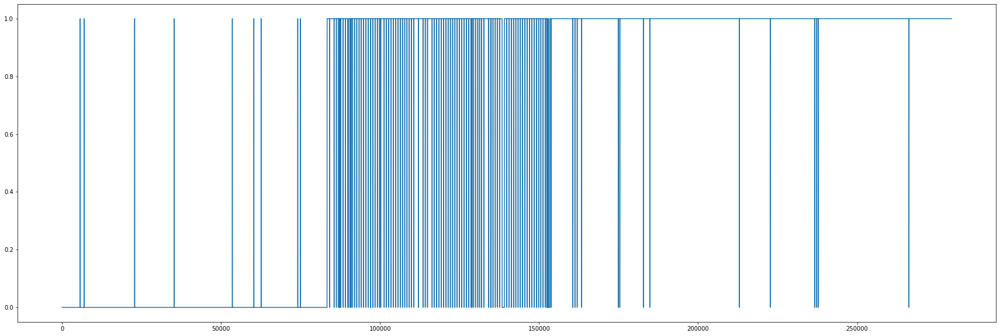

In [238]:
plt.figure(figsize=(30,10))
plt.plot(y, inter)

In [78]:
def check(s, e, l_time):
    #delt = l_time[e] - l_time[s]
    dt_delt = datetime.utcfromtimestamp(l_time[e]) - datetime.utcfromtimestamp(l_time[s])
    if dt_delt.total_seconds() > 1800:
        return False
    return True

def print_check(s, e, l_time):
    #delt = l_time[e] - l_time[s]
    dt_delt = datetime.utcfromtimestamp(l_time[e]) - datetime.utcfromtimestamp(l_time[s])
    print(dt_delt)

In [68]:
#test check
s = 10
e = 25
print(e_time[s], e_time[e], datetime.utcfromtimestamp(e_time[s]).strftime('%Y-%m-%d %H:%M:%S'), datetime.utcfromtimestamp(e_time[e]).strftime('%Y-%m-%d %H:%M:%S'))
print_check(s, e, e_time)

1609449633 1609451433 2020-12-31 21:20:33 2020-12-31 21:50:33
0:30:00


In [239]:
flag = 0

for i in range(1, len(inter)):
    if inter[i] == 1 and inter[i - 1] == 1:
        #print(2)
        flag = 1
    #else:
        #flag = 0
    if flag == 1 and inter[i] == 0:
        flag = 0
        count = 0
        start = i
        while i < len(inter) and inter[i] == 0:
            i += 1
        end = i
        if check(start, end, e_time):
            #print(1)
            for k in range(start, end):
                inter[k] = 1

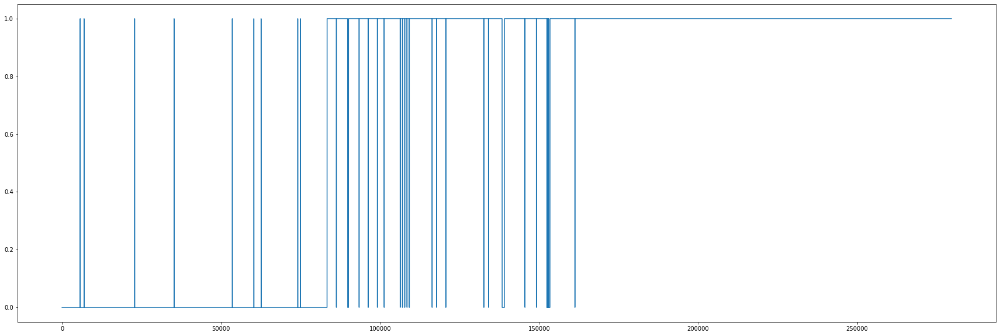

In [240]:
plt.figure(figsize=(30,10))
plt.plot(y, inter)

In [71]:
flag = 0

for i in range(1, len(inter)):
    if inter[i] == 1 and inter[i - 1] == 1:
        #print(2)
        flag = 1
    #else:
        #flag = 0
    if flag == 1 and inter[i] == 0:
        flag = 0
        count = 0
        start = i
        while i < len(inter) and inter[i] == 0:
            i += 1
        end = i
        if not check(start, end, e_time):
            #print(1)
            print_check(start, end, e_time)
            #for k in range(start, end):
                #inter[k] = 1

1 day, 3:50:36
8:50:00
1 day, 0:14:56
8:24:37


In [41]:
len(inter) - np.array(inter).sum()

85355

In [81]:
print('МАКСИМАЛЬНЫЙ НЕПРЕРЫВНЫЙ ОТРЫВОК ВРЕМЕНИ ПОСЛЕ ИНТЕРПОЛЯЦИИ 30 мин: ')

for i in range(len(inter) - 1, 0, -1):
    if inter[i] == 0:
        print(i)
        max_i = i
        break
print('КОЛ-ВО ЗАПИСЕЙ: ', len(e_time) - max_i)
print('НАЧИНАЯ С ДАТЫ: ', datetime.utcfromtimestamp(e_time[max_i]).strftime('%Y-%m-%d %H:%M:%S'))

МАКСИМАЛЬНЫЙ НЕПРЕРЫВНЫЙ ОТРЫВОК ВРЕМЕНИ ПОСЛЕ ИНТЕРПОЛЯЦИИ 30 мин: 
161259
КОЛ-ВО ЗАПИСЕЙ:  118406
НАЧИНАЯ С ДАТЫ:  2021-08-20 01:33:37


In [82]:
def check_62(s, e, l_time):
    #delt = l_time[e] - l_time[s]
    dt_delt = datetime.utcfromtimestamp(l_time[e]) - datetime.utcfromtimestamp(l_time[s])
    if dt_delt.total_seconds() > 3800:
        return False
    return True

def print_check(s, e, l_time):
    #delt = l_time[e] - l_time[s]
    dt_delt = datetime.utcfromtimestamp(l_time[e]) - datetime.utcfromtimestamp(l_time[s])
    print(dt_delt)

In [85]:
flag = 0

for i in range(1, len(inter)):
    if inter[i] == 1 and inter[i - 1] == 1:
        #print(2)
        flag = 1
    #else:
        #flag = 0
    if flag == 1 and inter[i] == 0:
        flag = 0
        count = 0
        start = i
        while i < len(inter) and inter[i] == 0:
            i += 1
        end = i
        if check_62(start, end, e_time):
            #print(1)
            for k in range(start, end):
                inter[k] = 1

In [87]:
print('МАКСИМАЛЬНЫЙ НЕПРЕРЫВНЫЙ ОТРЫВОК ВРЕМЕНИ ПОСЛЕ ИНТЕРПОЛЯЦИИ 60 мин: ')

for i in range(len(inter) - 1, 0, -1):
    if inter[i] == 0:
        print(i)
        max_i = i
        break
        
print('КОЛ-ВО ЗАПИСЕЙ: ', len(e_time) - max_i)
print('НАЧИНАЯ С ДАТЫ: ', datetime.utcfromtimestamp(e_time[max_i]).strftime('%Y-%m-%d %H:%M:%S'))

МАКСИМАЛЬНЫЙ НЕПРЕРЫВНЫЙ ОТРЫВОК ВРЕМЕНИ ПОСЛЕ ИНТЕРПОЛЯЦИИ 60 мин: 
153409
КОЛ-ВО ЗАПИСЕЙ:  126256
НАЧИНАЯ С ДАТЫ:  2021-08-09 08:34:12


In [88]:
def big_check(s, e, l_time):
    #delt = l_time[e] - l_time[s]
    dt_delt = datetime.utcfromtimestamp(l_time[e]) - datetime.utcfromtimestamp(l_time[s])
    if dt_delt.total_seconds() > (84600 + 14400):
        return False
    return True

def print_check(s, e, l_time):
    #delt = l_time[e] - l_time[s]
    dt_delt = datetime.utcfromtimestamp(l_time[e]) - datetime.utcfromtimestamp(l_time[s])
    print(dt_delt)

In [89]:
flag = 0

for i in range(1, len(inter)):
    if inter[i] == 1 and inter[i - 1] == 1:
        #print(2)
        flag = 1
    #else:
        #flag = 0
    if flag == 1 and inter[i] == 0:
        flag = 0
        count = 0
        start = i
        while i < len(inter) and inter[i] == 0:
            i += 1
        end = i
        if big_check(start, end, e_time):
            #print(1)
            for k in range(start, end):
                inter[k] = 1

In [90]:
print('МАКСИМАЛЬНЫЙ НЕПРЕРЫВНЫЙ ОТРЫВОК ВРЕМЕНИ ПОСЛЕ ГРУБОЙ ИНТЕРПОЛЯЦИИ: ')

for i in range(len(inter) - 1, 0, -1):
    if inter[i] == 0:
        print(i)
        max_i = i
        break
        
print('КОЛ-ВО ЗАПИСЕЙ: ', len(e_time) - max_i)
print('НАЧИНАЯ С ДАТЫ: ', datetime.utcfromtimestamp(e_time[max_i]).strftime('%Y-%m-%d %H:%M:%S'))

МАКСИМАЛЬНЫЙ НЕПРЕРЫВНЫЙ ОТРЫВОК ВРЕМЕНИ ПОСЛЕ ГРУБОЙ ИНТЕРПОЛЯЦИИ: 
83321
КОЛ-ВО ЗАПИСЕЙ:  196344
НАЧИНАЯ С ДАТЫ:  2021-05-03 23:08:38


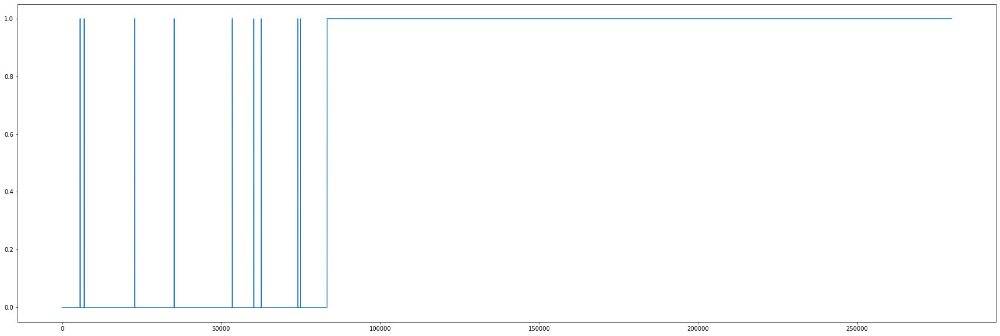

In [91]:
plt.figure(figsize=(30,10))
plt.plot(y, inter)

# Интерполяция температуры. Интервал < 30 минут

In [227]:
st = 161259
e_time = np.array(elec.event_timestamp)
t_time = np.array(temp.event_timestamp)
inter = []
t_temp = []
for j, i in enumerate(e_time):
    if i in t_time:
        inter.append(1)
        if len(np.where(temp.event_timestamp == i)[0]) == 1:
            #print(j, i, temp['value'][np.where(temp['event_timestamp'] == i)[0]])
            #print(float(temp['value'][np.where(temp['event_timestamp'] == i)[0]]) )
            t_temp.append(float(temp['value'][np.where(temp['event_timestamp'] == i)[0]]))
        elif len(np.where(temp.event_timestamp == i)[0]) > 1:
            #print(j, i, temp['value'][np.where(temp['event_timestamp'] == i)[0][0]])
            #print(float(temp['value'][np.where(temp['event_timestamp'] == i)[0][0]]) )
            t_temp.append(float(temp['value'][np.where(temp['event_timestamp'] == i)[0][0]]))
    else:
        inter.append(0)
        t_temp.append(0)

In [228]:
t_temp = np.array(t_temp)
COPY_TEMP = np.copy(t_temp)

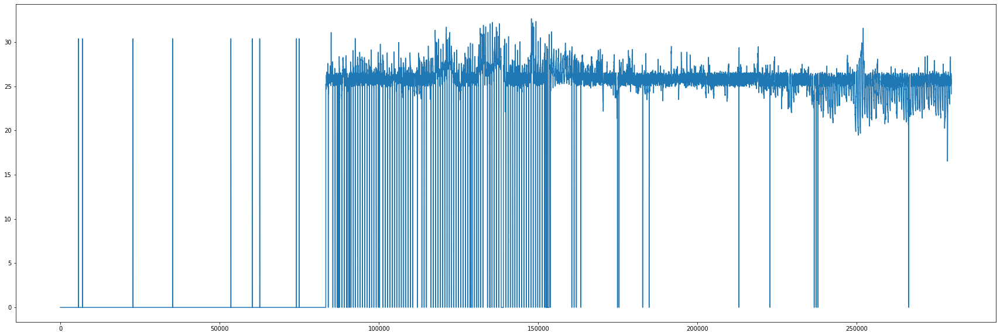

In [287]:
y = np.arange(len(inter))
plt.figure(figsize=(30,10))
plt.plot(y, t_temp)

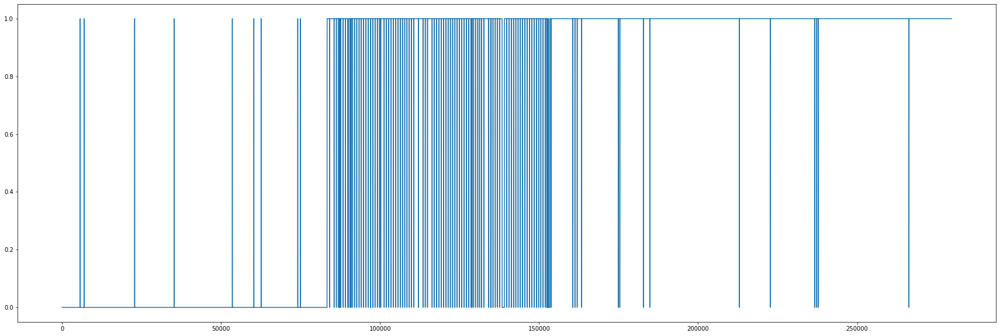

In [274]:
y = np.arange(len(inter))
plt.figure(figsize=(30,10))
plt.plot(y, inter)

In [284]:
#t_temp = np.copy(COPY_TEMP)

In [288]:
flag = 0

for i in range(1, len(inter)):
    if inter[i] == 1 and inter[i - 1] == 1:
        #print(2)
        flag = 1
        y = []
        x = []
        y.append(t_temp[i - 1])
        y.append(t_temp[i])
        
        x.append(e_time[i - 1])
        x.append(e_time[i])
        
    #else:
        #flag = 0
    if flag == 1 and inter[i] == 0:
        flag = 0
        #count = 0
        #y = []
        start = i
        new_x = []
        while i < len(inter) and inter[i] == 0:
            new_x.append(e_time[i])
            i += 1
            
        end = i
        y.append(t_temp[i])
        x.append(e_time[i])
        if check(start, end, e_time):
            for k in range(start, end):
                inter[k] = 1
            f = interpolate.interp1d(x, y, fill_value="extrapolate")
            #print(x, y, new_x)
            new_x = f(new_x)
            t_temp[start:end] += new_x
            #print(new_x, start, end, t_temp[start - 2:end + 2])

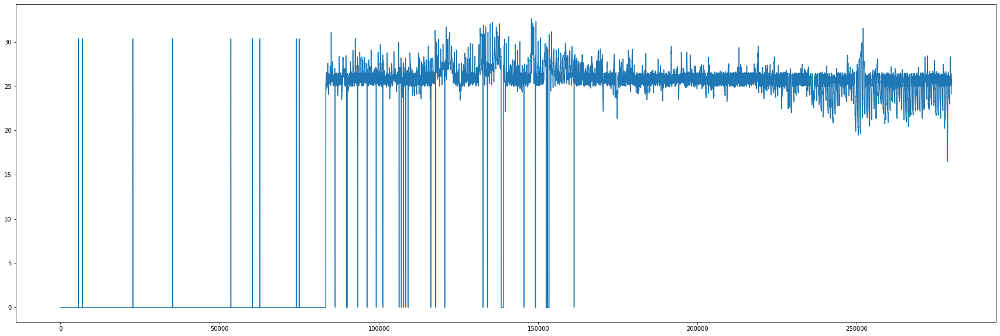

In [289]:
y = np.arange(len(inter))
plt.figure(figsize=(30,10))
plt.plot(y, t_temp)

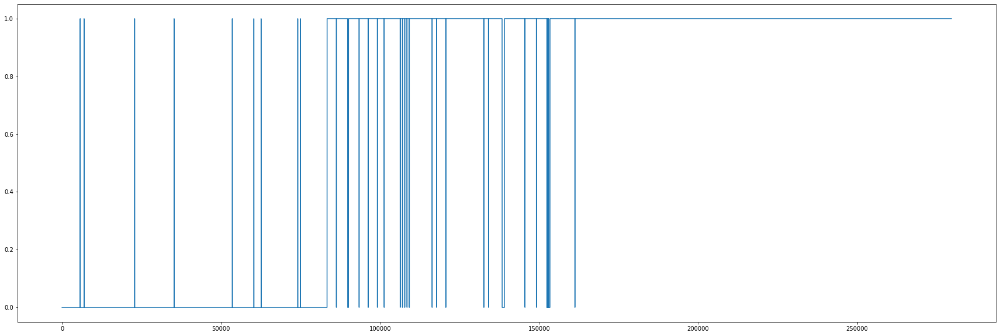

In [290]:
y = np.arange(len(inter))
plt.figure(figsize=(30,10))
plt.plot(y, inter)

# Интерполяция температуры и влажности. Интервал < 30 минут

In [293]:
e_time = np.array(elec.event_timestamp)
t_time = np.array(temp.event_timestamp)
h_time = np.array(hum.event_timestamp)
inter = []
t_temp = []
t_hum = []
for j, i in enumerate(e_time):
    if i in t_time and i in h_time:
        inter.append(1)
        if len(np.where(temp.event_timestamp == i)[0]) == 1:
            t_temp.append(float(temp['value'][np.where(temp['event_timestamp'] == i)[0]]))
        elif len(np.where(temp.event_timestamp == i)[0]) > 1:
            t_temp.append(float(temp['value'][np.where(temp['event_timestamp'] == i)[0][0]]))
            
        if len(np.where(hum.event_timestamp == i)[0]) == 1:
            t_hum.append(float(hum['value'][np.where(hum['event_timestamp'] == i)[0]]))
        elif len(np.where(hum.event_timestamp == i)[0]) > 1:
            t_hum.append(float(hum['value'][np.where(hum['event_timestamp'] == i)[0][0]]))
    else:
        inter.append(0)
        t_temp.append(0)
        t_hum.append(0)

In [294]:
t_temp = np.array(t_temp)
t_hum = np.array(t_hum)
COPY_TEMP = np.copy(t_temp)
COPY_HUM = np.copy(t_hum)

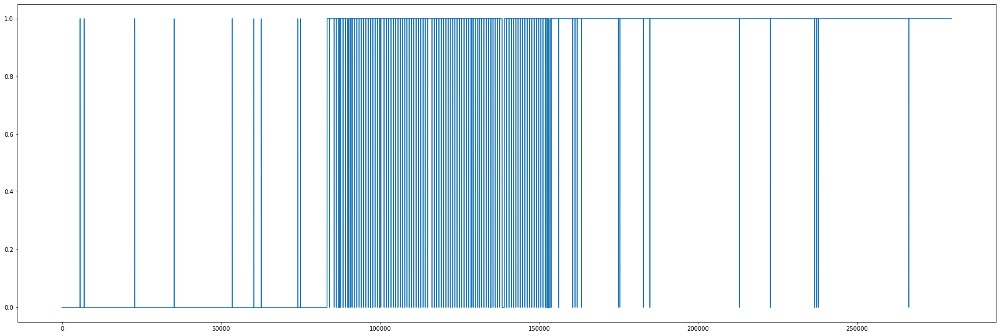

In [292]:
y = np.arange(len(inter))
plt.figure(figsize=(30,10))
plt.plot(y, inter)

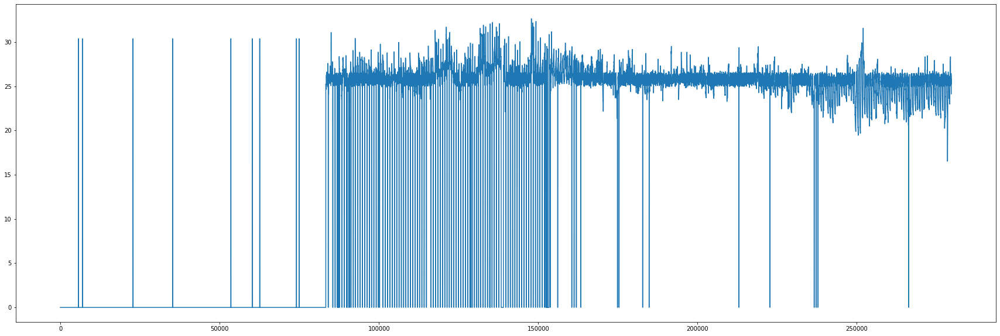

In [295]:
y = np.arange(len(inter))
plt.figure(figsize=(30,10))
plt.plot(y, t_temp)

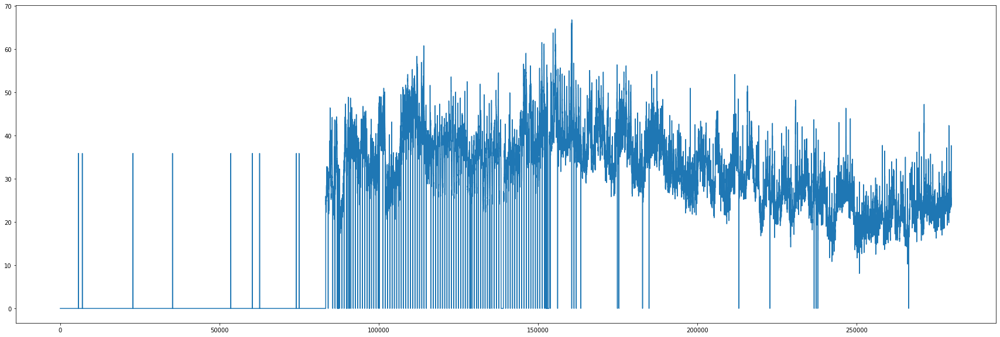

In [296]:
y = np.arange(len(inter))
plt.figure(figsize=(30,10))
plt.plot(y, t_hum)

In [298]:
flag = 0

for i in range(1, len(inter)):
    if inter[i] == 1 and inter[i - 1] == 1:
        #print(2)
        flag = 1
        y_t = []
        y_h = []
        x = []
        y_t.append(t_temp[i - 1])
        y_t.append(t_temp[i])
        y_h.append(t_hum[i - 1])
        y_h.append(t_hum[i])
        
        x.append(e_time[i - 1])
        x.append(e_time[i])
        
    #else:
        #flag = 0
    if flag == 1 and inter[i] == 0:
        flag = 0
        #count = 0
        #y = []
        start = i
        new_x = []
        while i < len(inter) and inter[i] == 0:
            new_x.append(e_time[i])
            i += 1
            
        end = i
        y_t.append(t_temp[i])
        y_h.append(t_hum[i])
        x.append(e_time[i])
        if check(start, end, e_time):
            for k in range(start, end):
                inter[k] = 1
            f_t = interpolate.interp1d(x, y_t, fill_value="extrapolate")
            f_h = interpolate.interp1d(x, y_h, fill_value="extrapolate")
            #print(x, y, new_x)
            new_y_t = f_t(new_x)
            new_y_h = f_h(new_x)
            t_temp[start:end] += new_y_t
            t_hum[start:end] += new_y_h
            #print(new_x, start, end, t_temp[start - 2:end + 2])

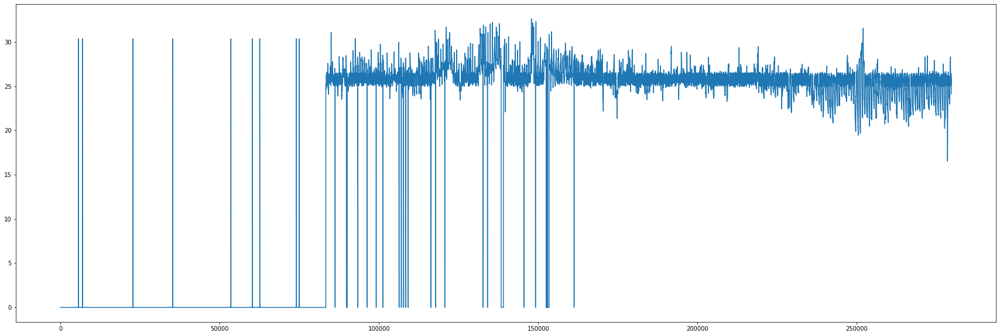

In [299]:
y = np.arange(len(inter))
plt.figure(figsize=(30,10))
plt.plot(y, t_temp)

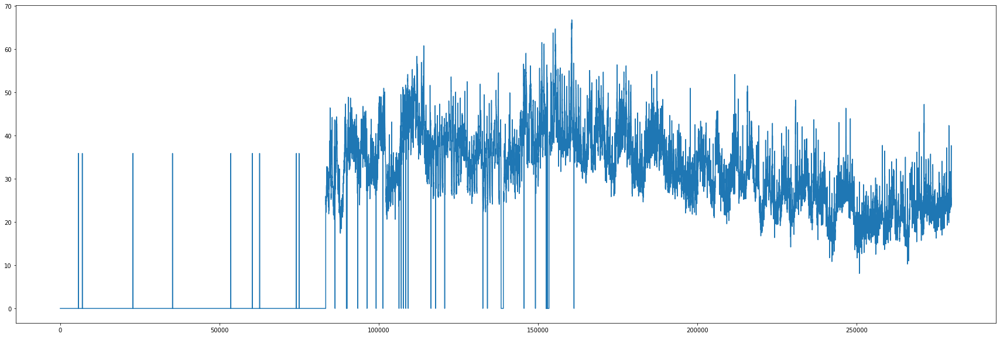

In [300]:
y = np.arange(len(inter))
plt.figure(figsize=(30,10))
plt.plot(y, t_hum)

In [301]:
np.save('interpolated_temp_30.npy', t_temp)
np.save('interpolated_hum_30.npy', t_hum)

# Подготовка данных вида: [день недели, минута, total_AP_max, temp, hum]

In [6]:
#week_day = []
#minut = []
#total_AP_max = []
#temperatute= []
#humidity = []
time = pd.read_csv('event_timestamp.csv')
time

,Unnamed: 0,event_timestamp
0,0,2020-12-31 21:00:33
1,1,2020-12-31 21:02:33
2,2,2020-12-31 21:04:33
3,3,2020-12-31 21:06:33
4,4,2020-12-31 21:08:33
...,...,...
279660,279660,2022-01-31 20:51:54
279661,279661,2022-01-31 20:53:54
279662,279662,2022-01-31 20:55:54
279663,279663,2022-01-31 20:57:54


### total_AP_max

In [9]:
#t = elec['event_timestamp']
t = time.event_timestamp
dt = []
for i, j in enumerate(t):
    i += 1
    try:
        dt.append(datetime.strptime(t[i], '%Y-%m-%d %H:%M:%S') - datetime.strptime(t[i - 1], '%Y-%m-%d %H:%M:%S'))
    except KeyError:
        continue
        
for i in range(len(dt)):
    dt[i] = dt[i].total_seconds()
dt = np.array(dt)
dt[np.where(dt == 0)] = 0.001

AP = elec['Total_AP_energy_max']
a = []
for j, i in enumerate(elec['Total_AP_energy_max'][:279664]):
    try:
        i = float(i)
    except ValueError:
        a.append(j)
for i in a:
    AP[i] = AP[i - 1]
AP = np.array(AP, dtype = float)
dAP = -1 * AP[:-1] + AP[1:]
dAP *= 1000
total_AP_max = dAP/dt

In [11]:
total_AP_max

array([0.00275   , 0.00258333, 0.00266667, ..., 0.00275   , 0.00275   ,
       0.00291667])

### week day

In [346]:
week_day = []
t = elec['event_timestamp']
for i in range(len(t)):
    #t[i] = datetime.utcfromtimestamp(t[i])
    week_day.append(t[i].weekday())

### minute

In [341]:
minute = []
for i in t:
    minute.append(i.hour * 60 + i.minute)

### Все данные

In [348]:
week_day = np.array(week_day)
minute = np.array(minute)
temperature = np.array(t_temp)
humidity = np.array(t_hum)
data = np.column_stack([week_day[161259:], minute[161259:], total_AP_max[161258:], temperature[161259:], humidity[161259:]])

In [352]:
df = pd.DataFrame(data, columns=['week_day', 'minute', 'total_AP_max', 'temperature', 'humidity'])

In [353]:
df

,week_day,minute,total_AP_max,temperature,humidity
0,4.0,93.0,350.000002,0.000,0.00
1,4.0,95.0,339.999999,28.115,46.58
2,4.0,97.0,350.000002,28.240,45.63
3,4.0,99.0,320.000006,28.240,45.63
4,4.0,101.0,310.000003,28.275,45.42
...,...,...,...,...,...
118401,0.0,1251.0,329.999995,24.650,23.69
118402,0.0,1253.0,330.000010,24.130,23.47
118403,0.0,1255.0,329.999995,24.130,23.47
118404,0.0,1257.0,329.999995,24.130,23.47


In [13]:
data.to_csv('IQDS_interpol_30.csv', index=False) #тут аномалия на 

In [2]:
df = pd.read_csv('IQDS_interpol_30.csv')

In [15]:
data

,week_day,minute,total_AP_max,temperature,humidity
0,4.0,95.0,339.999999,28.115,46.58
1,4.0,97.0,350.000002,28.240,45.63
2,4.0,99.0,320.000006,28.240,45.63
3,4.0,101.0,310.000003,28.275,45.42
4,4.0,103.0,329.999995,28.310,45.21
...,...,...,...,...,...
118400,0.0,1251.0,329.999995,24.650,23.69
118401,0.0,1253.0,330.000010,24.130,23.47
118402,0.0,1255.0,329.999995,24.130,23.47
118403,0.0,1257.0,329.999995,24.130,23.47


# K-means

In [8]:
X = np.array(data)
#X[:, 2]

In [9]:
WS = 40
km = KMeans(n_clusters=2, random_state=0).fit(X)
#fcm.fit(X)
#ans_soft = np.zeros((X.shape[0], 2))
ans = np.zeros(X.shape[0])
for i in range(X.shape[0] - WS):
    curr_z = X[i : i + WS]
    #pred_soft = fcm.soft_predict(curr_x)
    pred = km.predict(curr_z)
    #ans_soft[i : i + WS] += pred_soft
    ans[i : i + WS] += pred
    
for i in range(WS):
    #ans_soft[i] /= (i + 1)
    #ans_soft[ans_soft.shape[0] - (i + 1)] /= (i + 1)
    ans[i] /= (i + 1)
    ans[ans.shape[0] - (i + 1)] /= (i + 1)
#ans_soft[WS:-WS] /= WS
ans[WS:-WS] /= WS
ans[ans >= 0.5] = 1
ans[ans < 0.5] = 0

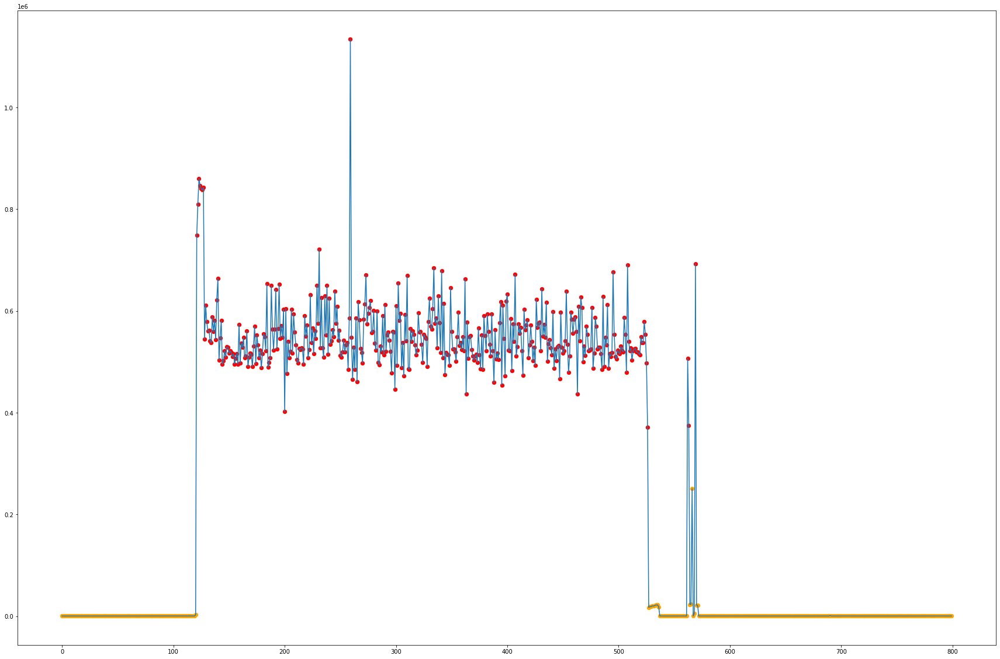

In [39]:
delta = 800
d = 4300
AP = X[:, 2][d: ]
y = np.arange(delta)
plt.figure(figsize=(30,20))
#plt.subplot(2, 1, 1)
plt.plot(y, AP[:delta])
plt.scatter(y[np.where(ans[d:d+delta] == 1)], AP[np.where(ans[d:d+delta] == 1)], color='orange', s=40, marker='o')
plt.scatter(y[np.where(ans[d:d+delta] == 0)], AP[np.where(ans[d:d+delta] == 0)], color='red', s=40, marker='o')
plt.savefig('1.png')
#plt.subplot(2, 1, 2)
#plt.plot(y, AP[:delta])
#plt.scatter(y[np.where(ans[4500:4500+delta] == 0)], AP[np.where(ans[4500:4500+delta] == 0)], color='orange', s=40, marker='o')

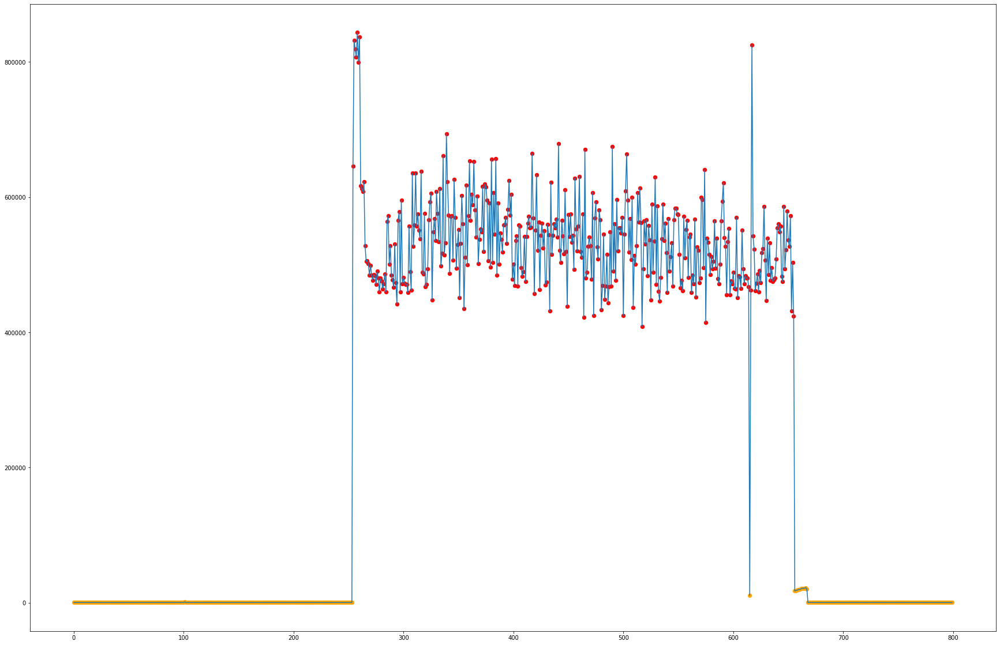

In [40]:
delta = 800
d = 13500
AP = X[:, 2][d: ]
y = np.arange(delta)
plt.figure(figsize=(30,20))
#plt.subplot(2, 1, 1)
plt.plot(y, AP[:delta])
plt.scatter(y[np.where(ans[d:d+delta] == 1)], AP[np.where(ans[d:d+delta] == 1)], color='orange', s=40, marker='o')
plt.scatter(y[np.where(ans[d:d+delta] == 0)], AP[np.where(ans[d:d+delta] == 0)], color='red', s=40, marker='o')
plt.savefig('2.png')

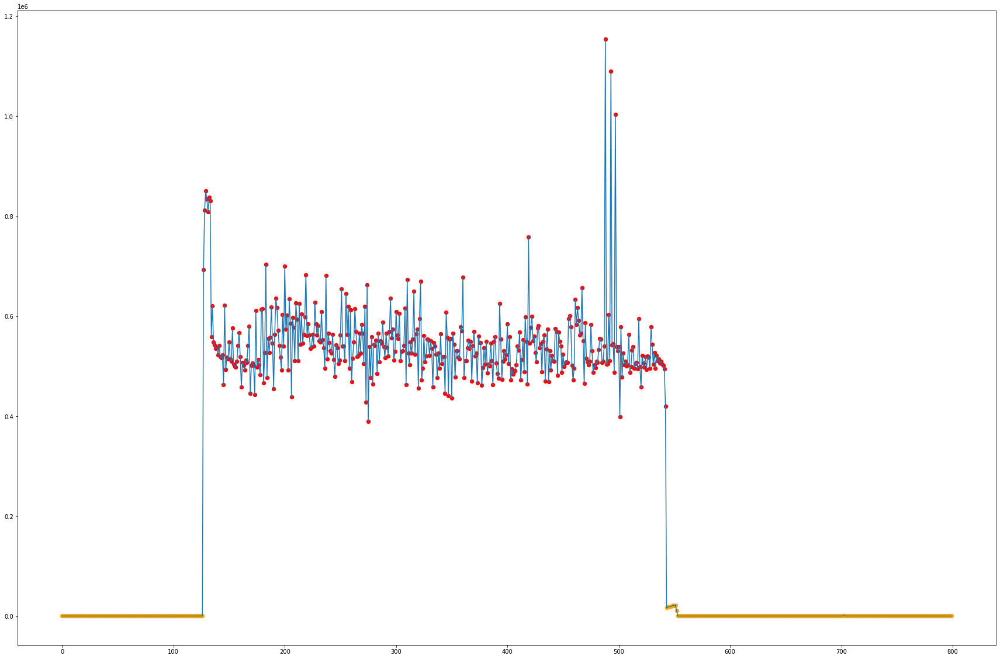

In [41]:
delta = 800
d = 17200
AP = X[:, 2][d: ]
y = np.arange(delta)
plt.figure(figsize=(30,20))
#plt.subplot(2, 1, 1)
plt.plot(y, AP[:delta])
plt.scatter(y[np.where(ans[d:d+delta] == 1)], AP[np.where(ans[d:d+delta] == 1)], color='orange', s=40, marker='o')
plt.scatter(y[np.where(ans[d:d+delta] == 0)], AP[np.where(ans[d:d+delta] == 0)], color='red', s=40, marker='o')
plt.savefig('3.png')

# Гипотеза
Вывести все данные 
Попробовать разметить нектоторые аномалии
Обучить алгоритм


# Идея
Подгрузить погоду\
Выявить +- ровные участки по графику \
Работать и размечать отдельно эти участки, используя не только методы без учителя

# Идея
Симулировать датасет

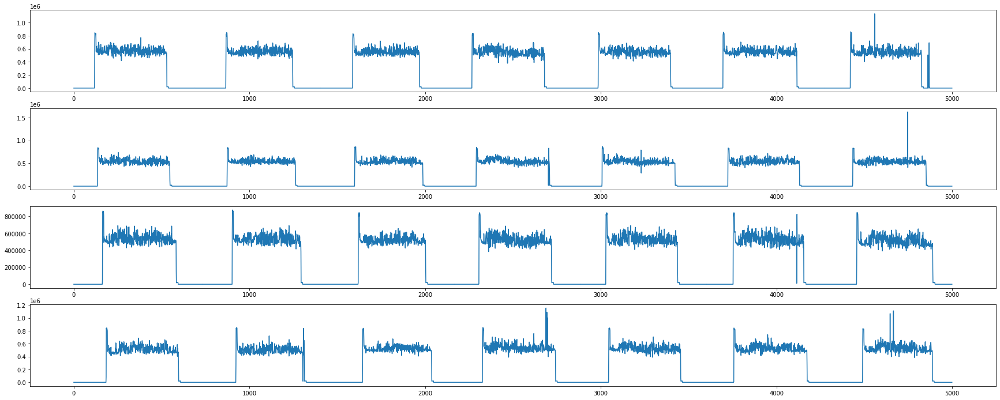

In [25]:
x = 5000
s = 0
AP = X[:, 2]
el1 = AP[s:s + x] 
el2 = AP[s + x:s + 2*x]
el3 = AP[s + 2 *x:s + 3 * x]
el4 = AP[s + 3 * x:s + 4*x]
el5 = AP[s + 3 * x:s + 4*x]
el6 = AP[s + 3 * x:s + 4*x]
el7 = AP[s + 3 * x:s + 4*x]
el8 = AP[s + 3 * x:s + 4*x]
el9 = AP[s + 3 * x:s + 4*x]
el10 = AP[s + 3 * x:s + 4*x]
y = np.arange(5000)
#el3 = elec.Total_P[257434:257434]

plt.figure(figsize=(30,12))
plt.subplot(4, 1, 1)
plt.plot(y, el1)  
plt.subplot(4, 1, 2)
plt.plot(y, el2)
plt.subplot(4, 1, 3)
plt.plot(y, el3)
plt.subplot(4, 1, 4)
plt.plot(y, el4)

In [26]:
i = 1
el = []
while s + i*x < AP.shape[0]:
    el.append(AP[s + (i - 1) * x:s + i*x])
    i += 1

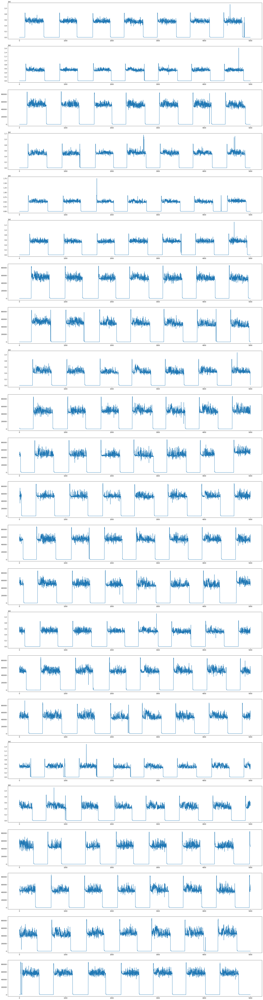

In [27]:
plt.figure(figsize=(30,120))
for i, el_i in enumerate(el):
    #print(el_i, i)
    plt.subplot(len(el), 1, i + 1)
    plt.plot(y, el_i)

# Повышенное энергопотребление

In [6]:
ind = elec[elec['event_timestamp'].str.contains('2022-01-20', regex=False) == True].index
print(ind)

Int64Index([271115, 271116, 271117, 271118, 271119, 271120, 271121, 271122,
            271123, 271124,
            ...
            271825, 271826, 271827, 271828, 271829, 271830, 271831, 271832,
            271833, 271834],
           dtype='int64', length=720)


In [21]:
X = total_AP_max#[271115 - 20000:]

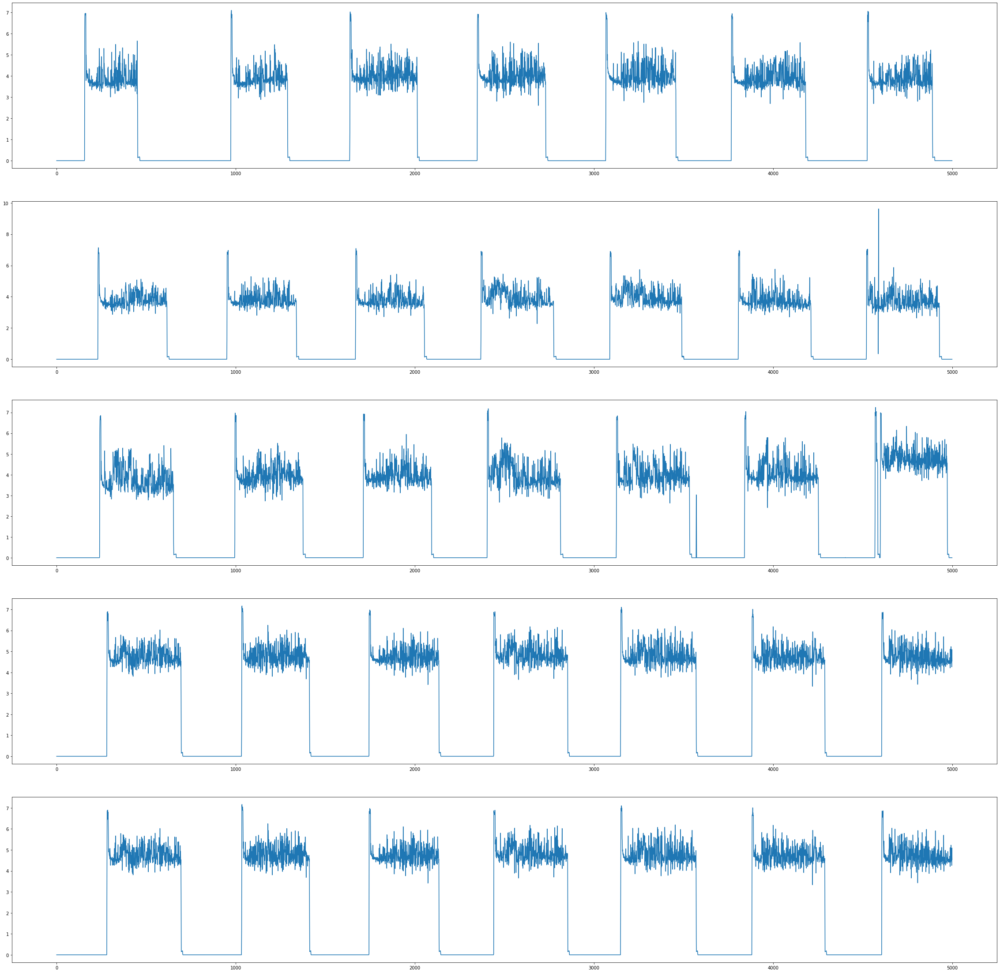

In [46]:
x = 5000
s = 271115 - 7000 - 2400 - 5000
AP = X#[:, 2]
el1 = AP[s:s + x] 
el2 = AP[s + x:s + 2*x]
el3 = AP[s + 2 *x:s + 3 * x]
el4 = AP[s + 3 * x:s + 4*x]
el5 = AP[s + 3 * x:s + 4*x]
el6 = AP[s + 3 * x:s + 4*x]
el7 = AP[s + 3 * x:s + 4*x]
el8 = AP[s + 3 * x:s + 4*x]
el9 = AP[s + 3 * x:s + 4*x]
el10 = AP[s + 3 * x:s + 4*x]
y = np.arange(x)
#el3 = elec.Total_P[257434:257434]
k = 5
plt.figure(figsize=(40,40))
plt.subplot(k, 1, 1)
plt.plot(y, el1)  

plt.subplot(k, 1, 2)
plt.plot(y, el2)

plt.subplot(k, 1, 3)
plt.plot(y, el3)

plt.subplot(k, 1, 4)
plt.plot(y, el4)

plt.subplot(k, 1, 5)
plt.plot(y, el5)


In [106]:
#elec.Total_AP_energy_max[271115 - 10:271115 + 5]

In [105]:
#time.event_timestamp.unique
date = []
for i in np.array(time.event_timestamp):#[:][:10]
    date.append(i[:10])
date = np.array(date)
#np.unique(np.array(date))#.unique

In [147]:
ap_mean = np.zeros(total_AP_max.shape[0])
curr = []
fl = 0
for i in np.unique(date):
    indd = np.where(date == i)[0]
    #print(ind, ind[:-1])
    ind = []
    for j in indd[:-1]:
        if total_AP_max[j] > 0.01:
            ind.append(j)
    #ind = np.where(date == i)[0]
    try:
        AP = total_AP_max[ind]
    except IndexError:
        AP = total_AP_max[ind[:-1]]
    h = np.mean(AP)
    for j in ind[:-1]:
        if total_AP_max[j] < 0.01:
            ap_mean[j] = 0
        else:
            ap_mean[j] = h
#print(np.ap_mean.shape[0])

c:\users\lomonosova\appdata\local\programs\python\python38\lib\site-packages\numpy\core\fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\users\lomonosova\appdata\local\programs\python\python38\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


279664


In [149]:
start = []
end = []
thr = 4.1
print(np.where(ap_mean > thr)[0].shape)
prev = np.where(ap_mean > thr)[0][0]
for i in np.where(ap_mean > thr)[0]:
    if i - prev != 1:
        start.append(i)
        #print(i, date[i])
    prev = i
    #print(i)
#(np.where(ap_mean > 2.6)[0]).shape
print(len(start))

(82493,)
562


In [150]:
start

[7404,
 8124,
 10272,
 12422,
 15284,
 20290,
 21764,
 22425,
 23098,
 23817,
 24536,
 25253,
 25999,
 26714,
 27396,
 28113,
 28840,
 29538,
 30269,
 31005,
 31719,
 32418,
 33128,
 33844,
 34564,
 35283,
 35999,
 36779,
 37485,
 38175,
 38864,
 39577,
 40292,
 41021,
 41746,
 42426,
 43174,
 45280,
 48874,
 49585,
 50301,
 51045,
 52455,
 53167,
 53886,
 56054,
 59617,
 60332,
 65337,
 69641,
 70335,
 70521,
 71085,
 72489,
 75339,
 76096,
 80331,
 89216,
 92807,
 97836,
 100695,
 102847,
 104995,
 105722,
 107876,
 109318,
 110744,
 127279,
 127967,
 128681,
 128866,
 129400,
 130131,
 130835,
 131394,
 132071,
 132750,
 133477,
 134194,
 134904,
 135612,
 137096,
 137775,
 138487,
 138698,
 138717,
 139221,
 139923,
 140646,
 141396,
 142120,
 142799,
 150679,
 152132,
 152411,
 152414,
 152417,
 152420,
 152423,
 152426,
 152429,
 152431,
 152433,
 152435,
 152437,
 152439,
 152441,
 152443,
 152445,
 152447,
 152449,
 152451,
 152453,
 152455,
 152457,
 152459,
 152461,
 152463,


In [145]:
start = []
end = []
prev = ap_mean[0]
for j, i in enumerate(ap_mean):
    print(j, prev, i)
    if i <= 0.01:
        continue
    if i - prev >= 0.3:
        start.append(j)
        #print(i, date[i])
        
    prev = i

0 0.0 0.0
1 0.0 0.0
2 0.0 0.0
3 0.0 0.0
4 0.0 0.0
5 0.0 0.0
6 0.0 0.0
7 0.0 0.0
8 0.0 0.0
9 0.0 0.0
10 0.0 0.0
11 0.0 0.0
12 0.0 0.0
13 0.0 0.0
14 0.0 0.0
15 0.0 0.0
16 0.0 0.0
17 0.0 0.0
18 0.0 0.0
19 0.0 0.0
20 0.0 0.0
21 0.0 0.0
22 0.0 0.0
23 0.0 0.0
24 0.0 0.0
25 0.0 0.0
26 0.0 0.0
27 0.0 0.0
28 0.0 0.0
29 0.0 0.0
30 0.0 0.0
31 0.0 0.0
32 0.0 0.0
33 0.0 0.0
34 0.0 0.0
35 0.0 0.0
36 0.0 0.0
37 0.0 0.0
38 0.0 0.0
39 0.0 0.0
40 0.0 0.0
41 0.0 0.0
42 0.0 0.0
43 0.0 0.0
44 0.0 0.0
45 0.0 0.0
46 0.0 0.0
47 0.0 0.0
48 0.0 0.0
49 0.0 0.0
50 0.0 0.0
51 0.0 0.0
52 0.0 0.0
53 0.0 0.0
54 0.0 0.0
55 0.0 0.0
56 0.0 0.0
57 0.0 0.0
58 0.0 0.0
59 0.0 0.0
60 0.0 0.0
61 0.0 0.0
62 0.0 0.0
63 0.0 0.0
64 0.0 0.0
65 0.0 0.0
66 0.0 0.0
67 0.0 0.0
68 0.0 0.0
69 0.0 0.0
70 0.0 0.0
71 0.0 0.0
72 0.0 0.0
73 0.0 0.0
74 0.0 0.0
75 0.0 0.0
76 0.0 0.0
77 0.0 0.0
78 0.0 0.0
79 0.0 0.0
80 0.0 0.0
81 0.0 0.0
82 0.0 0.0
83 0.0 0.0
84 0.0 0.0
85 0.0 0.0
86 0.0 0.0
87 0.0 0.0
88 0.0 0.0
89 0.0 0.0
90 0.0 0.0
91 0.0 0.

1426 3.894892752715162 0.0
1427 3.894892752715162 0.0
1428 3.894892752715162 0.0
1429 3.894892752715162 0.0
1430 3.894892752715162 0.0
1431 3.894892752715162 0.0
1432 3.894892752715162 0.0
1433 3.894892752715162 0.0
1434 3.894892752715162 0.0
1435 3.894892752715162 0.0
1436 3.894892752715162 0.0
1437 3.894892752715162 0.0
1438 3.894892752715162 0.0
1439 3.894892752715162 0.0
1440 3.894892752715162 0.0
1441 3.894892752715162 0.0
1442 3.894892752715162 0.0
1443 3.894892752715162 0.0
1444 3.894892752715162 0.0
1445 3.894892752715162 0.0
1446 3.894892752715162 0.0
1447 3.894892752715162 0.0
1448 3.894892752715162 0.0
1449 3.894892752715162 0.0
1450 3.894892752715162 0.0
1451 3.894892752715162 0.0
1452 3.894892752715162 0.0
1453 3.894892752715162 0.0
1454 3.894892752715162 0.0
1455 3.894892752715162 0.0
1456 3.894892752715162 0.0
1457 3.894892752715162 0.0
1458 3.894892752715162 0.0
1459 3.894892752715162 0.0
1460 3.894892752715162 0.0
1461 3.894892752715162 0.0
1462 3.894892752715162 0.0
1

2959 3.8832595785441653 0.0
2960 3.8832595785441653 0.0
2961 3.8832595785441653 0.0
2962 3.8832595785441653 0.0
2963 3.8832595785441653 0.0
2964 3.8832595785441653 0.0
2965 3.8832595785441653 0.0
2966 3.8832595785441653 0.0
2967 3.8832595785441653 0.0
2968 3.8832595785441653 0.0
2969 3.8832595785441653 0.0
2970 3.8832595785441653 0.0
2971 3.8832595785441653 0.0
2972 3.8832595785441653 0.0
2973 3.8832595785441653 0.0
2974 3.8832595785441653 0.0
2975 3.8832595785441653 0.0
2976 3.8832595785441653 0.0
2977 3.8832595785441653 0.0
2978 3.8832595785441653 0.0
2979 3.8832595785441653 0.0
2980 3.8832595785441653 0.0
2981 3.8832595785441653 0.0
2982 3.8832595785441653 0.0
2983 3.8832595785441653 0.0
2984 3.8832595785441653 0.0
2985 3.8832595785441653 0.0
2986 3.8832595785441653 0.0
2987 3.8832595785441653 0.0
2988 3.8832595785441653 0.0
2989 3.8832595785441653 0.0
2990 3.8832595785441653 0.0
2991 3.8832595785441653 0.0
2992 3.8832595785441653 0.0
2993 3.8832595785441653 0.0
2994 3.8832595785441

4592 3.90972883895138 3.90972883895138
4593 3.90972883895138 3.90972883895138
4594 3.90972883895138 3.90972883895138
4595 3.90972883895138 3.90972883895138
4596 3.90972883895138 3.90972883895138
4597 3.90972883895138 3.90972883895138
4598 3.90972883895138 3.90972883895138
4599 3.90972883895138 3.90972883895138
4600 3.90972883895138 3.90972883895138
4601 3.90972883895138 3.90972883895138
4602 3.90972883895138 3.90972883895138
4603 3.90972883895138 3.90972883895138
4604 3.90972883895138 3.90972883895138
4605 3.90972883895138 3.90972883895138
4606 3.90972883895138 3.90972883895138
4607 3.90972883895138 3.90972883895138
4608 3.90972883895138 3.90972883895138
4609 3.90972883895138 3.90972883895138
4610 3.90972883895138 3.90972883895138
4611 3.90972883895138 3.90972883895138
4612 3.90972883895138 3.90972883895138
4613 3.90972883895138 3.90972883895138
4614 3.90972883895138 3.90972883895138
4615 3.90972883895138 3.90972883895138
4616 3.90972883895138 3.90972883895138
4617 3.90972883895138 3.9

6273 4.043278853914392 4.043278853914392
6274 4.043278853914392 4.043278853914392
6275 4.043278853914392 4.043278853914392
6276 4.043278853914392 4.043278853914392
6277 4.043278853914392 4.043278853914392
6278 4.043278853914392 4.043278853914392
6279 4.043278853914392 4.043278853914392
6280 4.043278853914392 4.043278853914392
6281 4.043278853914392 4.043278853914392
6282 4.043278853914392 4.043278853914392
6283 4.043278853914392 4.043278853914392
6284 4.043278853914392 4.043278853914392
6285 4.043278853914392 4.043278853914392
6286 4.043278853914392 4.043278853914392
6287 4.043278853914392 4.043278853914392
6288 4.043278853914392 4.043278853914392
6289 4.043278853914392 4.043278853914392
6290 4.043278853914392 4.043278853914392
6291 4.043278853914392 4.043278853914392
6292 4.043278853914392 4.043278853914392
6293 4.043278853914392 4.043278853914392
6294 4.043278853914392 4.043278853914392
6295 4.043278853914392 4.043278853914392
6296 4.043278853914392 4.043278853914392
6297 4.043278853

8092 4.1310025019244865 0.0
8093 4.1310025019244865 0.0
8094 4.1310025019244865 0.0
8095 4.1310025019244865 0.0
8096 4.1310025019244865 0.0
8097 4.1310025019244865 0.0
8098 4.1310025019244865 0.0
8099 4.1310025019244865 0.0
8100 4.1310025019244865 0.0
8101 4.1310025019244865 0.0
8102 4.1310025019244865 0.0
8103 4.1310025019244865 0.0
8104 4.1310025019244865 0.0
8105 4.1310025019244865 0.0
8106 4.1310025019244865 0.0
8107 4.1310025019244865 0.0
8108 4.1310025019244865 0.0
8109 4.1310025019244865 0.0
8110 4.1310025019244865 0.0
8111 4.1310025019244865 0.0
8112 4.1310025019244865 0.0
8113 4.1310025019244865 0.0
8114 4.1310025019244865 0.0
8115 4.1310025019244865 0.0
8116 4.1310025019244865 0.0
8117 4.1310025019244865 0.0
8118 4.1310025019244865 0.0
8119 4.1310025019244865 0.0
8120 4.1310025019244865 0.0
8121 4.1310025019244865 0.0
8122 4.1310025019244865 0.0
8123 4.1310025019244865 0.0
8124 4.1310025019244865 4.117919330289168
8125 4.117919330289168 4.117919330289168
8126 4.11791933028916

9758 4.086669066820354 4.086669066820354
9759 4.086669066820354 4.086669066820354
9760 4.086669066820354 4.086669066820354
9761 4.086669066820354 4.086669066820354
9762 4.086669066820354 4.086669066820354
9763 4.086669066820354 4.086669066820354
9764 4.086669066820354 4.086669066820354
9765 4.086669066820354 4.086669066820354
9766 4.086669066820354 4.086669066820354
9767 4.086669066820354 4.086669066820354
9768 4.086669066820354 4.086669066820354
9769 4.086669066820354 4.086669066820354
9770 4.086669066820354 4.086669066820354
9771 4.086669066820354 4.086669066820354
9772 4.086669066820354 4.086669066820354
9773 4.086669066820354 4.086669066820354
9774 4.086669066820354 4.086669066820354
9775 4.086669066820354 4.086669066820354
9776 4.086669066820354 4.086669066820354
9777 4.086669066820354 4.086669066820354
9778 4.086669066820354 4.086669066820354
9779 4.086669066820354 4.086669066820354
9780 4.086669066820354 4.086669066820354
9781 4.086669066820354 4.086669066820354
9782 4.086669066

11462 4.070565768930574 0.0
11463 4.070565768930574 0.0
11464 4.070565768930574 0.0
11465 4.070565768930574 0.0
11466 4.070565768930574 0.0
11467 4.070565768930574 0.0
11468 4.070565768930574 0.0
11469 4.070565768930574 0.0
11470 4.070565768930574 0.0
11471 4.070565768930574 0.0
11472 4.070565768930574 0.0
11473 4.070565768930574 0.0
11474 4.070565768930574 0.0
11475 4.070565768930574 0.0
11476 4.070565768930574 0.0
11477 4.070565768930574 0.0
11478 4.070565768930574 0.0
11479 4.070565768930574 0.0
11480 4.070565768930574 0.0
11481 4.070565768930574 0.0
11482 4.070565768930574 0.0
11483 4.070565768930574 0.0
11484 4.070565768930574 0.0
11485 4.070565768930574 0.0
11486 4.070565768930574 0.0
11487 4.070565768930574 0.0
11488 4.070565768930574 0.0
11489 4.070565768930574 0.0
11490 4.070565768930574 0.0
11491 4.070565768930574 0.0
11492 4.070565768930574 0.0
11493 4.070565768930574 0.0
11494 4.070565768930574 0.0
11495 4.070565768930574 0.0
11496 4.070565768930574 0.0
11497 4.070565768930

13258 3.945454387990808 3.945454387990808
13259 3.945454387990808 3.945454387990808
13260 3.945454387990808 3.945454387990808
13261 3.945454387990808 3.945454387990808
13262 3.945454387990808 3.945454387990808
13263 3.945454387990808 3.945454387990808
13264 3.945454387990808 3.945454387990808
13265 3.945454387990808 3.945454387990808
13266 3.945454387990808 3.945454387990808
13267 3.945454387990808 3.945454387990808
13268 3.945454387990808 3.945454387990808
13269 3.945454387990808 3.945454387990808
13270 3.945454387990808 3.945454387990808
13271 3.945454387990808 3.945454387990808
13272 3.945454387990808 3.945454387990808
13273 3.945454387990808 3.945454387990808
13274 3.945454387990808 3.945454387990808
13275 3.945454387990808 3.945454387990808
13276 3.945454387990808 3.945454387990808
13277 3.945454387990808 3.945454387990808
13278 3.945454387990808 3.945454387990808
13279 3.945454387990808 3.945454387990808
13280 3.945454387990808 3.945454387990808
13281 3.945454387990808 3.94545438

14924 3.9637872057705748 3.9637872057705748
14925 3.9637872057705748 3.9637872057705748
14926 3.9637872057705748 3.9637872057705748
14927 3.9637872057705748 3.9637872057705748
14928 3.9637872057705748 3.9637872057705748
14929 3.9637872057705748 3.9637872057705748
14930 3.9637872057705748 3.9637872057705748
14931 3.9637872057705748 3.9637872057705748
14932 3.9637872057705748 3.9637872057705748
14933 3.9637872057705748 3.9637872057705748
14934 3.9637872057705748 3.9637872057705748
14935 3.9637872057705748 3.9637872057705748
14936 3.9637872057705748 3.9637872057705748
14937 3.9637872057705748 3.9637872057705748
14938 3.9637872057705748 3.9637872057705748
14939 3.9637872057705748 3.9637872057705748
14940 3.9637872057705748 3.9637872057705748
14941 3.9637872057705748 3.9637872057705748
14942 3.9637872057705748 3.9637872057705748
14943 3.9637872057705748 3.9637872057705748
14944 3.9637872057705748 3.9637872057705748
14945 3.9637872057705748 3.9637872057705748
14946 3.9637872057705748 3.96378

16591 4.035985074626981 0.0
16592 4.035985074626981 0.0
16593 4.035985074626981 0.0
16594 4.035985074626981 0.0
16595 4.035985074626981 0.0
16596 4.035985074626981 0.0
16597 4.035985074626981 0.0
16598 4.035985074626981 0.0
16599 4.035985074626981 0.0
16600 4.035985074626981 0.0
16601 4.035985074626981 0.0
16602 4.035985074626981 0.0
16603 4.035985074626981 0.0
16604 4.035985074626981 0.0
16605 4.035985074626981 0.0
16606 4.035985074626981 0.0
16607 4.035985074626981 0.0
16608 4.035985074626981 0.0
16609 4.035985074626981 0.0
16610 4.035985074626981 0.0
16611 4.035985074626981 0.0
16612 4.035985074626981 0.0
16613 4.035985074626981 0.0
16614 4.035985074626981 0.0
16615 4.035985074626981 0.0
16616 4.035985074626981 0.0
16617 4.035985074626981 0.0
16618 4.035985074626981 0.0
16619 4.035985074626981 0.0
16620 4.035985074626981 0.0
16621 4.035985074626981 0.0
16622 4.035985074626981 0.0
16623 4.035985074626981 0.0
16624 4.035985074626981 0.0
16625 4.035985074626981 0.0
16626 4.035985074626

18424 3.959286736272389 3.959286736272389
18425 3.959286736272389 3.959286736272389
18426 3.959286736272389 3.959286736272389
18427 3.959286736272389 3.959286736272389
18428 3.959286736272389 3.959286736272389
18429 3.959286736272389 3.959286736272389
18430 3.959286736272389 3.959286736272389
18431 3.959286736272389 3.959286736272389
18432 3.959286736272389 3.959286736272389
18433 3.959286736272389 3.959286736272389
18434 3.959286736272389 3.959286736272389
18435 3.959286736272389 3.959286736272389
18436 3.959286736272389 3.959286736272389
18437 3.959286736272389 3.959286736272389
18438 3.959286736272389 3.959286736272389
18439 3.959286736272389 3.959286736272389
18440 3.959286736272389 3.959286736272389
18441 3.959286736272389 3.959286736272389
18442 3.959286736272389 3.959286736272389
18443 3.959286736272389 3.959286736272389
18444 3.959286736272389 3.959286736272389
18445 3.959286736272389 3.959286736272389
18446 3.959286736272389 3.959286736272389
18447 3.959286736272389 3.95928673

20156 4.021583925750287 0.0
20157 4.021583925750287 0.0
20158 4.021583925750287 0.0
20159 4.021583925750287 0.0
20160 4.021583925750287 0.0
20161 4.021583925750287 0.0
20162 4.021583925750287 0.0
20163 4.021583925750287 0.0
20164 4.021583925750287 0.0
20165 4.021583925750287 0.0
20166 4.021583925750287 0.0
20167 4.021583925750287 0.0
20168 4.021583925750287 0.0
20169 4.021583925750287 0.0
20170 4.021583925750287 0.0
20171 4.021583925750287 0.0
20172 4.021583925750287 0.0
20173 4.021583925750287 0.0
20174 4.021583925750287 0.0
20175 4.021583925750287 0.0
20176 4.021583925750287 0.0
20177 4.021583925750287 0.0
20178 4.021583925750287 0.0
20179 4.021583925750287 0.0
20180 4.021583925750287 0.0
20181 4.021583925750287 0.0
20182 4.021583925750287 0.0
20183 4.021583925750287 0.0
20184 4.021583925750287 0.0
20185 4.021583925750287 0.0
20186 4.021583925750287 0.0
20187 4.021583925750287 0.0
20188 4.021583925750287 0.0
20189 4.021583925750287 0.0
20190 4.021583925750287 0.0
20191 4.021583925750

21924 4.447926910953586 4.447926910953586
21925 4.447926910953586 4.447926910953586
21926 4.447926910953586 4.447926910953586
21927 4.447926910953586 4.447926910953586
21928 4.447926910953586 4.447926910953586
21929 4.447926910953586 4.447926910953586
21930 4.447926910953586 4.447926910953586
21931 4.447926910953586 4.447926910953586
21932 4.447926910953586 4.447926910953586
21933 4.447926910953586 4.447926910953586
21934 4.447926910953586 4.447926910953586
21935 4.447926910953586 4.447926910953586
21936 4.447926910953586 4.447926910953586
21937 4.447926910953586 4.447926910953586
21938 4.447926910953586 4.447926910953586
21939 4.447926910953586 4.447926910953586
21940 4.447926910953586 4.447926910953586
21941 4.447926910953586 4.447926910953586
21942 4.447926910953586 4.447926910953586
21943 4.447926910953586 4.447926910953586
21944 4.447926910953586 4.447926910953586
21945 4.447926910953586 4.447926910953586
21946 4.447926910953586 4.447926910953586
21947 4.447926910953586 4.44792691

23743 4.493577519379876 0.0
23744 4.493577519379876 0.0
23745 4.493577519379876 0.0
23746 4.493577519379876 0.0
23747 4.493577519379876 0.0
23748 4.493577519379876 0.0
23749 4.493577519379876 0.0
23750 4.493577519379876 0.0
23751 4.493577519379876 0.0
23752 4.493577519379876 0.0
23753 4.493577519379876 0.0
23754 4.493577519379876 0.0
23755 4.493577519379876 0.0
23756 4.493577519379876 0.0
23757 4.493577519379876 0.0
23758 4.493577519379876 0.0
23759 4.493577519379876 0.0
23760 4.493577519379876 0.0
23761 4.493577519379876 0.0
23762 4.493577519379876 0.0
23763 4.493577519379876 0.0
23764 4.493577519379876 0.0
23765 4.493577519379876 0.0
23766 4.493577519379876 0.0
23767 4.493577519379876 0.0
23768 4.493577519379876 0.0
23769 4.493577519379876 0.0
23770 4.493577519379876 0.0
23771 4.493577519379876 0.0
23772 4.493577519379876 0.0
23773 4.493577519379876 0.0
23774 4.493577519379876 0.0
23775 4.493577519379876 0.0
23776 4.493577519379876 0.0
23777 4.493577519379876 0.0
23778 4.493577519379

25423 4.516604086291024 4.516604086291024
25424 4.516604086291024 4.516604086291024
25425 4.516604086291024 4.516604086291024
25426 4.516604086291024 4.516604086291024
25427 4.516604086291024 4.516604086291024
25428 4.516604086291024 4.516604086291024
25429 4.516604086291024 4.516604086291024
25430 4.516604086291024 4.516604086291024
25431 4.516604086291024 4.516604086291024
25432 4.516604086291024 4.516604086291024
25433 4.516604086291024 4.516604086291024
25434 4.516604086291024 4.516604086291024
25435 4.516604086291024 4.516604086291024
25436 4.516604086291024 4.516604086291024
25437 4.516604086291024 4.516604086291024
25438 4.516604086291024 4.516604086291024
25439 4.516604086291024 4.516604086291024
25440 4.516604086291024 4.516604086291024
25441 4.516604086291024 4.516604086291024
25442 4.516604086291024 4.516604086291024
25443 4.516604086291024 4.516604086291024
25444 4.516604086291024 4.516604086291024
25445 4.516604086291024 4.516604086291024
25446 4.516604086291024 4.51660408

27256 4.3289235245223034 0.0
27257 4.3289235245223034 0.0
27258 4.3289235245223034 0.0
27259 4.3289235245223034 0.0
27260 4.3289235245223034 0.0
27261 4.3289235245223034 0.0
27262 4.3289235245223034 0.0
27263 4.3289235245223034 0.0
27264 4.3289235245223034 0.0
27265 4.3289235245223034 0.0
27266 4.3289235245223034 0.0
27267 4.3289235245223034 0.0
27268 4.3289235245223034 0.0
27269 4.3289235245223034 0.0
27270 4.3289235245223034 0.0
27271 4.3289235245223034 0.0
27272 4.3289235245223034 0.0
27273 4.3289235245223034 0.0
27274 4.3289235245223034 0.0
27275 4.3289235245223034 0.0
27276 4.3289235245223034 0.0
27277 4.3289235245223034 0.0
27278 4.3289235245223034 0.0
27279 4.3289235245223034 0.0
27280 4.3289235245223034 0.0
27281 4.3289235245223034 0.0
27282 4.3289235245223034 0.0
27283 4.3289235245223034 0.0
27284 4.3289235245223034 0.0
27285 4.3289235245223034 0.0
27286 4.3289235245223034 0.0
27287 4.3289235245223034 0.0
27288 4.3289235245223034 0.0
27289 4.3289235245223034 0.0
27290 4.328923

29053 4.420345011876475 4.420345011876475
29054 4.420345011876475 4.420345011876475
29055 4.420345011876475 4.420345011876475
29056 4.420345011876475 4.420345011876475
29057 4.420345011876475 4.420345011876475
29058 4.420345011876475 4.420345011876475
29059 4.420345011876475 4.420345011876475
29060 4.420345011876475 4.420345011876475
29061 4.420345011876475 4.420345011876475
29062 4.420345011876475 4.420345011876475
29063 4.420345011876475 4.420345011876475
29064 4.420345011876475 4.420345011876475
29065 4.420345011876475 4.420345011876475
29066 4.420345011876475 4.420345011876475
29067 4.420345011876475 4.420345011876475
29068 4.420345011876475 4.420345011876475
29069 4.420345011876475 4.420345011876475
29070 4.420345011876475 4.420345011876475
29071 4.420345011876475 4.420345011876475
29072 4.420345011876475 4.420345011876475
29073 4.420345011876475 4.420345011876475
29074 4.420345011876475 4.420345011876475
29075 4.420345011876475 4.420345011876475
29076 4.420345011876475 4.42034501

30756 4.479760758998415 0.0
30757 4.479760758998415 0.0
30758 4.479760758998415 0.0
30759 4.479760758998415 0.0
30760 4.479760758998415 0.0
30761 4.479760758998415 0.0
30762 4.479760758998415 0.0
30763 4.479760758998415 0.0
30764 4.479760758998415 0.0
30765 4.479760758998415 0.0
30766 4.479760758998415 0.0
30767 4.479760758998415 0.0
30768 4.479760758998415 0.0
30769 4.479760758998415 0.0
30770 4.479760758998415 0.0
30771 4.479760758998415 0.0
30772 4.479760758998415 0.0
30773 4.479760758998415 0.0
30774 4.479760758998415 0.0
30775 4.479760758998415 0.0
30776 4.479760758998415 0.0
30777 4.479760758998415 0.0
30778 4.479760758998415 0.0
30779 4.479760758998415 0.0
30780 4.479760758998415 0.0
30781 4.479760758998415 0.0
30782 4.479760758998415 0.0
30783 4.479760758998415 0.0
30784 4.479760758998415 0.0
30785 4.479760758998415 0.0
30786 4.479760758998415 0.0
30787 4.479760758998415 0.0
30788 4.479760758998415 0.0
30789 4.479760758998415 0.0
30790 4.479760758998415 0.0
30791 4.479760758998

32589 4.475808995326911 4.475808995326911
32590 4.475808995326911 4.475808995326911
32591 4.475808995326911 4.475808995326911
32592 4.475808995326911 4.475808995326911
32593 4.475808995326911 4.475808995326911
32594 4.475808995326911 4.475808995326911
32595 4.475808995326911 4.475808995326911
32596 4.475808995326911 4.475808995326911
32597 4.475808995326911 4.475808995326911
32598 4.475808995326911 4.475808995326911
32599 4.475808995326911 4.475808995326911
32600 4.475808995326911 4.475808995326911
32601 4.475808995326911 4.475808995326911
32602 4.475808995326911 4.475808995326911
32603 4.475808995326911 4.475808995326911
32604 4.475808995326911 4.475808995326911
32605 4.475808995326911 4.475808995326911
32606 4.475808995326911 4.475808995326911
32607 4.475808995326911 4.475808995326911
32608 4.475808995326911 4.475808995326911
32609 4.475808995326911 4.475808995326911
32610 4.475808995326911 4.475808995326911
32611 4.475808995326911 4.475808995326911
32612 4.475808995326911 4.47580899

34256 4.309836129753901 4.309836129753901
34257 4.309836129753901 4.309836129753901
34258 4.309836129753901 4.309836129753901
34259 4.309836129753901 4.309836129753901
34260 4.309836129753901 4.309836129753901
34261 4.309836129753901 4.309836129753901
34262 4.309836129753901 4.309836129753901
34263 4.309836129753901 4.309836129753901
34264 4.309836129753901 4.309836129753901
34265 4.309836129753901 4.309836129753901
34266 4.309836129753901 4.309836129753901
34267 4.309836129753901 4.309836129753901
34268 4.309836129753901 4.309836129753901
34269 4.309836129753901 4.309836129753901
34270 4.309836129753901 4.309836129753901
34271 4.309836129753901 4.309836129753901
34272 4.309836129753901 4.309836129753901
34273 4.309836129753901 4.309836129753901
34274 4.309836129753901 4.309836129753901
34275 4.309836129753901 4.309836129753901
34276 4.309836129753901 4.309836129753901
34277 4.309836129753901 4.309836129753901
34278 4.309836129753901 4.309836129753901
34279 4.309836129753901 4.30983612

36089 4.440291570881178 4.440291570881178
36090 4.440291570881178 4.440291570881178
36091 4.440291570881178 4.440291570881178
36092 4.440291570881178 4.440291570881178
36093 4.440291570881178 4.440291570881178
36094 4.440291570881178 4.440291570881178
36095 4.440291570881178 4.440291570881178
36096 4.440291570881178 4.440291570881178
36097 4.440291570881178 4.440291570881178
36098 4.440291570881178 4.440291570881178
36099 4.440291570881178 4.440291570881178
36100 4.440291570881178 4.440291570881178
36101 4.440291570881178 4.440291570881178
36102 4.440291570881178 4.440291570881178
36103 4.440291570881178 4.440291570881178
36104 4.440291570881178 4.440291570881178
36105 4.440291570881178 4.440291570881178
36106 4.440291570881178 4.440291570881178
36107 4.440291570881178 4.440291570881178
36108 4.440291570881178 4.440291570881178
36109 4.440291570881178 4.440291570881178
36110 4.440291570881178 4.440291570881178
36111 4.440291570881178 4.440291570881178
36112 4.440291570881178 4.44029157

37922 4.364921888888945 0.0
37923 4.364921888888945 0.0
37924 4.364921888888945 0.0
37925 4.364921888888945 0.0
37926 4.364921888888945 0.0
37927 4.364921888888945 0.0
37928 4.364921888888945 0.0
37929 4.364921888888945 0.0
37930 4.364921888888945 0.0
37931 4.364921888888945 0.0
37932 4.364921888888945 0.0
37933 4.364921888888945 0.0
37934 4.364921888888945 0.0
37935 4.364921888888945 0.0
37936 4.364921888888945 0.0
37937 4.364921888888945 0.0
37938 4.364921888888945 0.0
37939 4.364921888888945 0.0
37940 4.364921888888945 0.0
37941 4.364921888888945 0.0
37942 4.364921888888945 0.0
37943 4.364921888888945 0.0
37944 4.364921888888945 0.0
37945 4.364921888888945 0.0
37946 4.364921888888945 0.0
37947 4.364921888888945 0.0
37948 4.364921888888945 0.0
37949 4.364921888888945 0.0
37950 4.364921888888945 0.0
37951 4.364921888888945 0.0
37952 4.364921888888945 0.0
37953 4.364921888888945 0.0
37954 4.364921888888945 0.0
37955 4.364921888888945 0.0
37956 4.364921888888945 0.0
37957 4.364921888888

39640 4.316436028853309 4.316436028853309
39641 4.316436028853309 4.316436028853309
39642 4.316436028853309 4.316436028853309
39643 4.316436028853309 4.316436028853309
39644 4.316436028853309 4.316436028853309
39645 4.316436028853309 4.316436028853309
39646 4.316436028853309 4.316436028853309
39647 4.316436028853309 4.316436028853309
39648 4.316436028853309 4.316436028853309
39649 4.316436028853309 4.316436028853309
39650 4.316436028853309 4.316436028853309
39651 4.316436028853309 4.316436028853309
39652 4.316436028853309 4.316436028853309
39653 4.316436028853309 4.316436028853309
39654 4.316436028853309 4.316436028853309
39655 4.316436028853309 4.316436028853309
39656 4.316436028853309 4.316436028853309
39657 4.316436028853309 4.316436028853309
39658 4.316436028853309 4.316436028853309
39659 4.316436028853309 4.316436028853309
39660 4.316436028853309 4.316436028853309
39661 4.316436028853309 4.316436028853309
39662 4.316436028853309 4.316436028853309
39663 4.316436028853309 4.31643602

41422 4.2077932252703665 0.0
41423 4.2077932252703665 0.0
41424 4.2077932252703665 0.0
41425 4.2077932252703665 0.0
41426 4.2077932252703665 0.0
41427 4.2077932252703665 0.0
41428 4.2077932252703665 0.0
41429 4.2077932252703665 0.0
41430 4.2077932252703665 0.0
41431 4.2077932252703665 0.0
41432 4.2077932252703665 0.0
41433 4.2077932252703665 0.0
41434 4.2077932252703665 0.0
41435 4.2077932252703665 0.0
41436 4.2077932252703665 0.0
41437 4.2077932252703665 0.0
41438 4.2077932252703665 0.0
41439 4.2077932252703665 0.0
41440 4.2077932252703665 0.0
41441 4.2077932252703665 0.0
41442 4.2077932252703665 0.0
41443 4.2077932252703665 0.0
41444 4.2077932252703665 0.0
41445 4.2077932252703665 0.0
41446 4.2077932252703665 0.0
41447 4.2077932252703665 0.0
41448 4.2077932252703665 0.0
41449 4.2077932252703665 0.0
41450 4.2077932252703665 0.0
41451 4.2077932252703665 0.0
41452 4.2077932252703665 0.0
41453 4.2077932252703665 0.0
41454 4.2077932252703665 0.0
41455 4.2077932252703665 0.0
41456 4.207793

43186 4.136505710659838 4.136505710659838
43187 4.136505710659838 4.136505710659838
43188 4.136505710659838 4.136505710659838
43189 4.136505710659838 4.136505710659838
43190 4.136505710659838 4.136505710659838
43191 4.136505710659838 4.136505710659838
43192 4.136505710659838 4.136505710659838
43193 4.136505710659838 4.136505710659838
43194 4.136505710659838 4.136505710659838
43195 4.136505710659838 4.136505710659838
43196 4.136505710659838 4.136505710659838
43197 4.136505710659838 4.136505710659838
43198 4.136505710659838 4.136505710659838
43199 4.136505710659838 4.136505710659838
43200 4.136505710659838 4.136505710659838
43201 4.136505710659838 4.136505710659838
43202 4.136505710659838 4.136505710659838
43203 4.136505710659838 4.136505710659838
43204 4.136505710659838 4.136505710659838
43205 4.136505710659838 4.136505710659838
43206 4.136505710659838 4.136505710659838
43207 4.136505710659838 4.136505710659838
43208 4.136505710659838 4.136505710659838
43209 4.136505710659838 4.13650571

44964 3.9843657834099937 3.9843657834099937
44965 3.9843657834099937 3.9843657834099937
44966 3.9843657834099937 3.9843657834099937
44967 3.9843657834099937 3.9843657834099937
44968 3.9843657834099937 3.9843657834099937
44969 3.9843657834099937 3.9843657834099937
44970 3.9843657834099937 3.9843657834099937
44971 3.9843657834099937 3.9843657834099937
44972 3.9843657834099937 3.9843657834099937
44973 3.9843657834099937 3.9843657834099937
44974 3.9843657834099937 3.9843657834099937
44975 3.9843657834099937 3.9843657834099937
44976 3.9843657834099937 3.9843657834099937
44977 3.9843657834099937 3.9843657834099937
44978 3.9843657834099937 3.9843657834099937
44979 3.9843657834099937 3.9843657834099937
44980 3.9843657834099937 3.9843657834099937
44981 3.9843657834099937 3.9843657834099937
44982 3.9843657834099937 3.9843657834099937
44983 3.9843657834099937 3.9843657834099937
44984 3.9843657834099937 3.9843657834099937
44985 3.9843657834099937 3.9843657834099937
44986 3.9843657834099937 3.98436

46755 3.921880714879473 3.921880714879473
46756 3.921880714879473 3.921880714879473
46757 3.921880714879473 3.921880714879473
46758 3.921880714879473 3.921880714879473
46759 3.921880714879473 3.921880714879473
46760 3.921880714879473 3.921880714879473
46761 3.921880714879473 3.921880714879473
46762 3.921880714879473 3.921880714879473
46763 3.921880714879473 3.921880714879473
46764 3.921880714879473 3.921880714879473
46765 3.921880714879473 3.921880714879473
46766 3.921880714879473 3.921880714879473
46767 3.921880714879473 3.921880714879473
46768 3.921880714879473 3.921880714879473
46769 3.921880714879473 3.921880714879473
46770 3.921880714879473 3.921880714879473
46771 3.921880714879473 3.921880714879473
46772 3.921880714879473 3.921880714879473
46773 3.921880714879473 3.921880714879473
46774 3.921880714879473 3.921880714879473
46775 3.921880714879473 3.921880714879473
46776 3.921880714879473 3.921880714879473
46777 3.921880714879473 3.921880714879473
46778 3.921880714879473 3.92188071

48588 3.9772401847575067 0.0
48589 3.9772401847575067 0.0
48590 3.9772401847575067 0.0
48591 3.9772401847575067 0.0
48592 3.9772401847575067 0.0
48593 3.9772401847575067 0.0
48594 3.9772401847575067 0.0
48595 3.9772401847575067 0.0
48596 3.9772401847575067 0.0
48597 3.9772401847575067 0.0
48598 3.9772401847575067 0.0
48599 3.9772401847575067 0.0
48600 3.9772401847575067 0.0
48601 3.9772401847575067 0.0
48602 3.9772401847575067 0.0
48603 3.9772401847575067 0.0
48604 3.9772401847575067 0.0
48605 3.9772401847575067 0.0
48606 3.9772401847575067 0.0
48607 3.9772401847575067 0.0
48608 3.9772401847575067 0.0
48609 3.9772401847575067 0.0
48610 3.9772401847575067 0.0
48611 3.9772401847575067 0.0
48612 3.9772401847575067 0.0
48613 3.9772401847575067 0.0
48614 3.9772401847575067 0.0
48615 3.9772401847575067 0.0
48616 3.9772401847575067 0.0
48617 3.9772401847575067 0.0
48618 3.9772401847575067 0.0
48619 3.9772401847575067 0.0
48620 3.9772401847575067 0.0
48621 3.9772401847575067 0.0
48622 3.977240

50275 4.174556915306946 0.0
50276 4.174556915306946 0.0
50277 4.174556915306946 0.0
50278 4.174556915306946 0.0
50279 4.174556915306946 0.0
50280 4.174556915306946 0.0
50281 4.174556915306946 0.0
50282 4.174556915306946 0.0
50283 4.174556915306946 0.0
50284 4.174556915306946 0.0
50285 4.174556915306946 0.0
50286 4.174556915306946 0.0
50287 4.174556915306946 0.0
50288 4.174556915306946 0.0
50289 4.174556915306946 0.0
50290 4.174556915306946 0.0
50291 4.174556915306946 0.0
50292 4.174556915306946 0.0
50293 4.174556915306946 0.0
50294 4.174556915306946 0.0
50295 4.174556915306946 0.0
50296 4.174556915306946 0.0
50297 4.174556915306946 0.0
50298 4.174556915306946 0.0
50299 4.174556915306946 0.0
50300 4.174556915306946 0.0
50301 4.174556915306946 4.157354408352629
50302 4.157354408352629 4.157354408352629
50303 4.157354408352629 4.157354408352629
50304 4.157354408352629 4.157354408352629
50305 4.157354408352629 4.157354408352629
50306 4.157354408352629 4.157354408352629
50307 4.157354408352

52087 4.057183127572041 4.057183127572041
52088 4.057183127572041 4.057183127572041
52089 4.057183127572041 4.057183127572041
52090 4.057183127572041 4.057183127572041
52091 4.057183127572041 4.057183127572041
52092 4.057183127572041 4.057183127572041
52093 4.057183127572041 4.057183127572041
52094 4.057183127572041 4.057183127572041
52095 4.057183127572041 4.057183127572041
52096 4.057183127572041 4.057183127572041
52097 4.057183127572041 4.057183127572041
52098 4.057183127572041 4.057183127572041
52099 4.057183127572041 4.057183127572041
52100 4.057183127572041 4.057183127572041
52101 4.057183127572041 4.057183127572041
52102 4.057183127572041 4.057183127572041
52103 4.057183127572041 4.057183127572041
52104 4.057183127572041 4.057183127572041
52105 4.057183127572041 4.057183127572041
52106 4.057183127572041 4.057183127572041
52107 4.057183127572041 4.057183127572041
52108 4.057183127572041 4.057183127572041
52109 4.057183127572041 4.057183127572041
52110 4.057183127572041 4.05718312

53774 4.147089640672889 0.0
53775 4.147089640672889 0.0
53776 4.147089640672889 0.0
53777 4.147089640672889 0.0
53778 4.147089640672889 0.0
53779 4.147089640672889 0.0
53780 4.147089640672889 0.0
53781 4.147089640672889 0.0
53782 4.147089640672889 0.0
53783 4.147089640672889 0.0
53784 4.147089640672889 0.0
53785 4.147089640672889 0.0
53786 4.147089640672889 0.0
53787 4.147089640672889 0.0
53788 4.147089640672889 0.0
53789 4.147089640672889 0.0
53790 4.147089640672889 0.0
53791 4.147089640672889 0.0
53792 4.147089640672889 0.0
53793 4.147089640672889 0.0
53794 4.147089640672889 0.0
53795 4.147089640672889 0.0
53796 4.147089640672889 0.0
53797 4.147089640672889 0.0
53798 4.147089640672889 0.0
53799 4.147089640672889 0.0
53800 4.147089640672889 0.0
53801 4.147089640672889 0.0
53802 4.147089640672889 0.0
53803 4.147089640672889 0.0
53804 4.147089640672889 0.0
53805 4.147089640672889 0.0
53806 4.147089640672889 0.0
53807 4.147089640672889 0.0
53808 4.147089640672889 0.0
53809 4.147089640672

55562 4.098612276612268 4.098612276612268
55563 4.098612276612268 4.098612276612268
55564 4.098612276612268 4.098612276612268
55565 4.098612276612268 4.098612276612268
55566 4.098612276612268 4.098612276612268
55567 4.098612276612268 4.098612276612268
55568 4.098612276612268 4.098612276612268
55569 4.098612276612268 4.098612276612268
55570 4.098612276612268 4.098612276612268
55571 4.098612276612268 4.098612276612268
55572 4.098612276612268 4.098612276612268
55573 4.098612276612268 4.098612276612268
55574 4.098612276612268 4.098612276612268
55575 4.098612276612268 4.098612276612268
55576 4.098612276612268 4.098612276612268
55577 4.098612276612268 4.098612276612268
55578 4.098612276612268 4.098612276612268
55579 4.098612276612268 4.098612276612268
55580 4.098612276612268 4.098612276612268
55581 4.098612276612268 4.098612276612268
55582 4.098612276612268 4.098612276612268
55583 4.098612276612268 4.098612276612268
55584 4.098612276612268 4.098612276612268
55585 4.098612276612268 4.09861227

57254 3.9731177579367447 0.0
57255 3.9731177579367447 0.0
57256 3.9731177579367447 0.0
57257 3.9731177579367447 0.0
57258 3.9731177579367447 0.0
57259 3.9731177579367447 0.0
57260 3.9731177579367447 0.0
57261 3.9731177579367447 0.0
57262 3.9731177579367447 0.0
57263 3.9731177579367447 0.0
57264 3.9731177579367447 0.0
57265 3.9731177579367447 0.0
57266 3.9731177579367447 0.0
57267 3.9731177579367447 0.0
57268 3.9731177579367447 0.0
57269 3.9731177579367447 0.0
57270 3.9731177579367447 0.0
57271 3.9731177579367447 0.0
57272 3.9731177579367447 0.0
57273 3.9731177579367447 0.0
57274 3.9731177579367447 0.0
57275 3.9731177579367447 0.0
57276 3.9731177579367447 0.0
57277 3.9731177579367447 0.0
57278 3.9731177579367447 0.0
57279 3.9731177579367447 0.0
57280 3.9731177579367447 0.0
57281 3.9731177579367447 0.0
57282 3.9731177579367447 0.0
57283 3.9731177579367447 0.0
57284 3.9731177579367447 0.0
57285 3.9731177579367447 0.0
57286 3.9731177579367447 0.0
57287 3.9731177579367447 0.0
57288 3.973117

58967 4.09334935164004 4.09334935164004
58968 4.09334935164004 4.09334935164004
58969 4.09334935164004 4.09334935164004
58970 4.09334935164004 4.09334935164004
58971 4.09334935164004 4.09334935164004
58972 4.09334935164004 4.09334935164004
58973 4.09334935164004 4.09334935164004
58974 4.09334935164004 4.09334935164004
58975 4.09334935164004 4.09334935164004
58976 4.09334935164004 4.09334935164004
58977 4.09334935164004 4.09334935164004
58978 4.09334935164004 4.09334935164004
58979 4.09334935164004 4.09334935164004
58980 4.09334935164004 4.09334935164004
58981 4.09334935164004 4.09334935164004
58982 4.09334935164004 4.09334935164004
58983 4.09334935164004 4.09334935164004
58984 4.09334935164004 4.09334935164004
58985 4.09334935164004 4.09334935164004
58986 4.09334935164004 4.09334935164004
58987 4.09334935164004 4.09334935164004
58988 4.09334935164004 4.09334935164004
58989 4.09334935164004 4.09334935164004
58990 4.09334935164004 4.09334935164004
58991 4.09334935164004 4.09334935164004


60753 4.167724980529741 4.167724980529741
60754 4.167724980529741 4.167724980529741
60755 4.167724980529741 4.167724980529741
60756 4.167724980529741 4.167724980529741
60757 4.167724980529741 4.167724980529741
60758 4.167724980529741 4.167724980529741
60759 4.167724980529741 0.0
60760 4.167724980529741 0.0
60761 4.167724980529741 0.0
60762 4.167724980529741 0.0
60763 4.167724980529741 0.0
60764 4.167724980529741 0.0
60765 4.167724980529741 0.0
60766 4.167724980529741 0.0
60767 4.167724980529741 0.0
60768 4.167724980529741 0.0
60769 4.167724980529741 0.0
60770 4.167724980529741 0.0
60771 4.167724980529741 0.0
60772 4.167724980529741 0.0
60773 4.167724980529741 0.0
60774 4.167724980529741 0.0
60775 4.167724980529741 0.0
60776 4.167724980529741 0.0
60777 4.167724980529741 0.0
60778 4.167724980529741 0.0
60779 4.167724980529741 0.0
60780 4.167724980529741 0.0
60781 4.167724980529741 0.0
60782 4.167724980529741 0.0
60783 4.167724980529741 0.0
60784 4.167724980529741 0.0
60785 4.167724980529

62435 3.9551987976782907 0.0
62436 3.9551987976782907 0.0
62437 3.9551987976782907 0.0
62438 3.9551987976782907 0.0
62439 3.9551987976782907 0.0
62440 3.9551987976782907 0.0
62441 3.9551987976782907 0.0
62442 3.9551987976782907 0.0
62443 3.9551987976782907 0.0
62444 3.9551987976782907 0.0
62445 3.9551987976782907 0.0
62446 3.9551987976782907 0.0
62447 3.9551987976782907 0.0
62448 3.9551987976782907 0.0
62449 3.9551987976782907 0.0
62450 3.9551987976782907 0.0
62451 3.9551987976782907 0.0
62452 3.9551987976782907 0.0
62453 3.9551987976782907 0.0
62454 3.9551987976782907 0.0
62455 3.9551987976782907 0.0
62456 3.9551987976782907 0.0
62457 3.9551987976782907 0.0
62458 3.9551987976782907 0.0
62459 3.9551987976782907 0.0
62460 3.9551987976782907 0.0
62461 3.9551987976782907 0.0
62462 3.9551987976782907 0.0
62463 3.9551987976782907 0.0
62464 3.9551987976782907 0.0
62465 3.9551987976782907 0.0
62466 3.9551987976782907 0.0
62467 3.9551987976782907 0.0
62468 3.9551987976782907 0.0
62469 3.955198

64171 4.047121884735267 4.047121884735267
64172 4.047121884735267 4.047121884735267
64173 4.047121884735267 4.047121884735267
64174 4.047121884735267 4.047121884735267
64175 4.047121884735267 4.047121884735267
64176 4.047121884735267 4.047121884735267
64177 4.047121884735267 4.047121884735267
64178 4.047121884735267 4.047121884735267
64179 4.047121884735267 4.047121884735267
64180 4.047121884735267 4.047121884735267
64181 4.047121884735267 4.047121884735267
64182 4.047121884735267 4.047121884735267
64183 4.047121884735267 4.047121884735267
64184 4.047121884735267 4.047121884735267
64185 4.047121884735267 4.047121884735267
64186 4.047121884735267 4.047121884735267
64187 4.047121884735267 4.047121884735267
64188 4.047121884735267 4.047121884735267
64189 4.047121884735267 4.047121884735267
64190 4.047121884735267 4.047121884735267
64191 4.047121884735267 4.047121884735267
64192 4.047121884735267 4.047121884735267
64193 4.047121884735267 4.047121884735267
64194 4.047121884735267 4.04712188

65914 4.1138368136119325 0.0
65915 4.1138368136119325 0.0
65916 4.1138368136119325 0.0
65917 4.1138368136119325 0.0
65918 4.1138368136119325 0.0
65919 4.1138368136119325 0.0
65920 4.1138368136119325 0.0
65921 4.1138368136119325 0.0
65922 4.1138368136119325 0.0
65923 4.1138368136119325 0.0
65924 4.1138368136119325 0.0
65925 4.1138368136119325 0.0
65926 4.1138368136119325 0.0
65927 4.1138368136119325 0.0
65928 4.1138368136119325 0.0
65929 4.1138368136119325 0.0
65930 4.1138368136119325 0.0
65931 4.1138368136119325 0.0
65932 4.1138368136119325 0.0
65933 4.1138368136119325 0.0
65934 4.1138368136119325 0.0
65935 4.1138368136119325 0.0
65936 4.1138368136119325 0.0
65937 4.1138368136119325 0.0
65938 4.1138368136119325 0.0
65939 4.1138368136119325 0.0
65940 4.1138368136119325 0.0
65941 4.1138368136119325 0.0
65942 4.1138368136119325 0.0
65943 4.1138368136119325 0.0
65944 4.1138368136119325 0.0
65945 4.1138368136119325 0.0
65946 4.1138368136119325 0.0
65947 4.1138368136119325 0.0
65948 4.113836

67584 3.9823279413730392 3.9823279413730392
67585 3.9823279413730392 3.9823279413730392
67586 3.9823279413730392 3.9823279413730392
67587 3.9823279413730392 3.9823279413730392
67588 3.9823279413730392 3.9823279413730392
67589 3.9823279413730392 3.9823279413730392
67590 3.9823279413730392 3.9823279413730392
67591 3.9823279413730392 3.9823279413730392
67592 3.9823279413730392 3.9823279413730392
67593 3.9823279413730392 3.9823279413730392
67594 3.9823279413730392 3.9823279413730392
67595 3.9823279413730392 3.9823279413730392
67596 3.9823279413730392 3.9823279413730392
67597 3.9823279413730392 3.9823279413730392
67598 3.9823279413730392 3.9823279413730392
67599 3.9823279413730392 3.9823279413730392
67600 3.9823279413730392 3.9823279413730392
67601 3.9823279413730392 3.9823279413730392
67602 3.9823279413730392 3.9823279413730392
67603 3.9823279413730392 3.9823279413730392
67604 3.9823279413730392 3.9823279413730392
67605 3.9823279413730392 3.9823279413730392
67606 3.9823279413730392 3.98232

69297 4.047333733974367 4.047333733974367
69298 4.047333733974367 4.047333733974367
69299 4.047333733974367 4.047333733974367
69300 4.047333733974367 4.047333733974367
69301 4.047333733974367 4.047333733974367
69302 4.047333733974367 4.047333733974367
69303 4.047333733974367 4.047333733974367
69304 4.047333733974367 4.047333733974367
69305 4.047333733974367 4.047333733974367
69306 4.047333733974367 4.047333733974367
69307 4.047333733974367 4.047333733974367
69308 4.047333733974367 4.047333733974367
69309 4.047333733974367 4.047333733974367
69310 4.047333733974367 4.047333733974367
69311 4.047333733974367 4.047333733974367
69312 4.047333733974367 4.047333733974367
69313 4.047333733974367 4.047333733974367
69314 4.047333733974367 4.047333733974367
69315 4.047333733974367 4.047333733974367
69316 4.047333733974367 4.047333733974367
69317 4.047333733974367 4.047333733974367
69318 4.047333733974367 4.047333733974367
69319 4.047333733974367 4.047333733974367
69320 4.047333733974367 4.04733373

70987 4.170946360153585 0.0
70988 4.170946360153585 0.0
70989 4.170946360153585 0.0
70990 4.170946360153585 0.0
70991 4.170946360153585 0.0
70992 4.170946360153585 0.0
70993 4.170946360153585 0.0
70994 4.170946360153585 0.0
70995 4.170946360153585 0.0
70996 4.170946360153585 0.0
70997 4.170946360153585 0.0
70998 4.170946360153585 0.0
70999 4.170946360153585 0.0
71000 4.170946360153585 0.0
71001 4.170946360153585 0.0
71002 4.170946360153585 0.0
71003 4.170946360153585 0.0
71004 4.170946360153585 0.0
71005 4.170946360153585 0.0
71006 4.170946360153585 0.0
71007 4.170946360153585 0.0
71008 4.170946360153585 0.0
71009 4.170946360153585 0.0
71010 4.170946360153585 0.0
71011 4.170946360153585 0.0
71012 4.170946360153585 0.0
71013 4.170946360153585 0.0
71014 4.170946360153585 0.0
71015 4.170946360153585 0.0
71016 4.170946360153585 0.0
71017 4.170946360153585 0.0
71018 4.170946360153585 0.0
71019 4.170946360153585 0.0
71020 4.170946360153585 0.0
71021 4.170946360153585 0.0
71022 4.170946360153

72745 4.218143939393873 4.218143939393873
72746 4.218143939393873 4.218143939393873
72747 4.218143939393873 4.218143939393873
72748 4.218143939393873 4.218143939393873
72749 4.218143939393873 4.218143939393873
72750 4.218143939393873 4.218143939393873
72751 4.218143939393873 4.218143939393873
72752 4.218143939393873 4.218143939393873
72753 4.218143939393873 4.218143939393873
72754 4.218143939393873 4.218143939393873
72755 4.218143939393873 4.218143939393873
72756 4.218143939393873 4.218143939393873
72757 4.218143939393873 4.218143939393873
72758 4.218143939393873 4.218143939393873
72759 4.218143939393873 4.218143939393873
72760 4.218143939393873 4.218143939393873
72761 4.218143939393873 4.218143939393873
72762 4.218143939393873 4.218143939393873
72763 4.218143939393873 4.218143939393873
72764 4.218143939393873 4.218143939393873
72765 4.218143939393873 4.218143939393873
72766 4.218143939393873 4.218143939393873
72767 4.218143939393873 4.218143939393873
72768 4.218143939393873 4.21814393

74419 4.049034049216969 0.0
74420 4.049034049216969 0.0
74421 4.049034049216969 0.0
74422 4.049034049216969 0.0
74423 4.049034049216969 0.0
74424 4.049034049216969 0.0
74425 4.049034049216969 0.0
74426 4.049034049216969 0.0
74427 4.049034049216969 0.0
74428 4.049034049216969 0.0
74429 4.049034049216969 0.0
74430 4.049034049216969 0.0
74431 4.049034049216969 0.0
74432 4.049034049216969 0.0
74433 4.049034049216969 0.0
74434 4.049034049216969 0.0
74435 4.049034049216969 0.0
74436 4.049034049216969 0.0
74437 4.049034049216969 0.0
74438 4.049034049216969 0.0
74439 4.049034049216969 0.0
74440 4.049034049216969 0.0
74441 4.049034049216969 0.0
74442 4.049034049216969 0.0
74443 4.049034049216969 0.0
74444 4.049034049216969 0.0
74445 4.049034049216969 0.0
74446 4.049034049216969 0.0
74447 4.049034049216969 0.0
74448 4.049034049216969 0.0
74449 4.049034049216969 0.0
74450 4.049034049216969 0.0
74451 4.049034049216969 0.0
74452 4.049034049216969 0.0
74453 4.049034049216969 0.0
74454 4.049034049216

76148 4.1384353699085885 4.1384353699085885
76149 4.1384353699085885 4.1384353699085885
76150 4.1384353699085885 4.1384353699085885
76151 4.1384353699085885 4.1384353699085885
76152 4.1384353699085885 4.1384353699085885
76153 4.1384353699085885 4.1384353699085885
76154 4.1384353699085885 4.1384353699085885
76155 4.1384353699085885 4.1384353699085885
76156 4.1384353699085885 4.1384353699085885
76157 4.1384353699085885 4.1384353699085885
76158 4.1384353699085885 4.1384353699085885
76159 4.1384353699085885 4.1384353699085885
76160 4.1384353699085885 4.1384353699085885
76161 4.1384353699085885 4.1384353699085885
76162 4.1384353699085885 4.1384353699085885
76163 4.1384353699085885 4.1384353699085885
76164 4.1384353699085885 4.1384353699085885
76165 4.1384353699085885 4.1384353699085885
76166 4.1384353699085885 4.1384353699085885
76167 4.1384353699085885 4.1384353699085885
76168 4.1384353699085885 4.1384353699085885
76169 4.1384353699085885 4.1384353699085885
76170 4.1384353699085885 4.13843

77851 4.048840341781987 4.048840341781987
77852 4.048840341781987 4.048840341781987
77853 4.048840341781987 4.048840341781987
77854 4.048840341781987 4.048840341781987
77855 4.048840341781987 4.048840341781987
77856 4.048840341781987 4.048840341781987
77857 4.048840341781987 4.048840341781987
77858 4.048840341781987 4.048840341781987
77859 4.048840341781987 4.048840341781987
77860 4.048840341781987 4.048840341781987
77861 4.048840341781987 4.048840341781987
77862 4.048840341781987 4.048840341781987
77863 4.048840341781987 4.048840341781987
77864 4.048840341781987 4.048840341781987
77865 4.048840341781987 4.048840341781987
77866 4.048840341781987 4.048840341781987
77867 4.048840341781987 4.048840341781987
77868 4.048840341781987 4.048840341781987
77869 4.048840341781987 4.048840341781987
77870 4.048840341781987 4.048840341781987
77871 4.048840341781987 4.048840341781987
77872 4.048840341781987 4.048840341781987
77873 4.048840341781987 4.048840341781987
77874 4.048840341781987 4.04884034

79585 3.9106027265744214 0.0
79586 3.9106027265744214 0.0
79587 3.9106027265744214 0.0
79588 3.9106027265744214 0.0
79589 3.9106027265744214 0.0
79590 3.9106027265744214 0.0
79591 3.9106027265744214 0.0
79592 3.9106027265744214 0.0
79593 3.9106027265744214 0.0
79594 3.9106027265744214 0.0
79595 3.9106027265744214 0.0
79596 3.9106027265744214 0.0
79597 3.9106027265744214 0.0
79598 3.9106027265744214 0.0
79599 3.9106027265744214 0.0
79600 3.9106027265744214 0.0
79601 3.9106027265744214 0.0
79602 3.9106027265744214 0.0
79603 3.9106027265744214 0.0
79604 3.9106027265744214 0.0
79605 3.9106027265744214 0.0
79606 3.9106027265744214 0.0
79607 3.9106027265744214 0.0
79608 3.9106027265744214 0.0
79609 3.9106027265744214 0.0
79610 3.9106027265744214 0.0
79611 3.9106027265744214 0.0
79612 3.9106027265744214 0.0
79613 3.9106027265744214 0.0
79614 3.9106027265744214 0.0
79615 3.9106027265744214 0.0
79616 3.9106027265744214 0.0
79617 3.9106027265744214 0.0
79618 3.9106027265744214 0.0
79619 3.910602

81283 3.939664109122085 3.939664109122085
81284 3.939664109122085 3.939664109122085
81285 3.939664109122085 3.939664109122085
81286 3.939664109122085 3.939664109122085
81287 3.939664109122085 3.939664109122085
81288 3.939664109122085 3.939664109122085
81289 3.939664109122085 3.939664109122085
81290 3.939664109122085 3.939664109122085
81291 3.939664109122085 3.939664109122085
81292 3.939664109122085 3.939664109122085
81293 3.939664109122085 3.939664109122085
81294 3.939664109122085 3.939664109122085
81295 3.939664109122085 3.939664109122085
81296 3.939664109122085 3.939664109122085
81297 3.939664109122085 3.939664109122085
81298 3.939664109122085 3.939664109122085
81299 3.939664109122085 3.939664109122085
81300 3.939664109122085 3.939664109122085
81301 3.939664109122085 3.939664109122085
81302 3.939664109122085 3.939664109122085
81303 3.939664109122085 3.939664109122085
81304 3.939664109122085 3.939664109122085
81305 3.939664109122085 3.939664109122085
81306 3.939664109122085 3.93966410

83010 4.088226483216261 0.0
83011 4.088226483216261 0.0
83012 4.088226483216261 0.0
83013 4.088226483216261 0.0
83014 4.088226483216261 0.0
83015 4.088226483216261 0.0
83016 4.088226483216261 0.0
83017 4.088226483216261 0.0
83018 4.088226483216261 0.0
83019 4.088226483216261 0.0
83020 4.088226483216261 0.0
83021 4.088226483216261 0.0
83022 4.088226483216261 0.0
83023 4.088226483216261 0.0
83024 4.088226483216261 0.0
83025 4.088226483216261 0.0
83026 4.088226483216261 0.0
83027 4.088226483216261 0.0
83028 4.088226483216261 0.0
83029 4.088226483216261 0.0
83030 4.088226483216261 0.0
83031 4.088226483216261 0.0
83032 4.088226483216261 0.0
83033 4.088226483216261 0.0
83034 4.088226483216261 0.0
83035 4.088226483216261 0.0
83036 4.088226483216261 0.0
83037 4.088226483216261 0.0
83038 4.088226483216261 0.0
83039 4.088226483216261 0.0
83040 4.088226483216261 0.0
83041 4.088226483216261 0.0
83042 4.088226483216261 0.0
83043 4.088226483216261 0.0
83044 4.088226483216261 0.0
83045 4.088226483216

84679 3.9309421768708313 0.0
84680 3.9309421768708313 0.0
84681 3.9309421768708313 0.0
84682 3.9309421768708313 0.0
84683 3.9309421768708313 0.0
84684 3.9309421768708313 0.0
84685 3.9309421768708313 0.0
84686 3.9309421768708313 0.0
84687 3.9309421768708313 0.0
84688 3.9309421768708313 0.0
84689 3.9309421768708313 0.0
84690 3.9309421768708313 0.0
84691 3.9309421768708313 0.0
84692 3.9309421768708313 0.0
84693 3.9309421768708313 0.0
84694 3.9309421768708313 0.0
84695 3.9309421768708313 0.0
84696 3.9309421768708313 0.0
84697 3.9309421768708313 0.0
84698 3.9309421768708313 0.0
84699 3.9309421768708313 0.0
84700 3.9309421768708313 0.0
84701 3.9309421768708313 0.0
84702 3.9309421768708313 0.0
84703 3.9309421768708313 0.0
84704 3.9309421768708313 0.0
84705 3.9309421768708313 0.0
84706 3.9309421768708313 0.0
84707 3.9309421768708313 0.0
84708 3.9309421768708313 0.0
84709 3.9309421768708313 0.0
84710 3.9309421768708313 0.0
84711 3.9309421768708313 0.0
84712 3.9309421768708313 0.0
84713 3.930942

86251 3.8517664728681478 0.0
86252 3.8517664728681478 0.0
86253 3.8517664728681478 0.0
86254 3.8517664728681478 0.0
86255 3.8517664728681478 0.0
86256 3.8517664728681478 0.0
86257 3.8517664728681478 0.0
86258 3.8517664728681478 0.0
86259 3.8517664728681478 0.0
86260 3.8517664728681478 0.0
86261 3.8517664728681478 0.0
86262 3.8517664728681478 0.0
86263 3.8517664728681478 0.0
86264 3.8517664728681478 0.0
86265 3.8517664728681478 0.0
86266 3.8517664728681478 0.0
86267 3.8517664728681478 0.0
86268 3.8517664728681478 0.0
86269 3.8517664728681478 0.0
86270 3.8517664728681478 0.0
86271 3.8517664728681478 0.0
86272 3.8517664728681478 0.0
86273 3.8517664728681478 0.0
86274 3.8517664728681478 0.0
86275 3.8517664728681478 0.0
86276 3.8517664728681478 0.0
86277 3.8517664728681478 0.0
86278 3.8517664728681478 0.0
86279 3.8517664728681478 0.0
86280 3.8517664728681478 0.0
86281 3.8517664728681478 0.0
86282 3.8517664728681478 0.0
86283 3.8517664728681478 0.0
86284 3.8517664728681478 0.0
86285 3.851766

87917 4.0279174140507665 4.0279174140507665
87918 4.0279174140507665 4.0279174140507665
87919 4.0279174140507665 4.0279174140507665
87920 4.0279174140507665 4.0279174140507665
87921 4.0279174140507665 4.0279174140507665
87922 4.0279174140507665 4.0279174140507665
87923 4.0279174140507665 4.0279174140507665
87924 4.0279174140507665 4.0279174140507665
87925 4.0279174140507665 4.0279174140507665
87926 4.0279174140507665 4.0279174140507665
87927 4.0279174140507665 4.0279174140507665
87928 4.0279174140507665 4.0279174140507665
87929 4.0279174140507665 4.0279174140507665
87930 4.0279174140507665 4.0279174140507665
87931 4.0279174140507665 4.0279174140507665
87932 4.0279174140507665 4.0279174140507665
87933 4.0279174140507665 4.0279174140507665
87934 4.0279174140507665 4.0279174140507665
87935 4.0279174140507665 4.0279174140507665
87936 4.0279174140507665 4.0279174140507665
87937 4.0279174140507665 4.0279174140507665
87938 4.0279174140507665 4.0279174140507665
87939 4.0279174140507665 4.02791

89584 4.11771123595527 4.11771123595527
89585 4.11771123595527 4.11771123595527
89586 4.11771123595527 4.11771123595527
89587 4.11771123595527 4.11771123595527
89588 4.11771123595527 4.11771123595527
89589 4.11771123595527 4.11771123595527
89590 4.11771123595527 4.11771123595527
89591 4.11771123595527 4.11771123595527
89592 4.11771123595527 4.11771123595527
89593 4.11771123595527 4.11771123595527
89594 4.11771123595527 4.11771123595527
89595 4.11771123595527 4.11771123595527
89596 4.11771123595527 4.11771123595527
89597 4.11771123595527 4.11771123595527
89598 4.11771123595527 4.11771123595527
89599 4.11771123595527 4.11771123595527
89600 4.11771123595527 4.11771123595527
89601 4.11771123595527 4.11771123595527
89602 4.11771123595527 4.11771123595527
89603 4.11771123595527 4.11771123595527
89604 4.11771123595527 4.11771123595527
89605 4.11771123595527 4.11771123595527
89606 4.11771123595527 4.11771123595527
89607 4.11771123595527 4.11771123595527
89608 4.11771123595527 4.11771123595527


91250 3.9777361491628174 0.0
91251 3.9777361491628174 0.0
91252 3.9777361491628174 0.0
91253 3.9777361491628174 0.0
91254 3.9777361491628174 0.0
91255 3.9777361491628174 0.0
91256 3.9777361491628174 0.0
91257 3.9777361491628174 0.0
91258 3.9777361491628174 0.0
91259 3.9777361491628174 0.0
91260 3.9777361491628174 0.0
91261 3.9777361491628174 0.0
91262 3.9777361491628174 0.0
91263 3.9777361491628174 0.0
91264 3.9777361491628174 0.0
91265 3.9777361491628174 0.0
91266 3.9777361491628174 0.0
91267 3.9777361491628174 0.0
91268 3.9777361491628174 0.0
91269 3.9777361491628174 0.0
91270 3.9777361491628174 0.0
91271 3.9777361491628174 0.0
91272 3.9777361491628174 0.0
91273 3.9777361491628174 0.0
91274 3.9777361491628174 0.0
91275 3.9777361491628174 0.0
91276 3.9777361491628174 0.0
91277 3.9777361491628174 0.0
91278 3.9777361491628174 0.0
91279 3.9777361491628174 0.0
91280 3.9777361491628174 0.0
91281 3.9777361491628174 0.0
91282 3.9777361491628174 0.0
91283 3.9777361491628174 0.0
91284 3.977736

92917 4.117676550387643 4.117676550387643
92918 4.117676550387643 4.117676550387643
92919 4.117676550387643 4.117676550387643
92920 4.117676550387643 4.117676550387643
92921 4.117676550387643 4.117676550387643
92922 4.117676550387643 4.117676550387643
92923 4.117676550387643 4.117676550387643
92924 4.117676550387643 4.117676550387643
92925 4.117676550387643 4.117676550387643
92926 4.117676550387643 4.117676550387643
92927 4.117676550387643 4.117676550387643
92928 4.117676550387643 4.117676550387643
92929 4.117676550387643 4.117676550387643
92930 4.117676550387643 4.117676550387643
92931 4.117676550387643 4.117676550387643
92932 4.117676550387643 4.117676550387643
92933 4.117676550387643 4.117676550387643
92934 4.117676550387643 4.117676550387643
92935 4.117676550387643 4.117676550387643
92936 4.117676550387643 4.117676550387643
92937 4.117676550387643 4.117676550387643
92938 4.117676550387643 4.117676550387643
92939 4.117676550387643 4.117676550387643
92940 4.117676550387643 4.11767655

94741 3.9784569224982085 0.0
94742 3.9784569224982085 0.0
94743 3.9784569224982085 0.0
94744 3.9784569224982085 0.0
94745 3.9784569224982085 0.0
94746 3.9784569224982085 0.0
94747 3.9784569224982085 0.0
94748 3.9784569224982085 0.0
94749 3.9784569224982085 0.0
94750 3.9784569224982085 0.0
94751 3.9784569224982085 0.0
94752 3.9784569224982085 0.0
94753 3.9784569224982085 0.0
94754 3.9784569224982085 0.0
94755 3.9784569224982085 0.0
94756 3.9784569224982085 0.0
94757 3.9784569224982085 0.0
94758 3.9784569224982085 0.0
94759 3.9784569224982085 0.0
94760 3.9784569224982085 0.0
94761 3.9784569224982085 0.0
94762 3.9784569224982085 0.0
94763 3.9784569224982085 0.0
94764 3.9784569224982085 0.0
94765 3.9784569224982085 0.0
94766 3.9784569224982085 0.0
94767 3.9784569224982085 0.0
94768 3.9784569224982085 0.0
94769 3.9784569224982085 0.0
94770 3.9784569224982085 0.0
94771 3.9784569224982085 0.0
94772 3.9784569224982085 0.0
94773 3.9784569224982085 0.0
94774 3.9784569224982085 0.0
94775 3.978456

96416 4.077659722222049 0.0
96417 4.077659722222049 4.065836577453521
96418 4.065836577453521 4.065836577453521
96419 4.065836577453521 4.065836577453521
96420 4.065836577453521 4.065836577453521
96421 4.065836577453521 4.065836577453521
96422 4.065836577453521 4.065836577453521
96423 4.065836577453521 4.065836577453521
96424 4.065836577453521 4.065836577453521
96425 4.065836577453521 4.065836577453521
96426 4.065836577453521 4.065836577453521
96427 4.065836577453521 4.065836577453521
96428 4.065836577453521 4.065836577453521
96429 4.065836577453521 4.065836577453521
96430 4.065836577453521 4.065836577453521
96431 4.065836577453521 4.065836577453521
96432 4.065836577453521 4.065836577453521
96433 4.065836577453521 4.065836577453521
96434 4.065836577453521 4.065836577453521
96435 4.065836577453521 4.065836577453521
96436 4.065836577453521 4.065836577453521
96437 4.065836577453521 4.065836577453521
96438 4.065836577453521 4.065836577453521
96439 4.065836577453521 4.065836577453521
96440 

98218 4.171468849206518 4.171468849206518
98219 4.171468849206518 4.171468849206518
98220 4.171468849206518 4.171468849206518
98221 4.171468849206518 4.171468849206518
98222 4.171468849206518 4.171468849206518
98223 4.171468849206518 4.171468849206518
98224 4.171468849206518 4.171468849206518
98225 4.171468849206518 4.171468849206518
98226 4.171468849206518 4.171468849206518
98227 4.171468849206518 4.171468849206518
98228 4.171468849206518 4.171468849206518
98229 4.171468849206518 4.171468849206518
98230 4.171468849206518 4.171468849206518
98231 4.171468849206518 4.171468849206518
98232 4.171468849206518 4.171468849206518
98233 4.171468849206518 4.171468849206518
98234 4.171468849206518 4.171468849206518
98235 4.171468849206518 4.171468849206518
98236 4.171468849206518 4.171468849206518
98237 4.171468849206518 4.171468849206518
98238 4.171468849206518 4.171468849206518
98239 4.171468849206518 4.171468849206518
98240 4.171468849206518 4.171468849206518
98241 4.171468849206518 4.17146884

99916 4.04542384731704 0.0
99917 4.04542384731704 0.0
99918 4.04542384731704 0.0
99919 4.04542384731704 0.0
99920 4.04542384731704 0.0
99921 4.04542384731704 0.0
99922 4.04542384731704 0.0
99923 4.04542384731704 0.0
99924 4.04542384731704 0.0
99925 4.04542384731704 0.0
99926 4.04542384731704 0.0
99927 4.04542384731704 0.0
99928 4.04542384731704 0.0
99929 4.04542384731704 0.0
99930 4.04542384731704 0.0
99931 4.04542384731704 0.0
99932 4.04542384731704 0.0
99933 4.04542384731704 0.0
99934 4.04542384731704 0.0
99935 4.04542384731704 0.0
99936 4.04542384731704 0.0
99937 4.04542384731704 0.0
99938 4.04542384731704 0.0
99939 4.04542384731704 0.0
99940 4.04542384731704 0.0
99941 4.04542384731704 0.0
99942 4.04542384731704 0.0
99943 4.04542384731704 0.0
99944 4.04542384731704 0.0
99945 4.04542384731704 0.0
99946 4.04542384731704 0.0
99947 4.04542384731704 0.0
99948 4.04542384731704 0.0
99949 4.04542384731704 0.0
99950 4.04542384731704 0.0
99951 4.04542384731704 0.0
99952 4.04542384731704 0.0
9

101749 4.093450248756063 4.093450248756063
101750 4.093450248756063 4.093450248756063
101751 4.093450248756063 4.093450248756063
101752 4.093450248756063 4.093450248756063
101753 4.093450248756063 4.093450248756063
101754 4.093450248756063 4.093450248756063
101755 4.093450248756063 4.093450248756063
101756 4.093450248756063 4.093450248756063
101757 4.093450248756063 4.093450248756063
101758 4.093450248756063 4.093450248756063
101759 4.093450248756063 4.093450248756063
101760 4.093450248756063 4.093450248756063
101761 4.093450248756063 4.093450248756063
101762 4.093450248756063 4.093450248756063
101763 4.093450248756063 4.093450248756063
101764 4.093450248756063 4.093450248756063
101765 4.093450248756063 4.093450248756063
101766 4.093450248756063 4.093450248756063
101767 4.093450248756063 4.093450248756063
101768 4.093450248756063 4.093450248756063
101769 4.093450248756063 4.093450248756063
101770 4.093450248756063 4.093450248756063
101771 4.093450248756063 4.093450248756063
101772 4.09

103463 4.1683179775279315 0.0
103464 4.1683179775279315 0.0
103465 4.1683179775279315 0.0
103466 4.1683179775279315 0.0
103467 4.1683179775279315 0.0
103468 4.1683179775279315 0.0
103469 4.1683179775279315 0.0
103470 4.1683179775279315 0.0
103471 4.1683179775279315 0.0
103472 4.1683179775279315 0.0
103473 4.1683179775279315 0.0
103474 4.1683179775279315 0.0
103475 4.1683179775279315 0.0
103476 4.1683179775279315 0.0
103477 4.1683179775279315 0.0
103478 4.1683179775279315 0.0
103479 4.1683179775279315 0.0
103480 4.1683179775279315 0.0
103481 4.1683179775279315 0.0
103482 4.1683179775279315 0.0
103483 4.1683179775279315 0.0
103484 4.1683179775279315 0.0
103485 4.1683179775279315 0.0
103486 4.1683179775279315 0.0
103487 4.1683179775279315 0.0
103488 4.1683179775279315 0.0
103489 4.1683179775279315 0.0
103490 4.1683179775279315 0.0
103491 4.1683179775279315 0.0
103492 4.1683179775279315 0.0
103493 4.1683179775279315 0.0
103494 4.1683179775279315 0.0
103495 4.1683179775279315 0.0
103496 4.1

105249 4.149140082956411 4.149140082956411
105250 4.149140082956411 4.149140082956411
105251 4.149140082956411 4.149140082956411
105252 4.149140082956411 4.149140082956411
105253 4.149140082956411 4.149140082956411
105254 4.149140082956411 4.149140082956411
105255 4.149140082956411 4.149140082956411
105256 4.149140082956411 4.149140082956411
105257 4.149140082956411 4.149140082956411
105258 4.149140082956411 4.149140082956411
105259 4.149140082956411 4.149140082956411
105260 4.149140082956411 4.149140082956411
105261 4.149140082956411 4.149140082956411
105262 4.149140082956411 4.149140082956411
105263 4.149140082956411 4.149140082956411
105264 4.149140082956411 4.149140082956411
105265 4.149140082956411 4.149140082956411
105266 4.149140082956411 4.149140082956411
105267 4.149140082956411 4.149140082956411
105268 4.149140082956411 4.149140082956411
105269 4.149140082956411 4.149140082956411
105270 4.149140082956411 4.149140082956411
105271 4.149140082956411 4.149140082956411
105272 4.14

107042 4.068867367986848 0.0
107043 4.068867367986848 0.0
107044 4.068867367986848 0.0
107045 4.068867367986848 0.0
107046 4.068867367986848 0.0
107047 4.068867367986848 0.0
107048 4.068867367986848 0.0
107049 4.068867367986848 0.0
107050 4.068867367986848 0.0
107051 4.068867367986848 0.0
107052 4.068867367986848 0.0
107053 4.068867367986848 0.0
107054 4.068867367986848 0.0
107055 4.068867367986848 0.0
107056 4.068867367986848 0.0
107057 4.068867367986848 0.0
107058 4.068867367986848 0.0
107059 4.068867367986848 0.0
107060 4.068867367986848 0.0
107061 4.068867367986848 0.0
107062 4.068867367986848 0.0
107063 4.068867367986848 0.0
107064 4.068867367986848 0.0
107065 4.068867367986848 0.0
107066 4.068867367986848 0.0
107067 4.068867367986848 0.0
107068 4.068867367986848 0.0
107069 4.068867367986848 0.0
107070 4.068867367986848 0.0
107071 4.068867367986848 0.0
107072 4.068867367986848 0.0
107073 4.068867367986848 0.0
107074 4.068867367986848 0.0
107075 4.068867367986848 0.0
107076 4.06886

108749 4.081716900311726 4.081716900311726
108750 4.081716900311726 4.081716900311726
108751 4.081716900311726 4.081716900311726
108752 4.081716900311726 4.081716900311726
108753 4.081716900311726 4.081716900311726
108754 4.081716900311726 4.081716900311726
108755 4.081716900311726 4.081716900311726
108756 4.081716900311726 4.081716900311726
108757 4.081716900311726 4.081716900311726
108758 4.081716900311726 4.081716900311726
108759 4.081716900311726 4.081716900311726
108760 4.081716900311726 4.081716900311726
108761 4.081716900311726 4.081716900311726
108762 4.081716900311726 4.081716900311726
108763 4.081716900311726 4.081716900311726
108764 4.081716900311726 4.081716900311726
108765 4.081716900311726 4.081716900311726
108766 4.081716900311726 4.081716900311726
108767 4.081716900311726 4.081716900311726
108768 4.081716900311726 4.081716900311726
108769 4.081716900311726 4.081716900311726
108770 4.081716900311726 4.081716900311726
108771 4.081716900311726 4.081716900311726
108772 4.08

110582 4.090884117646983 0.0
110583 4.090884117646983 0.0
110584 4.090884117646983 0.0
110585 4.090884117646983 0.0
110586 4.090884117646983 0.0
110587 4.090884117646983 0.0
110588 4.090884117646983 0.0
110589 4.090884117646983 0.0
110590 4.090884117646983 0.0
110591 4.090884117646983 0.0
110592 4.090884117646983 0.0
110593 4.090884117646983 0.0
110594 4.090884117646983 0.0
110595 4.090884117646983 0.0
110596 4.090884117646983 0.0
110597 4.090884117646983 0.0
110598 4.090884117646983 0.0
110599 4.090884117646983 0.0
110600 4.090884117646983 0.0
110601 4.090884117646983 0.0
110602 4.090884117646983 0.0
110603 4.090884117646983 0.0
110604 4.090884117646983 0.0
110605 4.090884117646983 0.0
110606 4.090884117646983 0.0
110607 4.090884117646983 0.0
110608 4.090884117646983 0.0
110609 4.090884117646983 0.0
110610 4.090884117646983 0.0
110611 4.090884117646983 0.0
110612 4.090884117646983 0.0
110613 4.090884117646983 0.0
110614 4.090884117646983 0.0
110615 4.090884117646983 0.0
110616 4.09088

112248 3.8739756097561253 3.8739756097561253
112249 3.8739756097561253 3.8739756097561253
112250 3.8739756097561253 3.8739756097561253
112251 3.8739756097561253 3.8739756097561253
112252 3.8739756097561253 3.8739756097561253
112253 3.8739756097561253 3.8739756097561253
112254 3.8739756097561253 3.8739756097561253
112255 3.8739756097561253 3.8739756097561253
112256 3.8739756097561253 3.8739756097561253
112257 3.8739756097561253 3.8739756097561253
112258 3.8739756097561253 3.8739756097561253
112259 3.8739756097561253 3.8739756097561253
112260 3.8739756097561253 3.8739756097561253
112261 3.8739756097561253 3.8739756097561253
112262 3.8739756097561253 3.8739756097561253
112263 3.8739756097561253 3.8739756097561253
112264 3.8739756097561253 3.8739756097561253
112265 3.8739756097561253 3.8739756097561253
112266 3.8739756097561253 3.8739756097561253
112267 3.8739756097561253 3.8739756097561253
112268 3.8739756097561253 3.8739756097561253
112269 3.8739756097561253 3.8739756097561253
112270 3.8

114081 3.891060660302544 0.0
114082 3.891060660302544 0.0
114083 3.891060660302544 0.0
114084 3.891060660302544 0.0
114085 3.891060660302544 0.0
114086 3.891060660302544 0.0
114087 3.891060660302544 0.0
114088 3.891060660302544 0.0
114089 3.891060660302544 0.0
114090 3.891060660302544 0.0
114091 3.891060660302544 0.0
114092 3.891060660302544 0.0
114093 3.891060660302544 0.0
114094 3.891060660302544 0.0
114095 3.891060660302544 0.0
114096 3.891060660302544 0.0
114097 3.891060660302544 0.0
114098 3.891060660302544 0.0
114099 3.891060660302544 0.0
114100 3.891060660302544 0.0
114101 3.891060660302544 0.0
114102 3.891060660302544 0.0
114103 3.891060660302544 0.0
114104 3.891060660302544 0.0
114105 3.891060660302544 0.0
114106 3.891060660302544 0.0
114107 3.891060660302544 0.0
114108 3.891060660302544 0.0
114109 3.891060660302544 0.0
114110 3.891060660302544 0.0
114111 3.891060660302544 0.0
114112 3.891060660302544 0.0
114113 3.891060660302544 0.0
114114 3.891060660302544 0.0
114115 3.89106

115802 3.9670388100864904 3.9670388100864904
115803 3.9670388100864904 3.9670388100864904
115804 3.9670388100864904 3.9670388100864904
115805 3.9670388100864904 3.9670388100864904
115806 3.9670388100864904 3.9670388100864904
115807 3.9670388100864904 3.9670388100864904
115808 3.9670388100864904 3.9670388100864904
115809 3.9670388100864904 3.9670388100864904
115810 3.9670388100864904 3.9670388100864904
115811 3.9670388100864904 3.9670388100864904
115812 3.9670388100864904 3.9670388100864904
115813 3.9670388100864904 3.9670388100864904
115814 3.9670388100864904 3.9670388100864904
115815 3.9670388100864904 3.9670388100864904
115816 3.9670388100864904 3.9670388100864904
115817 3.9670388100864904 3.9670388100864904
115818 3.9670388100864904 3.9670388100864904
115819 3.9670388100864904 3.9670388100864904
115820 3.9670388100864904 3.9670388100864904
115821 3.9670388100864904 3.9670388100864904
115822 3.9670388100864904 3.9670388100864904
115823 3.9670388100864904 3.9670388100864904
115824 3.9

117581 3.7401373348874394 3.7401373348874394
117582 3.7401373348874394 3.7401373348874394
117583 3.7401373348874394 3.7401373348874394
117584 3.7401373348874394 3.7401373348874394
117585 3.7401373348874394 3.7401373348874394
117586 3.7401373348874394 3.7401373348874394
117587 3.7401373348874394 3.7401373348874394
117588 3.7401373348874394 3.7401373348874394
117589 3.7401373348874394 3.7401373348874394
117590 3.7401373348874394 3.7401373348874394
117591 3.7401373348874394 3.7401373348874394
117592 3.7401373348874394 3.7401373348874394
117593 3.7401373348874394 3.7401373348874394
117594 3.7401373348874394 3.7401373348874394
117595 3.7401373348874394 3.7401373348874394
117596 3.7401373348874394 3.7401373348874394
117597 3.7401373348874394 3.7401373348874394
117598 3.7401373348874394 3.7401373348874394
117599 3.7401373348874394 3.7401373348874394
117600 3.7401373348874394 3.7401373348874394
117601 3.7401373348874394 3.7401373348874394
117602 3.7401373348874394 3.7401373348874394
117603 3.7

119414 3.799413786482448 3.799413786482448
119415 3.799413786482448 3.799413786482448
119416 3.799413786482448 3.799413786482448
119417 3.799413786482448 3.799413786482448
119418 3.799413786482448 3.799413786482448
119419 3.799413786482448 3.799413786482448
119420 3.799413786482448 3.799413786482448
119421 3.799413786482448 3.799413786482448
119422 3.799413786482448 3.799413786482448
119423 3.799413786482448 3.799413786482448
119424 3.799413786482448 3.799413786482448
119425 3.799413786482448 3.799413786482448
119426 3.799413786482448 3.799413786482448
119427 3.799413786482448 3.799413786482448
119428 3.799413786482448 3.799413786482448
119429 3.799413786482448 3.799413786482448
119430 3.799413786482448 3.799413786482448
119431 3.799413786482448 3.799413786482448
119432 3.799413786482448 3.799413786482448
119433 3.799413786482448 3.799413786482448
119434 3.799413786482448 3.799413786482448
119435 3.799413786482448 3.799413786482448
119436 3.799413786482448 3.799413786482448
119437 3.79

121115 3.8291099120703045 3.8291099120703045
121116 3.8291099120703045 3.8291099120703045
121117 3.8291099120703045 3.8291099120703045
121118 3.8291099120703045 3.8291099120703045
121119 3.8291099120703045 3.8291099120703045
121120 3.8291099120703045 3.8291099120703045
121121 3.8291099120703045 3.8291099120703045
121122 3.8291099120703045 3.8291099120703045
121123 3.8291099120703045 3.8291099120703045
121124 3.8291099120703045 3.8291099120703045
121125 3.8291099120703045 3.8291099120703045
121126 3.8291099120703045 3.8291099120703045
121127 3.8291099120703045 3.8291099120703045
121128 3.8291099120703045 3.8291099120703045
121129 3.8291099120703045 3.8291099120703045
121130 3.8291099120703045 3.8291099120703045
121131 3.8291099120703045 3.8291099120703045
121132 3.8291099120703045 3.8291099120703045
121133 3.8291099120703045 3.8291099120703045
121134 3.8291099120703045 3.8291099120703045
121135 3.8291099120703045 3.8291099120703045
121136 3.8291099120703045 3.8291099120703045
121137 3.8

122914 3.7400930134681896 0.0
122915 3.7400930134681896 0.0
122916 3.7400930134681896 0.0
122917 3.7400930134681896 0.0
122918 3.7400930134681896 0.0
122919 3.7400930134681896 0.0
122920 3.7400930134681896 0.0
122921 3.7400930134681896 0.0
122922 3.7400930134681896 0.0
122923 3.7400930134681896 0.0
122924 3.7400930134681896 0.0
122925 3.7400930134681896 0.0
122926 3.7400930134681896 0.0
122927 3.7400930134681896 0.0
122928 3.7400930134681896 0.0
122929 3.7400930134681896 0.0
122930 3.7400930134681896 0.0
122931 3.7400930134681896 0.0
122932 3.7400930134681896 0.0
122933 3.7400930134681896 0.0
122934 3.7400930134681896 0.0
122935 3.7400930134681896 0.0
122936 3.7400930134681896 0.0
122937 3.7400930134681896 0.0
122938 3.7400930134681896 0.0
122939 3.7400930134681896 0.0
122940 3.7400930134681896 0.0
122941 3.7400930134681896 0.0
122942 3.7400930134681896 0.0
122943 3.7400930134681896 0.0
122944 3.7400930134681896 0.0
122945 3.7400930134681896 0.0
122946 3.7400930134681896 0.0
122947 3.7

124732 3.9420071161051355 3.9420071161051355
124733 3.9420071161051355 3.9420071161051355
124734 3.9420071161051355 3.9420071161051355
124735 3.9420071161051355 3.9420071161051355
124736 3.9420071161051355 3.9420071161051355
124737 3.9420071161051355 3.9420071161051355
124738 3.9420071161051355 3.9420071161051355
124739 3.9420071161051355 3.9420071161051355
124740 3.9420071161051355 3.9420071161051355
124741 3.9420071161051355 3.9420071161051355
124742 3.9420071161051355 3.9420071161051355
124743 3.9420071161051355 3.9420071161051355
124744 3.9420071161051355 3.9420071161051355
124745 3.9420071161051355 3.9420071161051355
124746 3.9420071161051355 3.9420071161051355
124747 3.9420071161051355 3.9420071161051355
124748 3.9420071161051355 3.9420071161051355
124749 3.9420071161051355 3.9420071161051355
124750 3.9420071161051355 3.9420071161051355
124751 3.9420071161051355 3.9420071161051355
124752 3.9420071161051355 3.9420071161051355
124753 3.9420071161051355 3.9420071161051355
124754 3.9

126438 3.925260514018835 0.0
126439 3.925260514018835 0.0
126440 3.925260514018835 0.0
126441 3.925260514018835 0.0
126442 3.925260514018835 0.0
126443 3.925260514018835 0.0
126444 3.925260514018835 0.0
126445 3.925260514018835 0.0
126446 3.925260514018835 0.0
126447 3.925260514018835 0.0
126448 3.925260514018835 0.0
126449 3.925260514018835 0.0
126450 3.925260514018835 0.0
126451 3.925260514018835 0.0
126452 3.925260514018835 0.0
126453 3.925260514018835 0.0
126454 3.925260514018835 0.0
126455 3.925260514018835 0.0
126456 3.925260514018835 0.0
126457 3.925260514018835 0.0
126458 3.925260514018835 0.0
126459 3.925260514018835 0.0
126460 3.925260514018835 0.0
126461 3.925260514018835 0.0
126462 3.925260514018835 0.0
126463 3.925260514018835 0.0
126464 3.925260514018835 0.0
126465 3.925260514018835 0.0
126466 3.925260514018835 0.0
126467 3.925260514018835 0.0
126468 3.925260514018835 0.0
126469 3.925260514018835 0.0
126470 3.925260514018835 0.0
126471 3.925260514018835 0.0
126472 3.92526

128247 4.368648209064522 4.368648209064522
128248 4.368648209064522 4.368648209064522
128249 4.368648209064522 4.368648209064522
128250 4.368648209064522 4.368648209064522
128251 4.368648209064522 4.368648209064522
128252 4.368648209064522 4.368648209064522
128253 4.368648209064522 4.368648209064522
128254 4.368648209064522 4.368648209064522
128255 4.368648209064522 4.368648209064522
128256 4.368648209064522 4.368648209064522
128257 4.368648209064522 4.368648209064522
128258 4.368648209064522 4.368648209064522
128259 4.368648209064522 4.368648209064522
128260 4.368648209064522 4.368648209064522
128261 4.368648209064522 4.368648209064522
128262 4.368648209064522 4.368648209064522
128263 4.368648209064522 4.368648209064522
128264 4.368648209064522 4.368648209064522
128265 4.368648209064522 4.368648209064522
128266 4.368648209064522 4.368648209064522
128267 4.368648209064522 4.368648209064522
128268 4.368648209064522 4.368648209064522
128269 4.368648209064522 4.368648209064522
128270 4.36

130080 4.404851726726671 0.0
130081 4.404851726726671 0.0
130082 4.404851726726671 0.0
130083 4.404851726726671 0.0
130084 4.404851726726671 0.0
130085 4.404851726726671 0.0
130086 4.404851726726671 0.0
130087 4.404851726726671 0.0
130088 4.404851726726671 0.0
130089 4.404851726726671 0.0
130090 4.404851726726671 0.0
130091 4.404851726726671 0.0
130092 4.404851726726671 0.0
130093 4.404851726726671 0.0
130094 4.404851726726671 0.0
130095 4.404851726726671 0.0
130096 4.404851726726671 0.0
130097 4.404851726726671 0.0
130098 4.404851726726671 0.0
130099 4.404851726726671 0.0
130100 4.404851726726671 0.0
130101 4.404851726726671 0.0
130102 4.404851726726671 0.0
130103 4.404851726726671 0.0
130104 4.404851726726671 0.0
130105 4.404851726726671 0.0
130106 4.404851726726671 0.0
130107 4.404851726726671 0.0
130108 4.404851726726671 0.0
130109 4.404851726726671 0.0
130110 4.404851726726671 0.0
130111 4.404851726726671 0.0
130112 4.404851726726671 0.0
130113 4.404851726726671 0.0
130114 4.40485

131809 4.287975314815264 0.0
131810 4.287975314815264 0.0
131811 4.287975314815264 0.0
131812 4.287975314815264 0.0
131813 4.287975314815264 0.0
131814 4.287975314815264 0.0
131815 4.287975314815264 0.0
131816 4.287975314815264 0.0
131817 4.287975314815264 0.0
131818 4.287975314815264 0.0
131819 4.287975314815264 0.0
131820 4.287975314815264 0.0
131821 4.287975314815264 0.0
131822 4.287975314815264 0.0
131823 4.287975314815264 0.0
131824 4.287975314815264 0.0
131825 4.287975314815264 0.0
131826 4.287975314815264 0.0
131827 4.287975314815264 0.0
131828 4.287975314815264 0.0
131829 4.287975314815264 0.0
131830 4.287975314815264 0.0
131831 4.287975314815264 0.0
131832 4.287975314815264 0.0
131833 4.287975314815264 0.0
131834 4.287975314815264 0.0
131835 4.287975314815264 0.0
131836 4.287975314815264 0.0
131837 4.287975314815264 0.0
131838 4.287975314815264 0.0
131839 4.287975314815264 0.0
131840 4.287975314815264 0.0
131841 4.287975314815264 0.0
131842 4.287975314815264 0.0
131843 4.28797

133580 4.254015973825913 4.254015973825913
133581 4.254015973825913 4.254015973825913
133582 4.254015973825913 4.254015973825913
133583 4.254015973825913 4.254015973825913
133584 4.254015973825913 4.254015973825913
133585 4.254015973825913 4.254015973825913
133586 4.254015973825913 4.254015973825913
133587 4.254015973825913 4.254015973825913
133588 4.254015973825913 4.254015973825913
133589 4.254015973825913 4.254015973825913
133590 4.254015973825913 4.254015973825913
133591 4.254015973825913 4.254015973825913
133592 4.254015973825913 4.254015973825913
133593 4.254015973825913 4.254015973825913
133594 4.254015973825913 4.254015973825913
133595 4.254015973825913 4.254015973825913
133596 4.254015973825913 4.254015973825913
133597 4.254015973825913 4.254015973825913
133598 4.254015973825913 4.254015973825913
133599 4.254015973825913 4.254015973825913
133600 4.254015973825913 4.254015973825913
133601 4.254015973825913 4.254015973825913
133602 4.254015973825913 4.254015973825913
133603 4.25

135413 4.22550192012293 0.0
135414 4.22550192012293 0.0
135415 4.22550192012293 0.0
135416 4.22550192012293 0.0
135417 4.22550192012293 0.0
135418 4.22550192012293 0.0
135419 4.22550192012293 0.0
135420 4.22550192012293 0.0
135421 4.22550192012293 0.0
135422 4.22550192012293 0.0
135423 4.22550192012293 0.0
135424 4.22550192012293 0.0
135425 4.22550192012293 0.0
135426 4.22550192012293 0.0
135427 4.22550192012293 0.0
135428 4.22550192012293 0.0
135429 4.22550192012293 0.0
135430 4.22550192012293 0.0
135431 4.22550192012293 0.0
135432 4.22550192012293 0.0
135433 4.22550192012293 0.0
135434 4.22550192012293 0.0
135435 4.22550192012293 0.0
135436 4.22550192012293 0.0
135437 4.22550192012293 0.0
135438 4.22550192012293 0.0
135439 4.22550192012293 0.0
135440 4.22550192012293 0.0
135441 4.22550192012293 0.0
135442 4.22550192012293 0.0
135443 4.22550192012293 0.0
135444 4.22550192012293 0.0
135445 4.22550192012293 0.0
135446 4.22550192012293 0.0
135447 4.22550192012293 0.0
135448 4.22550192012

137118 4.129302134647027 4.129302134647027
137119 4.129302134647027 4.129302134647027
137120 4.129302134647027 4.129302134647027
137121 4.129302134647027 4.129302134647027
137122 4.129302134647027 4.129302134647027
137123 4.129302134647027 4.129302134647027
137124 4.129302134647027 4.129302134647027
137125 4.129302134647027 4.129302134647027
137126 4.129302134647027 4.129302134647027
137127 4.129302134647027 4.129302134647027
137128 4.129302134647027 4.129302134647027
137129 4.129302134647027 4.129302134647027
137130 4.129302134647027 4.129302134647027
137131 4.129302134647027 4.129302134647027
137132 4.129302134647027 4.129302134647027
137133 4.129302134647027 4.129302134647027
137134 4.129302134647027 4.129302134647027
137135 4.129302134647027 4.129302134647027
137136 4.129302134647027 4.129302134647027
137137 4.129302134647027 4.129302134647027
137138 4.129302134647027 4.129302134647027
137139 4.129302134647027 4.129302134647027
137140 4.129302134647027 4.129302134647027
137141 4.12

138912 4.1721104108968685 4.1721104108968685
138913 4.1721104108968685 4.1721104108968685
138914 4.1721104108968685 4.1721104108968685
138915 4.1721104108968685 4.1721104108968685
138916 4.1721104108968685 4.1721104108968685
138917 4.1721104108968685 4.1721104108968685
138918 4.1721104108968685 4.1721104108968685
138919 4.1721104108968685 4.1721104108968685
138920 4.1721104108968685 4.1721104108968685
138921 4.1721104108968685 4.1721104108968685
138922 4.1721104108968685 4.1721104108968685
138923 4.1721104108968685 4.1721104108968685
138924 4.1721104108968685 0.0
138925 4.1721104108968685 0.0
138926 4.1721104108968685 0.0
138927 4.1721104108968685 0.0
138928 4.1721104108968685 0.0
138929 4.1721104108968685 0.0
138930 4.1721104108968685 0.0
138931 4.1721104108968685 0.0
138932 4.1721104108968685 0.0
138933 4.1721104108968685 0.0
138934 4.1721104108968685 0.0
138935 4.1721104108968685 0.0
138936 4.1721104108968685 0.0
138937 4.1721104108968685 0.0
138938 4.1721104108968685 0.0
138939 4.1

140623 4.195493103448352 0.0
140624 4.195493103448352 0.0
140625 4.195493103448352 0.0
140626 4.195493103448352 0.0
140627 4.195493103448352 0.0
140628 4.195493103448352 0.0
140629 4.195493103448352 0.0
140630 4.195493103448352 0.0
140631 4.195493103448352 0.0
140632 4.195493103448352 0.0
140633 4.195493103448352 0.0
140634 4.195493103448352 0.0
140635 4.195493103448352 0.0
140636 4.195493103448352 0.0
140637 4.195493103448352 0.0
140638 4.195493103448352 0.0
140639 4.195493103448352 0.0
140640 4.195493103448352 0.0
140641 4.195493103448352 0.0
140642 4.195493103448352 0.0
140643 4.195493103448352 0.0
140644 4.195493103448352 0.0
140645 4.195493103448352 0.0
140646 4.195493103448352 4.318027584876582
140647 4.318027584876582 4.318027584876582
140648 4.318027584876582 4.318027584876582
140649 4.318027584876582 4.318027584876582
140650 4.318027584876582 4.318027584876582
140651 4.318027584876582 4.318027584876582
140652 4.318027584876582 4.318027584876582
140653 4.318027584876582 4.31802

142412 4.1195679392447415 4.1195679392447415
142413 4.1195679392447415 4.1195679392447415
142414 4.1195679392447415 4.1195679392447415
142415 4.1195679392447415 4.1195679392447415
142416 4.1195679392447415 4.1195679392447415
142417 4.1195679392447415 4.1195679392447415
142418 4.1195679392447415 4.1195679392447415
142419 4.1195679392447415 4.1195679392447415
142420 4.1195679392447415 4.1195679392447415
142421 4.1195679392447415 4.1195679392447415
142422 4.1195679392447415 4.1195679392447415
142423 4.1195679392447415 4.1195679392447415
142424 4.1195679392447415 4.1195679392447415
142425 4.1195679392447415 4.1195679392447415
142426 4.1195679392447415 4.1195679392447415
142427 4.1195679392447415 4.1195679392447415
142428 4.1195679392447415 4.1195679392447415
142429 4.1195679392447415 4.1195679392447415
142430 4.1195679392447415 4.1195679392447415
142431 4.1195679392447415 4.1195679392447415
142432 4.1195679392447415 4.1195679392447415
142433 4.1195679392447415 4.1195679392447415
142434 4.1

144145 4.082071583514135 0.0
144146 4.082071583514135 0.0
144147 4.082071583514135 0.0
144148 4.082071583514135 0.0
144149 4.082071583514135 0.0
144150 4.082071583514135 0.0
144151 4.082071583514135 0.0
144152 4.082071583514135 0.0
144153 4.082071583514135 0.0
144154 4.082071583514135 0.0
144155 4.082071583514135 0.0
144156 4.082071583514135 0.0
144157 4.082071583514135 0.0
144158 4.082071583514135 0.0
144159 4.082071583514135 0.0
144160 4.082071583514135 0.0
144161 4.082071583514135 0.0
144162 4.082071583514135 0.0
144163 4.082071583514135 0.0
144164 4.082071583514135 0.0
144165 4.082071583514135 0.0
144166 4.082071583514135 0.0
144167 4.082071583514135 0.0
144168 4.082071583514135 0.0
144169 4.082071583514135 0.0
144170 4.082071583514135 0.0
144171 4.082071583514135 0.0
144172 4.082071583514135 0.0
144173 4.082071583514135 0.0
144174 4.082071583514135 0.0
144175 4.082071583514135 0.0
144176 4.082071583514135 0.0
144177 4.082071583514135 0.0
144178 4.082071583514135 0.0
144179 4.08207

145912 4.055810040160749 4.055810040160749
145913 4.055810040160749 4.055810040160749
145914 4.055810040160749 4.055810040160749
145915 4.055810040160749 4.055810040160749
145916 4.055810040160749 4.055810040160749
145917 4.055810040160749 4.055810040160749
145918 4.055810040160749 4.055810040160749
145919 4.055810040160749 4.055810040160749
145920 4.055810040160749 4.055810040160749
145921 4.055810040160749 4.055810040160749
145922 4.055810040160749 4.055810040160749
145923 4.055810040160749 4.055810040160749
145924 4.055810040160749 4.055810040160749
145925 4.055810040160749 4.055810040160749
145926 4.055810040160749 4.055810040160749
145927 4.055810040160749 4.055810040160749
145928 4.055810040160749 4.055810040160749
145929 4.055810040160749 4.055810040160749
145930 4.055810040160749 4.055810040160749
145931 4.055810040160749 4.055810040160749
145932 4.055810040160749 4.055810040160749
145933 4.055810040160749 4.055810040160749
145934 4.055810040160749 4.055810040160749
145935 4.05

147705 3.875692760942703 0.0
147706 3.875692760942703 0.0
147707 3.875692760942703 0.0
147708 3.875692760942703 0.0
147709 3.875692760942703 0.0
147710 3.875692760942703 0.0
147711 3.875692760942703 0.0
147712 3.875692760942703 0.0
147713 3.875692760942703 0.0
147714 3.875692760942703 0.0
147715 3.875692760942703 0.0
147716 3.875692760942703 0.0
147717 3.875692760942703 0.0
147718 3.875692760942703 0.0
147719 3.875692760942703 0.0
147720 3.875692760942703 0.0
147721 3.875692760942703 0.0
147722 3.875692760942703 0.0
147723 3.875692760942703 0.0
147724 3.875692760942703 0.0
147725 3.875692760942703 0.0
147726 3.875692760942703 0.0
147727 3.875692760942703 0.0
147728 3.875692760942703 0.0
147729 3.875692760942703 0.0
147730 3.875692760942703 0.0
147731 3.875692760942703 0.0
147732 3.875692760942703 0.0
147733 3.875692760942703 0.0
147734 3.875692760942703 0.0
147735 3.875692760942703 0.0
147736 3.875692760942703 0.0
147737 3.875692760942703 0.0
147738 3.875692760942703 0.0
147739 3.87569

149411 4.03185530303028 4.03185530303028
149412 4.03185530303028 4.03185530303028
149413 4.03185530303028 4.03185530303028
149414 4.03185530303028 4.03185530303028
149415 4.03185530303028 4.03185530303028
149416 4.03185530303028 4.03185530303028
149417 4.03185530303028 4.03185530303028
149418 4.03185530303028 4.03185530303028
149419 4.03185530303028 4.03185530303028
149420 4.03185530303028 4.03185530303028
149421 4.03185530303028 4.03185530303028
149422 4.03185530303028 4.03185530303028
149423 4.03185530303028 4.03185530303028
149424 4.03185530303028 4.03185530303028
149425 4.03185530303028 4.03185530303028
149426 4.03185530303028 4.03185530303028
149427 4.03185530303028 4.03185530303028
149428 4.03185530303028 4.03185530303028
149429 4.03185530303028 4.03185530303028
149430 4.03185530303028 4.03185530303028
149431 4.03185530303028 4.03185530303028
149432 4.03185530303028 4.03185530303028
149433 4.03185530303028 4.03185530303028
149434 4.03185530303028 4.03185530303028
149435 4.0318553

151116 4.128556520062134 0.0
151117 4.128556520062134 0.0
151118 4.128556520062134 0.0
151119 4.128556520062134 0.0
151120 4.128556520062134 0.0
151121 4.128556520062134 0.0
151122 4.128556520062134 0.0
151123 4.128556520062134 0.0
151124 4.128556520062134 0.0
151125 4.128556520062134 0.0
151126 4.128556520062134 0.0
151127 4.128556520062134 0.0
151128 4.128556520062134 0.0
151129 4.128556520062134 0.0
151130 4.128556520062134 0.0
151131 4.128556520062134 0.0
151132 4.128556520062134 0.0
151133 4.128556520062134 0.0
151134 4.128556520062134 0.0
151135 4.128556520062134 0.0
151136 4.128556520062134 0.0
151137 4.128556520062134 0.0
151138 4.128556520062134 0.0
151139 4.128556520062134 0.0
151140 4.128556520062134 0.0
151141 4.128556520062134 0.0
151142 4.128556520062134 0.0
151143 4.128556520062134 0.0
151144 4.128556520062134 0.0
151145 4.128556520062134 0.0
151146 4.128556520062134 0.0
151147 4.128556520062134 0.0
151148 4.128556520062134 0.0
151149 4.128556520062134 0.0
151150 4.12855

152911 4.224281619281845 0.0
152912 4.224281619281845 0.0
152913 4.224281619281845 0.0
152914 4.224281619281845 0.0
152915 4.224281619281845 0.0
152916 4.224281619281845 0.0
152917 4.224281619281845 0.0
152918 4.224281619281845 0.0
152919 4.224281619281845 0.0
152920 4.224281619281845 0.0
152921 4.224281619281845 0.0
152922 4.224281619281845 0.0
152923 4.224281619281845 0.0
152924 4.224281619281845 0.0
152925 4.224281619281845 0.0
152926 4.224281619281845 0.0
152927 4.224281619281845 0.0
152928 4.224281619281845 0.0
152929 4.224281619281845 0.0
152930 4.224281619281845 0.0
152931 4.224281619281845 0.0
152932 4.224281619281845 0.0
152933 4.224281619281845 0.0
152934 4.224281619281845 0.0
152935 4.224281619281845 0.0
152936 4.224281619281845 0.0
152937 4.224281619281845 0.0
152938 4.224281619281845 0.0
152939 4.224281619281845 0.0
152940 4.224281619281845 0.0
152941 4.224281619281845 0.0
152942 4.224281619281845 0.0
152943 4.224281619281845 0.0
152944 4.224281619281845 0.0
152945 4.22428

154590 4.06135093632973 4.06135093632973
154591 4.06135093632973 4.06135093632973
154592 4.06135093632973 4.06135093632973
154593 4.06135093632973 4.06135093632973
154594 4.06135093632973 4.06135093632973
154595 4.06135093632973 4.06135093632973
154596 4.06135093632973 4.06135093632973
154597 4.06135093632973 4.06135093632973
154598 4.06135093632973 4.06135093632973
154599 4.06135093632973 4.06135093632973
154600 4.06135093632973 4.06135093632973
154601 4.06135093632973 4.06135093632973
154602 4.06135093632973 4.06135093632973
154603 4.06135093632973 4.06135093632973
154604 4.06135093632973 4.06135093632973
154605 4.06135093632973 4.06135093632973
154606 4.06135093632973 4.06135093632973
154607 4.06135093632973 4.06135093632973
154608 4.06135093632973 4.06135093632973
154609 4.06135093632973 4.06135093632973
154610 4.06135093632973 4.06135093632973
154611 4.06135093632973 4.06135093632973
154612 4.06135093632973 4.06135093632973
154613 4.06135093632973 4.06135093632973
154614 4.0613509

156380 4.173434941520482 4.173434941520482
156381 4.173434941520482 4.173434941520482
156382 4.173434941520482 4.173434941520482
156383 4.173434941520482 4.173434941520482
156384 4.173434941520482 4.173434941520482
156385 4.173434941520482 4.173434941520482
156386 4.173434941520482 4.173434941520482
156387 4.173434941520482 4.173434941520482
156388 4.173434941520482 4.173434941520482
156389 4.173434941520482 4.173434941520482
156390 4.173434941520482 4.173434941520482
156391 4.173434941520482 4.173434941520482
156392 4.173434941520482 4.173434941520482
156393 4.173434941520482 4.173434941520482
156394 4.173434941520482 4.173434941520482
156395 4.173434941520482 4.173434941520482
156396 4.173434941520482 4.173434941520482
156397 4.173434941520482 4.173434941520482
156398 4.173434941520482 4.173434941520482
156399 4.173434941520482 4.173434941520482
156400 4.173434941520482 4.173434941520482
156401 4.173434941520482 4.173434941520482
156402 4.173434941520482 4.173434941520482
156403 4.17

158077 3.989120164608912 3.989120164608912
158078 3.989120164608912 3.989120164608912
158079 3.989120164608912 3.989120164608912
158080 3.989120164608912 3.989120164608912
158081 3.989120164608912 3.989120164608912
158082 3.989120164608912 3.989120164608912
158083 3.989120164608912 3.989120164608912
158084 3.989120164608912 3.989120164608912
158085 3.989120164608912 3.989120164608912
158086 3.989120164608912 3.989120164608912
158087 3.989120164608912 3.989120164608912
158088 3.989120164608912 3.989120164608912
158089 3.989120164608912 3.989120164608912
158090 3.989120164608912 3.989120164608912
158091 3.989120164608912 3.989120164608912
158092 3.989120164608912 3.989120164608912
158093 3.989120164608912 3.989120164608912
158094 3.989120164608912 3.989120164608912
158095 3.989120164608912 3.989120164608912
158096 3.989120164608912 3.989120164608912
158097 3.989120164608912 3.989120164608912
158098 3.989120164608912 3.989120164608912
158099 3.989120164608912 3.989120164608912
158100 3.98

159818 4.068431176470625 0.0
159819 4.068431176470625 0.0
159820 4.068431176470625 0.0
159821 4.068431176470625 0.0
159822 4.068431176470625 0.0
159823 4.068431176470625 0.0
159824 4.068431176470625 0.0
159825 4.068431176470625 0.0
159826 4.068431176470625 0.0
159827 4.068431176470625 0.0
159828 4.068431176470625 0.0
159829 4.068431176470625 0.0
159830 4.068431176470625 0.0
159831 4.068431176470625 0.0
159832 4.068431176470625 0.0
159833 4.068431176470625 0.0
159834 4.068431176470625 0.0
159835 4.068431176470625 0.0
159836 4.068431176470625 0.0
159837 4.068431176470625 0.0
159838 4.068431176470625 0.0
159839 4.068431176470625 0.0
159840 4.068431176470625 0.0
159841 4.068431176470625 0.0
159842 4.068431176470625 0.0
159843 4.068431176470625 0.0
159844 4.068431176470625 0.0
159845 4.068431176470625 0.0
159846 4.068431176470625 0.0
159847 4.068431176470625 0.0
159848 4.068431176470625 0.0
159849 4.068431176470625 0.0
159850 4.068431176470625 0.0
159851 4.068431176470625 0.0
159852 4.06843

161526 4.69243035714282 4.69243035714282
161527 4.69243035714282 4.69243035714282
161528 4.69243035714282 4.69243035714282
161529 4.69243035714282 4.69243035714282
161530 4.69243035714282 4.69243035714282
161531 4.69243035714282 4.69243035714282
161532 4.69243035714282 4.69243035714282
161533 4.69243035714282 4.69243035714282
161534 4.69243035714282 4.69243035714282
161535 4.69243035714282 4.69243035714282
161536 4.69243035714282 4.69243035714282
161537 4.69243035714282 4.69243035714282
161538 4.69243035714282 4.69243035714282
161539 4.69243035714282 4.69243035714282
161540 4.69243035714282 4.69243035714282
161541 4.69243035714282 4.69243035714282
161542 4.69243035714282 4.69243035714282
161543 4.69243035714282 4.69243035714282
161544 4.69243035714282 4.69243035714282
161545 4.69243035714282 4.69243035714282
161546 4.69243035714282 4.69243035714282
161547 4.69243035714282 4.69243035714282
161548 4.69243035714282 4.69243035714282
161549 4.69243035714282 4.69243035714282
161550 4.6924303

163246 4.537575467687014 0.0
163247 4.537575467687014 0.0
163248 4.537575467687014 0.0
163249 4.537575467687014 0.0
163250 4.537575467687014 0.0
163251 4.537575467687014 0.0
163252 4.537575467687014 0.0
163253 4.537575467687014 0.0
163254 4.537575467687014 0.0
163255 4.537575467687014 0.0
163256 4.537575467687014 0.0
163257 4.537575467687014 0.0
163258 4.537575467687014 0.0
163259 4.537575467687014 0.0
163260 4.537575467687014 0.0
163261 4.537575467687014 0.0
163262 4.537575467687014 0.0
163263 4.537575467687014 0.0
163264 4.537575467687014 0.0
163265 4.537575467687014 0.0
163266 4.537575467687014 0.0
163267 4.537575467687014 0.0
163268 4.537575467687014 0.0
163269 4.537575467687014 0.0
163270 4.537575467687014 0.0
163271 4.537575467687014 0.0
163272 4.537575467687014 0.0
163273 4.537575467687014 0.0
163274 4.537575467687014 0.0
163275 4.537575467687014 0.0
163276 4.537575467687014 0.0
163277 4.537575467687014 0.0
163278 4.537575467687014 0.0
163279 4.537575467687014 0.0
163280 4.53757

164965 4.557732791956766 4.557732791956766
164966 4.557732791956766 4.557732791956766
164967 4.557732791956766 4.557732791956766
164968 4.557732791956766 4.557732791956766
164969 4.557732791956766 4.557732791956766
164970 4.557732791956766 4.557732791956766
164971 4.557732791956766 4.557732791956766
164972 4.557732791956766 4.557732791956766
164973 4.557732791956766 4.557732791956766
164974 4.557732791956766 4.557732791956766
164975 4.557732791956766 4.557732791956766
164976 4.557732791956766 4.557732791956766
164977 4.557732791956766 4.557732791956766
164978 4.557732791956766 4.557732791956766
164979 4.557732791956766 4.557732791956766
164980 4.557732791956766 4.557732791956766
164981 4.557732791956766 4.557732791956766
164982 4.557732791956766 4.557732791956766
164983 4.557732791956766 4.557732791956766
164984 4.557732791956766 4.557732791956766
164985 4.557732791956766 4.557732791956766
164986 4.557732791956766 4.557732791956766
164987 4.557732791956766 4.557732791956766
164988 4.55

166627 4.425044221698216 4.425044221698216
166628 4.425044221698216 4.425044221698216
166629 4.425044221698216 4.425044221698216
166630 4.425044221698216 4.425044221698216
166631 4.425044221698216 4.425044221698216
166632 4.425044221698216 4.425044221698216
166633 4.425044221698216 4.425044221698216
166634 4.425044221698216 4.425044221698216
166635 4.425044221698216 4.425044221698216
166636 4.425044221698216 4.425044221698216
166637 4.425044221698216 4.425044221698216
166638 4.425044221698216 4.425044221698216
166639 4.425044221698216 4.425044221698216
166640 4.425044221698216 4.425044221698216
166641 4.425044221698216 4.425044221698216
166642 4.425044221698216 4.425044221698216
166643 4.425044221698216 4.425044221698216
166644 4.425044221698216 4.425044221698216
166645 4.425044221698216 4.425044221698216
166646 4.425044221698216 4.425044221698216
166647 4.425044221698216 4.425044221698216
166648 4.425044221698216 4.425044221698216
166649 4.425044221698216 4.425044221698216
166650 4.42

168368 4.413995614035041 0.0
168369 4.413995614035041 0.0
168370 4.413995614035041 0.0
168371 4.413995614035041 0.0
168372 4.413995614035041 0.0
168373 4.413995614035041 0.0
168374 4.413995614035041 0.0
168375 4.413995614035041 0.0
168376 4.413995614035041 0.0
168377 4.413995614035041 0.0
168378 4.413995614035041 0.0
168379 4.413995614035041 0.0
168380 4.413995614035041 0.0
168381 4.413995614035041 0.0
168382 4.413995614035041 0.0
168383 4.413995614035041 0.0
168384 4.413995614035041 0.0
168385 4.413995614035041 0.0
168386 4.413995614035041 0.0
168387 4.413995614035041 0.0
168388 4.413995614035041 0.0
168389 4.413995614035041 0.0
168390 4.413995614035041 0.0
168391 4.413995614035041 0.0
168392 4.413995614035041 0.0
168393 4.413995614035041 0.0
168394 4.413995614035041 0.0
168395 4.413995614035041 0.0
168396 4.413995614035041 0.0
168397 4.413995614035041 0.0
168398 4.413995614035041 0.0
168399 4.413995614035041 0.0
168400 4.413995614035041 0.0
168401 4.413995614035041 0.0
168402 4.41399

169989 4.4597847721821795 4.4597847721821795
169990 4.4597847721821795 4.4597847721821795
169991 4.4597847721821795 4.4597847721821795
169992 4.4597847721821795 4.4597847721821795
169993 4.4597847721821795 4.4597847721821795
169994 4.4597847721821795 4.4597847721821795
169995 4.4597847721821795 4.4597847721821795
169996 4.4597847721821795 4.4597847721821795
169997 4.4597847721821795 4.4597847721821795
169998 4.4597847721821795 4.4597847721821795
169999 4.4597847721821795 4.4597847721821795
170000 4.4597847721821795 4.4597847721821795
170001 4.4597847721821795 4.4597847721821795
170002 4.4597847721821795 4.4597847721821795
170003 4.4597847721821795 4.4597847721821795
170004 4.4597847721821795 4.4597847721821795
170005 4.4597847721821795 4.4597847721821795
170006 4.4597847721821795 4.4597847721821795
170007 4.4597847721821795 4.4597847721821795
170008 4.4597847721821795 4.4597847721821795
170009 4.4597847721821795 4.4597847721821795
170010 4.4597847721821795 4.4597847721821795
170011 4.4

171576 4.383524112654413 4.383524112654413
171577 4.383524112654413 4.383524112654413
171578 4.383524112654413 4.383524112654413
171579 4.383524112654413 4.383524112654413
171580 4.383524112654413 4.383524112654413
171581 4.383524112654413 4.383524112654413
171582 4.383524112654413 4.383524112654413
171583 4.383524112654413 4.383524112654413
171584 4.383524112654413 4.383524112654413
171585 4.383524112654413 4.383524112654413
171586 4.383524112654413 4.383524112654413
171587 4.383524112654413 4.383524112654413
171588 4.383524112654413 4.383524112654413
171589 4.383524112654413 4.383524112654413
171590 4.383524112654413 4.383524112654413
171591 4.383524112654413 4.383524112654413
171592 4.383524112654413 4.383524112654413
171593 4.383524112654413 4.383524112654413
171594 4.383524112654413 4.383524112654413
171595 4.383524112654413 4.383524112654413
171596 4.383524112654413 4.383524112654413
171597 4.383524112654413 4.383524112654413
171598 4.383524112654413 4.383524112654413
171599 4.38

173242 4.259830176767601 4.259830176767601
173243 4.259830176767601 4.259830176767601
173244 4.259830176767601 4.259830176767601
173245 4.259830176767601 4.259830176767601
173246 4.259830176767601 4.259830176767601
173247 4.259830176767601 4.259830176767601
173248 4.259830176767601 4.259830176767601
173249 4.259830176767601 4.259830176767601
173250 4.259830176767601 4.259830176767601
173251 4.259830176767601 4.259830176767601
173252 4.259830176767601 4.259830176767601
173253 4.259830176767601 4.259830176767601
173254 4.259830176767601 4.259830176767601
173255 4.259830176767601 4.259830176767601
173256 4.259830176767601 4.259830176767601
173257 4.259830176767601 4.259830176767601
173258 4.259830176767601 4.259830176767601
173259 4.259830176767601 4.259830176767601
173260 4.259830176767601 4.259830176767601
173261 4.259830176767601 4.259830176767601
173262 4.259830176767601 4.259830176767601
173263 4.259830176767601 4.259830176767601
173264 4.259830176767601 4.259830176767601
173265 4.25

174909 4.355350437549731 0.0
174910 4.355350437549731 0.0
174911 4.355350437549731 0.0
174912 4.355350437549731 0.0
174913 4.355350437549731 0.0
174914 4.355350437549731 0.0
174915 4.355350437549731 0.0
174916 4.355350437549731 0.0
174917 4.355350437549731 0.0
174918 4.355350437549731 0.0
174919 4.355350437549731 0.0
174920 4.355350437549731 0.0
174921 4.355350437549731 0.0
174922 4.355350437549731 0.0
174923 4.355350437549731 0.0
174924 4.355350437549731 0.0
174925 4.355350437549731 0.0
174926 4.355350437549731 0.0
174927 4.355350437549731 0.0
174928 4.355350437549731 0.0
174929 4.355350437549731 0.0
174930 4.355350437549731 0.0
174931 4.355350437549731 0.0
174932 4.355350437549731 0.0
174933 4.355350437549731 0.0
174934 4.355350437549731 0.0
174935 4.355350437549731 0.0
174936 4.355350437549731 0.0
174937 4.355350437549731 0.0
174938 4.355350437549731 0.0
174939 4.355350437549731 0.0
174940 4.355350437549731 0.0
174941 4.355350437549731 0.0
174942 4.355350437549731 0.0
174943 4.35535

176575 4.2090288915094325 4.2090288915094325
176576 4.2090288915094325 4.2090288915094325
176577 4.2090288915094325 4.2090288915094325
176578 4.2090288915094325 4.2090288915094325
176579 4.2090288915094325 4.2090288915094325
176580 4.2090288915094325 4.2090288915094325
176581 4.2090288915094325 4.2090288915094325
176582 4.2090288915094325 4.2090288915094325
176583 4.2090288915094325 4.2090288915094325
176584 4.2090288915094325 4.2090288915094325
176585 4.2090288915094325 4.2090288915094325
176586 4.2090288915094325 4.2090288915094325
176587 4.2090288915094325 4.2090288915094325
176588 4.2090288915094325 4.2090288915094325
176589 4.2090288915094325 4.2090288915094325
176590 4.2090288915094325 4.2090288915094325
176591 4.2090288915094325 4.2090288915094325
176592 4.2090288915094325 4.2090288915094325
176593 4.2090288915094325 4.2090288915094325
176594 4.2090288915094325 4.2090288915094325
176595 4.2090288915094325 4.2090288915094325
176596 4.2090288915094325 4.2090288915094325
176597 4.2

178323 4.299898765432177 0.0
178324 4.299898765432177 0.0
178325 4.299898765432177 0.0
178326 4.299898765432177 0.0
178327 4.299898765432177 0.0
178328 4.299898765432177 0.0
178329 4.299898765432177 0.0
178330 4.299898765432177 0.0
178331 4.299898765432177 0.0
178332 4.299898765432177 0.0
178333 4.299898765432177 0.0
178334 4.299898765432177 0.0
178335 4.299898765432177 0.0
178336 4.299898765432177 0.0
178337 4.299898765432177 0.0
178338 4.299898765432177 0.0
178339 4.299898765432177 0.0
178340 4.299898765432177 0.0
178341 4.299898765432177 0.0
178342 4.299898765432177 0.0
178343 4.299898765432177 0.0
178344 4.299898765432177 0.0
178345 4.299898765432177 0.0
178346 4.299898765432177 0.0
178347 4.299898765432177 0.0
178348 4.299898765432177 0.0
178349 4.299898765432177 0.0
178350 4.299898765432177 0.0
178351 4.299898765432177 0.0
178352 4.299898765432177 0.0
178353 4.299898765432177 0.0
178354 4.299898765432177 0.0
178355 4.299898765432177 0.0
178356 4.299898765432177 0.0
178357 4.29989

180007 4.334204761904865 0.0
180008 4.334204761904865 0.0
180009 4.334204761904865 0.0
180010 4.334204761904865 0.0
180011 4.334204761904865 0.0
180012 4.334204761904865 0.0
180013 4.334204761904865 0.0
180014 4.334204761904865 0.0
180015 4.334204761904865 0.0
180016 4.334204761904865 4.324792445482824
180017 4.324792445482824 4.324792445482824
180018 4.324792445482824 4.324792445482824
180019 4.324792445482824 4.324792445482824
180020 4.324792445482824 4.324792445482824
180021 4.324792445482824 4.324792445482824
180022 4.324792445482824 4.324792445482824
180023 4.324792445482824 4.324792445482824
180024 4.324792445482824 4.324792445482824
180025 4.324792445482824 4.324792445482824
180026 4.324792445482824 4.324792445482824
180027 4.324792445482824 4.324792445482824
180028 4.324792445482824 4.324792445482824
180029 4.324792445482824 4.324792445482824
180030 4.324792445482824 4.324792445482824
180031 4.324792445482824 4.324792445482824
180032 4.324792445482824 4.324792445482824
180033 4

181742 4.371825095785289 4.371825095785289
181743 4.371825095785289 4.371825095785289
181744 4.371825095785289 4.371825095785289
181745 4.371825095785289 4.371825095785289
181746 4.371825095785289 4.371825095785289
181747 4.371825095785289 4.371825095785289
181748 4.371825095785289 4.371825095785289
181749 4.371825095785289 4.371825095785289
181750 4.371825095785289 4.371825095785289
181751 4.371825095785289 4.371825095785289
181752 4.371825095785289 4.371825095785289
181753 4.371825095785289 4.371825095785289
181754 4.371825095785289 4.371825095785289
181755 4.371825095785289 4.371825095785289
181756 4.371825095785289 4.371825095785289
181757 4.371825095785289 4.371825095785289
181758 4.371825095785289 4.371825095785289
181759 4.371825095785289 4.371825095785289
181760 4.371825095785289 4.371825095785289
181761 4.371825095785289 4.371825095785289
181762 4.371825095785289 4.371825095785289
181763 4.371825095785289 4.371825095785289
181764 4.371825095785289 4.371825095785289
181765 4.37

183575 4.276430183034264 0.0
183576 4.276430183034264 0.0
183577 4.276430183034264 0.0
183578 4.276430183034264 0.0
183579 4.276430183034264 0.0
183580 4.276430183034264 0.0
183581 4.276430183034264 0.0
183582 4.276430183034264 0.0
183583 4.276430183034264 0.0
183584 4.276430183034264 0.0
183585 4.276430183034264 0.0
183586 4.276430183034264 0.0
183587 4.276430183034264 0.0
183588 4.276430183034264 0.0
183589 4.276430183034264 0.0
183590 4.276430183034264 0.0
183591 4.276430183034264 0.0
183592 4.276430183034264 0.0
183593 4.276430183034264 0.0
183594 4.276430183034264 0.0
183595 4.276430183034264 0.0
183596 4.276430183034264 0.0
183597 4.276430183034264 0.0
183598 4.276430183034264 0.0
183599 4.276430183034264 0.0
183600 4.276430183034264 4.303828186856852
183601 4.303828186856852 4.303828186856852
183602 4.303828186856852 4.303828186856852
183603 4.303828186856852 4.303828186856852
183604 4.303828186856852 4.303828186856852
183605 4.303828186856852 4.303828186856852
183606 4.30382818

185241 4.275741468253916 4.275741468253916
185242 4.275741468253916 4.275741468253916
185243 4.275741468253916 4.275741468253916
185244 4.275741468253916 4.275741468253916
185245 4.275741468253916 4.275741468253916
185246 4.275741468253916 4.275741468253916
185247 4.275741468253916 4.275741468253916
185248 4.275741468253916 4.275741468253916
185249 4.275741468253916 4.275741468253916
185250 4.275741468253916 4.275741468253916
185251 4.275741468253916 4.275741468253916
185252 4.275741468253916 4.275741468253916
185253 4.275741468253916 4.275741468253916
185254 4.275741468253916 4.275741468253916
185255 4.275741468253916 4.275741468253916
185256 4.275741468253916 4.275741468253916
185257 4.275741468253916 4.275741468253916
185258 4.275741468253916 4.275741468253916
185259 4.275741468253916 4.275741468253916
185260 4.275741468253916 4.275741468253916
185261 4.275741468253916 4.275741468253916
185262 4.275741468253916 4.275741468253916
185263 4.275741468253916 4.275741468253916
185264 4.27

187074 4.5662913640031775 0.0
187075 4.5662913640031775 0.0
187076 4.5662913640031775 0.0
187077 4.5662913640031775 0.0
187078 4.5662913640031775 0.0
187079 4.5662913640031775 0.0
187080 4.5662913640031775 0.0
187081 4.5662913640031775 0.0
187082 4.5662913640031775 0.0
187083 4.5662913640031775 0.0
187084 4.5662913640031775 0.0
187085 4.5662913640031775 0.0
187086 4.5662913640031775 0.0
187087 4.5662913640031775 0.0
187088 4.5662913640031775 0.0
187089 4.5662913640031775 0.0
187090 4.5662913640031775 0.0
187091 4.5662913640031775 0.0
187092 4.5662913640031775 0.0
187093 4.5662913640031775 0.0
187094 4.5662913640031775 0.0
187095 4.5662913640031775 0.0
187096 4.5662913640031775 0.0
187097 4.5662913640031775 0.0
187098 4.5662913640031775 0.0
187099 4.5662913640031775 0.0
187100 4.5662913640031775 0.0
187101 4.5662913640031775 0.0
187102 4.5662913640031775 0.0
187103 4.5662913640031775 0.0
187104 4.5662913640031775 0.0
187105 4.5662913640031775 0.0
187106 4.5662913640031775 0.0
187107 4.5

188908 4.606403137255042 4.606403137255042
188909 4.606403137255042 4.606403137255042
188910 4.606403137255042 4.606403137255042
188911 4.606403137255042 4.606403137255042
188912 4.606403137255042 4.606403137255042
188913 4.606403137255042 4.606403137255042
188914 4.606403137255042 4.606403137255042
188915 4.606403137255042 4.606403137255042
188916 4.606403137255042 4.606403137255042
188917 4.606403137255042 4.606403137255042
188918 4.606403137255042 4.606403137255042
188919 4.606403137255042 4.606403137255042
188920 4.606403137255042 4.606403137255042
188921 4.606403137255042 4.606403137255042
188922 4.606403137255042 4.606403137255042
188923 4.606403137255042 4.606403137255042
188924 4.606403137255042 4.606403137255042
188925 4.606403137255042 4.606403137255042
188926 4.606403137255042 4.606403137255042
188927 4.606403137255042 4.606403137255042
188928 4.606403137255042 4.606403137255042
188929 4.606403137255042 4.606403137255042
188930 4.606403137255042 4.606403137255042
188931 4.60

190574 4.574362449799141 0.0
190575 4.574362449799141 0.0
190576 4.574362449799141 0.0
190577 4.574362449799141 0.0
190578 4.574362449799141 0.0
190579 4.574362449799141 0.0
190580 4.574362449799141 0.0
190581 4.574362449799141 0.0
190582 4.574362449799141 0.0
190583 4.574362449799141 0.0
190584 4.574362449799141 0.0
190585 4.574362449799141 0.0
190586 4.574362449799141 0.0
190587 4.574362449799141 0.0
190588 4.574362449799141 0.0
190589 4.574362449799141 0.0
190590 4.574362449799141 0.0
190591 4.574362449799141 0.0
190592 4.574362449799141 0.0
190593 4.574362449799141 0.0
190594 4.574362449799141 0.0
190595 4.574362449799141 0.0
190596 4.574362449799141 0.0
190597 4.574362449799141 0.0
190598 4.574362449799141 0.0
190599 4.574362449799141 0.0
190600 4.574362449799141 0.0
190601 4.574362449799141 0.0
190602 4.574362449799141 0.0
190603 4.574362449799141 0.0
190604 4.574362449799141 0.0
190605 4.574362449799141 0.0
190606 4.574362449799141 0.0
190607 4.574362449799141 0.0
190608 4.57436

192407 4.480698024054959 4.480698024054959
192408 4.480698024054959 4.480698024054959
192409 4.480698024054959 4.480698024054959
192410 4.480698024054959 4.480698024054959
192411 4.480698024054959 4.480698024054959
192412 4.480698024054959 4.480698024054959
192413 4.480698024054959 4.480698024054959
192414 4.480698024054959 4.480698024054959
192415 4.480698024054959 4.480698024054959
192416 4.480698024054959 4.480698024054959
192417 4.480698024054959 4.480698024054959
192418 4.480698024054959 4.480698024054959
192419 4.480698024054959 4.480698024054959
192420 4.480698024054959 4.480698024054959
192421 4.480698024054959 4.480698024054959
192422 4.480698024054959 4.480698024054959
192423 4.480698024054959 4.480698024054959
192424 4.480698024054959 4.480698024054959
192425 4.480698024054959 4.480698024054959
192426 4.480698024054959 4.480698024054959
192427 4.480698024054959 4.480698024054959
192428 4.480698024054959 4.480698024054959
192429 4.480698024054959 4.480698024054959
192430 4.48

194240 4.458060431100577 0.0
194241 4.458060431100577 0.0
194242 4.458060431100577 0.0
194243 4.458060431100577 0.0
194244 4.458060431100577 0.0
194245 4.458060431100577 0.0
194246 4.458060431100577 0.0
194247 4.458060431100577 0.0
194248 4.458060431100577 0.0
194249 4.458060431100577 0.0
194250 4.458060431100577 0.0
194251 4.458060431100577 0.0
194252 4.458060431100577 0.0
194253 4.458060431100577 0.0
194254 4.458060431100577 0.0
194255 4.458060431100577 0.0
194256 4.458060431100577 0.0
194257 4.458060431100577 0.0
194258 4.458060431100577 0.0
194259 4.458060431100577 0.0
194260 4.458060431100577 0.0
194261 4.458060431100577 0.0
194262 4.458060431100577 0.0
194263 4.458060431100577 0.0
194264 4.458060431100577 0.0
194265 4.458060431100577 0.0
194266 4.458060431100577 0.0
194267 4.458060431100577 0.0
194268 4.458060431100577 0.0
194269 4.458060431100577 0.0
194270 4.458060431100577 0.0
194271 4.458060431100577 0.0
194272 4.458060431100577 0.0
194273 4.458060431100577 0.0
194274 4.45806

195907 4.359105345912046 4.359105345912046
195908 4.359105345912046 4.359105345912046
195909 4.359105345912046 4.359105345912046
195910 4.359105345912046 4.359105345912046
195911 4.359105345912046 4.359105345912046
195912 4.359105345912046 4.359105345912046
195913 4.359105345912046 4.359105345912046
195914 4.359105345912046 4.359105345912046
195915 4.359105345912046 4.359105345912046
195916 4.359105345912046 4.359105345912046
195917 4.359105345912046 4.359105345912046
195918 4.359105345912046 4.359105345912046
195919 4.359105345912046 4.359105345912046
195920 4.359105345912046 4.359105345912046
195921 4.359105345912046 4.359105345912046
195922 4.359105345912046 4.359105345912046
195923 4.359105345912046 4.359105345912046
195924 4.359105345912046 4.359105345912046
195925 4.359105345912046 4.359105345912046
195926 4.359105345912046 4.359105345912046
195927 4.359105345912046 4.359105345912046
195928 4.359105345912046 4.359105345912046
195929 4.359105345912046 4.359105345912046
195930 4.35

197740 4.289626016260427 0.0
197741 4.289626016260427 0.0
197742 4.289626016260427 0.0
197743 4.289626016260427 0.0
197744 4.289626016260427 0.0
197745 4.289626016260427 0.0
197746 4.289626016260427 0.0
197747 4.289626016260427 0.0
197748 4.289626016260427 0.0
197749 4.289626016260427 0.0
197750 4.289626016260427 0.0
197751 4.289626016260427 0.0
197752 4.289626016260427 0.0
197753 4.289626016260427 0.0
197754 4.289626016260427 0.0
197755 4.289626016260427 0.0
197756 4.289626016260427 0.0
197757 4.289626016260427 0.0
197758 4.289626016260427 0.0
197759 4.289626016260427 0.0
197760 4.289626016260427 0.0
197761 4.289626016260427 0.0
197762 4.289626016260427 0.0
197763 4.289626016260427 0.0
197764 4.289626016260427 0.0
197765 4.289626016260427 0.0
197766 4.289626016260427 0.0
197767 4.289626016260427 0.0
197768 4.289626016260427 0.0
197769 4.289626016260427 0.0
197770 4.289626016260427 0.0
197771 4.289626016260427 0.0
197772 4.289626016260427 0.0
197773 4.289626016260427 0.0
197774 4.28962

199515 4.001719696969822 4.001719696969822
199516 4.001719696969822 4.001719696969822
199517 4.001719696969822 4.001719696969822
199518 4.001719696969822 4.001719696969822
199519 4.001719696969822 4.001719696969822
199520 4.001719696969822 4.001719696969822
199521 4.001719696969822 4.001719696969822
199522 4.001719696969822 4.001719696969822
199523 4.001719696969822 4.001719696969822
199524 4.001719696969822 4.001719696969822
199525 4.001719696969822 4.001719696969822
199526 4.001719696969822 4.001719696969822
199527 4.001719696969822 4.001719696969822
199528 4.001719696969822 4.001719696969822
199529 4.001719696969822 4.001719696969822
199530 4.001719696969822 4.001719696969822
199531 4.001719696969822 4.001719696969822
199532 4.001719696969822 4.001719696969822
199533 4.001719696969822 4.001719696969822
199534 4.001719696969822 4.001719696969822
199535 4.001719696969822 4.001719696969822
199536 4.001719696969822 4.001719696969822
199537 4.001719696969822 4.001719696969822
199538 4.00

201240 3.763080350039912 3.763080350039912
201241 3.763080350039912 3.763080350039912
201242 3.763080350039912 3.763080350039912
201243 3.763080350039912 3.763080350039912
201244 3.763080350039912 3.763080350039912
201245 3.763080350039912 3.763080350039912
201246 3.763080350039912 3.763080350039912
201247 3.763080350039912 0.0
201248 3.763080350039912 0.0
201249 3.763080350039912 0.0
201250 3.763080350039912 0.0
201251 3.763080350039912 0.0
201252 3.763080350039912 0.0
201253 3.763080350039912 0.0
201254 3.763080350039912 0.0
201255 3.763080350039912 0.0
201256 3.763080350039912 0.0
201257 3.763080350039912 0.0
201258 3.763080350039912 0.0
201259 3.763080350039912 0.0
201260 3.763080350039912 0.0
201261 3.763080350039912 0.0
201262 3.763080350039912 0.0
201263 3.763080350039912 0.0
201264 3.763080350039912 0.0
201265 3.763080350039912 0.0
201266 3.763080350039912 0.0
201267 3.763080350039912 0.0
201268 3.763080350039912 0.0
201269 3.763080350039912 0.0
201270 3.763080350039912 0.0
201

203073 3.6113920047734136 3.6113920047734136
203074 3.6113920047734136 3.6113920047734136
203075 3.6113920047734136 3.6113920047734136
203076 3.6113920047734136 3.6113920047734136
203077 3.6113920047734136 3.6113920047734136
203078 3.6113920047734136 3.6113920047734136
203079 3.6113920047734136 3.6113920047734136
203080 3.6113920047734136 3.6113920047734136
203081 3.6113920047734136 3.6113920047734136
203082 3.6113920047734136 3.6113920047734136
203083 3.6113920047734136 3.6113920047734136
203084 3.6113920047734136 3.6113920047734136
203085 3.6113920047734136 3.6113920047734136
203086 3.6113920047734136 3.6113920047734136
203087 3.6113920047734136 3.6113920047734136
203088 3.6113920047734136 3.6113920047734136
203089 3.6113920047734136 3.6113920047734136
203090 3.6113920047734136 3.6113920047734136
203091 3.6113920047734136 3.6113920047734136
203092 3.6113920047734136 3.6113920047734136
203093 3.6113920047734136 3.6113920047734136
203094 3.6113920047734136 3.6113920047734136
203095 3.6

204906 3.6706236242134307 0.0
204907 3.6706236242134307 0.0
204908 3.6706236242134307 0.0
204909 3.6706236242134307 0.0
204910 3.6706236242134307 0.0
204911 3.6706236242134307 0.0
204912 3.6706236242134307 0.0
204913 3.6706236242134307 0.0
204914 3.6706236242134307 0.0
204915 3.6706236242134307 0.0
204916 3.6706236242134307 0.0
204917 3.6706236242134307 0.0
204918 3.6706236242134307 0.0
204919 3.6706236242134307 0.0
204920 3.6706236242134307 0.0
204921 3.6706236242134307 0.0
204922 3.6706236242134307 0.0
204923 3.6706236242134307 0.0
204924 3.6706236242134307 0.0
204925 3.6706236242134307 0.0
204926 3.6706236242134307 0.0
204927 3.6706236242134307 0.0
204928 3.6706236242134307 0.0
204929 3.6706236242134307 0.0
204930 3.6706236242134307 0.0
204931 3.6706236242134307 0.0
204932 3.6706236242134307 0.0
204933 3.6706236242134307 0.0
204934 3.6706236242134307 0.0
204935 3.6706236242134307 0.0
204936 3.6706236242134307 0.0
204937 3.6706236242134307 0.0
204938 3.6706236242134307 0.0
204939 3.6

206648 3.9184573732717 3.9184573732717
206649 3.9184573732717 3.9184573732717
206650 3.9184573732717 3.9184573732717
206651 3.9184573732717 3.9184573732717
206652 3.9184573732717 3.9184573732717
206653 3.9184573732717 3.9184573732717
206654 3.9184573732717 3.9184573732717
206655 3.9184573732717 3.9184573732717
206656 3.9184573732717 3.9184573732717
206657 3.9184573732717 3.9184573732717
206658 3.9184573732717 3.9184573732717
206659 3.9184573732717 3.9184573732717
206660 3.9184573732717 3.9184573732717
206661 3.9184573732717 3.9184573732717
206662 3.9184573732717 3.9184573732717
206663 3.9184573732717 3.9184573732717
206664 3.9184573732717 3.9184573732717
206665 3.9184573732717 3.9184573732717
206666 3.9184573732717 3.9184573732717
206667 3.9184573732717 3.9184573732717
206668 3.9184573732717 3.9184573732717
206669 3.9184573732717 3.9184573732717
206670 3.9184573732717 3.9184573732717
206671 3.9184573732717 3.9184573732717
206672 3.9184573732717 3.9184573732717
206673 3.9184573732717 3.

208406 3.980272822445231 3.980272822445231
208407 3.980272822445231 3.980272822445231
208408 3.980272822445231 3.980272822445231
208409 3.980272822445231 3.980272822445231
208410 3.980272822445231 3.980272822445231
208411 3.980272822445231 3.980272822445231
208412 3.980272822445231 3.980272822445231
208413 3.980272822445231 3.980272822445231
208414 3.980272822445231 3.980272822445231
208415 3.980272822445231 3.980272822445231
208416 3.980272822445231 3.980272822445231
208417 3.980272822445231 3.980272822445231
208418 3.980272822445231 3.980272822445231
208419 3.980272822445231 3.980272822445231
208420 3.980272822445231 3.980272822445231
208421 3.980272822445231 3.980272822445231
208422 3.980272822445231 0.0
208423 3.980272822445231 0.0
208424 3.980272822445231 0.0
208425 3.980272822445231 0.0
208426 3.980272822445231 0.0
208427 3.980272822445231 0.0
208428 3.980272822445231 0.0
208429 3.980272822445231 0.0
208430 3.980272822445231 0.0
208431 3.980272822445231 0.0
208432 3.9802728224452

210239 4.065540775930329 4.065540775930329
210240 4.065540775930329 4.065540775930329
210241 4.065540775930329 4.065540775930329
210242 4.065540775930329 4.065540775930329
210243 4.065540775930329 4.065540775930329
210244 4.065540775930329 4.065540775930329
210245 4.065540775930329 4.065540775930329
210246 4.065540775930329 4.065540775930329
210247 4.065540775930329 4.065540775930329
210248 4.065540775930329 4.065540775930329
210249 4.065540775930329 4.065540775930329
210250 4.065540775930329 4.065540775930329
210251 4.065540775930329 4.065540775930329
210252 4.065540775930329 4.065540775930329
210253 4.065540775930329 4.065540775930329
210254 4.065540775930329 4.065540775930329
210255 4.065540775930329 4.065540775930329
210256 4.065540775930329 4.065540775930329
210257 4.065540775930329 4.065540775930329
210258 4.065540775930329 4.065540775930329
210259 4.065540775930329 4.065540775930329
210260 4.065540775930329 4.065540775930329
210261 4.065540775930329 4.065540775930329
210262 4.06

212046 4.071143192488594 0.0
212047 4.071143192488594 0.0
212048 4.071143192488594 0.0
212049 4.071143192488594 0.0
212050 4.071143192488594 0.0
212051 4.071143192488594 0.0
212052 4.071143192488594 0.0
212053 4.071143192488594 0.0
212054 4.071143192488594 0.0
212055 4.071143192488594 0.0
212056 4.071143192488594 0.0
212057 4.071143192488594 0.0
212058 4.071143192488594 0.0
212059 4.071143192488594 0.0
212060 4.071143192488594 0.0
212061 4.071143192488594 0.0
212062 4.071143192488594 0.0
212063 4.071143192488594 0.0
212064 4.071143192488594 0.0
212065 4.071143192488594 0.0
212066 4.071143192488594 0.0
212067 4.071143192488594 0.0
212068 4.071143192488594 0.0
212069 4.071143192488594 0.0
212070 4.071143192488594 0.0
212071 4.071143192488594 0.0
212072 4.071143192488594 0.0
212073 4.071143192488594 0.0
212074 4.071143192488594 0.0
212075 4.071143192488594 0.0
212076 4.071143192488594 0.0
212077 4.071143192488594 0.0
212078 4.071143192488594 0.0
212079 4.071143192488594 0.0
212080 4.07114

213739 3.8353718961625387 3.8353718961625387
213740 3.8353718961625387 3.8353718961625387
213741 3.8353718961625387 3.8353718961625387
213742 3.8353718961625387 3.8353718961625387
213743 3.8353718961625387 3.8353718961625387
213744 3.8353718961625387 3.8353718961625387
213745 3.8353718961625387 3.8353718961625387
213746 3.8353718961625387 3.8353718961625387
213747 3.8353718961625387 3.8353718961625387
213748 3.8353718961625387 3.8353718961625387
213749 3.8353718961625387 3.8353718961625387
213750 3.8353718961625387 3.8353718961625387
213751 3.8353718961625387 3.8353718961625387
213752 3.8353718961625387 3.8353718961625387
213753 3.8353718961625387 3.8353718961625387
213754 3.8353718961625387 3.8353718961625387
213755 3.8353718961625387 3.8353718961625387
213756 3.8353718961625387 3.8353718961625387
213757 3.8353718961625387 3.8353718961625387
213758 3.8353718961625387 3.8353718961625387
213759 3.8353718961625387 3.8353718961625387
213760 3.8353718961625387 3.8353718961625387
213761 3.8

215572 4.023576883384983 0.0
215573 4.023576883384983 0.0
215574 4.023576883384983 0.0
215575 4.023576883384983 0.0
215576 4.023576883384983 0.0
215577 4.023576883384983 0.0
215578 4.023576883384983 0.0
215579 4.023576883384983 0.0
215580 4.023576883384983 0.0
215581 4.023576883384983 0.0
215582 4.023576883384983 0.0
215583 4.023576883384983 0.0
215584 4.023576883384983 0.0
215585 4.023576883384983 0.0
215586 4.023576883384983 0.0
215587 4.023576883384983 0.0
215588 4.023576883384983 0.0
215589 4.023576883384983 0.0
215590 4.023576883384983 0.0
215591 4.023576883384983 0.0
215592 4.023576883384983 0.0
215593 4.023576883384983 0.0
215594 4.023576883384983 0.0
215595 4.023576883384983 0.0
215596 4.023576883384983 0.0
215597 4.023576883384983 0.0
215598 4.023576883384983 0.0
215599 4.023576883384983 0.0
215600 4.023576883384983 0.0
215601 4.023576883384983 0.0
215602 4.023576883384983 0.0
215603 4.023576883384983 0.0
215604 4.023576883384983 0.0
215605 4.023576883384983 0.0
215606 4.02357

217384 4.447929629629467 4.447929629629467
217385 4.447929629629467 4.447929629629467
217386 4.447929629629467 4.447929629629467
217387 4.447929629629467 4.447929629629467
217388 4.447929629629467 4.447929629629467
217389 4.447929629629467 4.447929629629467
217390 4.447929629629467 4.447929629629467
217391 4.447929629629467 4.447929629629467
217392 4.447929629629467 4.447929629629467
217393 4.447929629629467 4.447929629629467
217394 4.447929629629467 4.447929629629467
217395 4.447929629629467 4.447929629629467
217396 4.447929629629467 4.447929629629467
217397 4.447929629629467 4.447929629629467
217398 4.447929629629467 4.447929629629467
217399 4.447929629629467 4.447929629629467
217400 4.447929629629467 4.447929629629467
217401 4.447929629629467 4.447929629629467
217402 4.447929629629467 4.447929629629467
217403 4.447929629629467 4.447929629629467
217404 4.447929629629467 4.447929629629467
217405 4.447929629629467 4.447929629629467
217406 4.447929629629467 4.447929629629467
217407 4.44

219072 4.4329245030583015 4.4329245030583015
219073 4.4329245030583015 4.4329245030583015
219074 4.4329245030583015 4.4329245030583015
219075 4.4329245030583015 4.4329245030583015
219076 4.4329245030583015 4.4329245030583015
219077 4.4329245030583015 4.4329245030583015
219078 4.4329245030583015 4.4329245030583015
219079 4.4329245030583015 4.4329245030583015
219080 4.4329245030583015 4.4329245030583015
219081 4.4329245030583015 4.4329245030583015
219082 4.4329245030583015 4.4329245030583015
219083 4.4329245030583015 4.4329245030583015
219084 4.4329245030583015 4.4329245030583015
219085 4.4329245030583015 4.4329245030583015
219086 4.4329245030583015 4.4329245030583015
219087 4.4329245030583015 4.4329245030583015
219088 4.4329245030583015 4.4329245030583015
219089 4.4329245030583015 4.4329245030583015
219090 4.4329245030583015 4.4329245030583015
219091 4.4329245030583015 4.4329245030583015
219092 4.4329245030583015 4.4329245030583015
219093 4.4329245030583015 4.4329245030583015
219094 4.4

220905 4.535905303030238 4.480088025525698
220906 4.480088025525698 4.480088025525698
220907 4.480088025525698 4.480088025525698
220908 4.480088025525698 4.480088025525698
220909 4.480088025525698 4.480088025525698
220910 4.480088025525698 4.480088025525698
220911 4.480088025525698 4.480088025525698
220912 4.480088025525698 4.480088025525698
220913 4.480088025525698 4.480088025525698
220914 4.480088025525698 4.480088025525698
220915 4.480088025525698 4.480088025525698
220916 4.480088025525698 4.480088025525698
220917 4.480088025525698 4.480088025525698
220918 4.480088025525698 4.480088025525698
220919 4.480088025525698 4.480088025525698
220920 4.480088025525698 4.480088025525698
220921 4.480088025525698 4.480088025525698
220922 4.480088025525698 4.480088025525698
220923 4.480088025525698 4.480088025525698
220924 4.480088025525698 4.480088025525698
220925 4.480088025525698 4.480088025525698
220926 4.480088025525698 4.480088025525698
220927 4.480088025525698 4.480088025525698
220928 4.48

222609 4.511107401949501 4.511107401949501
222610 4.511107401949501 4.511107401949501
222611 4.511107401949501 4.511107401949501
222612 4.511107401949501 4.511107401949501
222613 4.511107401949501 4.511107401949501
222614 4.511107401949501 4.511107401949501
222615 4.511107401949501 4.511107401949501
222616 4.511107401949501 4.511107401949501
222617 4.511107401949501 4.511107401949501
222618 4.511107401949501 4.511107401949501
222619 4.511107401949501 4.511107401949501
222620 4.511107401949501 4.511107401949501
222621 4.511107401949501 4.511107401949501
222622 4.511107401949501 4.511107401949501
222623 4.511107401949501 4.511107401949501
222624 4.511107401949501 4.511107401949501
222625 4.511107401949501 4.511107401949501
222626 4.511107401949501 4.511107401949501
222627 4.511107401949501 4.511107401949501
222628 4.511107401949501 4.511107401949501
222629 4.511107401949501 4.511107401949501
222630 4.511107401949501 4.511107401949501
222631 4.511107401949501 4.511107401949501
222632 4.51

224404 4.4677771179731645 0.0
224405 4.4677771179731645 0.0
224406 4.4677771179731645 0.0
224407 4.4677771179731645 0.0
224408 4.4677771179731645 0.0
224409 4.4677771179731645 0.0
224410 4.4677771179731645 0.0
224411 4.4677771179731645 0.0
224412 4.4677771179731645 0.0
224413 4.4677771179731645 0.0
224414 4.4677771179731645 0.0
224415 4.4677771179731645 0.0
224416 4.4677771179731645 0.0
224417 4.4677771179731645 0.0
224418 4.4677771179731645 0.0
224419 4.4677771179731645 0.0
224420 4.4677771179731645 0.0
224421 4.4677771179731645 0.0
224422 4.4677771179731645 0.0
224423 4.4677771179731645 0.0
224424 4.4677771179731645 0.0
224425 4.4677771179731645 0.0
224426 4.4677771179731645 0.0
224427 4.4677771179731645 0.0
224428 4.4677771179731645 0.0
224429 4.4677771179731645 0.0
224430 4.4677771179731645 0.0
224431 4.4677771179731645 0.0
224432 4.4677771179731645 0.0
224433 4.4677771179731645 0.0
224434 4.4677771179731645 0.0
224435 4.4677771179731645 0.0
224436 4.4677771179731645 0.0
224437 4.4

226161 4.39312677725123 4.39312677725123
226162 4.39312677725123 4.39312677725123
226163 4.39312677725123 4.39312677725123
226164 4.39312677725123 4.39312677725123
226165 4.39312677725123 4.39312677725123
226166 4.39312677725123 4.39312677725123
226167 4.39312677725123 4.39312677725123
226168 4.39312677725123 4.39312677725123
226169 4.39312677725123 4.39312677725123
226170 4.39312677725123 4.39312677725123
226171 4.39312677725123 4.39312677725123
226172 4.39312677725123 4.39312677725123
226173 4.39312677725123 4.39312677725123
226174 4.39312677725123 4.39312677725123
226175 4.39312677725123 4.39312677725123
226176 4.39312677725123 4.39312677725123
226177 4.39312677725123 4.39312677725123
226178 4.39312677725123 4.39312677725123
226179 4.39312677725123 4.39312677725123
226180 4.39312677725123 4.39312677725123
226181 4.39312677725123 4.39312677725123
226182 4.39312677725123 4.39312677725123
226183 4.39312677725123 4.39312677725123
226184 4.39312677725123 4.39312677725123
226185 4.3931267

227904 4.212905179615757 0.0
227905 4.212905179615757 0.0
227906 4.212905179615757 0.0
227907 4.212905179615757 0.0
227908 4.212905179615757 0.0
227909 4.212905179615757 0.0
227910 4.212905179615757 0.0
227911 4.212905179615757 0.0
227912 4.212905179615757 0.0
227913 4.212905179615757 0.0
227914 4.212905179615757 0.0
227915 4.212905179615757 0.0
227916 4.212905179615757 0.0
227917 4.212905179615757 0.0
227918 4.212905179615757 0.0
227919 4.212905179615757 0.0
227920 4.212905179615757 0.0
227921 4.212905179615757 0.0
227922 4.212905179615757 0.0
227923 4.212905179615757 0.0
227924 4.212905179615757 0.0
227925 4.212905179615757 0.0
227926 4.212905179615757 0.0
227927 4.212905179615757 0.0
227928 4.212905179615757 0.0
227929 4.212905179615757 0.0
227930 4.212905179615757 0.0
227931 4.212905179615757 0.0
227932 4.212905179615757 0.0
227933 4.212905179615757 0.0
227934 4.212905179615757 0.0
227935 4.212905179615757 0.0
227936 4.212905179615757 0.0
227937 4.212905179615757 0.0
227938 4.21290

229601 4.020228090766564 4.020228090766564
229602 4.020228090766564 4.020228090766564
229603 4.020228090766564 4.020228090766564
229604 4.020228090766564 4.020228090766564
229605 4.020228090766564 4.020228090766564
229606 4.020228090766564 4.020228090766564
229607 4.020228090766564 4.020228090766564
229608 4.020228090766564 4.020228090766564
229609 4.020228090766564 4.020228090766564
229610 4.020228090766564 4.020228090766564
229611 4.020228090766564 4.020228090766564
229612 4.020228090766564 4.020228090766564
229613 4.020228090766564 4.020228090766564
229614 4.020228090766564 4.020228090766564
229615 4.020228090766564 4.020228090766564
229616 4.020228090766564 4.020228090766564
229617 4.020228090766564 4.020228090766564
229618 4.020228090766564 4.020228090766564
229619 4.020228090766564 4.020228090766564
229620 4.020228090766564 4.020228090766564
229621 4.020228090766564 4.020228090766564
229622 4.020228090766564 4.020228090766564
229623 4.020228090766564 4.020228090766564
229624 4.02

231404 4.54634712509712 0.0
231405 4.54634712509712 0.0
231406 4.54634712509712 0.0
231407 4.54634712509712 0.0
231408 4.54634712509712 0.0
231409 4.54634712509712 0.0
231410 4.54634712509712 0.0
231411 4.54634712509712 0.0
231412 4.54634712509712 0.0
231413 4.54634712509712 0.0
231414 4.54634712509712 0.0
231415 4.54634712509712 0.0
231416 4.54634712509712 0.0
231417 4.54634712509712 0.0
231418 4.54634712509712 0.0
231419 4.54634712509712 0.0
231420 4.54634712509712 0.0
231421 4.54634712509712 0.0
231422 4.54634712509712 0.0
231423 4.54634712509712 0.0
231424 4.54634712509712 0.0
231425 4.54634712509712 0.0
231426 4.54634712509712 0.0
231427 4.54634712509712 0.0
231428 4.54634712509712 0.0
231429 4.54634712509712 0.0
231430 4.54634712509712 0.0
231431 4.54634712509712 0.0
231432 4.54634712509712 0.0
231433 4.54634712509712 0.0
231434 4.54634712509712 0.0
231435 4.54634712509712 0.0
231436 4.54634712509712 0.0
231437 4.54634712509712 0.0
231438 4.54634712509712 0.0
231439 4.54634712509

233113 4.413359984088698 0.0
233114 4.413359984088698 0.0
233115 4.413359984088698 0.0
233116 4.413359984088698 0.0
233117 4.413359984088698 0.0
233118 4.413359984088698 0.0
233119 4.413359984088698 0.0
233120 4.413359984088698 0.0
233121 4.413359984088698 0.0
233122 4.413359984088698 0.0
233123 4.413359984088698 0.0
233124 4.413359984088698 0.0
233125 4.413359984088698 0.0
233126 4.413359984088698 0.0
233127 4.413359984088698 0.0
233128 4.413359984088698 0.0
233129 4.413359984088698 0.0
233130 4.413359984088698 0.0
233131 4.413359984088698 0.0
233132 4.413359984088698 0.0
233133 4.413359984088698 0.0
233134 4.413359984088698 0.0
233135 4.413359984088698 0.0
233136 4.413359984088698 0.0
233137 4.413359984088698 0.0
233138 4.413359984088698 0.0
233139 4.413359984088698 0.0
233140 4.413359984088698 0.0
233141 4.413359984088698 0.0
233142 4.413359984088698 0.0
233143 4.413359984088698 0.0
233144 4.413359984088698 0.0
233145 4.413359984088698 0.0
233146 4.413359984088698 0.0
233147 4.41335

234903 4.192791763341372 4.192791763341372
234904 4.192791763341372 4.192791763341372
234905 4.192791763341372 4.192791763341372
234906 4.192791763341372 4.192791763341372
234907 4.192791763341372 4.192791763341372
234908 4.192791763341372 4.192791763341372
234909 4.192791763341372 4.192791763341372
234910 4.192791763341372 4.192791763341372
234911 4.192791763341372 4.192791763341372
234912 4.192791763341372 4.192791763341372
234913 4.192791763341372 4.192791763341372
234914 4.192791763341372 4.192791763341372
234915 4.192791763341372 4.192791763341372
234916 4.192791763341372 4.192791763341372
234917 4.192791763341372 4.192791763341372
234918 4.192791763341372 4.192791763341372
234919 4.192791763341372 4.192791763341372
234920 4.192791763341372 4.192791763341372
234921 4.192791763341372 4.192791763341372
234922 4.192791763341372 4.192791763341372
234923 4.192791763341372 4.192791763341372
234924 4.192791763341372 4.192791763341372
234925 4.192791763341372 4.192791763341372
234926 4.19

236598 4.286756944444306 0.0
236599 4.286756944444306 0.0
236600 4.286756944444306 0.0
236601 4.286756944444306 0.0
236602 4.286756944444306 0.0
236603 4.286756944444306 0.0
236604 4.286756944444306 0.0
236605 4.286756944444306 0.0
236606 4.286756944444306 0.0
236607 4.286756944444306 0.0
236608 4.286756944444306 0.0
236609 4.286756944444306 0.0
236610 4.286756944444306 0.0
236611 4.286756944444306 0.0
236612 4.286756944444306 0.0
236613 4.286756944444306 0.0
236614 4.286756944444306 0.0
236615 4.286756944444306 4.347571479795895
236616 4.347571479795895 0.0
236617 4.347571479795895 0.0
236618 4.347571479795895 0.0
236619 4.347571479795895 0.0
236620 4.347571479795895 0.0
236621 4.347571479795895 0.0
236622 4.347571479795895 0.0
236623 4.347571479795895 0.0
236624 4.347571479795895 0.0
236625 4.347571479795895 0.0
236626 4.347571479795895 0.0
236627 4.347571479795895 0.0
236628 4.347571479795895 0.0
236629 4.347571479795895 0.0
236630 4.347571479795895 0.0
236631 4.347571479795895 0.0


238372 4.183287356322054 4.183287356322054
238373 4.183287356322054 4.183287356322054
238374 4.183287356322054 4.183287356322054
238375 4.183287356322054 4.183287356322054
238376 4.183287356322054 4.183287356322054
238377 4.183287356322054 4.183287356322054
238378 4.183287356322054 4.183287356322054
238379 4.183287356322054 4.183287356322054
238380 4.183287356322054 4.183287356322054
238381 4.183287356322054 4.183287356322054
238382 4.183287356322054 4.183287356322054
238383 4.183287356322054 4.183287356322054
238384 4.183287356322054 4.183287356322054
238385 4.183287356322054 4.183287356322054
238386 4.183287356322054 4.183287356322054
238387 4.183287356322054 4.183287356322054
238388 4.183287356322054 4.183287356322054
238389 4.183287356322054 4.183287356322054
238390 4.183287356322054 4.183287356322054
238391 4.183287356322054 4.183287356322054
238392 4.183287356322054 4.183287356322054
238393 4.183287356322054 4.183287356322054
238394 4.183287356322054 4.183287356322054
238395 4.18

240069 4.267648255813829 0.0
240070 4.267648255813829 0.0
240071 4.267648255813829 0.0
240072 4.267648255813829 0.0
240073 4.267648255813829 0.0
240074 4.267648255813829 0.0
240075 4.267648255813829 0.0
240076 4.267648255813829 0.0
240077 4.267648255813829 0.0
240078 4.267648255813829 0.0
240079 4.267648255813829 0.0
240080 4.267648255813829 0.0
240081 4.267648255813829 0.0
240082 4.267648255813829 0.0
240083 4.267648255813829 0.0
240084 4.267648255813829 0.0
240085 4.267648255813829 0.0
240086 4.267648255813829 0.0
240087 4.267648255813829 0.0
240088 4.267648255813829 0.0
240089 4.267648255813829 0.0
240090 4.267648255813829 0.0
240091 4.267648255813829 0.0
240092 4.267648255813829 0.0
240093 4.267648255813829 0.0
240094 4.267648255813829 0.0
240095 4.267648255813829 0.0
240096 4.267648255813829 0.0
240097 4.267648255813829 0.0
240098 4.267648255813829 0.0
240099 4.267648255813829 0.0
240100 4.267648255813829 0.0
240101 4.267648255813829 0.0
240102 4.267648255813829 0.0
240103 4.26764

241859 4.213890186916031 4.213890186916031
241860 4.213890186916031 4.213890186916031
241861 4.213890186916031 4.213890186916031
241862 4.213890186916031 4.213890186916031
241863 4.213890186916031 4.213890186916031
241864 4.213890186916031 4.213890186916031
241865 4.213890186916031 4.213890186916031
241866 4.213890186916031 4.213890186916031
241867 4.213890186916031 4.213890186916031
241868 4.213890186916031 4.213890186916031
241869 4.213890186916031 4.213890186916031
241870 4.213890186916031 4.213890186916031
241871 4.213890186916031 4.213890186916031
241872 4.213890186916031 4.213890186916031
241873 4.213890186916031 4.213890186916031
241874 4.213890186916031 4.213890186916031
241875 4.213890186916031 4.213890186916031
241876 4.213890186916031 4.213890186916031
241877 4.213890186916031 4.213890186916031
241878 4.213890186916031 4.213890186916031
241879 4.213890186916031 4.213890186916031
241880 4.213890186916031 4.213890186916031
241881 4.213890186916031 4.213890186916031
241882 4.21

243566 3.7989049919482993 3.7989049919482993
243567 3.7989049919482993 3.7989049919482993
243568 3.7989049919482993 3.7989049919482993
243569 3.7989049919482993 3.7989049919482993
243570 3.7989049919482993 3.7989049919482993
243571 3.7989049919482993 3.7989049919482993
243572 3.7989049919482993 3.7989049919482993
243573 3.7989049919482993 3.7989049919482993
243574 3.7989049919482993 3.7989049919482993
243575 3.7989049919482993 3.7989049919482993
243576 3.7989049919482993 3.7989049919482993
243577 3.7989049919482993 3.7989049919482993
243578 3.7989049919482993 3.7989049919482993
243579 3.7989049919482993 3.7989049919482993
243580 3.7989049919482993 3.7989049919482993
243581 3.7989049919482993 3.7989049919482993
243582 3.7989049919482993 3.7989049919482993
243583 3.7989049919482993 3.7989049919482993
243584 3.7989049919482993 3.7989049919482993
243585 3.7989049919482993 3.7989049919482993
243586 3.7989049919482993 3.7989049919482993
243587 3.7989049919482993 3.7989049919482993
243588 3.7

245261 4.083463974663242 0.0
245262 4.083463974663242 0.0
245263 4.083463974663242 0.0
245264 4.083463974663242 0.0
245265 4.083463974663242 0.0
245266 4.083463974663242 0.0
245267 4.083463974663242 0.0
245268 4.083463974663242 0.0
245269 4.083463974663242 0.0
245270 4.083463974663242 0.0
245271 4.083463974663242 0.0
245272 4.083463974663242 0.0
245273 4.083463974663242 0.0
245274 4.083463974663242 0.0
245275 4.083463974663242 0.0
245276 4.083463974663242 0.0
245277 4.083463974663242 0.0
245278 4.083463974663242 0.0
245279 4.083463974663242 0.0
245280 4.083463974663242 0.0
245281 4.083463974663242 0.0
245282 4.083463974663242 0.0
245283 4.083463974663242 0.0
245284 4.083463974663242 0.0
245285 4.083463974663242 0.0
245286 4.083463974663242 0.0
245287 4.083463974663242 0.0
245288 4.083463974663242 0.0
245289 4.083463974663242 0.0
245290 4.083463974663242 0.0
245291 4.083463974663242 0.0
245292 4.083463974663242 0.0
245293 4.083463974663242 0.0
245294 4.083463974663242 0.0
245295 4.08346

246983 4.1144939939933565 4.1144939939933565
246984 4.1144939939933565 4.1144939939933565
246985 4.1144939939933565 4.1144939939933565
246986 4.1144939939933565 4.1144939939933565
246987 4.1144939939933565 4.1144939939933565
246988 4.1144939939933565 4.1144939939933565
246989 4.1144939939933565 4.1144939939933565
246990 4.1144939939933565 4.1144939939933565
246991 4.1144939939933565 4.1144939939933565
246992 4.1144939939933565 4.1144939939933565
246993 4.1144939939933565 4.1144939939933565
246994 4.1144939939933565 4.1144939939933565
246995 4.1144939939933565 4.1144939939933565
246996 4.1144939939933565 4.1144939939933565
246997 4.1144939939933565 4.1144939939933565
246998 4.1144939939933565 4.1144939939933565
246999 4.1144939939933565 4.1144939939933565
247000 4.1144939939933565 4.1144939939933565
247001 4.1144939939933565 4.1144939939933565
247002 4.1144939939933565 4.1144939939933565
247003 4.1144939939933565 4.1144939939933565
247004 4.1144939939933565 4.1144939939933565
247005 4.1

248712 3.886202286719304 0.0
248713 3.886202286719304 0.0
248714 3.886202286719304 0.0
248715 3.886202286719304 0.0
248716 3.886202286719304 0.0
248717 3.886202286719304 0.0
248718 3.886202286719304 0.0
248719 3.886202286719304 0.0
248720 3.886202286719304 0.0
248721 3.886202286719304 0.0
248722 3.886202286719304 0.0
248723 3.886202286719304 0.0
248724 3.886202286719304 0.0
248725 3.886202286719304 0.0
248726 3.886202286719304 0.0
248727 3.886202286719304 0.0
248728 3.886202286719304 0.0
248729 3.886202286719304 0.0
248730 3.886202286719304 0.0
248731 3.886202286719304 0.0
248732 3.886202286719304 0.0
248733 3.886202286719304 0.0
248734 3.886202286719304 0.0
248735 3.886202286719304 0.0
248736 3.886202286719304 0.0
248737 3.886202286719304 0.0
248738 3.886202286719304 0.0
248739 3.886202286719304 0.0
248740 3.886202286719304 0.0
248741 3.886202286719304 0.0
248742 3.886202286719304 0.0
248743 3.886202286719304 0.0
248744 3.886202286719304 0.0
248745 3.886202286719304 0.0
248746 3.88620

250410 3.9508433410316512 0.0
250411 3.9508433410316512 0.0
250412 3.9508433410316512 0.0
250413 3.9508433410316512 0.0
250414 3.9508433410316512 0.0
250415 3.9508433410316512 0.0
250416 3.9508433410316512 0.0
250417 3.9508433410316512 0.0
250418 3.9508433410316512 0.0
250419 3.9508433410316512 0.0
250420 3.9508433410316512 0.0
250421 3.9508433410316512 4.1634603274560495
250422 4.1634603274560495 4.1634603274560495
250423 4.1634603274560495 4.1634603274560495
250424 4.1634603274560495 4.1634603274560495
250425 4.1634603274560495 4.1634603274560495
250426 4.1634603274560495 4.1634603274560495
250427 4.1634603274560495 4.1634603274560495
250428 4.1634603274560495 4.1634603274560495
250429 4.1634603274560495 4.1634603274560495
250430 4.1634603274560495 4.1634603274560495
250431 4.1634603274560495 4.1634603274560495
250432 4.1634603274560495 4.1634603274560495
250433 4.1634603274560495 4.1634603274560495
250434 4.1634603274560495 4.1634603274560495
250435 4.1634603274560495 4.163460327456

252143 4.048326034580651 4.048326034580651
252144 4.048326034580651 4.048326034580651
252145 4.048326034580651 4.048326034580651
252146 4.048326034580651 4.048326034580651
252147 4.048326034580651 4.048326034580651
252148 4.048326034580651 4.048326034580651
252149 4.048326034580651 4.048326034580651
252150 4.048326034580651 4.048326034580651
252151 4.048326034580651 4.048326034580651
252152 4.048326034580651 4.048326034580651
252153 4.048326034580651 4.048326034580651
252154 4.048326034580651 4.048326034580651
252155 4.048326034580651 4.048326034580651
252156 4.048326034580651 4.048326034580651
252157 4.048326034580651 4.048326034580651
252158 4.048326034580651 4.048326034580651
252159 4.048326034580651 4.048326034580651
252160 4.048326034580651 4.048326034580651
252161 4.048326034580651 4.048326034580651
252162 4.048326034580651 4.048326034580651
252163 4.048326034580651 4.048326034580651
252164 4.048326034580651 4.048326034580651
252165 4.048326034580651 4.048326034580651
252166 4.04

253901 3.8540049398624254 0.0
253902 3.8540049398624254 0.0
253903 3.8540049398624254 0.0
253904 3.8540049398624254 0.0
253905 3.8540049398624254 0.0
253906 3.8540049398624254 0.0
253907 3.8540049398624254 0.0
253908 3.8540049398624254 0.0
253909 3.8540049398624254 0.0
253910 3.8540049398624254 0.0
253911 3.8540049398624254 0.0
253912 3.8540049398624254 0.0
253913 3.8540049398624254 0.0
253914 3.8540049398624254 0.0
253915 3.8540049398624254 0.0
253916 3.8540049398624254 0.0
253917 3.8540049398624254 0.0
253918 3.8540049398624254 0.0
253919 3.8540049398624254 0.0
253920 3.8540049398624254 0.0
253921 3.8540049398624254 0.0
253922 3.8540049398624254 0.0
253923 3.8540049398624254 0.0
253924 3.8540049398624254 0.0
253925 3.8540049398624254 0.0
253926 3.8540049398624254 0.0
253927 3.8540049398624254 0.0
253928 3.8540049398624254 0.0
253929 3.8540049398624254 0.0
253930 3.8540049398624254 0.0
253931 3.8540049398624254 0.0
253932 3.8540049398624254 0.0
253933 3.8540049398624254 0.0
253934 3.8

255401 3.964664313725627 0.0
255402 3.964664313725627 0.0
255403 3.964664313725627 0.0
255404 3.964664313725627 0.0
255405 3.964664313725627 0.0
255406 3.964664313725627 0.0
255407 3.964664313725627 0.0
255408 3.964664313725627 0.0
255409 3.964664313725627 0.0
255410 3.964664313725627 0.0
255411 3.964664313725627 0.0
255412 3.964664313725627 0.0
255413 3.964664313725627 0.0
255414 3.964664313725627 0.0
255415 3.964664313725627 0.0
255416 3.964664313725627 0.0
255417 3.964664313725627 0.0
255418 3.964664313725627 0.0
255419 3.964664313725627 0.0
255420 3.964664313725627 0.0
255421 3.964664313725627 0.0
255422 3.964664313725627 0.0
255423 3.964664313725627 0.0
255424 3.964664313725627 0.0
255425 3.964664313725627 0.0
255426 3.964664313725627 0.0
255427 3.964664313725627 0.0
255428 3.964664313725627 0.0
255429 3.964664313725627 0.0
255430 3.964664313725627 0.0
255431 3.964664313725627 0.0
255432 3.964664313725627 0.0
255433 3.964664313725627 0.0
255434 3.964664313725627 0.0
255435 3.96466

257068 3.7868433117584828 3.7868433117584828
257069 3.7868433117584828 3.7868433117584828
257070 3.7868433117584828 3.7868433117584828
257071 3.7868433117584828 3.7868433117584828
257072 3.7868433117584828 3.7868433117584828
257073 3.7868433117584828 3.7868433117584828
257074 3.7868433117584828 3.7868433117584828
257075 3.7868433117584828 3.7868433117584828
257076 3.7868433117584828 3.7868433117584828
257077 3.7868433117584828 3.7868433117584828
257078 3.7868433117584828 3.7868433117584828
257079 3.7868433117584828 3.7868433117584828
257080 3.7868433117584828 3.7868433117584828
257081 3.7868433117584828 3.7868433117584828
257082 3.7868433117584828 3.7868433117584828
257083 3.7868433117584828 3.7868433117584828
257084 3.7868433117584828 3.7868433117584828
257085 3.7868433117584828 3.7868433117584828
257086 3.7868433117584828 3.7868433117584828
257087 3.7868433117584828 3.7868433117584828
257088 3.7868433117584828 3.7868433117584828
257089 3.7868433117584828 3.7868433117584828
257090 3.7

258734 3.9742295962201135 3.9742295962201135
258735 3.9742295962201135 3.9742295962201135
258736 3.9742295962201135 3.9742295962201135
258737 3.9742295962201135 3.9742295962201135
258738 3.9742295962201135 3.9742295962201135
258739 3.9742295962201135 0.0
258740 3.9742295962201135 0.0
258741 3.9742295962201135 0.0
258742 3.9742295962201135 0.0
258743 3.9742295962201135 0.0
258744 3.9742295962201135 0.0
258745 3.9742295962201135 0.0
258746 3.9742295962201135 0.0
258747 3.9742295962201135 0.0
258748 3.9742295962201135 0.0
258749 3.9742295962201135 0.0
258750 3.9742295962201135 0.0
258751 3.9742295962201135 0.0
258752 3.9742295962201135 0.0
258753 3.9742295962201135 0.0
258754 3.9742295962201135 0.0
258755 3.9742295962201135 0.0
258756 3.9742295962201135 0.0
258757 3.9742295962201135 0.0
258758 3.9742295962201135 0.0
258759 3.9742295962201135 0.0
258760 3.9742295962201135 0.0
258761 3.9742295962201135 0.0
258762 3.9742295962201135 0.0
258763 3.9742295962201135 0.0
258764 3.9742295962201135

260401 3.9608952145214484 0.0
260402 3.9608952145214484 0.0
260403 3.9608952145214484 0.0
260404 3.9608952145214484 0.0
260405 3.9608952145214484 0.0
260406 3.9608952145214484 0.0
260407 3.9608952145214484 0.0
260408 3.9608952145214484 0.0
260409 3.9608952145214484 0.0
260410 3.9608952145214484 0.0
260411 3.9608952145214484 0.0
260412 3.9608952145214484 0.0
260413 3.9608952145214484 0.0
260414 3.9608952145214484 0.0
260415 3.9608952145214484 0.0
260416 3.9608952145214484 0.0
260417 3.9608952145214484 0.0
260418 3.9608952145214484 0.0
260419 3.9608952145214484 0.0
260420 3.9608952145214484 0.0
260421 3.9608952145214484 0.0
260422 3.9608952145214484 0.0
260423 3.9608952145214484 0.0
260424 3.9608952145214484 0.0
260425 3.9608952145214484 0.0
260426 3.9608952145214484 0.0
260427 3.9608952145214484 0.0
260428 3.9608952145214484 0.0
260429 3.9608952145214484 0.0
260430 3.9608952145214484 0.0
260431 3.9608952145214484 0.0
260432 3.9608952145214484 0.0
260433 3.9608952145214484 0.0
260434 3.9

262210 3.726499373433376 3.726499373433376
262211 3.726499373433376 3.726499373433376
262212 3.726499373433376 3.726499373433376
262213 3.726499373433376 3.726499373433376
262214 3.726499373433376 3.726499373433376
262215 3.726499373433376 3.726499373433376
262216 3.726499373433376 3.726499373433376
262217 3.726499373433376 3.726499373433376
262218 3.726499373433376 3.726499373433376
262219 3.726499373433376 3.726499373433376
262220 3.726499373433376 3.726499373433376
262221 3.726499373433376 3.726499373433376
262222 3.726499373433376 3.726499373433376
262223 3.726499373433376 3.726499373433376
262224 3.726499373433376 3.726499373433376
262225 3.726499373433376 3.726499373433376
262226 3.726499373433376 3.726499373433376
262227 3.726499373433376 3.726499373433376
262228 3.726499373433376 3.726499373433376
262229 3.726499373433376 3.726499373433376
262230 3.726499373433376 3.726499373433376
262231 3.726499373433376 3.726499373433376
262232 3.726499373433376 3.726499373433376
262233 3.72

263900 3.7087393216080797 0.0
263901 3.7087393216080797 0.0
263902 3.7087393216080797 0.0
263903 3.7087393216080797 0.0
263904 3.7087393216080797 0.0
263905 3.7087393216080797 0.0
263906 3.7087393216080797 0.0
263907 3.7087393216080797 0.0
263908 3.7087393216080797 0.0
263909 3.7087393216080797 0.0
263910 3.7087393216080797 0.0
263911 3.7087393216080797 0.0
263912 3.7087393216080797 0.0
263913 3.7087393216080797 0.0
263914 3.7087393216080797 0.0
263915 3.7087393216080797 0.0
263916 3.7087393216080797 0.0
263917 3.7087393216080797 0.0
263918 3.7087393216080797 0.0
263919 3.7087393216080797 0.0
263920 3.7087393216080797 0.0
263921 3.7087393216080797 0.0
263922 3.7087393216080797 0.0
263923 3.7087393216080797 0.0
263924 3.7087393216080797 0.0
263925 3.7087393216080797 0.0
263926 3.7087393216080797 0.0
263927 3.7087393216080797 0.0
263928 3.7087393216080797 0.0
263929 3.7087393216080797 0.0
263930 3.7087393216080797 0.0
263931 3.7087393216080797 0.0
263932 3.7087393216080797 0.0
263933 3.7

265637 3.7168579952268854 3.7168579952268854
265638 3.7168579952268854 3.7168579952268854
265639 3.7168579952268854 3.7168579952268854
265640 3.7168579952268854 3.7168579952268854
265641 3.7168579952268854 3.7168579952268854
265642 3.7168579952268854 3.7168579952268854
265643 3.7168579952268854 3.7168579952268854
265644 3.7168579952268854 3.7168579952268854
265645 3.7168579952268854 3.7168579952268854
265646 3.7168579952268854 3.7168579952268854
265647 3.7168579952268854 3.7168579952268854
265648 3.7168579952268854 3.7168579952268854
265649 3.7168579952268854 3.7168579952268854
265650 3.7168579952268854 3.7168579952268854
265651 3.7168579952268854 3.7168579952268854
265652 3.7168579952268854 3.7168579952268854
265653 3.7168579952268854 3.7168579952268854
265654 3.7168579952268854 3.7168579952268854
265655 3.7168579952268854 3.7168579952268854
265656 3.7168579952268854 3.7168579952268854
265657 3.7168579952268854 3.7168579952268854
265658 3.7168579952268854 3.7168579952268854
265659 3.7

267400 3.7019644522137036 0.0
267401 3.7019644522137036 0.0
267402 3.7019644522137036 0.0
267403 3.7019644522137036 0.0
267404 3.7019644522137036 0.0
267405 3.7019644522137036 0.0
267406 3.7019644522137036 0.0
267407 3.7019644522137036 0.0
267408 3.7019644522137036 0.0
267409 3.7019644522137036 0.0
267410 3.7019644522137036 0.0
267411 3.7019644522137036 0.0
267412 3.7019644522137036 0.0
267413 3.7019644522137036 0.0
267414 3.7019644522137036 0.0
267415 3.7019644522137036 0.0
267416 3.7019644522137036 0.0
267417 3.7019644522137036 0.0
267418 3.7019644522137036 0.0
267419 3.7019644522137036 0.0
267420 3.7019644522137036 0.0
267421 3.7019644522137036 0.0
267422 3.7019644522137036 0.0
267423 3.7019644522137036 0.0
267424 3.7019644522137036 0.0
267425 3.7019644522137036 0.0
267426 3.7019644522137036 0.0
267427 3.7019644522137036 0.0
267428 3.7019644522137036 0.0
267429 3.7019644522137036 0.0
267430 3.7019644522137036 0.0
267431 3.7019644522137036 0.0
267432 3.7019644522137036 0.0
267433 3.7

269233 3.9172248427669007 3.9172248427669007
269234 3.9172248427669007 3.9172248427669007
269235 3.9172248427669007 3.9172248427669007
269236 3.9172248427669007 3.9172248427669007
269237 3.9172248427669007 3.9172248427669007
269238 3.9172248427669007 3.9172248427669007
269239 3.9172248427669007 3.9172248427669007
269240 3.9172248427669007 3.9172248427669007
269241 3.9172248427669007 3.9172248427669007
269242 3.9172248427669007 3.9172248427669007
269243 3.9172248427669007 3.9172248427669007
269244 3.9172248427669007 3.9172248427669007
269245 3.9172248427669007 3.9172248427669007
269246 3.9172248427669007 3.9172248427669007
269247 3.9172248427669007 3.9172248427669007
269248 3.9172248427669007 3.9172248427669007
269249 3.9172248427669007 3.9172248427669007
269250 3.9172248427669007 3.9172248427669007
269251 3.9172248427669007 3.9172248427669007
269252 3.9172248427669007 3.9172248427669007
269253 3.9172248427669007 3.9172248427669007
269254 3.9172248427669007 3.9172248427669007
269255 3.9

270900 3.9964115686272956 3.9964115686272956
270901 3.9964115686272956 3.9964115686272956
270902 3.9964115686272956 3.9964115686272956
270903 3.9964115686272956 3.9964115686272956
270904 3.9964115686272956 3.9964115686272956
270905 3.9964115686272956 3.9964115686272956
270906 3.9964115686272956 3.9964115686272956
270907 3.9964115686272956 3.9964115686272956
270908 3.9964115686272956 3.9964115686272956
270909 3.9964115686272956 3.9964115686272956
270910 3.9964115686272956 3.9964115686272956
270911 3.9964115686272956 3.9964115686272956
270912 3.9964115686272956 3.9964115686272956
270913 3.9964115686272956 3.9964115686272956
270914 3.9964115686272956 3.9964115686272956
270915 3.9964115686272956 3.9964115686272956
270916 3.9964115686272956 3.9964115686272956
270917 3.9964115686272956 3.9964115686272956
270918 3.9964115686272956 3.9964115686272956
270919 3.9964115686272956 3.9964115686272956
270920 3.9964115686272956 3.9964115686272956
270921 3.9964115686272956 3.9964115686272956
270922 3.9

272733 4.690721501572098 0.0
272734 4.690721501572098 0.0
272735 4.690721501572098 0.0
272736 4.690721501572098 0.0
272737 4.690721501572098 0.0
272738 4.690721501572098 0.0
272739 4.690721501572098 0.0
272740 4.690721501572098 0.0
272741 4.690721501572098 0.0
272742 4.690721501572098 0.0
272743 4.690721501572098 0.0
272744 4.690721501572098 0.0
272745 4.690721501572098 0.0
272746 4.690721501572098 0.0
272747 4.690721501572098 0.0
272748 4.690721501572098 4.717747207903757
272749 4.717747207903757 4.717747207903757
272750 4.717747207903757 4.717747207903757
272751 4.717747207903757 4.717747207903757
272752 4.717747207903757 4.717747207903757
272753 4.717747207903757 4.717747207903757
272754 4.717747207903757 4.717747207903757
272755 4.717747207903757 4.717747207903757
272756 4.717747207903757 4.717747207903757
272757 4.717747207903757 4.717747207903757
272758 4.717747207903757 4.717747207903757
272759 4.717747207903757 4.717747207903757
272760 4.717747207903757 4.717747207903757
272761

274566 4.787634554767521 4.787634554767521
274567 4.787634554767521 4.787634554767521
274568 4.787634554767521 4.787634554767521
274569 4.787634554767521 4.787634554767521
274570 4.787634554767521 4.787634554767521
274571 4.787634554767521 4.787634554767521
274572 4.787634554767521 4.787634554767521
274573 4.787634554767521 4.787634554767521
274574 4.787634554767521 4.787634554767521
274575 4.787634554767521 4.787634554767521
274576 4.787634554767521 4.787634554767521
274577 4.787634554767521 0.0
274578 4.787634554767521 0.0
274579 4.787634554767521 0.0
274580 4.787634554767521 0.0
274581 4.787634554767521 0.0
274582 4.787634554767521 0.0
274583 4.787634554767521 0.0
274584 4.787634554767521 0.0
274585 4.787634554767521 0.0
274586 4.787634554767521 0.0
274587 4.787634554767521 0.0
274588 4.787634554767521 0.0
274589 4.787634554767521 0.0
274590 4.787634554767521 0.0
274591 4.787634554767521 0.0
274592 4.787634554767521 0.0
274593 4.787634554767521 0.0
274594 4.787634554767521 0.0
27459

276297 4.676711031175127 0.0
276298 4.676711031175127 0.0
276299 4.676711031175127 0.0
276300 4.676711031175127 0.0
276301 4.676711031175127 0.0
276302 4.676711031175127 0.0
276303 4.676711031175127 0.0
276304 4.676711031175127 0.0
276305 4.676711031175127 0.0
276306 4.676711031175127 0.0
276307 4.676711031175127 0.0
276308 4.676711031175127 0.0
276309 4.676711031175127 0.0
276310 4.676711031175127 0.0
276311 4.676711031175127 0.0
276312 4.676711031175127 0.0
276313 4.676711031175127 0.0
276314 4.676711031175127 0.0
276315 4.676711031175127 0.0
276316 4.676711031175127 0.0
276317 4.676711031175127 0.0
276318 4.676711031175127 0.0
276319 4.676711031175127 0.0
276320 4.676711031175127 0.0
276321 4.676711031175127 4.666285799522515
276322 4.666285799522515 4.666285799522515
276323 4.666285799522515 4.666285799522515
276324 4.666285799522515 4.666285799522515
276325 4.666285799522515 4.666285799522515
276326 4.666285799522515 4.666285799522515
276327 4.666285799522515 4.666285799522515
276

278066 4.736332041343722 4.736332041343722
278067 4.736332041343722 4.736332041343722
278068 4.736332041343722 4.736332041343722
278069 4.736332041343722 4.736332041343722
278070 4.736332041343722 4.736332041343722
278071 4.736332041343722 4.736332041343722
278072 4.736332041343722 4.736332041343722
278073 4.736332041343722 4.736332041343722
278074 4.736332041343722 4.736332041343722
278075 4.736332041343722 4.736332041343722
278076 4.736332041343722 4.736332041343722
278077 4.736332041343722 4.736332041343722
278078 4.736332041343722 4.736332041343722
278079 4.736332041343722 4.736332041343722
278080 4.736332041343722 4.736332041343722
278081 4.736332041343722 4.736332041343722
278082 4.736332041343722 4.736332041343722
278083 4.736332041343722 4.736332041343722
278084 4.736332041343722 4.736332041343722
278085 4.736332041343722 4.736332041343722
278086 4.736332041343722 4.736332041343722
278087 4.736332041343722 4.736332041343722
278088 4.736332041343722 4.736332041343722
278089 4.73

In [146]:
start

[345, 21764, 127279, 160661, 215899, 230955, 271118]

3000 0.3127499998906084
3000 0.5064166666367479
3000 0.7845833333703922
3000 0.2886666667109239
3000 3.0758333333627284
3000 0.03058333325801262
3000 0.3519166665986025
3000 3.788416666672371
3000 5.6653333333088085
3000 5.47966666672437
3000 0.03341666670166887
3000 5.489749999954559
3000 0.04600000005060186
3000 0.023166666505858302
2996 0.026499999997516472
2860 1.4608333333550643
3000 5.376583333296973
3000 1.3131666666595265
3000 3.1459999998332933
3000 3.8741666665979815
3000 0.0508333333224679
3000 2.6572500000232444
3000 3.308083333346682
3000 0.02058333326810195
3000 0.053916666729492135


<ipython-input-76-1f9dbd823227>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(20,5))


ValueError: x and y must have same first dimension, but have shapes (5000,) and (3477,)

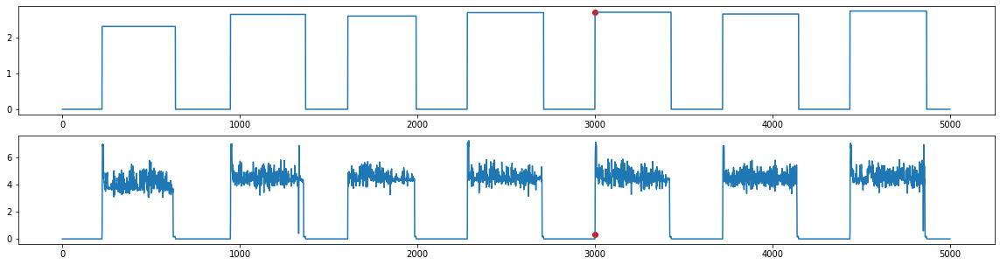

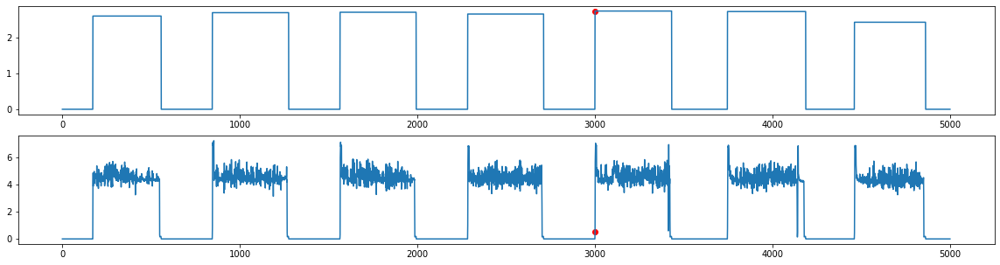

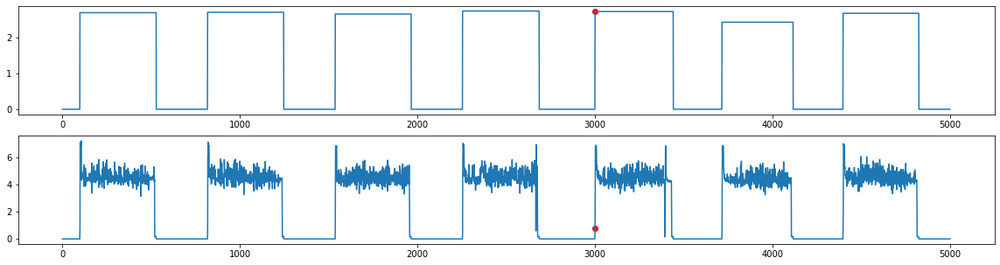

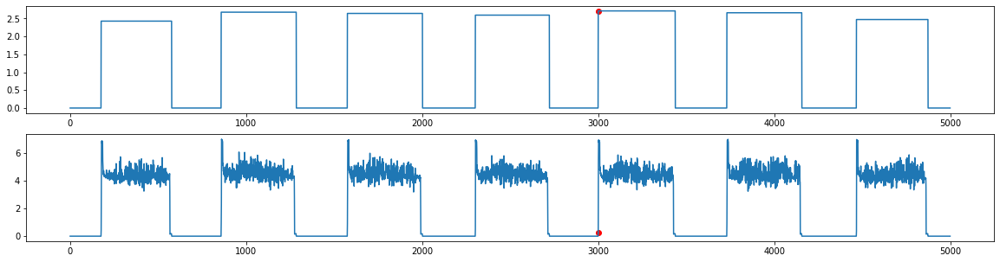

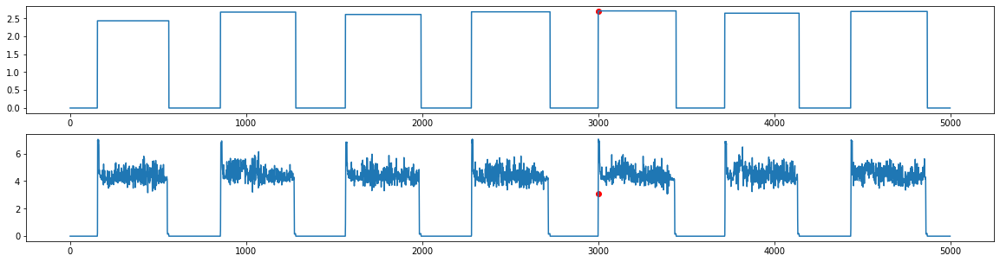

...

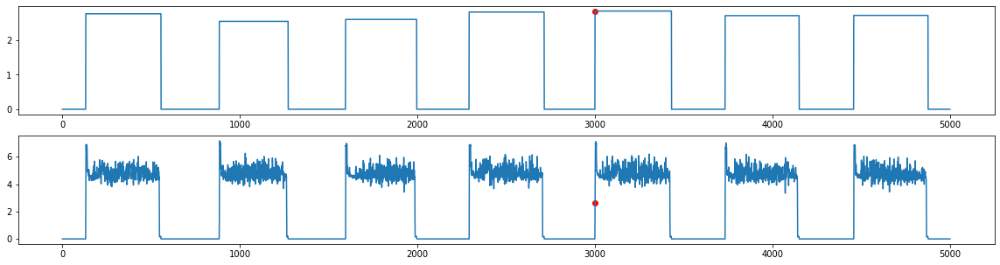

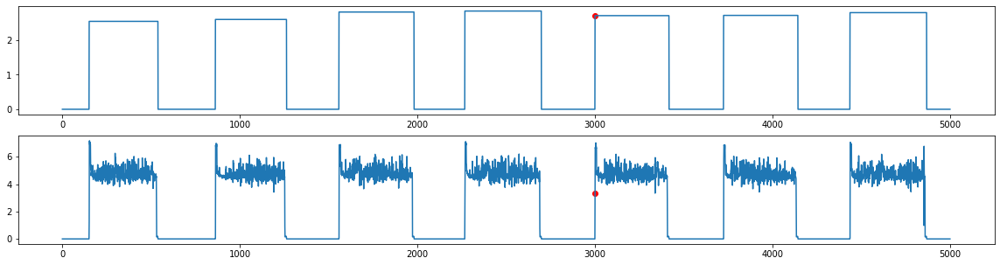

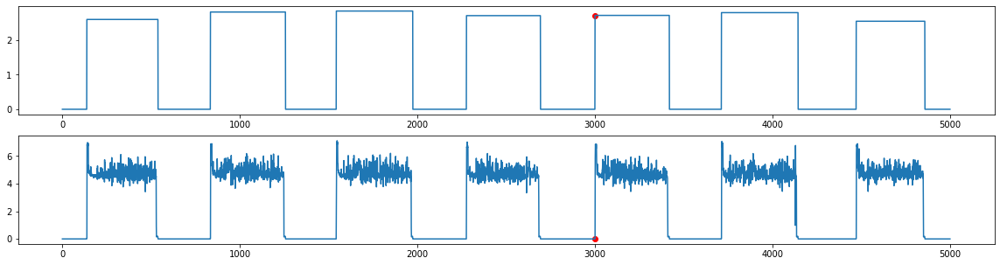

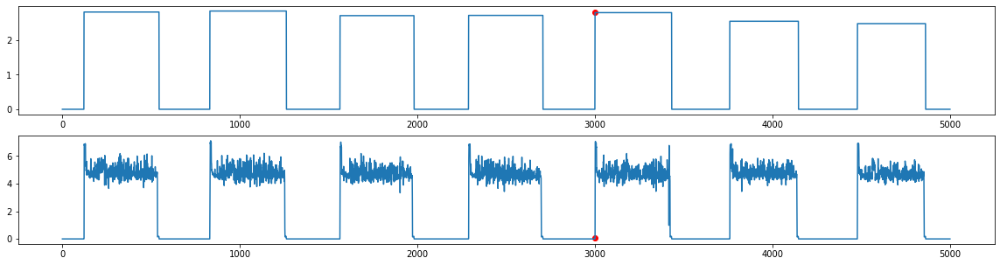

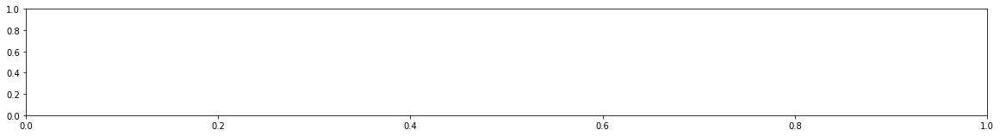

In [76]:
d = 2000
for i in start:
    plt.figure(figsize=(20,5))
    plt.subplot(2, 1, 1)
    plt.plot(y, ap_mean[i - x + d:i + d]) 
    plt.scatter(y[np.where(ap_mean[i - x + d:i + d] == ap_mean[i])[0][0]], ap_mean[i], color='red')
    
    plt.subplot(2, 1, 2)
    plt.plot(y, total_AP_max[i - x + d:i + d]) 
    print(y[np.where(ap_mean[i - x + d:i + d] == ap_mean[i])[0][0]], total_AP_max[i])
    plt.scatter(y[np.where(ap_mean[i - x + d:i + d] == ap_mean[i])[0][0]], total_AP_max[i], color='red')
    #plt.set_title(f'start = {i}')

279055


ValueError: x and y must have same first dimension, but have shapes (5000,) and (609,)

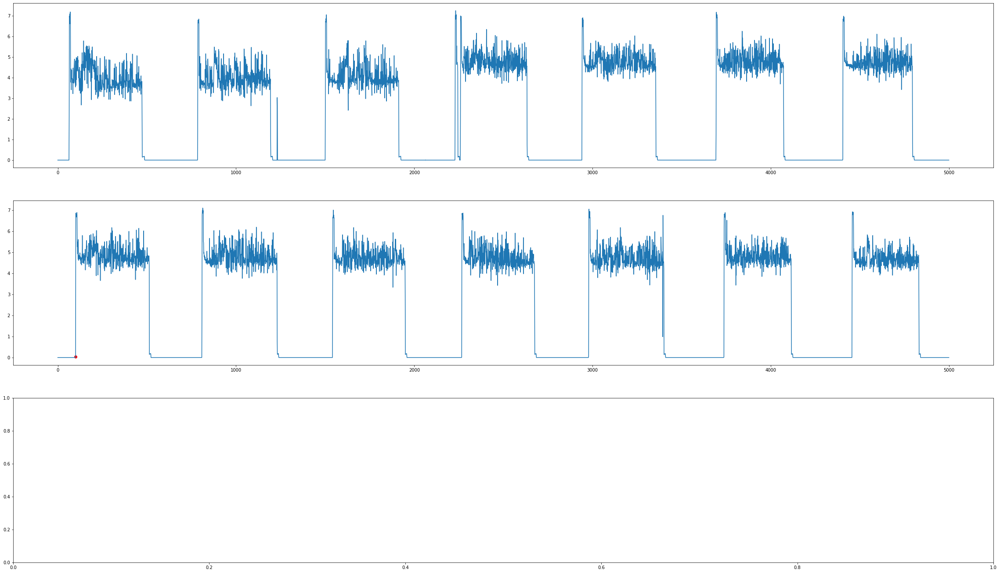

In [129]:
x = 5000
st = 274155      
s = st - 5000 - 100 # - 7000 - 2400 - 5000
print(s + 2 * x)
AP = total_AP_max#[:, 2]
el1 = AP[s:s + x] 
el2 = AP[s + x:s + 2*x]
el3 = AP[s + 2 *x:s + 3 * x] #тут
el4 = AP[s + 3 * x:s + 4*x]
el5 = AP[s + 4 * x:s + 5*x]
el6 = AP[s + 3 * x:s + 4*x]
el7 = AP[s + 3 * x:s + 4*x]
el8 = AP[s + 3 * x:s + 4*x]
el9 = AP[s + 3 * x:s + 4*x]
el10 = AP[s + 3 * x:s + 4*x]
y = np.arange(x)
#el3 = elec.Total_P[257434:257434]
k = 5
plt.figure(figsize=(40,40))
plt.subplot(k, 1, 1)
plt.plot(y, el1)  


plt.subplot(k, 1, 2)
plt.plot(y, el2)
plt.scatter(y[100], total_AP_max[st], color='red')

plt.subplot(k, 1, 3)
plt.plot(y, el3)



plt.subplot(k, 1, 4)
plt.plot(y, el4)

plt.subplot(k, 1, 5)
plt.plot(y, el5)

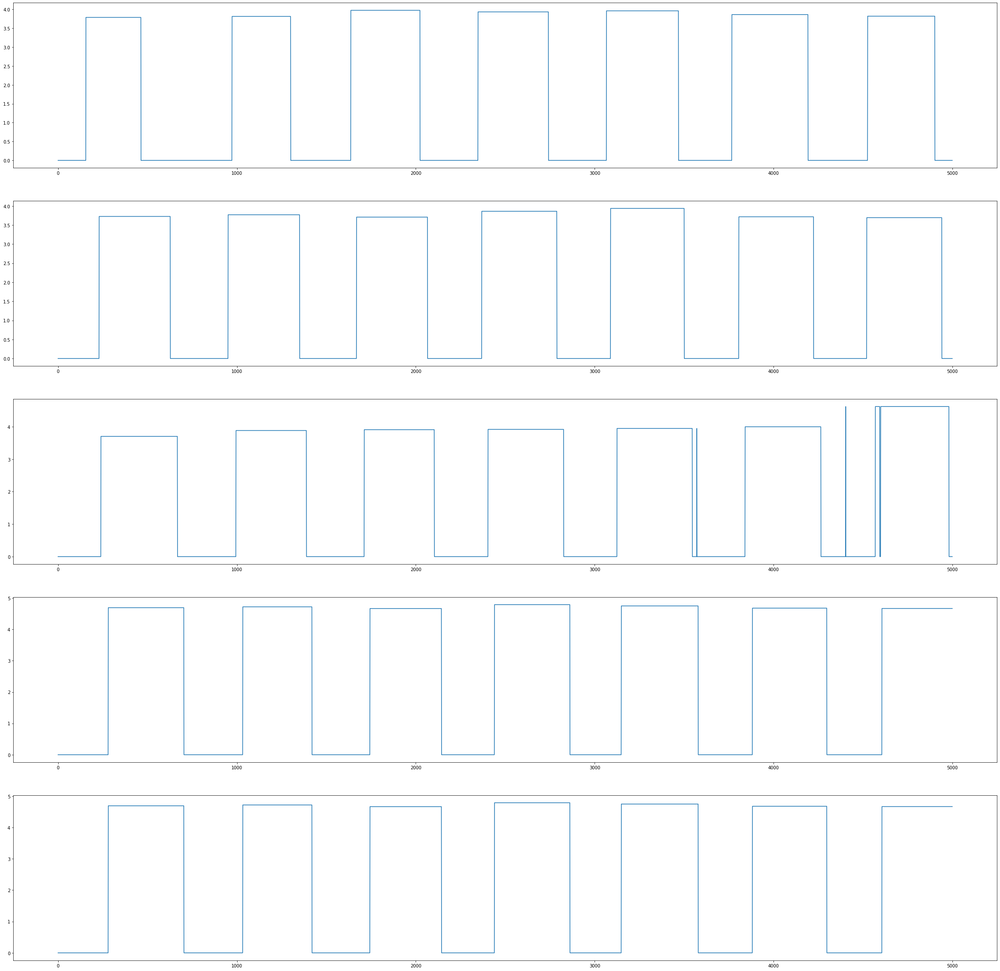

In [135]:
x = 5000
s = 271115 - 7000 - 2400 - 5000
AP = ap_mean#[:, 2]
el1 = AP[s:s + x] 
el2 = AP[s + x:s + 2*x]
el3 = AP[s + 2 *x:s + 3 * x]
el4 = AP[s + 3 * x:s + 4*x]
el5 = AP[s + 3 * x:s + 4*x]
el6 = AP[s + 3 * x:s + 4*x]
el7 = AP[s + 3 * x:s + 4*x]
el8 = AP[s + 3 * x:s + 4*x]
el9 = AP[s + 3 * x:s + 4*x]
el10 = AP[s + 3 * x:s + 4*x]
y = np.arange(x)
#el3 = elec.Total_P[257434:257434]
k = 5
plt.figure(figsize=(40,40))
plt.subplot(k, 1, 1)
plt.plot(y, el1)  

plt.subplot(k, 1, 2)
plt.plot(y, el2)

plt.subplot(k, 1, 3)
plt.plot(y, el3)

plt.subplot(k, 1, 4)
plt.plot(y, el4)

plt.subplot(k, 1, 5)
plt.plot(y, el5)

224555


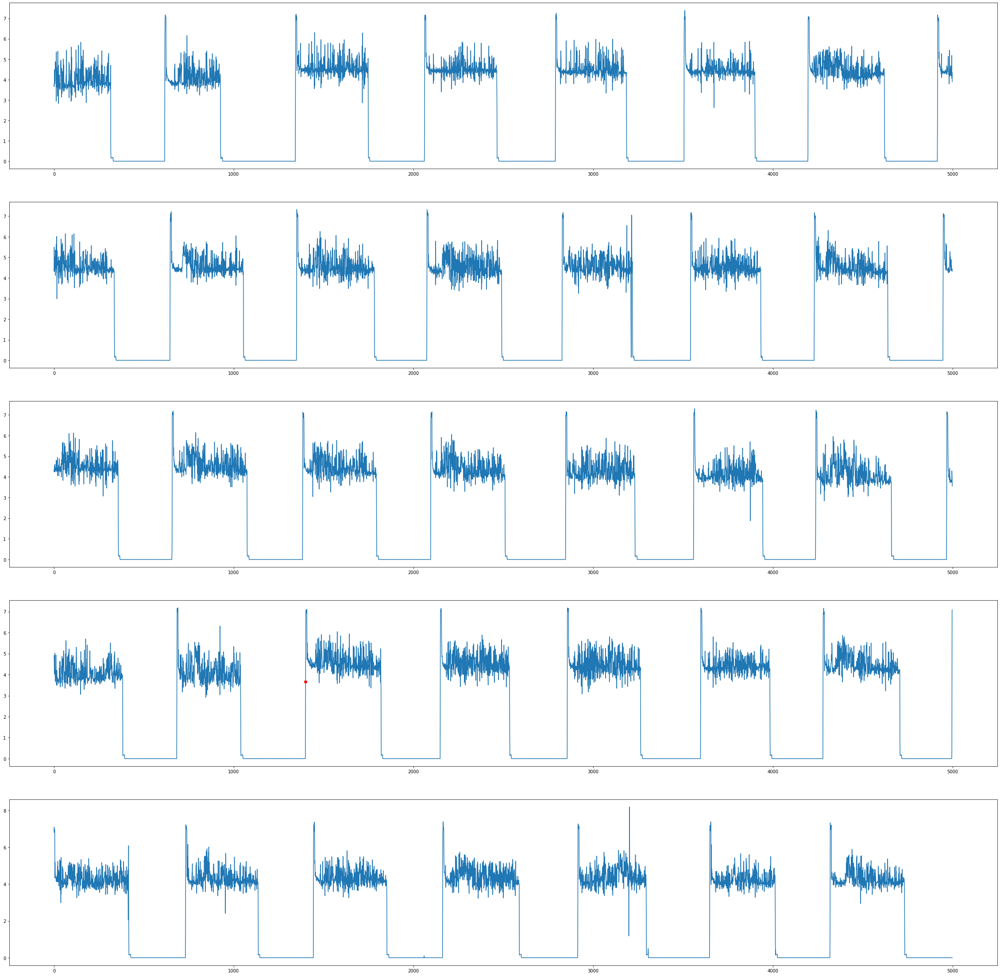

In [103]:
x = 5000
st = 230955   
s = st  - 9000 - 2400 - 5000
print(s + 2 * x)
AP = total_AP_max#[:, 2]
el1 = AP[s:s + x] 
el2 = AP[s + x:s + 2*x]
el3 = AP[s + 2 *x:s + 3 * x] #тут
el4 = AP[s + 3 * x:s + 4*x]
el5 = AP[s + 4 * x:s + 5*x]
el6 = AP[s + 3 * x:s + 4*x]
el7 = AP[s + 3 * x:s + 4*x]
el8 = AP[s + 3 * x:s + 4*x]
el9 = AP[s + 3 * x:s + 4*x]
el10 = AP[s + 3 * x:s + 4*x]
y = np.arange(x)
#el3 = elec.Total_P[257434:257434]
k = 5
plt.figure(figsize=(40,40))
plt.subplot(k, 1, 1)
plt.plot(y, el1)  

plt.subplot(k, 1, 2)
plt.plot(y, el2)

plt.subplot(k, 1, 3)
plt.plot(y, el3)
#plt.scatter(y[np.where(total_AP_max[s + 2 *x:s + 3 * x] == total_AP_max[st])[0][0]], total_AP_max[i], color='red')

plt.subplot(k, 1, 4)
plt.plot(y, el4)
plt.scatter(y[np.where(total_AP_max[s + 3 *x:s + 4 * x] == total_AP_max[st])[0][0]], total_AP_max[i], color='red')


plt.subplot(k, 1, 5)
plt.plot(y, el5)

101322


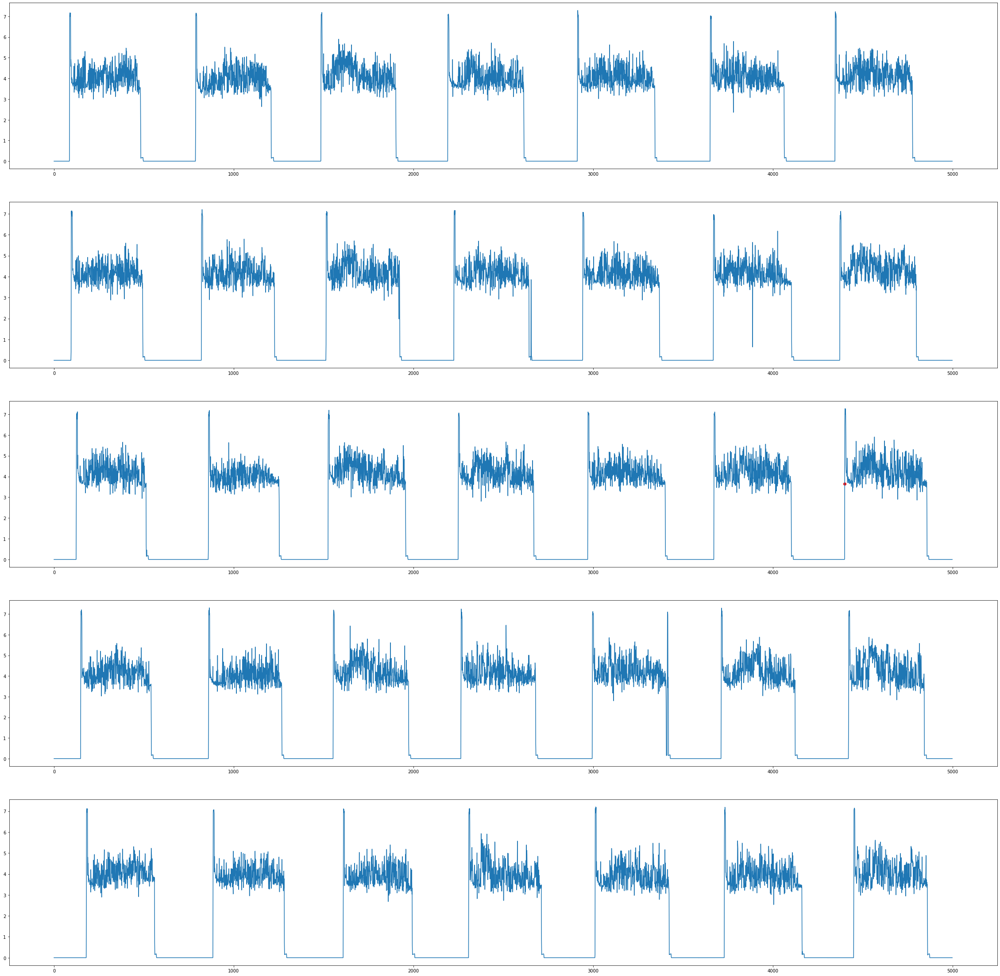

In [89]:
x = 5000
st = 105722   
s = st  - 7000 - 2400 - 5000
print(s + 2 * x)
AP = total_AP_max#[:, 2]
el1 = AP[s:s + x] 
el2 = AP[s + x:s + 2*x]
el3 = AP[s + 2 *x:s + 3 * x] #тут
el4 = AP[s + 3 * x:s + 4*x]
el5 = AP[s + 4 * x:s + 5*x]
el6 = AP[s + 3 * x:s + 4*x]
el7 = AP[s + 3 * x:s + 4*x]
el8 = AP[s + 3 * x:s + 4*x]
el9 = AP[s + 3 * x:s + 4*x]
el10 = AP[s + 3 * x:s + 4*x]
y = np.arange(x)
#el3 = elec.Total_P[257434:257434]
k = 5
plt.figure(figsize=(40,40))
plt.subplot(k, 1, 1)
plt.plot(y, el1)  

plt.subplot(k, 1, 2)
plt.plot(y, el2)

plt.subplot(k, 1, 3)
plt.plot(y, el3)
plt.scatter(y[np.where(total_AP_max[s + 2 *x:s + 3 * x] == total_AP_max[st])[0][0]], total_AP_max[i], color='red')

plt.subplot(k, 1, 4)
plt.plot(y, el4)

plt.subplot(k, 1, 5)
plt.plot(y, el5)

133375


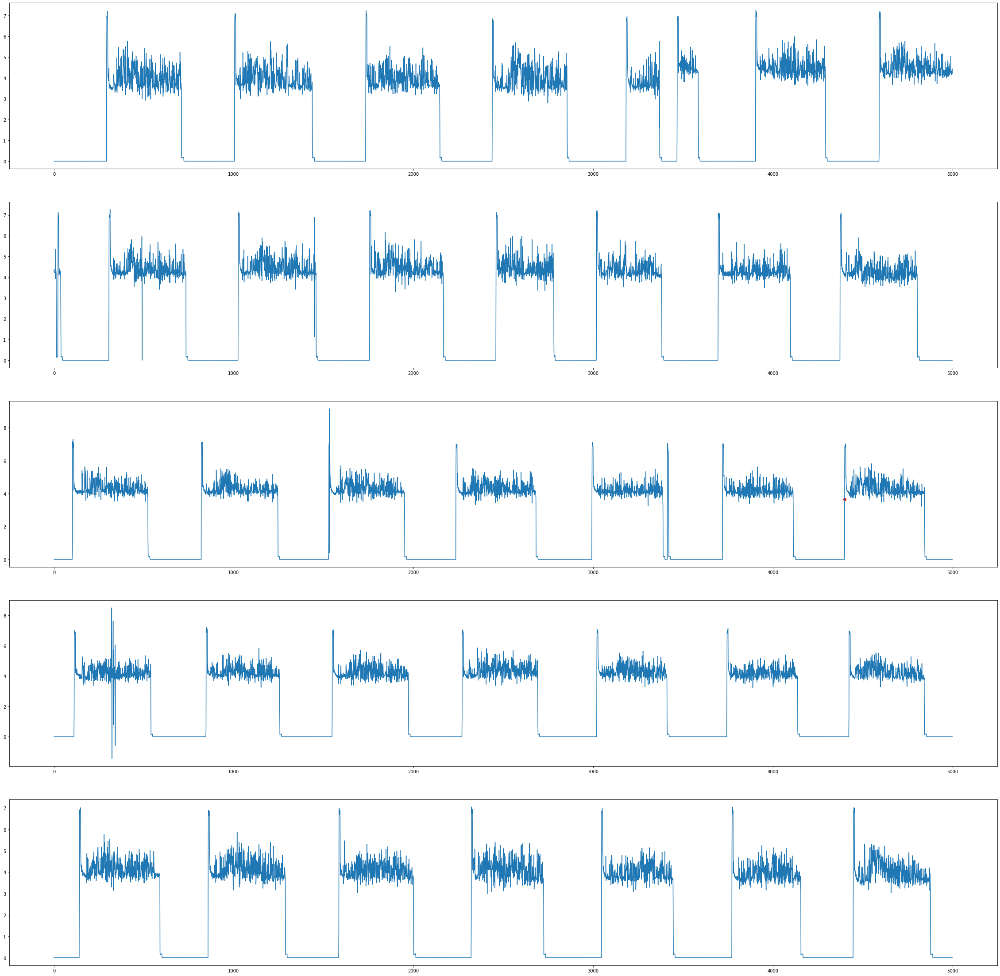

In [93]:
x = 5000
st = 137775    
s = st  - 7000 - 2400 - 5000
print(s + 2 * x)
AP = total_AP_max#[:, 2]
el1 = AP[s:s + x] 
el2 = AP[s + x:s + 2*x]
el3 = AP[s + 2 *x:s + 3 * x] #тут
el4 = AP[s + 3 * x:s + 4*x]
el5 = AP[s + 4 * x:s + 5*x]
el6 = AP[s + 3 * x:s + 4*x]
el7 = AP[s + 3 * x:s + 4*x]
el8 = AP[s + 3 * x:s + 4*x]
el9 = AP[s + 3 * x:s + 4*x]
el10 = AP[s + 3 * x:s + 4*x]
y = np.arange(x)
#el3 = elec.Total_P[257434:257434]
k = 5
plt.figure(figsize=(40,40))
plt.subplot(k, 1, 1)
plt.plot(y, el1)  

plt.subplot(k, 1, 2)
plt.plot(y, el2)

plt.subplot(k, 1, 3)
plt.plot(y, el3)
plt.scatter(y[np.where(total_AP_max[s + 2 *x:s + 3 * x] == total_AP_max[st])[0][0]], total_AP_max[i], color='red')

plt.subplot(k, 1, 4)
plt.plot(y, el4)

plt.subplot(k, 1, 5)
plt.plot(y, el5)

156261


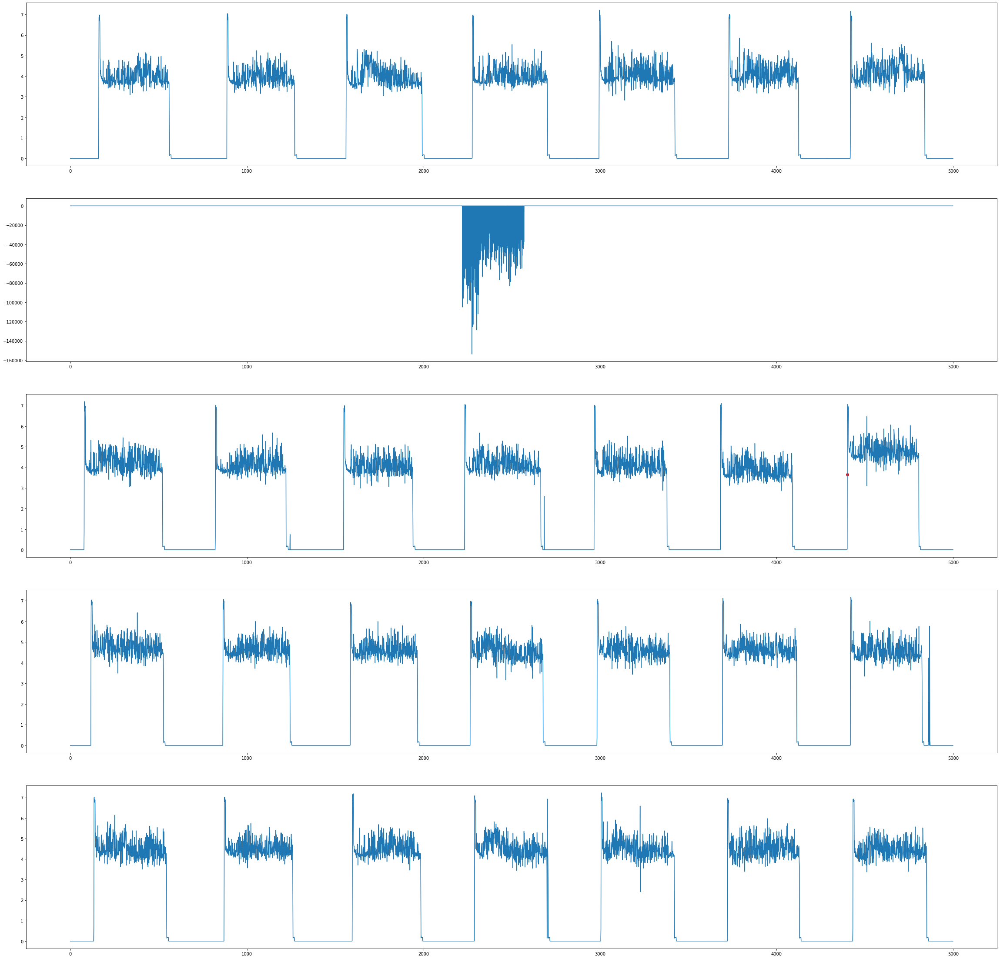

In [94]:
x = 5000
st = 160661 #161378  #220905 230955 271996 
s = st  - 7000 - 2400 - 5000
print(s + 2 * x)
AP = total_AP_max#[:, 2]
el1 = AP[s:s + x] 
el2 = AP[s + x:s + 2*x]
el3 = AP[s + 2 *x:s + 3 * x] #тут
el4 = AP[s + 3 * x:s + 4*x]
el5 = AP[s + 4 * x:s + 5*x]
el6 = AP[s + 3 * x:s + 4*x]
el7 = AP[s + 3 * x:s + 4*x]
el8 = AP[s + 3 * x:s + 4*x]
el9 = AP[s + 3 * x:s + 4*x]
el10 = AP[s + 3 * x:s + 4*x]
y = np.arange(x)
#el3 = elec.Total_P[257434:257434]
k = 5
plt.figure(figsize=(40,40))
plt.subplot(k, 1, 1)
plt.plot(y, el1)  

plt.subplot(k, 1, 2)
plt.plot(y, el2)

plt.subplot(k, 1, 3)
plt.plot(y, el3)
plt.scatter(y[np.where(total_AP_max[s + 2 *x:s + 3 * x] == total_AP_max[st])[0][0]], total_AP_max[i], color='red')

plt.subplot(k, 1, 4)
plt.plot(y, el4)

plt.subplot(k, 1, 5)
plt.plot(y, el5)

In [2]:
df = pd.read_csv('IQDS_interpol_30.csv')

In [3]:
df

,week_day,minute,total_AP_max,temperature,humidity
0,4.0,95.0,339.999999,28.115,46.58
1,4.0,97.0,350.000002,28.240,45.63
2,4.0,99.0,320.000006,28.240,45.63
3,4.0,101.0,310.000003,28.275,45.42
4,4.0,103.0,329.999995,28.310,45.21
...,...,...,...,...,...
118400,0.0,1251.0,329.999995,24.650,23.69
118401,0.0,1253.0,330.000010,24.130,23.47
118402,0.0,1255.0,329.999995,24.130,23.47
118403,0.0,1257.0,329.999995,24.130,23.47


ValueError: x and y must have same first dimension, but have shapes (5000,) and (3550,)

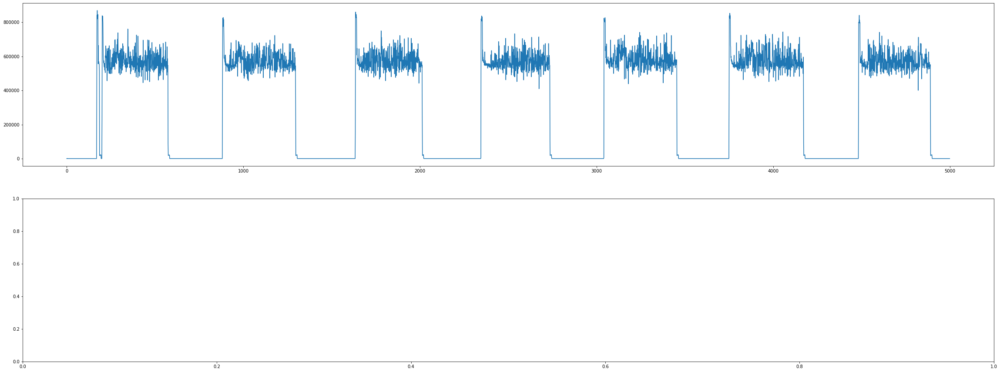

In [13]:
x = 5000
st = 110737 #161378  #220905 230955 271996 
s = st  - 1000 + 118
#print(s + 2 * x)
AP = df.total_AP_max#[:, 2]
el1 = AP[s:s + x] 
el2 = AP[s + x:s + 2*x]
el3 = AP[s + 2 *x:s + 3 * x] #тут
el4 = AP[s + 3 * x:s + 4*x]
el5 = AP[s + 4 * x:s + 5*x]
el6 = AP[s + 3 * x:s + 4*x]
el7 = AP[s + 3 * x:s + 4*x]
el8 = AP[s + 3 * x:s + 4*x]
el9 = AP[s + 3 * x:s + 4*x]
el10 = AP[s + 3 * x:s + 4*x]
y = np.arange(x)
#el3 = elec.Total_P[257434:257434]
k = 5
plt.figure(figsize=(40,40))
plt.subplot(k, 1, 1)
plt.plot(y, el1)  

plt.subplot(k, 1, 2)
plt.plot(y, el2)

plt.subplot(k, 1, 3)
plt.plot(y, el3)
plt.scatter(y[np.where(total_AP_max[s + 2 *x:s + 3 * x] == total_AP_max[st])[0][0]], total_AP_max[i], color='red')

plt.subplot(k, 1, 4)
plt.plot(y, el4)

plt.subplot(k, 1, 5)
plt.plot(y, el5)

In [21]:
st = 109855
for j, i in enumerate(df.week_day[st  - 7300:st + 1]):
    print(j, i)

0 6.0
1 6.0
2 6.0
3 6.0
4 6.0
5 6.0
6 6.0
7 6.0
8 6.0
9 6.0
10 6.0
11 6.0
12 6.0
13 6.0
14 6.0
15 6.0
16 6.0
17 6.0
18 6.0
19 6.0
20 6.0
21 6.0
22 6.0
23 6.0
24 6.0
25 6.0
26 6.0
27 6.0
28 6.0
29 6.0
30 6.0
31 6.0
32 6.0
33 6.0
34 6.0
35 6.0
36 6.0
37 6.0
38 6.0
39 6.0
40 6.0
41 6.0
42 6.0
43 6.0
44 6.0
45 6.0
46 6.0
47 6.0
48 6.0
49 6.0
50 6.0
51 6.0
52 6.0
53 6.0
54 6.0
55 6.0
56 6.0
57 6.0
58 6.0
59 6.0
60 6.0
61 6.0
62 6.0
63 6.0
64 6.0
65 6.0
66 6.0
67 6.0
68 6.0
69 6.0
70 6.0
71 6.0
72 6.0
73 6.0
74 6.0
75 6.0
76 6.0
77 6.0
78 6.0
79 6.0
80 6.0
81 6.0
82 6.0
83 6.0
84 6.0
85 6.0
86 6.0
87 6.0
88 6.0
89 6.0
90 6.0
91 6.0
92 6.0
93 6.0
94 6.0
95 6.0
96 6.0
97 6.0
98 6.0
99 0.0
100 0.0
101 0.0
102 0.0
103 0.0
104 0.0
105 0.0
106 0.0
107 0.0
108 0.0
109 0.0
110 0.0
111 0.0
112 0.0
113 0.0
114 0.0
115 0.0
116 0.0
117 0.0
118 0.0
119 0.0
120 0.0
121 0.0
122 0.0
123 0.0
124 0.0
125 0.0
126 0.0
127 0.0
128 0.0
129 0.0
130 0.0
131 0.0
132 0.0
133 0.0
134 0.0
135 0.0
136 0.0
137 0.0
138 0.

2214 2.0
2215 2.0
2216 2.0
2217 2.0
2218 2.0
2219 2.0
2220 2.0
2221 2.0
2222 2.0
2223 2.0
2224 2.0
2225 2.0
2226 2.0
2227 2.0
2228 2.0
2229 2.0
2230 2.0
2231 2.0
2232 2.0
2233 2.0
2234 2.0
2235 2.0
2236 2.0
2237 2.0
2238 2.0
2239 2.0
2240 2.0
2241 2.0
2242 2.0
2243 2.0
2244 2.0
2245 2.0
2246 2.0
2247 2.0
2248 2.0
2249 2.0
2250 2.0
2251 2.0
2252 2.0
2253 2.0
2254 2.0
2255 2.0
2256 2.0
2257 2.0
2258 2.0
2259 3.0
2260 3.0
2261 3.0
2262 3.0
2263 3.0
2264 3.0
2265 3.0
2266 3.0
2267 3.0
2268 3.0
2269 3.0
2270 3.0
2271 3.0
2272 3.0
2273 3.0
2274 3.0
2275 3.0
2276 3.0
2277 3.0
2278 3.0
2279 3.0
2280 3.0
2281 3.0
2282 3.0
2283 3.0
2284 3.0
2285 3.0
2286 3.0
2287 3.0
2288 3.0
2289 3.0
2290 3.0
2291 3.0
2292 3.0
2293 3.0
2294 3.0
2295 3.0
2296 3.0
2297 3.0
2298 3.0
2299 3.0
2300 3.0
2301 3.0
2302 3.0
2303 3.0
2304 3.0
2305 3.0
2306 3.0
2307 3.0
2308 3.0
2309 3.0
2310 3.0
2311 3.0
2312 3.0
2313 3.0
2314 3.0
2315 3.0
2316 3.0
2317 3.0
2318 3.0
2319 3.0
2320 3.0
2321 3.0
2322 3.0
2323 3.0
2324 3.0
2

4639 6.0
4640 6.0
4641 6.0
4642 6.0
4643 6.0
4644 6.0
4645 6.0
4646 6.0
4647 6.0
4648 6.0
4649 6.0
4650 6.0
4651 6.0
4652 6.0
4653 6.0
4654 6.0
4655 6.0
4656 6.0
4657 6.0
4658 6.0
4659 6.0
4660 6.0
4661 6.0
4662 6.0
4663 6.0
4664 6.0
4665 6.0
4666 6.0
4667 6.0
4668 6.0
4669 6.0
4670 6.0
4671 6.0
4672 6.0
4673 6.0
4674 6.0
4675 6.0
4676 6.0
4677 6.0
4678 6.0
4679 6.0
4680 6.0
4681 6.0
4682 6.0
4683 6.0
4684 6.0
4685 6.0
4686 6.0
4687 6.0
4688 6.0
4689 6.0
4690 6.0
4691 6.0
4692 6.0
4693 6.0
4694 6.0
4695 6.0
4696 6.0
4697 6.0
4698 6.0
4699 6.0
4700 6.0
4701 6.0
4702 6.0
4703 6.0
4704 6.0
4705 6.0
4706 6.0
4707 6.0
4708 6.0
4709 6.0
4710 6.0
4711 6.0
4712 6.0
4713 6.0
4714 6.0
4715 6.0
4716 6.0
4717 6.0
4718 6.0
4719 6.0
4720 6.0
4721 6.0
4722 6.0
4723 6.0
4724 6.0
4725 6.0
4726 6.0
4727 6.0
4728 6.0
4729 6.0
4730 6.0
4731 6.0
4732 6.0
4733 6.0
4734 6.0
4735 6.0
4736 6.0
4737 6.0
4738 6.0
4739 6.0
4740 6.0
4741 6.0
4742 6.0
4743 6.0
4744 6.0
4745 6.0
4746 6.0
4747 6.0
4748 6.0
4749 6.0
4

6963 2.0
6964 2.0
6965 2.0
6966 2.0
6967 2.0
6968 2.0
6969 2.0
6970 2.0
6971 2.0
6972 2.0
6973 2.0
6974 2.0
6975 2.0
6976 2.0
6977 2.0
6978 2.0
6979 2.0
6980 2.0
6981 2.0
6982 2.0
6983 2.0
6984 2.0
6985 2.0
6986 2.0
6987 2.0
6988 2.0
6989 2.0
6990 2.0
6991 2.0
6992 2.0
6993 2.0
6994 2.0
6995 2.0
6996 2.0
6997 2.0
6998 2.0
6999 2.0
7000 2.0
7001 2.0
7002 2.0
7003 2.0
7004 2.0
7005 2.0
7006 2.0
7007 2.0
7008 2.0
7009 2.0
7010 2.0
7011 2.0
7012 2.0
7013 2.0
7014 2.0
7015 2.0
7016 2.0
7017 2.0
7018 2.0
7019 2.0
7020 2.0
7021 2.0
7022 2.0
7023 2.0
7024 2.0
7025 2.0
7026 2.0
7027 2.0
7028 2.0
7029 2.0
7030 2.0
7031 2.0
7032 2.0
7033 2.0
7034 2.0
7035 2.0
7036 2.0
7037 2.0
7038 2.0
7039 2.0
7040 2.0
7041 2.0
7042 2.0
7043 2.0
7044 2.0
7045 2.0
7046 2.0
7047 2.0
7048 2.0
7049 2.0
7050 2.0
7051 2.0
7052 2.0
7053 2.0
7054 2.0
7055 2.0
7056 2.0
7057 2.0
7058 2.0
7059 2.0
7060 2.0
7061 2.0
7062 2.0
7063 2.0
7064 2.0
7065 2.0
7066 2.0
7067 2.0
7068 2.0
7069 2.0
7070 2.0
7071 2.0
7072 2.0
7073 2.0
7

# День с аномалией: 109855
Возьмем 10 дней до: 102654 - 109855

In [22]:
norm_ind = np.arange(102654, 109855, 1)

In [92]:
X_train = np.array(df.total_AP_max[102654:109855])

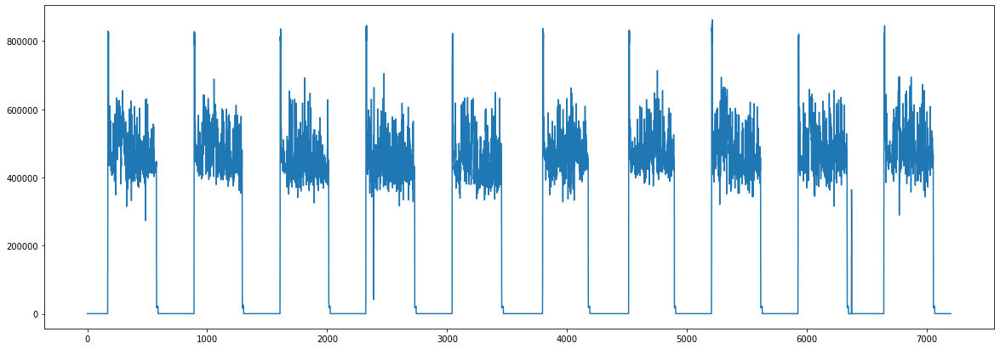

In [36]:
plt.figure(figsize=(20,7))
#plt.subplot(k, 1, 1)
plt.plot(np.arange(X_train.shape[0]), X_train) 

In [37]:
arma = ARIMA(X_train, order=(4, 0, 4), enforce_stationarity = False, enforce_invertibility = False) # (4, 0, 4)
arma_fit = arma.fit()
#    y_pred = arma_fit.forecast(1)

c:\users\lomonosova\appdata\local\programs\python\python38\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [40]:
arma_fit.resid.shape

(7201,)

In [41]:
X_train.shape

(7201,)

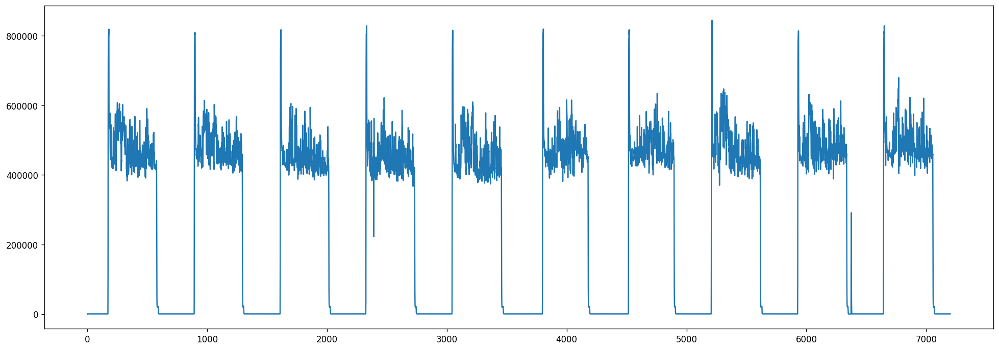

In [52]:
plt.figure(figsize=(20,7)) 
 
# importing data 
#mydata = pd.read_csv('mydataset.csv', names = ['value'], header = 0) 
 
# Creating ARIMA model 
mymodel = ARIMA(X_train, order =(1, 1, 1)) 
modelfit = mymodel.fit() 
 
# Actual vs Fitted 
#plt.plot(df_log_shift)
plt.plot(modelfit.fittedvalues)
#Источник: https://pythonpip.ru/examples/model-arima-v-python

In [57]:
pred = modelfit.predict(start=6000 ,end=11000)

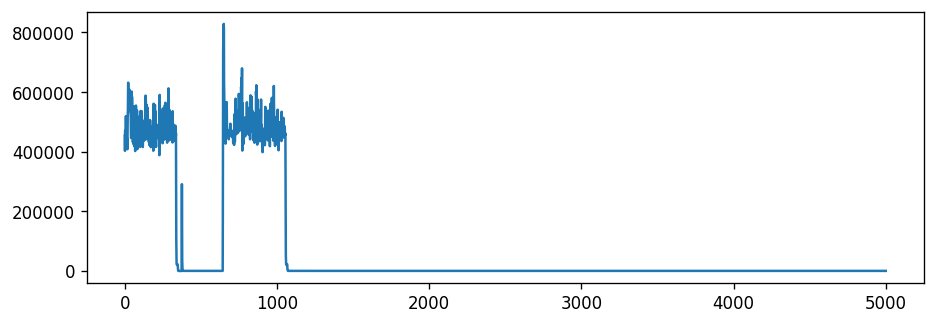

In [58]:
plt.plot(pred)

In [65]:
X_test = np.array(df.total_AP_max[109855:])
order = (1, 0, 0)
predictions_f = []
predictions_p = []
for t in range(5000):
    print(t)
    model = ARIMA(X_train, order=order)
    model_fit = model.fit()
    yhat_f = model_fit.forecast()[0]
    yhat_p = model_fit.predict(start=len(X_train), end=len(X_train))[0]
    predictions_f.append(yhat_f)
    predictions_p.append(yhat_p)
    X_train = np.append(X_train, X_test[t])

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

1862
1863
1864
1865
1866
1867
1868
1869
1870
1871
1872
1873
1874
1875
1876
1877
1878
1879
1880
1881
1882
1883
1884
1885
1886
1887
1888
1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061


3502
3503
3504
3505
3506
3507
3508
3509
3510
3511
3512
3513
3514
3515
3516
3517
3518
3519
3520
3521
3522
3523
3524
3525
3526
3527
3528
3529
3530
3531
3532
3533
3534
3535
3536
3537
3538
3539
3540
3541
3542
3543
3544
3545
3546
3547
3548
3549
3550
3551
3552
3553
3554
3555
3556
3557
3558
3559
3560
3561
3562
3563
3564
3565
3566
3567
3568
3569
3570
3571
3572
3573
3574
3575
3576
3577
3578
3579
3580
3581
3582
3583
3584
3585
3586
3587
3588
3589
3590
3591
3592
3593
3594
3595
3596
3597
3598
3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3636
3637
3638
3639
3640
3641
3642
3643
3644
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3655
3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668
3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680
3681
3682
3683
3684
3685
3686
3687
3688
3689
3690
3691
3692
3693
3694
3695
3696
3697
3698
3699
3700
3701


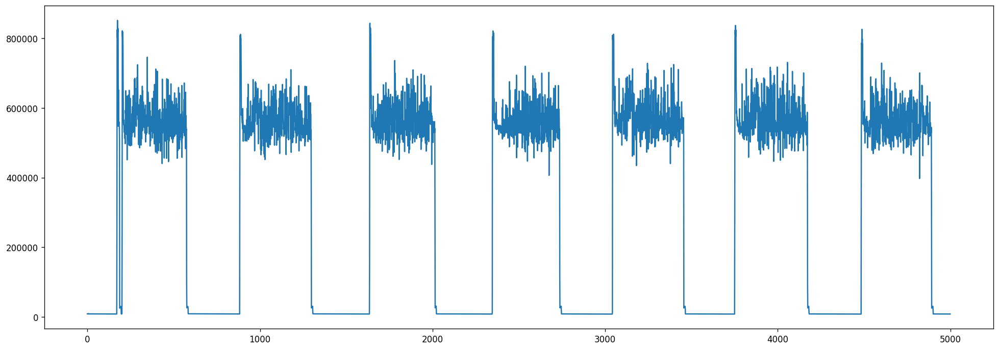

In [66]:
plt.figure(figsize=(20,7))
plt.plot(predictions_p)

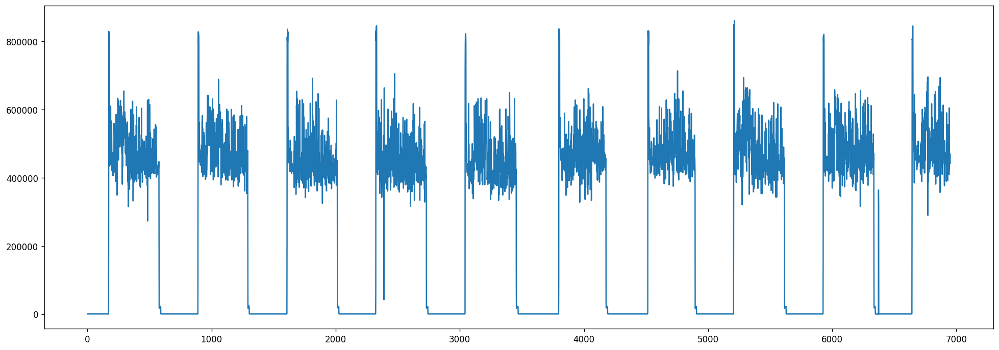

In [107]:
plt.figure(figsize=(20,7))
plt.plot(X_train[:-250])

In [124]:
mymodel = ARIMA(X_train[:-250], order =(1, 0, 2)) 
modelfit = mymodel.fit() 
y_pred = modelfit.predict(start=len(X_train) - 1000, end=len(X_train) - 250 + 10)

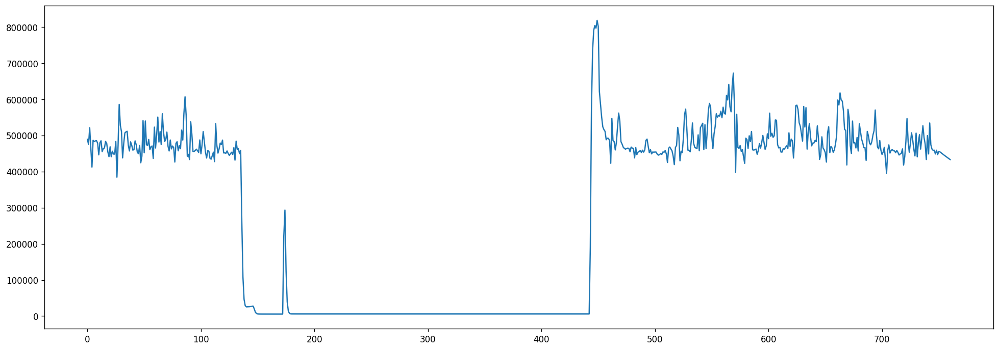

In [125]:
plt.figure(figsize=(20,7))
plt.plot(y_pred)

In [138]:
X_train = np.array(df.total_AP_max[102654:109855 - 250])
pred = []
delta = 2
ind_del = np.arange(delta)
ind_app = np.arange(len(X_train) - delta, len(X_train))
for i in range(1000 // delta):
    mymodel = ARIMA(X_train, order =(1, 0, 2)) 
    modelfit = mymodel.fit()
    y_pred = modelfit.predict(start=len(X_train), end=len(X_train) + delta)
    pred.append(y_pred)
    X_train = np.delete(X_train, ind_del)
    X_train = np.append(X_train, y_pred)

In [139]:
pred_l = []
for i in pred:
    for j in i:
        pred_l.append(j)
pred = np.array(pred_l)
ans = np.concatenate((np.array(df.total_AP_max[102654:109855 - 250]), pred))

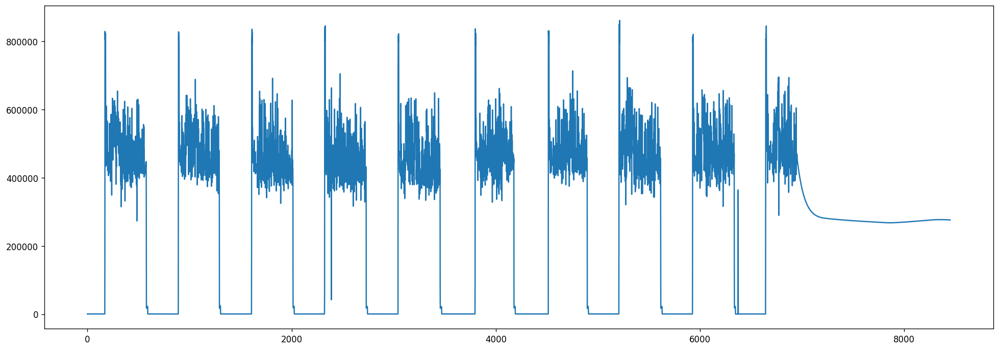

In [140]:
plt.figure(figsize=(20,7))
plt.plot(ans)

## Среднее по промежутку времени

In [162]:
# 617 687
x = 2838
df[x - 10:x + 10]

,week_day,minute,total_AP_max,temperature,humidity
2828,1.0,10.0,339.999999,27.450,36.450
2829,1.0,12.0,379.999998,27.450,36.450
2830,1.0,14.0,339.999999,27.450,36.450
2831,1.0,16.0,360.000005,27.450,36.450
2832,1.0,18.0,350.000002,27.545,39.190
2833,1.0,20.0,369.999994,27.640,41.930
2834,1.0,22.0,360.000005,27.640,41.930
2835,1.0,24.0,379.999998,27.640,41.930
2836,1.0,26.0,360.000005,27.640,41.930
2837,1.0,28.0,329.999995,27.640,41.930


In [87]:
df.minute[np.where(df.minute % 2 != 0)[0]] -= 1
st_hour = np.where(df.minute % 60 == 0)[0]


In [88]:
AP_mean = []
df.minute[np.where(df.minute % 2 != 0)[0]] -= 1
st_hour = np.where(df.minute % 60 == 0)[0]
for i in range(1, len(st_hour)):
    for j in range(st_hour[i - 1], st_hour[i]):
        AP_mean.append(np.mean(df.total_AP_max[st_hour[i - 1]: st_hour[i]]))

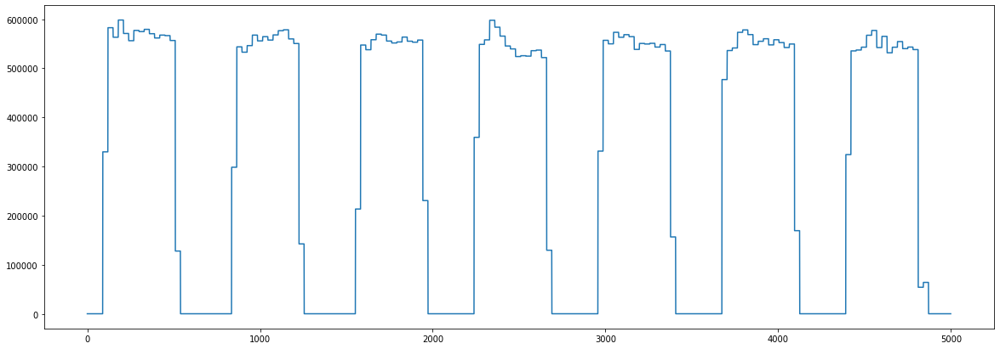

In [89]:
plt.figure(figsize=(20,7))
plt.plot(AP_mean[:5000])

In [90]:
X_train = np.array(AP_mean[102654:109855 - 250])
pred = []
delta = 10
ind_del = np.arange(delta)
ind_app = np.arange(len(X_train) - delta, len(X_train))
for i in range(1000 // delta):
    print(i)
    mymodel = ARIMA(X_train, order =(100, 0, 2)) 
    modelfit = mymodel.fit()
    y_pred = modelfit.forecast(2)
    pred.append(y_pred)
    X_train = np.delete(X_train, ind_del)
    X_train = np.append(X_train, y_pred)

0


KeyboardInterrupt: 

In [ ]:
pred_l = []
for i in pred:
    for j in i:
        pred_l.append(j)
pred = np.array(pred_l)
ans = np.concatenate((np.array(AP_mean[102654:109855 - 250]), pred))

In [ ]:
plt.figure(figsize=(20,7))
plt.plot(ans)

In [185]:
df

,week_day,minute,total_AP_max,temperature,humidity
0,4.0,94.0,339.999999,28.115,46.58
1,4.0,96.0,350.000002,28.240,45.63
2,4.0,98.0,320.000006,28.240,45.63
3,4.0,100.0,310.000003,28.275,45.42
4,4.0,102.0,329.999995,28.310,45.21
...,...,...,...,...,...
118400,0.0,1250.0,329.999995,24.650,23.69
118401,0.0,1252.0,330.000010,24.130,23.47
118402,0.0,1254.0,329.999995,24.130,23.47
118403,0.0,1256.0,329.999995,24.130,23.47


In [21]:

import torch
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torch import nn


In [93]:
df = pd.DataFrame(AP_mean, columns={'total_AP_max'})

In [94]:
df = pd.DataFrame(AP_mean, columns={'total_AP_max'})
target_sensor = "total_AP_max"
features = 'total_AP_max'#list(df.columns.difference([target_sensor]))

forecast_lead = 15
target = f"{target_sensor}_lead{forecast_lead}"

df[target] = df[target_sensor].shift(-forecast_lead)
df = df.iloc[:-forecast_lead]

In [95]:
df_train = df.iloc[109855 - 10000:109855].copy()
df_test = df.iloc[109855: 109855 + 2000].copy()

print("Test set fraction:", len(df_test) / len(df_train))

Test set fraction: 0.2


In [96]:
class SequenceDataset(Dataset):
    def __init__(self, dataframe, target, features, sequence_length=5):
        self.features = features
        self.target = target
        self.sequence_length = sequence_length
        self.y = torch.tensor(dataframe[target].values).float()
        print(dataframe[features].values[:,np.newaxis].shape)
        self.X = torch.tensor(dataframe[features].values[:,np.newaxis]).float()#.unsqueeze(0)

    def __len__(self):
        return self.X.shape[0]

    def __getitem__(self, i): 
        if i >= self.sequence_length - 1:
            i_start = i - self.sequence_length + 1
            x = self.X[i_start:(i + 1), :]
        else:
            padding = self.X[0].repeat(self.sequence_length - i - 1, 1)
            x = self.X[0:(i + 1), :]
            x = torch.cat((padding, x), 0)

        return x, self.y[i]

In [97]:
i = 27
sequence_length = 4

train_dataset = SequenceDataset(
    df_train,
    target=target,
    features=features,
    sequence_length=sequence_length
)


(10000, 1)


In [98]:
torch.manual_seed(99)

train_loader = DataLoader(train_dataset, batch_size=3, shuffle=True)

X, y = next(iter(train_loader))
print(X.shape)
print(X)

torch.Size([3, 4, 1])
tensor([[[421629.0000],
         [421629.0000],
         [421629.0000],
         [421629.0000]],

        [[453117.3438],
         [453117.3438],
         [453117.3438],
         [453117.3438]],

        [[437650.6562],
         [437650.6562],
         [437650.6562],
         [437650.6562]]])


In [99]:
torch.manual_seed(101)

batch_size = 4
sequence_length = 30

train_dataset = SequenceDataset(
    df_train,
    target=target,
    features=features,
    sequence_length=sequence_length
)
test_dataset = SequenceDataset(
    df_test,
    target=target,
    features=features,
    sequence_length=sequence_length
)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

X, y = next(iter(train_loader))

print("Features shape:", X.shape)
print("Target shape:", y.shape)

(10000, 1)
(2000, 1)
Features shape: torch.Size([4, 30, 1])
Target shape: torch.Size([4])


In [100]:
'''
model = Sequential () 
model.add (LSTM (100, активация = 'tanh', input_shape = (num_steps, 1), 
               return_sequences = False)) 
model.add (Dense (единицы = 50, активация = 'relu')) 
модель .add(Dense(единицы=1, активация='линейный')) 
adam = оптимизаторы.Adam(lr=0.0001) 
model.compile(optimizer=adam, loss='mse') 
model.fit(x_train, y_train, epochs= 20)
'''

class ShallowRegressionLSTM(nn.Module):
    def __init__(self, num_sensors, hidden_units):
        super().__init__()
        self.num_sensors = num_sensors  # this is the number of features
        self.hidden_units = hidden_units
        self.num_layers = 1

        self.lstm = nn.LSTM(
            input_size=num_sensors,
            hidden_size=hidden_units,
            batch_first=True,
            num_layers=self.num_layers
        )

        self.linear = nn.Linear(in_features=self.hidden_units, out_features=1)

    def forward(self, x):
        batch_size = x.shape[0]
        h0 = torch.zeros(self.num_layers, batch_size, self.hidden_units).requires_grad_()
        c0 = torch.zeros(self.num_layers, batch_size, self.hidden_units).requires_grad_()

        _, (hn, _) = self.lstm(x, (h0, c0))
        out = self.linear(hn[0]).flatten()  # First dim of Hn is num_layers, which is set to 1 above.

        return out

In [101]:
learning_rate = 0.001
num_hidden_units = 16

model = ShallowRegressionLSTM(num_sensors=1, hidden_units=num_hidden_units)
loss_function = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

In [106]:
def train_model(data_loader, model, loss_function, optimizer):
    num_batches = len(data_loader)
    total_loss = 0
    model.train()

    for X, y in data_loader:
        output = model(X)
        loss = loss_function(output, y)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    avg_loss = total_loss / num_batches
    print(f"Train loss: {avg_loss}")

def test_model(data_loader, model, loss_function):

    num_batches = len(data_loader)
    total_loss = 0

    model.eval()
    with torch.no_grad():
        for X, y in data_loader:
            output = model(X)
            total_loss += loss_function(output, y).item()

    avg_loss = total_loss / num_batches
    print(f"Test loss: {avg_loss}")


print("Untrained test\n--------")
test_model(test_loader, model, loss_function)
print()

for ix_epoch in range(100):
    print(f"Epoch {ix_epoch}\n---------")
    train_model(train_loader, model, loss_function, optimizer=optimizer)
    test_model(test_loader, model, loss_function)
    print()

Untrained test
--------
Test loss: 189755990070.56454

Epoch 0
---------
Train loss: 120657758475.83888
Test loss: 189744957464.67282

Epoch 1
---------
Train loss: 120649280091.49902
Test loss: 189733967116.67856

Epoch 2
---------
Train loss: 120640783959.85388
Test loss: 189722934139.36694

Epoch 3
---------
Train loss: 120632284810.76843
Test loss: 189711905176.70325

Epoch 4
---------
Train loss: 120623807799.13445
Test loss: 189700876530.30344

Epoch 5
---------
Train loss: 120615328908.55705
Test loss: 189689889728.46533

Epoch 6
---------
Train loss: 120606867200.83247
Test loss: 189678942077.95102

Epoch 7
---------
Train loss: 120598406330.78352
Test loss: 189667916372.0035

Epoch 8
---------
Train loss: 120589934378.41525
Test loss: 189656928559.70993

Epoch 9
---------
Train loss: 120581456911.1291
Test loss: 189645903808.21094

Epoch 10
---------
Train loss: 120572999820.63013
Test loss: 189634919371.86557

Epoch 11
---------
Train loss: 120564545362.39473
Test loss: 18962

In [107]:
def predict(data_loader, model):

    output = torch.tensor([])
    model.eval()
    with torch.no_grad():
        for X, _ in data_loader:
            y_star = model(X)
            output = torch.cat((output, y_star), 0)

    return output


train_eval_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=False)

ystar_col = "Model forecast"
df_train[ystar_col] = predict(train_eval_loader, model).numpy()
df_test[ystar_col] = predict(test_loader, model).numpy()

df_out = pd.concat((df_train, df_test))[[target, ystar_col]]

for c in df_out.columns:
    df_out[c] = df_out[c] * target_stdev + target_mean

print(df_out)

        total_AP_max_lead15  Model forecast
99855          8.875132e+07     464845728.0
99856          8.875132e+07     464845728.0
99857          8.875132e+07     464845728.0
99858          8.875132e+07     464845728.0
99859          8.875132e+07     464845728.0
...                     ...             ...
111850         1.792515e+10     464845728.0
111851         1.792515e+10     464845728.0
111852         1.792515e+10     464845728.0
111853         1.792515e+10     464845728.0
111854         1.792515e+10     464845728.0

[12000 rows x 2 columns]


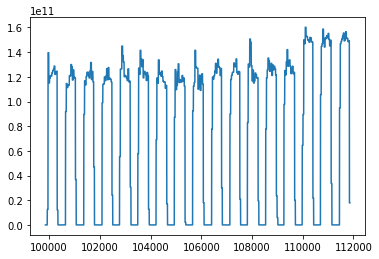

In [108]:

plt.plot(df_out.total_AP_max_lead15)

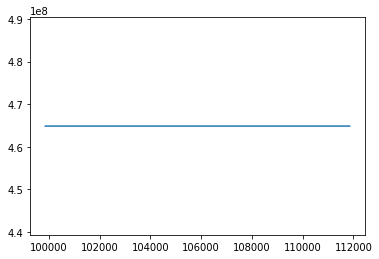

In [109]:
plt.plot(df_out['Model forecast'])

In [215]:
def lstm_data_transform(x_data, y_data, num_steps=5):
    """ Changes data to the format for LSTM training 
for sliding window approach """
    # Prepare the list for the transformed data
    X, y = list(), list()
    # Loop of the entire data set
    for i in range(x_data.shape[0]):
        # compute a new (sliding window) index
        end_ix = i + num_steps
        # if index is larger than the size of the dataset, we stop
        if end_ix >= x_data.shape[0]:
            break
        # Get a sequence of data for x
        seq_X = x_data[i:end_ix]
        # Get only the last element of the sequency for y
        seq_y = y_data[end_ix]
        # Append the list with sequencies
        X.append(seq_X)
        y.append(seq_y)
    # Make final arrays
    x_array = np.array(X)
    y_array = np.array(y)
    return x_array, y_array

In [216]:
X = np.array(df[df.columns[:2]])
X = np.concatenate((X, df[df.columns[3:]]), axis=1)
X = X[102654:]
y = np.array(df.total_AP_max)
y = y[102654:].reshape(-1, 1)
y.shape

(15751, 1)

In [217]:
num_steps = 10
x_new, y_new = lstm_data_transform(y, y, num_steps=num_steps)
print(x_new.shape, y_new.shape)

(15741, 10, 1) (15741, 1)


In [218]:
train_ind = 109855
x_train = x_new[:train_ind]
y_train = y_new[:train_ind]
x_test = x_new[train_ind: train_ind + 1000]
y_test = y_new[train_ind: train_ind + 1000]
x_train.shape

(15741, 10, 1)

In [220]:
model = Sequential()
model.add(LSTM(100, activation='tanh', input_shape=(num_steps, 1), return_sequences=False))
model.add(Dense(units=50, activation='relu'))
model.add(Dense(units=1, activation='linear'))
adam = optimizers.Adam(lr=0.0001)
model.compile(optimizer=adam, loss='mse')
model.fit(x_train, y_train, epochs=20)

NotImplementedError: Cannot convert a symbolic Tensor (lstm_8/strided_slice:0) to a numpy array. This error may indicate that you're trying to pass a Tensor to a NumPy call, which is not supported

In [183]:
model = Sequential()
model.add(LSTM(64,return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[-1])))
model.add(Dropout(0.5))
model.add(LSTM(20,return_sequences=False))
model.add(Dropout(0.5))
model.add(Dense(1))
model.compile(loss='mse', optimizer='rmsprop')

IndexError: tuple index out of range

In [194]:
!pip install -U numpy==1.18.5

  Attempting uninstall: numpy
    Found existing installation: numpy 1.21.4
    Uninstalling numpy-1.21.4:
      Successfully uninstalled numpy-1.21.4


ERROR: Could not install packages due to an EnvironmentError: [WinError 5] Отказано в доступе: 'C:\\Users\\Lomonosova\\AppData\\Local\\Programs\\Python\\Python38\\Lib\\site-packages\\~-mpy\\.libs\\libopenblas.XWYDX2IKJW2NMTWSFYNGFUWKQU3LYTCZ.gfortran-win_amd64.dll'
Consider using the `--user` option or check the permissions.

You should consider upgrading via the 'c:\users\lomonosova\appdata\local\programs\python\python38\python.exe -m pip install --upgrade pip' command.


In [205]:
x = np.arange(0, 200, 0.5).reshape(-1, 1)
y = np.sin(x).reshape(-1, 1)

In [119]:
df = df.iloc[:-17]

In [174]:
delt = 100

X = np.array(df.total_AP_max[109855 - 10500:109855 - 10500 + delt])[np.newaxis, :]
y = []
y.append(df.total_AP_max[109855 - 10500 + delt])
for i in range(1, 12000):
    print(i, i * delt, (i + 1) * delt)
    X = np.concatenate((X, df.total_AP_max[109855 - 10500 + delt + i : 109855 - 10500 + delt + i + delt][np.newaxis, :]), axis=0)
    y.append(df.total_AP_max[109855 - 10500 + delt + i + delt + 1])

1 100 200
2 200 300
3 300 400
4 400 500
5 500 600
6 600 700
7 700 800
8 800 900
9 900 1000
10 1000 1100
11 1100 1200
12 1200 1300
13 1300 1400
14 1400 1500
15 1500 1600
16 1600 1700
17 1700 1800
18 1800 1900
19 1900 2000
20 2000 2100
21 2100 2200
22 2200 2300
23 2300 2400
24 2400 2500
25 2500 2600
26 2600 2700
27 2700 2800
28 2800 2900
29 2900 3000
30 3000 3100
31 3100 3200
32 3200 3300
33 3300 3400
34 3400 3500
35 3500 3600
36 3600 3700
37 3700 3800
38 3800 3900
39 3900 4000
40 4000 4100
41 4100 4200
42 4200 4300
43 4300 4400
44 4400 4500
45 4500 4600
46 4600 4700
47 4700 4800
48 4800 4900
49 4900 5000
50 5000 5100
51 5100 5200
52 5200 5300
53 5300 5400
54 5400 5500
55 5500 5600
56 5600 5700
57 5700 5800
58 5800 5900
59 5900 6000
60 6000 6100
61 6100 6200
62 6200 6300
63 6300 6400
64 6400 6500
65 6500 6600
66 6600 6700
67 6700 6800
68 6800 6900
69 6900 7000
70 7000 7100
71 7100 7200
72 7200 7300
73 7300 7400
74 7400 7500
75 7500 7600
76 7600 7700
77 7700 7800
78 7800 7900
79 7900 8000

<ipython-input-174-e8abbea0e48c>:8: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  X = np.concatenate((X, df.total_AP_max[109855 - 10500 + delt + i : 109855 - 10500 + delt + i + delt][np.newaxis, :]), axis=0)


 91900
919 91900 92000
920 92000 92100
921 92100 92200
922 92200 92300
923 92300 92400
924 92400 92500
925 92500 92600
926 92600 92700
927 92700 92800
928 92800 92900
929 92900 93000
930 93000 93100
931 93100 93200
932 93200 93300
933 93300 93400
934 93400 93500
935 93500 93600
936 93600 93700
937 93700 93800
938 93800 93900
939 93900 94000
940 94000 94100
941 94100 94200
942 94200 94300
943 94300 94400
944 94400 94500
945 94500 94600
946 94600 94700
947 94700 94800
948 94800 94900
949 94900 95000
950 95000 95100
951 95100 95200
952 95200 95300
953 95300 95400
954 95400 95500
955 95500 95600
956 95600 95700
957 95700 95800
958 95800 95900
959 95900 96000
960 96000 96100
961 96100 96200
962 96200 96300
963 96300 96400
964 96400 96500
965 96500 96600
966 96600 96700
967 96700 96800
968 96800 96900
969 96900 97000
970 97000 97100
971 97100 97200
972 97200 97300
973 97300 97400
974 97400 97500
975 97500 97600
976 97600 97700
977 97700 97800
978 97800 97900
979 97900 98000
980 98000 98100
9

1558 155800 155900
1559 155900 156000
1560 156000 156100
1561 156100 156200
1562 156200 156300
1563 156300 156400
1564 156400 156500
1565 156500 156600
1566 156600 156700
1567 156700 156800
1568 156800 156900
1569 156900 157000
1570 157000 157100
1571 157100 157200
1572 157200 157300
1573 157300 157400
1574 157400 157500
1575 157500 157600
1576 157600 157700
1577 157700 157800
1578 157800 157900
1579 157900 158000
1580 158000 158100
1581 158100 158200
1582 158200 158300
1583 158300 158400
1584 158400 158500
1585 158500 158600
1586 158600 158700
1587 158700 158800
1588 158800 158900
1589 158900 159000
1590 159000 159100
1591 159100 159200
1592 159200 159300
1593 159300 159400
1594 159400 159500
1595 159500 159600
1596 159600 159700
1597 159700 159800
1598 159800 159900
1599 159900 160000
1600 160000 160100
1601 160100 160200
1602 160200 160300
1603 160300 160400
1604 160400 160500
1605 160500 160600
1606 160600 160700
1607 160700 160800
1608 160800 160900
1609 160900 161000
1610 161000 

2355 235500 235600
2356 235600 235700
2357 235700 235800
2358 235800 235900
2359 235900 236000
2360 236000 236100
2361 236100 236200
2362 236200 236300
2363 236300 236400
2364 236400 236500
2365 236500 236600
2366 236600 236700
2367 236700 236800
2368 236800 236900
2369 236900 237000
2370 237000 237100
2371 237100 237200
2372 237200 237300
2373 237300 237400
2374 237400 237500
2375 237500 237600
2376 237600 237700
2377 237700 237800
2378 237800 237900
2379 237900 238000
2380 238000 238100
2381 238100 238200
2382 238200 238300
2383 238300 238400
2384 238400 238500
2385 238500 238600
2386 238600 238700
2387 238700 238800
2388 238800 238900
2389 238900 239000
2390 239000 239100
2391 239100 239200
2392 239200 239300
2393 239300 239400
2394 239400 239500
2395 239500 239600
2396 239600 239700
2397 239700 239800
2398 239800 239900
2399 239900 240000
2400 240000 240100
2401 240100 240200
2402 240200 240300
2403 240300 240400
2404 240400 240500
2405 240500 240600
2406 240600 240700
2407 240700 

3032 303200 303300
3033 303300 303400
3034 303400 303500
3035 303500 303600
3036 303600 303700
3037 303700 303800
3038 303800 303900
3039 303900 304000
3040 304000 304100
3041 304100 304200
3042 304200 304300
3043 304300 304400
3044 304400 304500
3045 304500 304600
3046 304600 304700
3047 304700 304800
3048 304800 304900
3049 304900 305000
3050 305000 305100
3051 305100 305200
3052 305200 305300
3053 305300 305400
3054 305400 305500
3055 305500 305600
3056 305600 305700
3057 305700 305800
3058 305800 305900
3059 305900 306000
3060 306000 306100
3061 306100 306200
3062 306200 306300
3063 306300 306400
3064 306400 306500
3065 306500 306600
3066 306600 306700
3067 306700 306800
3068 306800 306900
3069 306900 307000
3070 307000 307100
3071 307100 307200
3072 307200 307300
3073 307300 307400
3074 307400 307500
3075 307500 307600
3076 307600 307700
3077 307700 307800
3078 307800 307900
3079 307900 308000
3080 308000 308100
3081 308100 308200
3082 308200 308300
3083 308300 308400
3084 308400 

3627 362700 362800
3628 362800 362900
3629 362900 363000
3630 363000 363100
3631 363100 363200
3632 363200 363300
3633 363300 363400
3634 363400 363500
3635 363500 363600
3636 363600 363700
3637 363700 363800
3638 363800 363900
3639 363900 364000
3640 364000 364100
3641 364100 364200
3642 364200 364300
3643 364300 364400
3644 364400 364500
3645 364500 364600
3646 364600 364700
3647 364700 364800
3648 364800 364900
3649 364900 365000
3650 365000 365100
3651 365100 365200
3652 365200 365300
3653 365300 365400
3654 365400 365500
3655 365500 365600
3656 365600 365700
3657 365700 365800
3658 365800 365900
3659 365900 366000
3660 366000 366100
3661 366100 366200
3662 366200 366300
3663 366300 366400
3664 366400 366500
3665 366500 366600
3666 366600 366700
3667 366700 366800
3668 366800 366900
3669 366900 367000
3670 367000 367100
3671 367100 367200
3672 367200 367300
3673 367300 367400
3674 367400 367500
3675 367500 367600
3676 367600 367700
3677 367700 367800
3678 367800 367900
3679 367900 

4135 413500 413600
4136 413600 413700
4137 413700 413800
4138 413800 413900
4139 413900 414000
4140 414000 414100
4141 414100 414200
4142 414200 414300
4143 414300 414400
4144 414400 414500
4145 414500 414600
4146 414600 414700
4147 414700 414800
4148 414800 414900
4149 414900 415000
4150 415000 415100
4151 415100 415200
4152 415200 415300
4153 415300 415400
4154 415400 415500
4155 415500 415600
4156 415600 415700
4157 415700 415800
4158 415800 415900
4159 415900 416000
4160 416000 416100
4161 416100 416200
4162 416200 416300
4163 416300 416400
4164 416400 416500
4165 416500 416600
4166 416600 416700
4167 416700 416800
4168 416800 416900
4169 416900 417000
4170 417000 417100
4171 417100 417200
4172 417200 417300
4173 417300 417400
4174 417400 417500
4175 417500 417600
4176 417600 417700
4177 417700 417800
4178 417800 417900
4179 417900 418000
4180 418000 418100
4181 418100 418200
4182 418200 418300
4183 418300 418400
4184 418400 418500
4185 418500 418600
4186 418600 418700
4187 418700 

4782 478200 478300
4783 478300 478400
4784 478400 478500
4785 478500 478600
4786 478600 478700
4787 478700 478800
4788 478800 478900
4789 478900 479000
4790 479000 479100
4791 479100 479200
4792 479200 479300
4793 479300 479400
4794 479400 479500
4795 479500 479600
4796 479600 479700
4797 479700 479800
4798 479800 479900
4799 479900 480000
4800 480000 480100
4801 480100 480200
4802 480200 480300
4803 480300 480400
4804 480400 480500
4805 480500 480600
4806 480600 480700
4807 480700 480800
4808 480800 480900
4809 480900 481000
4810 481000 481100
4811 481100 481200
4812 481200 481300
4813 481300 481400
4814 481400 481500
4815 481500 481600
4816 481600 481700
4817 481700 481800
4818 481800 481900
4819 481900 482000
4820 482000 482100
4821 482100 482200
4822 482200 482300
4823 482300 482400
4824 482400 482500
4825 482500 482600
4826 482600 482700
4827 482700 482800
4828 482800 482900
4829 482900 483000
4830 483000 483100
4831 483100 483200
4832 483200 483300
4833 483300 483400
4834 483400 

5363 536300 536400
5364 536400 536500
5365 536500 536600
5366 536600 536700
5367 536700 536800
5368 536800 536900
5369 536900 537000
5370 537000 537100
5371 537100 537200
5372 537200 537300
5373 537300 537400
5374 537400 537500
5375 537500 537600
5376 537600 537700
5377 537700 537800
5378 537800 537900
5379 537900 538000
5380 538000 538100
5381 538100 538200
5382 538200 538300
5383 538300 538400
5384 538400 538500
5385 538500 538600
5386 538600 538700
5387 538700 538800
5388 538800 538900
5389 538900 539000
5390 539000 539100
5391 539100 539200
5392 539200 539300
5393 539300 539400
5394 539400 539500
5395 539500 539600
5396 539600 539700
5397 539700 539800
5398 539800 539900
5399 539900 540000
5400 540000 540100
5401 540100 540200
5402 540200 540300
5403 540300 540400
5404 540400 540500
5405 540500 540600
5406 540600 540700
5407 540700 540800
5408 540800 540900
5409 540900 541000
5410 541000 541100
5411 541100 541200
5412 541200 541300
5413 541300 541400
5414 541400 541500
5415 541500 

5906 590600 590700
5907 590700 590800
5908 590800 590900
5909 590900 591000
5910 591000 591100
5911 591100 591200
5912 591200 591300
5913 591300 591400
5914 591400 591500
5915 591500 591600
5916 591600 591700
5917 591700 591800
5918 591800 591900
5919 591900 592000
5920 592000 592100
5921 592100 592200
5922 592200 592300
5923 592300 592400
5924 592400 592500
5925 592500 592600
5926 592600 592700
5927 592700 592800
5928 592800 592900
5929 592900 593000
5930 593000 593100
5931 593100 593200
5932 593200 593300
5933 593300 593400
5934 593400 593500
5935 593500 593600
5936 593600 593700
5937 593700 593800
5938 593800 593900
5939 593900 594000
5940 594000 594100
5941 594100 594200
5942 594200 594300
5943 594300 594400
5944 594400 594500
5945 594500 594600
5946 594600 594700
5947 594700 594800
5948 594800 594900
5949 594900 595000
5950 595000 595100
5951 595100 595200
5952 595200 595300
5953 595300 595400
5954 595400 595500
5955 595500 595600
5956 595600 595700
5957 595700 595800
5958 595800 

6402 640200 640300
6403 640300 640400
6404 640400 640500
6405 640500 640600
6406 640600 640700
6407 640700 640800
6408 640800 640900
6409 640900 641000
6410 641000 641100
6411 641100 641200
6412 641200 641300
6413 641300 641400
6414 641400 641500
6415 641500 641600
6416 641600 641700
6417 641700 641800
6418 641800 641900
6419 641900 642000
6420 642000 642100
6421 642100 642200
6422 642200 642300
6423 642300 642400
6424 642400 642500
6425 642500 642600
6426 642600 642700
6427 642700 642800
6428 642800 642900
6429 642900 643000
6430 643000 643100
6431 643100 643200
6432 643200 643300
6433 643300 643400
6434 643400 643500
6435 643500 643600
6436 643600 643700
6437 643700 643800
6438 643800 643900
6439 643900 644000
6440 644000 644100
6441 644100 644200
6442 644200 644300
6443 644300 644400
6444 644400 644500
6445 644500 644600
6446 644600 644700
6447 644700 644800
6448 644800 644900
6449 644900 645000
6450 645000 645100
6451 645100 645200
6452 645200 645300
6453 645300 645400
6454 645400 

6855 685500 685600
6856 685600 685700
6857 685700 685800
6858 685800 685900
6859 685900 686000
6860 686000 686100
6861 686100 686200
6862 686200 686300
6863 686300 686400
6864 686400 686500
6865 686500 686600
6866 686600 686700
6867 686700 686800
6868 686800 686900
6869 686900 687000
6870 687000 687100
6871 687100 687200
6872 687200 687300
6873 687300 687400
6874 687400 687500
6875 687500 687600
6876 687600 687700
6877 687700 687800
6878 687800 687900
6879 687900 688000
6880 688000 688100
6881 688100 688200
6882 688200 688300
6883 688300 688400
6884 688400 688500
6885 688500 688600
6886 688600 688700
6887 688700 688800
6888 688800 688900
6889 688900 689000
6890 689000 689100
6891 689100 689200
6892 689200 689300
6893 689300 689400
6894 689400 689500
6895 689500 689600
6896 689600 689700
6897 689700 689800
6898 689800 689900
6899 689900 690000
6900 690000 690100
6901 690100 690200
6902 690200 690300
6903 690300 690400
6904 690400 690500
6905 690500 690600
6906 690600 690700
6907 690700 

7417 741700 741800
7418 741800 741900
7419 741900 742000
7420 742000 742100
7421 742100 742200
7422 742200 742300
7423 742300 742400
7424 742400 742500
7425 742500 742600
7426 742600 742700
7427 742700 742800
7428 742800 742900
7429 742900 743000
7430 743000 743100
7431 743100 743200
7432 743200 743300
7433 743300 743400
7434 743400 743500
7435 743500 743600
7436 743600 743700
7437 743700 743800
7438 743800 743900
7439 743900 744000
7440 744000 744100
7441 744100 744200
7442 744200 744300
7443 744300 744400
7444 744400 744500
7445 744500 744600
7446 744600 744700
7447 744700 744800
7448 744800 744900
7449 744900 745000
7450 745000 745100
7451 745100 745200
7452 745200 745300
7453 745300 745400
7454 745400 745500
7455 745500 745600
7456 745600 745700
7457 745700 745800
7458 745800 745900
7459 745900 746000
7460 746000 746100
7461 746100 746200
7462 746200 746300
7463 746300 746400
7464 746400 746500
7465 746500 746600
7466 746600 746700
7467 746700 746800
7468 746800 746900
7469 746900 

7950 795000 795100
7951 795100 795200
7952 795200 795300
7953 795300 795400
7954 795400 795500
7955 795500 795600
7956 795600 795700
7957 795700 795800
7958 795800 795900
7959 795900 796000
7960 796000 796100
7961 796100 796200
7962 796200 796300
7963 796300 796400
7964 796400 796500
7965 796500 796600
7966 796600 796700
7967 796700 796800
7968 796800 796900
7969 796900 797000
7970 797000 797100
7971 797100 797200
7972 797200 797300
7973 797300 797400
7974 797400 797500
7975 797500 797600
7976 797600 797700
7977 797700 797800
7978 797800 797900
7979 797900 798000
7980 798000 798100
7981 798100 798200
7982 798200 798300
7983 798300 798400
7984 798400 798500
7985 798500 798600
7986 798600 798700
7987 798700 798800
7988 798800 798900
7989 798900 799000
7990 799000 799100
7991 799100 799200
7992 799200 799300
7993 799300 799400
7994 799400 799500
7995 799500 799600
7996 799600 799700
7997 799700 799800
7998 799800 799900
7999 799900 800000
8000 800000 800100
8001 800100 800200
8002 800200 

8440 844000 844100
8441 844100 844200
8442 844200 844300
8443 844300 844400
8444 844400 844500
8445 844500 844600
8446 844600 844700
8447 844700 844800
8448 844800 844900
8449 844900 845000
8450 845000 845100
8451 845100 845200
8452 845200 845300
8453 845300 845400
8454 845400 845500
8455 845500 845600
8456 845600 845700
8457 845700 845800
8458 845800 845900
8459 845900 846000
8460 846000 846100
8461 846100 846200
8462 846200 846300
8463 846300 846400
8464 846400 846500
8465 846500 846600
8466 846600 846700
8467 846700 846800
8468 846800 846900
8469 846900 847000
8470 847000 847100
8471 847100 847200
8472 847200 847300
8473 847300 847400
8474 847400 847500
8475 847500 847600
8476 847600 847700
8477 847700 847800
8478 847800 847900
8479 847900 848000
8480 848000 848100
8481 848100 848200
8482 848200 848300
8483 848300 848400
8484 848400 848500
8485 848500 848600
8486 848600 848700
8487 848700 848800
8488 848800 848900
8489 848900 849000
8490 849000 849100
8491 849100 849200
8492 849200 

8901 890100 890200
8902 890200 890300
8903 890300 890400
8904 890400 890500
8905 890500 890600
8906 890600 890700
8907 890700 890800
8908 890800 890900
8909 890900 891000
8910 891000 891100
8911 891100 891200
8912 891200 891300
8913 891300 891400
8914 891400 891500
8915 891500 891600
8916 891600 891700
8917 891700 891800
8918 891800 891900
8919 891900 892000
8920 892000 892100
8921 892100 892200
8922 892200 892300
8923 892300 892400
8924 892400 892500
8925 892500 892600
8926 892600 892700
8927 892700 892800
8928 892800 892900
8929 892900 893000
8930 893000 893100
8931 893100 893200
8932 893200 893300
8933 893300 893400
8934 893400 893500
8935 893500 893600
8936 893600 893700
8937 893700 893800
8938 893800 893900
8939 893900 894000
8940 894000 894100
8941 894100 894200
8942 894200 894300
8943 894300 894400
8944 894400 894500
8945 894500 894600
8946 894600 894700
8947 894700 894800
8948 894800 894900
8949 894900 895000
8950 895000 895100
8951 895100 895200
8952 895200 895300
8953 895300 

9339 933900 934000
9340 934000 934100
9341 934100 934200
9342 934200 934300
9343 934300 934400
9344 934400 934500
9345 934500 934600
9346 934600 934700
9347 934700 934800
9348 934800 934900
9349 934900 935000
9350 935000 935100
9351 935100 935200
9352 935200 935300
9353 935300 935400
9354 935400 935500
9355 935500 935600
9356 935600 935700
9357 935700 935800
9358 935800 935900
9359 935900 936000
9360 936000 936100
9361 936100 936200
9362 936200 936300
9363 936300 936400
9364 936400 936500
9365 936500 936600
9366 936600 936700
9367 936700 936800
9368 936800 936900
9369 936900 937000
9370 937000 937100
9371 937100 937200
9372 937200 937300
9373 937300 937400
9374 937400 937500
9375 937500 937600
9376 937600 937700
9377 937700 937800
9378 937800 937900
9379 937900 938000
9380 938000 938100
9381 938100 938200
9382 938200 938300
9383 938300 938400
9384 938400 938500
9385 938500 938600
9386 938600 938700
9387 938700 938800
9388 938800 938900
9389 938900 939000
9390 939000 939100
9391 939100 

9846 984600 984700
9847 984700 984800
9848 984800 984900
9849 984900 985000
9850 985000 985100
9851 985100 985200
9852 985200 985300
9853 985300 985400
9854 985400 985500
9855 985500 985600
9856 985600 985700
9857 985700 985800
9858 985800 985900
9859 985900 986000
9860 986000 986100
9861 986100 986200
9862 986200 986300
9863 986300 986400
9864 986400 986500
9865 986500 986600
9866 986600 986700
9867 986700 986800
9868 986800 986900
9869 986900 987000
9870 987000 987100
9871 987100 987200
9872 987200 987300
9873 987300 987400
9874 987400 987500
9875 987500 987600
9876 987600 987700
9877 987700 987800
9878 987800 987900
9879 987900 988000
9880 988000 988100
9881 988100 988200
9882 988200 988300
9883 988300 988400
9884 988400 988500
9885 988500 988600
9886 988600 988700
9887 988700 988800
9888 988800 988900
9889 988900 989000
9890 989000 989100
9891 989100 989200
9892 989200 989300
9893 989300 989400
9894 989400 989500
9895 989500 989600
9896 989600 989700
9897 989700 989800
9898 989800 

10297 1029700 1029800
10298 1029800 1029900
10299 1029900 1030000
10300 1030000 1030100
10301 1030100 1030200
10302 1030200 1030300
10303 1030300 1030400
10304 1030400 1030500
10305 1030500 1030600
10306 1030600 1030700
10307 1030700 1030800
10308 1030800 1030900
10309 1030900 1031000
10310 1031000 1031100
10311 1031100 1031200
10312 1031200 1031300
10313 1031300 1031400
10314 1031400 1031500
10315 1031500 1031600
10316 1031600 1031700
10317 1031700 1031800
10318 1031800 1031900
10319 1031900 1032000
10320 1032000 1032100
10321 1032100 1032200
10322 1032200 1032300
10323 1032300 1032400
10324 1032400 1032500
10325 1032500 1032600
10326 1032600 1032700
10327 1032700 1032800
10328 1032800 1032900
10329 1032900 1033000
10330 1033000 1033100
10331 1033100 1033200
10332 1033200 1033300
10333 1033300 1033400
10334 1033400 1033500
10335 1033500 1033600
10336 1033600 1033700
10337 1033700 1033800
10338 1033800 1033900
10339 1033900 1034000
10340 1034000 1034100
10341 1034100 1034200
10342 1034

10741 1074100 1074200
10742 1074200 1074300
10743 1074300 1074400
10744 1074400 1074500
10745 1074500 1074600
10746 1074600 1074700
10747 1074700 1074800
10748 1074800 1074900
10749 1074900 1075000
10750 1075000 1075100
10751 1075100 1075200
10752 1075200 1075300
10753 1075300 1075400
10754 1075400 1075500
10755 1075500 1075600
10756 1075600 1075700
10757 1075700 1075800
10758 1075800 1075900
10759 1075900 1076000
10760 1076000 1076100
10761 1076100 1076200
10762 1076200 1076300
10763 1076300 1076400
10764 1076400 1076500
10765 1076500 1076600
10766 1076600 1076700
10767 1076700 1076800
10768 1076800 1076900
10769 1076900 1077000
10770 1077000 1077100
10771 1077100 1077200
10772 1077200 1077300
10773 1077300 1077400
10774 1077400 1077500
10775 1077500 1077600
10776 1077600 1077700
10777 1077700 1077800
10778 1077800 1077900
10779 1077900 1078000
10780 1078000 1078100
10781 1078100 1078200
10782 1078200 1078300
10783 1078300 1078400
10784 1078400 1078500
10785 1078500 1078600
10786 1078

11163 1116300 1116400
11164 1116400 1116500
11165 1116500 1116600
11166 1116600 1116700
11167 1116700 1116800
11168 1116800 1116900
11169 1116900 1117000
11170 1117000 1117100
11171 1117100 1117200
11172 1117200 1117300
11173 1117300 1117400
11174 1117400 1117500
11175 1117500 1117600
11176 1117600 1117700
11177 1117700 1117800
11178 1117800 1117900
11179 1117900 1118000
11180 1118000 1118100
11181 1118100 1118200
11182 1118200 1118300
11183 1118300 1118400
11184 1118400 1118500
11185 1118500 1118600
11186 1118600 1118700
11187 1118700 1118800
11188 1118800 1118900
11189 1118900 1119000
11190 1119000 1119100
11191 1119100 1119200
11192 1119200 1119300
11193 1119300 1119400
11194 1119400 1119500
11195 1119500 1119600
11196 1119600 1119700
11197 1119700 1119800
11198 1119800 1119900
11199 1119900 1120000
11200 1120000 1120100
11201 1120100 1120200
11202 1120200 1120300
11203 1120300 1120400
11204 1120400 1120500
11205 1120500 1120600
11206 1120600 1120700
11207 1120700 1120800
11208 1120

11586 1158600 1158700
11587 1158700 1158800
11588 1158800 1158900
11589 1158900 1159000
11590 1159000 1159100
11591 1159100 1159200
11592 1159200 1159300
11593 1159300 1159400
11594 1159400 1159500
11595 1159500 1159600
11596 1159600 1159700
11597 1159700 1159800
11598 1159800 1159900
11599 1159900 1160000
11600 1160000 1160100
11601 1160100 1160200
11602 1160200 1160300
11603 1160300 1160400
11604 1160400 1160500
11605 1160500 1160600
11606 1160600 1160700
11607 1160700 1160800
11608 1160800 1160900
11609 1160900 1161000
11610 1161000 1161100
11611 1161100 1161200
11612 1161200 1161300
11613 1161300 1161400
11614 1161400 1161500
11615 1161500 1161600
11616 1161600 1161700
11617 1161700 1161800
11618 1161800 1161900
11619 1161900 1162000
11620 1162000 1162100
11621 1162100 1162200
11622 1162200 1162300
11623 1162300 1162400
11624 1162400 1162500
11625 1162500 1162600
11626 1162600 1162700
11627 1162700 1162800
11628 1162800 1162900
11629 1162900 1163000
11630 1163000 1163100
11631 1163

11977 1197700 1197800
11978 1197800 1197900
11979 1197900 1198000
11980 1198000 1198100
11981 1198100 1198200
11982 1198200 1198300
11983 1198300 1198400
11984 1198400 1198500
11985 1198500 1198600
11986 1198600 1198700
11987 1198700 1198800
11988 1198800 1198900
11989 1198900 1199000
11990 1199000 1199100
11991 1199100 1199200
11992 1199200 1199300
11993 1199300 1199400
11994 1199400 1199500
11995 1199500 1199600
11996 1199600 1199700
11997 1199700 1199800
11998 1199800 1199900
11999 1199900 1200000


In [165]:
X[1]

array([ 47789.3333334 ,  47789.3333334 ,  47789.3333334 ,  47789.3333334 ,
        47789.3333334 ,  47789.3333334 ,  47789.3333334 ,  47789.3333334 ,
        47789.3333334 ,  47789.3333334 ,  47789.3333334 ,  47789.3333334 ,
        47789.3333334 ,  47789.3333334 ,  47789.3333334 , 531110.00000014,
       531110.00000014, 531110.00000014, 531110.00000014, 531110.00000014,
       531110.00000014, 531110.00000014, 531110.00000014, 531110.00000014,
       531110.00000014, 531110.00000014, 531110.00000014, 531110.00000014,
       531110.00000014, 531110.00000014, 531110.00000014, 531110.00000014,
       531110.00000014, 531110.00000014, 531110.00000014, 531110.00000014,
       531110.00000014, 531110.00000014, 531110.00000014, 531110.00000014,
       531110.00000014, 531110.00000014, 531110.00000014, 531110.00000014,
       531110.00000014, 437740.00000024, 437740.00000024, 437740.00000024,
       437740.00000024, 437740.00000024, 437740.00000024, 437740.00000024,
       437740.00000024, 4

In [163]:
y

[47789.33333339713,
 453117.3333331633,
 453117.3333331633,
 453117.3333331633,
 453117.3333331633,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 460709.9999998658,
 459249.66666692245,
 459249.66666692245,
 459249.66666692245,
 459249.66666692245,
 459249.66666692245,
 459249.66666692245,
 459249.66666692245,
 459249.66666692245,
 459249.66666692245,
 459249.66666692245,
 459249.66666692245,
 459249.66666692245,
 459249.66666692245,
 459249.66666692245,
 45924

In [26]:
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_error as MAE

In [28]:
X = np.array(df[df.columns[:2]])#[:, np.newaxis]
#X = np.concatenate((X, np.array(df[df.columns[3:]])), axis=1)
y = np.array(df.total_AP_max)

In [35]:
X_train = X[109855 - 10000:109855 - 2000]
y_train = y[109855 - 10000:109855 - 2000]

X_test = X[109855 - 2000: 109855 + 2000]
y_test = y[109855 - 2000: 109855 + 2000]

model = XGBRegressor()
model.fit(X, y)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=16,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='exact',
             validate_parameters=1, verbosity=None)

In [36]:
pred = model.predict(X_test)
MAE(y_test, pred)

44327.13768293391

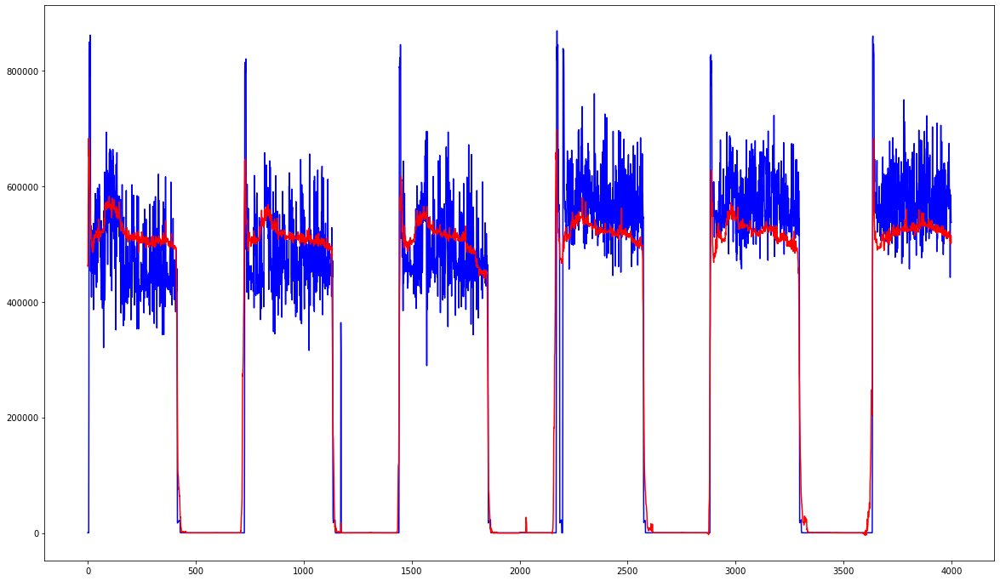

<Figure size 432x288 with 0 Axes>

In [37]:
plt.figure(figsize=(20,12))
t = np.arange(len(pred))
plt.plot(t, y_test, 'b')
plt.plot(t, pred, 'r') # plotting t, a separately 
 # plotting t, b separately 
#plt.plot(t, c, 'g') # plotting t, c separately 
plt.show()
#plt.plot(pred, y_test)
plt.savefig('anom.png')

In [430]:
ans = y_test - pred
print(ans.mean())

23006.925687823652


In [32]:
pred = model.predict(X[109855 - 6000:109855])

In [33]:
MAE(y[109855 - 6000:109855], pred)

42340.13748710477

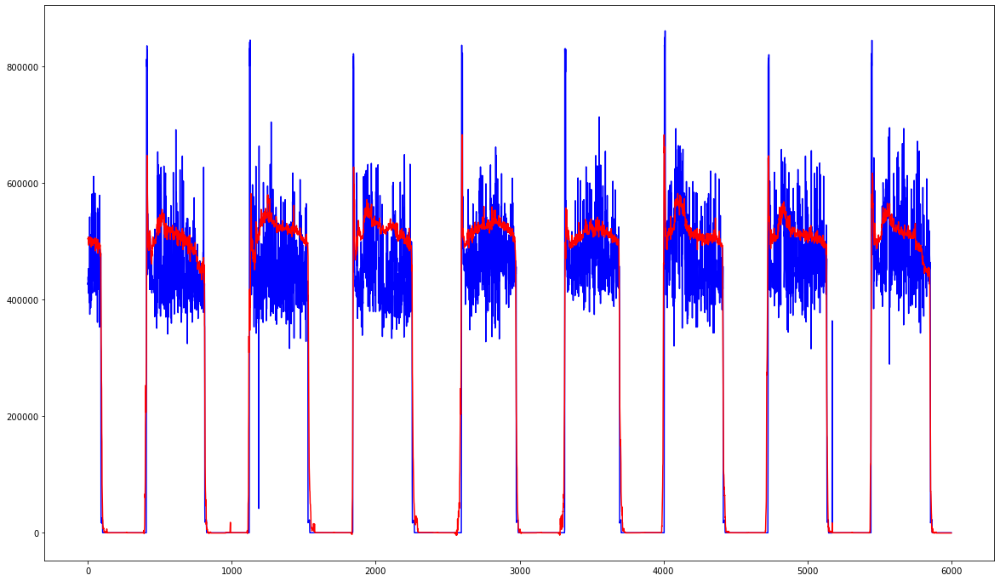

<Figure size 432x288 with 0 Axes>

In [34]:
plt.figure(figsize=(20,12))
t = np.arange(len(pred))
#plt.plot(t, pred, 'r') # plotting t, a separately 
plt.plot(t, y[109855 - 6000:109855], 'b') # plotting t, b separately 
plt.plot(t, pred, 'r')
#plt.plot(t, c, 'g') # plotting t, c separately 
plt.show()
#plt.plot(pr
plt.savefig('norm.png')

In [432]:
ans = y[109855 - 6000:109855] - pred
print(ans.mean())

-12884.77733639795


In [415]:
AP_mean_true = []
df.minute[np.where(df.minute % 2 != 0)[0]] -= 1
st_hour = np.where(df.minute[109855: 109855 + 4000] % 60 == 0)[0]
print(len(st_hour))
y_h = y[109855: 109855 + 4000]
for i in range(1, len(st_hour)):
    for j in range(st_hour[i - 1], st_hour[i]):
        AP_mean_true.append(np.mean(y_h[st_hour[i - 1]: st_hour[i]]))

134


In [416]:
AP_mean_pred = []
st_hour = np.where(df.minute[109855: 109855 + 4000] % 60 == 0)[0]
print(len(st_hour))
for i in range(1, len(st_hour)):
    for j in range(st_hour[i - 1], st_hour[i]):
        AP_mean_pred.append(np.mean(pred[st_hour[i - 1]: st_hour[i]]))
print(len(AP_mean_true), len(AP_mean_pred))

134
3990 3990


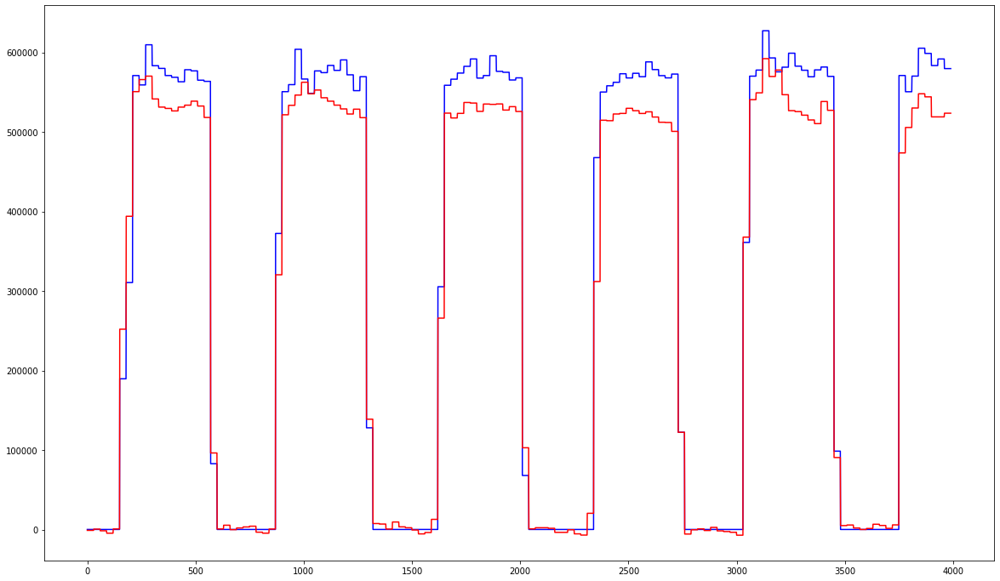

In [417]:
plt.figure(figsize=(20,12))
t = np.arange(len(AP_mean_true))
#plt.plot(t, pred, 'r') # plotting t, a separately 
plt.plot(t, AP_mean_true, 'b') # plotting t, b separately 
plt.plot(t, AP_mean_pred, 'r')
#plt.plot(t, c, 'g') # plotting t, c separately 
plt.show()

22823.704703078496


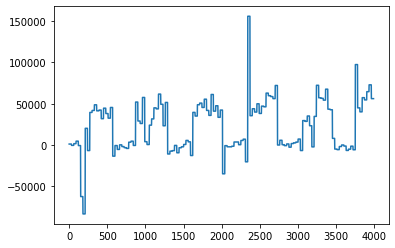

In [428]:
ans = np.array(AP_mean_true) - np.array(AP_mean_pred)
print(ans.mean())
plt.plot(ans)

In [222]:

AP = np.concatenate((np.array(AP_mean)[:, np.newaxis], np.array(df.minute[:118332])[:, np.newaxis]), axis=1)#np.arange(len(AP_mean))[:, np.newaxis]), axis=1)

In [223]:
len(AP)

118332

In [375]:
km = KMeans(n_clusters=4).fit(AP[35000:50000])
pred = km.labels_#[:10000]

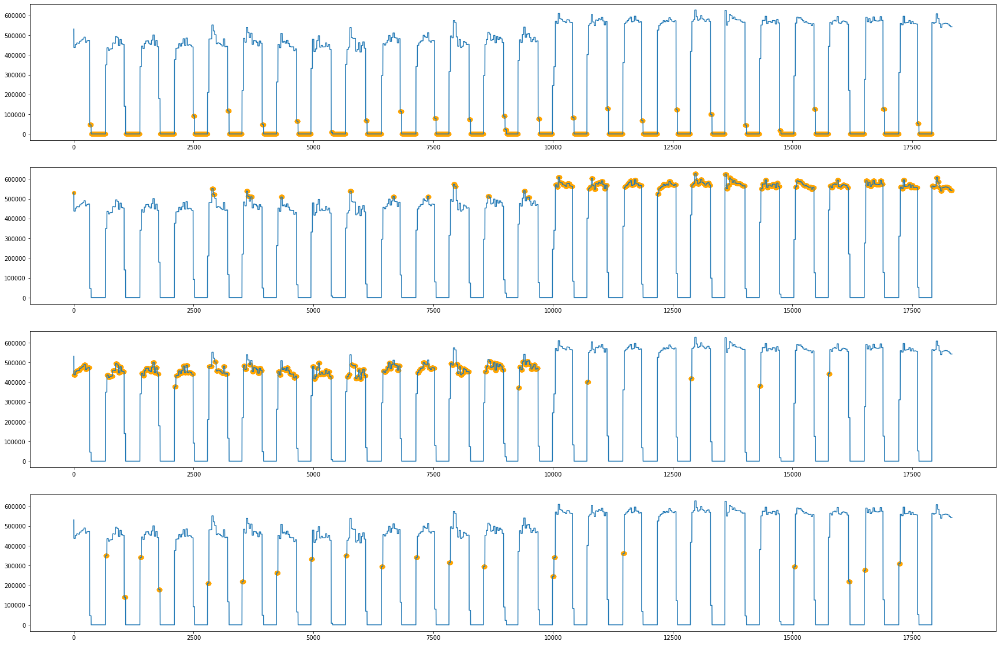

In [241]:
delta = 5000
#pred = pred[100000:]
X = AP[100000:, 0]
#X = X[:10000]
target = pred[100000:]
y = np.arange(len(X))
plt.figure(figsize=(30,20))
plt.subplot(4, 1, 1)
plt.plot(y, X)
plt.scatter(y[np.where(target == 0)], X[np.where(target == 0)], color='orange', s=40, marker='o')

plt.subplot(4, 1, 2)
plt.plot(y, X)
plt.scatter(y[np.where(target == 1)], X[np.where(target == 1)], color='orange', s=40, marker='o')

plt.subplot(4, 1, 3)
plt.plot(y,X)
plt.scatter(y[np.where(target == 2)], X[np.where(target == 2)], color='orange', s=40, marker='o')

plt.subplot(4, 1, 4)
plt.plot(y,X)
plt.scatter(y[np.where(target == 3)], X[np.where(target == 3)], color='orange', s=40, marker='o')

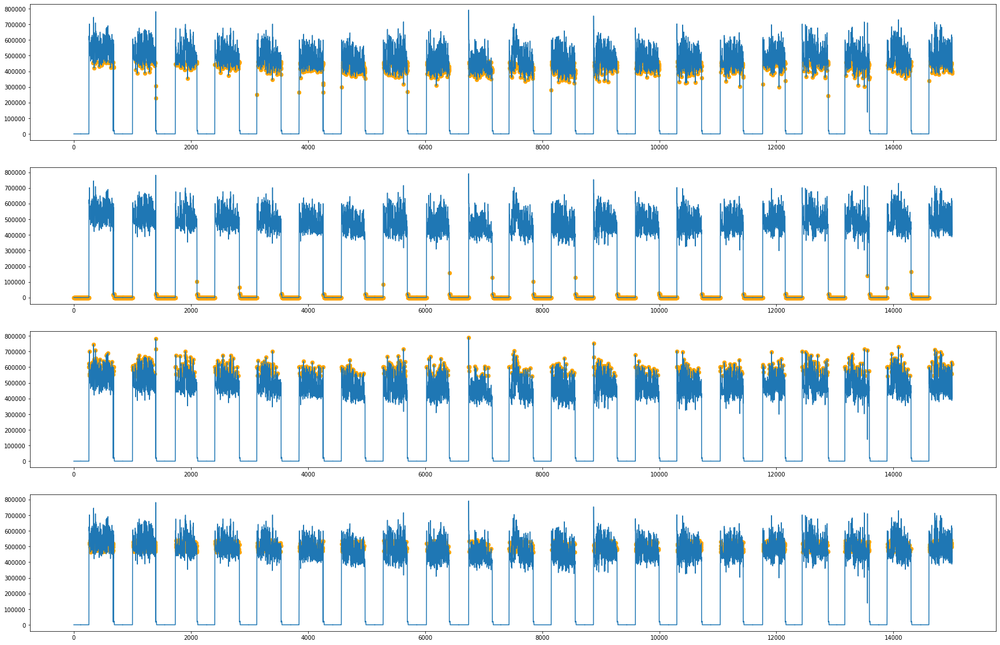

In [376]:
delta = 5000
X = AP[35000:50000, 0]
#X = X[:10000]
y = np.arange(len(X))
target = pred#[35000:50000]
plt.figure(figsize=(30,20))
plt.subplot(4, 1, 1)
plt.plot(y, X)
plt.scatter(y[np.where(target == 0)], X[np.where(target == 0)], color='orange', s=40, marker='o')

plt.subplot(4, 1, 2)
plt.plot(y, X)
plt.scatter(y[np.where(target == 1)], X[np.where(target == 1)], color='orange', s=40, marker='o')

plt.subplot(4, 1, 3)
plt.plot(y,X)
plt.scatter(y[np.where(target == 2)], X[np.where(target == 2)], color='orange', s=40, marker='o')

plt.subplot(4, 1, 4)
plt.plot(y,X)
plt.scatter(y[np.where(target == 3)], X[np.where(target == 3)], color='orange', s=40, marker='o')

In [299]:
AP_mean = np.array(AP_mean)
h = AP_mean#[100000:]
lab_0 = h[np.where(pred == 0)]
lab_1 = h[np.where(pred == 1)]
lab_2 = h[np.where(pred == 2)]
lab_3 = h[np.where(pred == 3)]
lab_mean = np.array([np.mean(lab_0), np.mean(lab_1), np.mean(lab_2), np.mean(lab_3)])
print(np.mean(lab_0), np.mean(lab_1), np.mean(lab_2), np.mean(lab_3))

299495.02647776075 252905.26242364934 374743.957407352 419296.7184703872


In [300]:
zer = np.argmin(lab_mean)
anom = np.argmax(lab_mean)
print(zer, anom)

1 3


In [261]:
prev = -1
st = []
end = []
for j, i in enumerate(df.week_day):
    if i != prev:
        st.append(j)
        end.append(j - 1)
        prev = i

In [273]:
st

[0,
 672,
 1389,
 2106,
 2823,
 3540,
 4258,
 4974,
 5691,
 6409,
 7127,
 7845,
 8563,
 9280,
 9995,
 10715,
 11432,
 12150,
 12868,
 13585,
 14302,
 15020,
 15737,
 16455,
 17172,
 17886,
 18603,
 19321,
 20036,
 20754,
 21471,
 22186,
 22904,
 23621,
 24339,
 25056,
 25773,
 26490,
 27207,
 27924,
 28642,
 29360,
 30077,
 30794,
 31512,
 32229,
 32947,
 33665,
 34383,
 35100,
 35818,
 36535,
 37253,
 37970,
 38688,
 39406,
 40124,
 40841,
 41558,
 42276,
 42993,
 43710,
 44428,
 45144,
 45861,
 46579,
 47296,
 48014,
 48732,
 49450,
 50167,
 50885,
 51602,
 52319,
 53037,
 53754,
 54472,
 55189,
 55907,
 56624,
 57342,
 58060,
 58778,
 59495,
 60212,
 60930,
 61648,
 62366,
 63084,
 63801,
 64518,
 65235,
 65952,
 66669,
 67386,
 68103,
 68821,
 69539,
 70259,
 70979,
 71699,
 72419,
 73138,
 73858,
 74578,
 75298,
 76018,
 76739,
 77459,
 78179,
 78899,
 79619,
 80338,
 81058,
 81778,
 82498,
 83218,
 83938,
 84658,
 85378,
 86098,
 86816,
 87536,
 88256,
 88976,
 89696,
 90416,
 91

In [265]:
len(end)

165

In [266]:
st[164]

117775

In [267]:
len(AP_mean)

118332

In [269]:
end[:-1] = end[1:]

In [352]:
km = KMeans(n_clusters=4).fit(AP[35000:50000])
pred = km.labels_

In [274]:
for i in range(len(st)):
    day = pred[st[i] : end[i]]
    print(np.where(day == 0)[0].shape, np.where(day == 1)[0].shape, np.where(day == 2)[0].shape, np.where(day == 3)[0].shape)

(251,) (390,) (0,) (30,)
(296,) (360,) (0,) (60,)
(296,) (360,) (0,) (60,)
(296,) (390,) (0,) (30,)
(266,) (390,) (0,) (60,)
(267,) (390,) (30,) (30,)
(296,) (389,) (0,) (30,)
(296,) (390,) (0,) (30,)
(327,) (390,) (0,) (0,)
(297,) (360,) (30,) (30,)
(267,) (390,) (0,) (60,)
(267,) (390,) (0,) (60,)
(296,) (390,) (0,) (30,)
(266,) (358,) (60,) (30,)
(269,) (390,) (0,) (60,)
(296,) (360,) (30,) (30,)
(327,) (330,) (60,) (0,)
(297,) (270,) (150,) (0,)
(296,) (390,) (0,) (30,)
(296,) (330,) (60,) (30,)
(267,) (210,) (210,) (30,)
(266,) (270,) (120,) (60,)
(297,) (120,) (270,) (30,)
(296,) (300,) (90,) (30,)
(296,) (387,) (30,) (0,)
(296,) (360,) (60,) (0,)
(297,) (300,) (120,) (0,)
(296,) (298,) (90,) (30,)
(267,) (390,) (30,) (30,)
(296,) (360,) (0,) (60,)
(326,) (300,) (60,) (28,)
(297,) (240,) (180,) (0,)
(266,) (330,) (60,) (60,)
(297,) (270,) (120,) (30,)
(296,) (390,) (0,) (30,)
(296,) (390,) (0,) (30,)
(296,) (360,) (30,) (30,)
(326,) (360,) (30,) (0,)
(296,) (390,) (30,) (0,)
(267

In [372]:
AP = np.concatenate((np.array(df.total_AP_max)[:, np.newaxis], np.array(df.minute)[:, np.newaxis]), axis=1)#np.arange(len(AP_mean))[:, np.newaxis]), axis=1)

In [377]:
WS = 12000
step = 720
ans = np.zeros(len(AP))
for i in range(0, len(AP) - WS, step):
    print(i, i + 10000)
    curr_AP = AP[i:i  + WS]
    km = KMeans(n_clusters=4).fit(curr_AP)
    pred = km.labels_
    lab_0 = curr_AP[np.where(pred == 0)]
    lab_1 = curr_AP[np.where(pred == 1)]
    lab_2 = curr_AP[np.where(pred == 2)]
    lab_3 = curr_AP[np.where(pred == 3)]
    lab_mean = np.array([np.mean(lab_0), np.mean(lab_1), np.mean(lab_2), np.mean(lab_3)])
    zer = np.argmin(lab_mean)
    anom = np.argmax(lab_mean)
    lens = []
    for j in range(4):
        if np.where(pred == j)[0].shape[0] < 200:
            lens.append(j)
    if len(lens) > 1:
        continue
    help = np.zeros(WS)
    help[np.where(pred == anom)] += 1
    ans[i:i  + WS] += help

0 10000
720 10720
1440 11440
2160 12160
2880 12880
3600 13600
4320 14320
5040 15040
5760 15760
6480 16480
7200 17200
7920 17920
8640 18640
9360 19360
10080 20080
10800 20800
11520 21520
12240 22240
12960 22960
13680 23680
14400 24400
15120 25120
15840 25840
16560 26560
17280 27280
18000 28000
18720 28720
19440 29440
20160 30160
20880 30880
21600 31600
22320 32320
23040 33040
23760 33760
24480 34480
25200 35200
25920 35920
26640 36640
27360 37360
28080 38080
28800 38800
29520 39520
30240 40240
30960 40960
31680 41680
32400 42400
33120 43120
33840 43840
34560 44560
35280 45280
36000 46000
36720 46720
37440 47440
38160 48160
38880 48880
39600 49600
40320 50320
41040 51040
41760 51760
42480 52480
43200 53200
43920 53920
44640 54640
45360 55360
46080 56080
46800 56800
47520 57520
48240 58240
48960 58960
49680 59680
50400 60400
51120 61120
51840 61840
52560 62560
53280 63280
54000 64000
54720 64720
55440 65440
56160 66160
56880 66880
57600 67600
58320 68320
59040 69040
59760 69760
60480 7048

In [344]:
len(np.where(ans > 4)[0])

2412

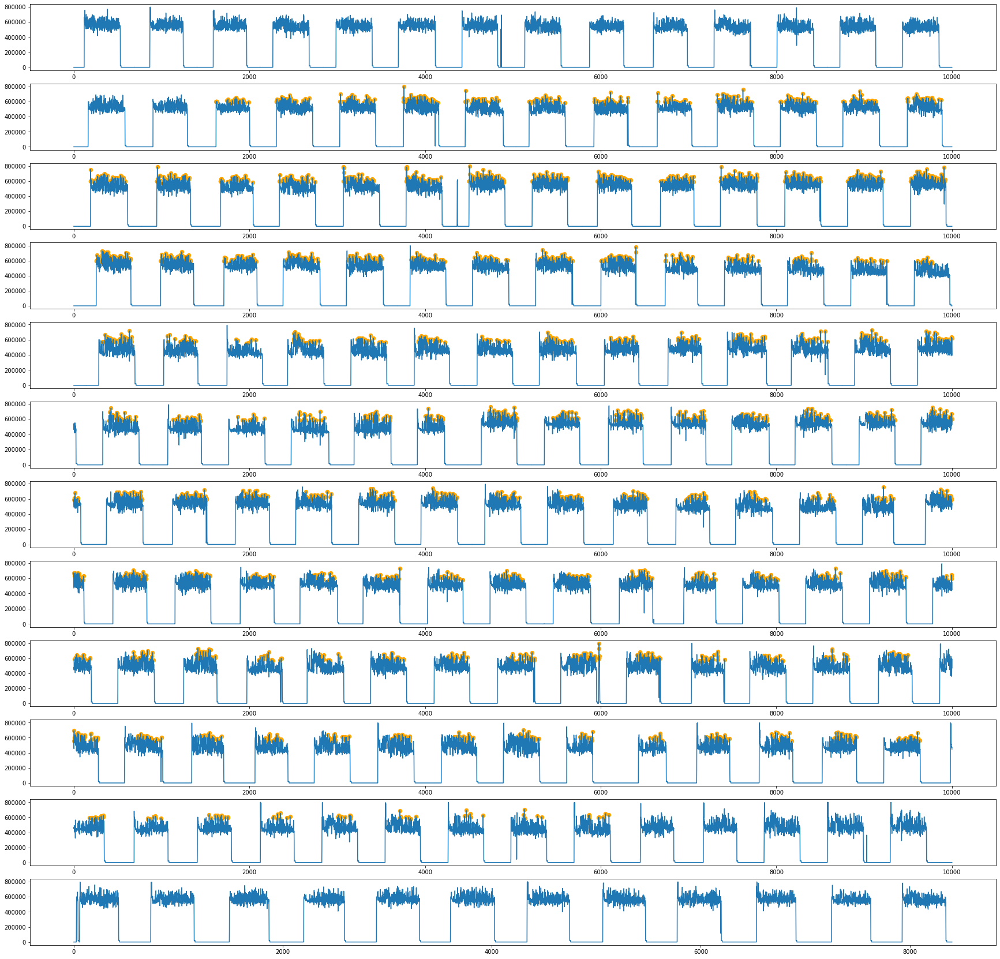

In [379]:
delta = 10000
thr = 16
X1 = AP[:delta, 0]
X2 = AP[delta:2*delta, 0]
X3 = AP[2*delta:3*delta, 0]
X4 = AP[3*delta:4*delta, 0]
X5 = AP[4*delta:5*delta, 0]
X6 = AP[5*delta:6*delta, 0]
X7 = AP[6*delta:7*delta, 0]
X8 = AP[7*delta:8*delta, 0]
X9 = AP[8*delta:9*delta, 0]
X10 = AP[9*delta:10*delta, 0]
X11 = AP[10*delta:11*delta, 0]
X12 = AP[11*delta:len(AP), 0]
#X13 = AP[12*delta:13*delta, 0]
#X = X[:10000]
k = 12
y = np.arange(delta)
y12 = np.arange(8405)
target = pred#[35000:50000]
plt.figure(figsize=(30,30))
plt.subplot(k, 1, 1)
plt.plot(y, X1)
plt.scatter(y[np.where(ans[:delta] > thr)], X1[np.where(ans[:delta] > thr)], color='orange', s=40, marker='o')

plt.subplot(k, 1, 2)
plt.plot(y, X2)
plt.scatter(y[np.where(ans[delta:2*delta] > thr)], X2[np.where(ans[delta:2*delta] > thr)], color='orange', s=40, marker='o')

plt.subplot(k, 1, 3)
plt.plot(y,X3)
plt.scatter(y[np.where(ans[2*delta:3*delta] > thr)], X3[np.where(ans[2*delta:3*delta] > thr)], color='orange', s=40, marker='o')

plt.subplot(k, 1, 4)
plt.plot(y,X4)
plt.scatter(y[np.where(ans[3*delta:4*delta] > thr)], X4[np.where(ans[3*delta:4*delta] > thr)], color='orange', s=40, marker='o')

plt.subplot(k, 1, 5)
plt.plot(y,X5)
plt.scatter(y[np.where(ans[4*delta:5*delta] > thr)], X5[np.where(ans[4*delta:5*delta] > thr)], color='orange', s=40, marker='o')

plt.subplot(k, 1, 6)
plt.plot(y,X6)
plt.scatter(y[np.where(ans[5*delta:6*delta] > thr)], X6[np.where(ans[5*delta:6*delta] > thr)], color='orange', s=40, marker='o')

plt.subplot(k, 1, 7)
plt.plot(y,X7)
plt.scatter(y[np.where(ans[6*delta:7*delta] > thr)], X7[np.where(ans[6*delta:7*delta] > thr)], color='orange', s=40, marker='o')

plt.subplot(k, 1, 8)
plt.plot(y,X8)
plt.scatter(y[np.where(ans[7*delta:8*delta] > thr)], X8[np.where(ans[7*delta:8*delta] > thr)], color='orange', s=40, marker='o')


plt.subplot(k, 1, 9)
plt.plot(y,X9)
plt.scatter(y[np.where(ans[8*delta:9*delta] > thr)], X9[np.where(ans[8*delta:9*delta] > thr)], color='orange', s=40, marker='o')

plt.subplot(k, 1, 10)
plt.plot(y,X10)
plt.scatter(y[np.where(ans[9*delta:10*delta] > thr)], X10[np.where(ans[9*delta:10*delta] > thr)], color='orange', s=40, marker='o')

plt.subplot(k, 1, 11)
plt.plot(y,X11)
plt.scatter(y[np.where(ans[10*delta:11*delta] > thr)], X11[np.where(ans[10*delta:11*delta] > thr)], color='orange', s=40, marker='o')

plt.subplot(k, 1, 12)
plt.plot(y12,X12)
plt.scatter(y12[np.where(ans[11*delta:12*delta] > thr)], X12[np.where(ans[11*delta:12*delta] > thr)], color='orange', s=40, marker='o')

# plt.subplot(k, 1, 13)
# plt.plot(y,X13)
# plt.scatter(y[np.where(ans[12*delta:13*delta] > thr)], X13[np.where(ans[12*delta:13*delta] > thr)], color='orange', s=40, marker='o')

In [378]:
ans.max()

17.0

In [354]:
df.total_AP_max.max()

1748489.999998128

In [371]:
for i in np.where(df.total_AP_max > 800000)[0]:
    print(i)
    df.total_AP_max[i] = 600000

120
121
122
123
124
125
867
868
870
872
1589
1590
1591
1592
1593
1594
2268
2269
2270
2271
2272
2273
2274
2986
2987
2988
2989
2990
2991
2992
3696
3697
3698
3699
3700
3701
3702
4422
4423
4424
4425
4426
4427
4559
5136
5137
5138
5139
5140
5141
5142
5874
5875
5876
5877
5878
5879
5880
6600
6601
6602
6603
6604
6605
7292
7293
7294
7295
7296
7297
7704
8008
8009
8010
8011
8012
8013
8014
8725
8726
8727
8728
8729
8730
9435
9436
9437
9438
9439
9440
9441
9747
10164
10165
10166
10167
10168
10169
10170
10903
10904
10905
10906
10907
10908
11620
11621
11622
11623
11624
11625
11626
12307
12308
12309
12310
12311
12312
12313
13030
13031
13032
13033
13034
13035
13755
13756
13757
13758
13760
14117
14458
14459
14460
14461
14462
14463
15185
15186
15187
15188
15189
15190
15191
15924
15925
15926
15927
15928
15929
16307
16308
16645
16646
16647
16648
16649
16650
17328
17329
17330
17331
17332
17333
17688
17693
17697
18046
18047
18048
18049
18050
18051
18052
18758
18759
18760
18761
18762
18763
18764
19492
19493
1949

In [366]:
print(df.total_AP_max[867:877])
print(df.minute[867:877])

867    824779.999995
868    826499.999996
869    797860.000006
870    848050.000001
871    789949.999991
872    838820.000004
873    790680.000006
874    556979.999994
875    619200.000001
876    570060.000013
Name: total_AP_max, dtype: float64
867    397.0
868    399.0
869    401.0
870    403.0
871    405.0
872    407.0
873    409.0
874    411.0
875    413.0
876    415.0
Name: minute, dtype: float64


# SVD

In [41]:
X = np.array(df[df.columns[2]])
X = X[109855 - 720 * 9: 109855]
y = np.array(df[df.columns[2]])
X_train = np.zeros((720, 9))
y_train = np.zeros((720, 1))
X_test = np.zeros((720, 3))
y_test = np.zeros((720, 1))
print(len(X))
h = 0
h_b = 0
for i in range(0, len(X), 720):
    print(h)
    for k, j in enumerate(X[i:i + 720]):
        #print(j)
        X_train[k, h ] = j
        #A[k, h + 1] = j[1]
    
    
    h += 1
X = X[109855 - 720: 109855 +720 * 2]
h = 0
h_b = 0
for i in range(0, len(X), 720):
    print(h)
    for k, j in enumerate(X[i:i + 720]):
        X_test[k, h ] = j 
    h += 1
#A = np.array(A)
print(X_train)

6480
0
1
2
3
4
5
6
7
8
[[319.99999192 330.00000985 320.00000647 ... 320.00000647 330.00000985
  330.00000985]
 [350.00000207 309.99997398 339.99999869 ... 319.99997736 319.99999192
  329.9999953 ]
 [329.9999953  330.00002441 329.9999953  ... 320.00002102 320.00000647
  329.9999953 ]
 ...
 [329.99998075 329.9999953  339.99999869 ... 329.9999953  310.00000308
  299.9999997 ]
 [330.00002441 339.99999869 349.99998752 ... 330.00000985 329.9999953
  319.99999192]
 [309.99998853 339.99999869 339.99999869 ... 319.99999192 329.9999953
  329.9999953 ]]


In [64]:
U,S,Vt = np.linalg.svd(X_train, full_matrices=False)
sig = S[0]
u1 = U[:, 0]
v1 = Vt[0, :]
print(sig, u1[:, np.newaxis].shape, v1[np.newaxis,: ].shape, Vt.shape, U.shape)
A = sig * u1[:, np.newaxis] @ v1[np.newaxis,: ]

A.shape

28466364.892884865 (720, 1) (1, 9) (9, 9) (720, 9)


(720, 9)

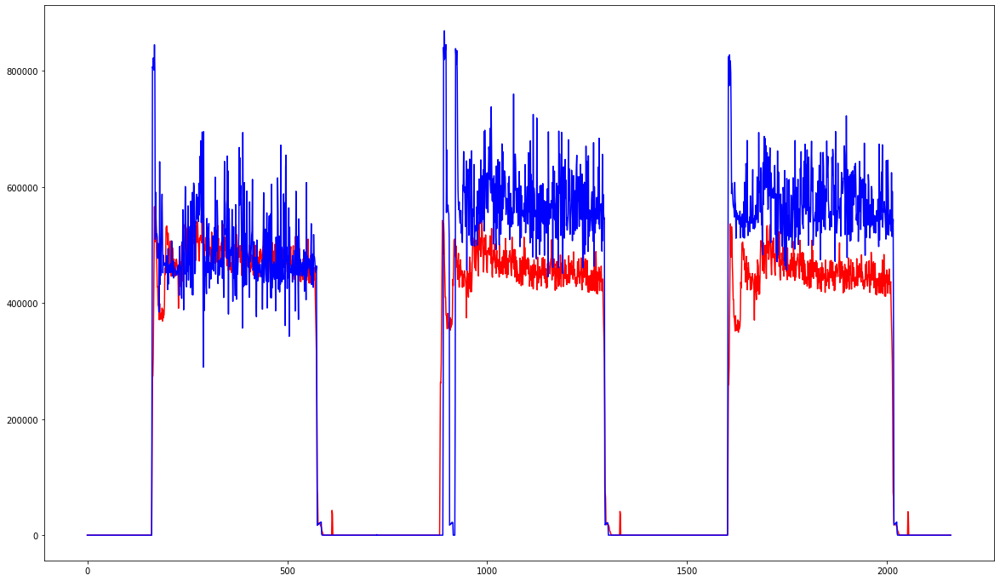

In [73]:
plt.figure(figsize=(20,12))
f = np.concatenate((A[:, 0], A[:, 1], A[:, 2]), axis=0)
t = np.arange(len(f))
plt.plot(t, f, 'r')
plt.plot(t, np.array(df[df.columns[2]])[109855 - 720: 109855 +720 * 2], 'b') # plotting t, b separately 
plt.show()

In [33]:
# load the bostom house data
#data = load_boston(return_X_y=False)

# extract the input data matrix and the targets
A = df[df.columns[2]]#np.concatenate((np.array(df[df.columns[:2]]), np.array(df[df.columns[3:]])), axis=1)
#A = np.array(df[df.columns[:2]])
b = df[df.columns[2]]

# append a columns of 1s (these are the biases)
A = np.column_stack([np.ones(A.shape[0]), A])

# split the data into train and test sets
X_train = A[109855 - 7200: 109855]
X_test = A[109855: 109855 + 720]
y_train = b[109855 - 7200: 109855]
y_test = b[109855: 109855 + 720]

# calculate the economy SVD for the data matrix A
U,S,Vt = np.linalg.svd(X_train, full_matrices=False)
print(U.shape,S.shape,Vt.shape)
print(Vt.T.shape, np.linalg.inv(np.diag(S)).shape, U.T.shape, y_train.shape)
# solve Ax = b for the best possible approximate solution in terms of least squares
x_hat = Vt.T @ np.linalg.inv(np.diag(S)) @ U.T @ y_train

# perform train and test inference
train_predictions = X_train @ x_hat
test_predictions = X_test @ x_hat

# compute train and test MSE
train_mse = np.mean((train_predictions - y_train)**2)
test_mse = np.mean((test_predictions - y_test)**2)

print("Train Mean Squared Error:", train_mse)
print("Test Mean Squared Error:", test_mse)

(7200, 2) (2,) (2, 2)
(2, 2) (2, 2) (2, 7200) (7200,)
Train Mean Squared Error: 4.430553193114683e-18
Test Mean Squared Error: 6.023563794445077e-18


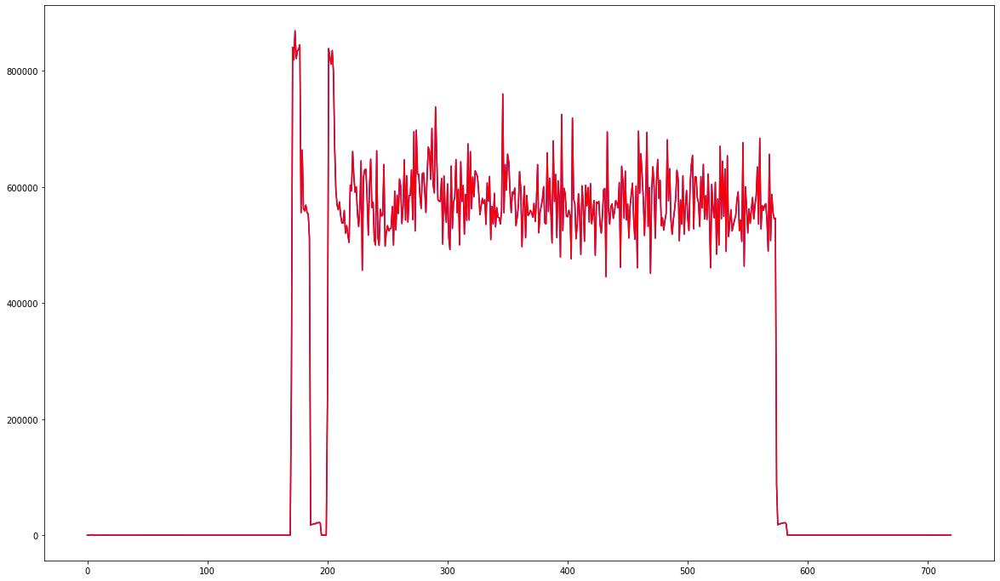

In [34]:
plt.figure(figsize=(20,12))
t = np.arange(len(y_test))
#plt.plot(t, pred, 'r') # plotting t, a separately 
plt.plot(t, y_test, 'b')
plt.plot(t, test_predictions, 'r') # plotting t, b separately 

#plt.plot(t, c, 'g') # plotting t, c separately 
plt.show()

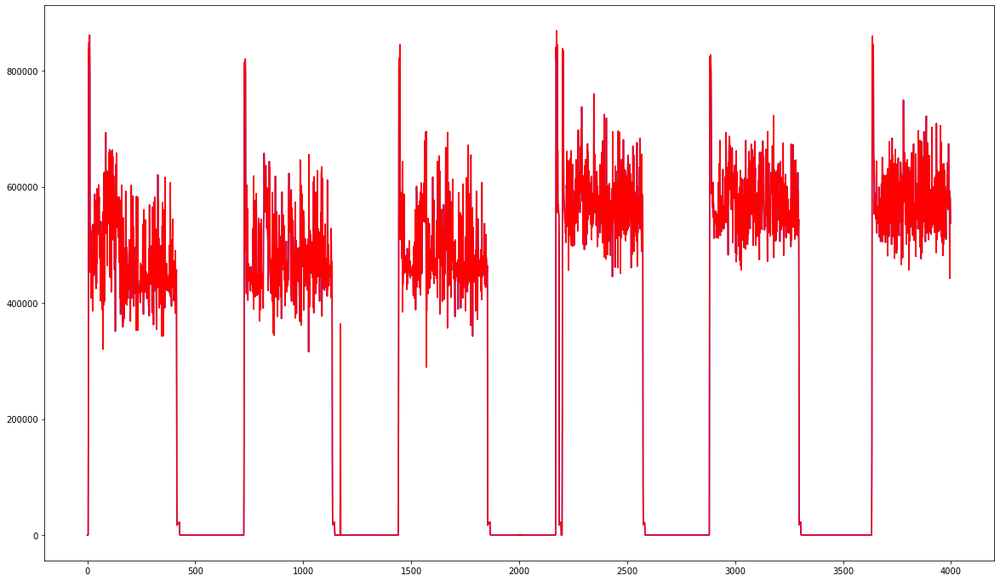

In [30]:
plt.figure(figsize=(20,12))
t = np.arange(len(y_test))
#plt.plot(t, pred, 'r') # plotting t, a separately 
plt.plot(t, y_test, 'b')
plt.plot(t, test_predictions, 'r') # plotting t, b separately 

#plt.plot(t, c, 'g') # plotting t, c separately 
plt.show()

In [16]:
df.corr()

,week_day,minute,total_AP_max,temperature,humidity
week_day,1.000000,0.002124,-0.029702,0.023032,0.052948
minute,0.002124,1.000000,0.056498,0.207711,0.123873
total_AP_max,-0.029702,0.056498,1.000000,0.336000,-0.046677
temperature,0.023032,0.207711,0.336000,1.000000,0.411563
humidity,0.052948,0.123873,-0.046677,0.411563,1.000000


In [18]:
np.concatenate((np.array(df[df.columns[:2]]), np.array(df[df.columns[3:]])), axis=1)

array([[   4.   ,   95.   ,   28.115,   46.58 ],
       [   4.   ,   97.   ,   28.24 ,   45.63 ],
       [   4.   ,   99.   ,   28.24 ,   45.63 ],
       ...,
       [   0.   , 1255.   ,   24.13 ,   23.47 ],
       [   0.   , 1257.   ,   24.13 ,   23.47 ],
       [   0.   , 1259.   ,   24.13 ,   23.47 ]])

In [83]:
#data = load_boston(return_X_y=False)

# extract the input data matrix and the targets
A = df[df.columns[3:]]
b = df[df.columns[2]]

# append a columns of 1s (these are the biases)
A = np.column_stack([np.ones(A.shape[0]), A])

# split the data into train and test sets
X_train = A[109855 - 7200: 109855]
X_test = A[109855: 109855 + 720 * 4]
y_train = b[109855 - 7200: 109855]
y_test = b[109855: 109855 + 720 * 4]
print(A.shape, df.columns[3:], y_train.shape)
# calculate the economy SVD for the data matrix A
U,S,Vt = np.linalg.svd(X_train, full_matrices=False)

# solve Ax = b for the best possible approximate solution in terms of least squares
x_hat = Vt.T @ np.linalg.inv(np.diag(S)) @ U.T @ y_train

# perform train and test inference
y_pred = X_train @ x_hat
test_predictions = X_test @ x_hat

# compute train and test MSE
train_mse = np.mean((y_pred - y_train)**2)
test_mse = np.mean((test_predictions - y_test)**2)

print("Train Mean Squared Error:", train_mse)
print("Test Mean Squared Error:", test_mse)

(118405, 3) Index(['temperature', 'humidity'], dtype='object') (7200,)
Train Mean Squared Error: 27903513361.350903
Test Mean Squared Error: 39753893070.79965


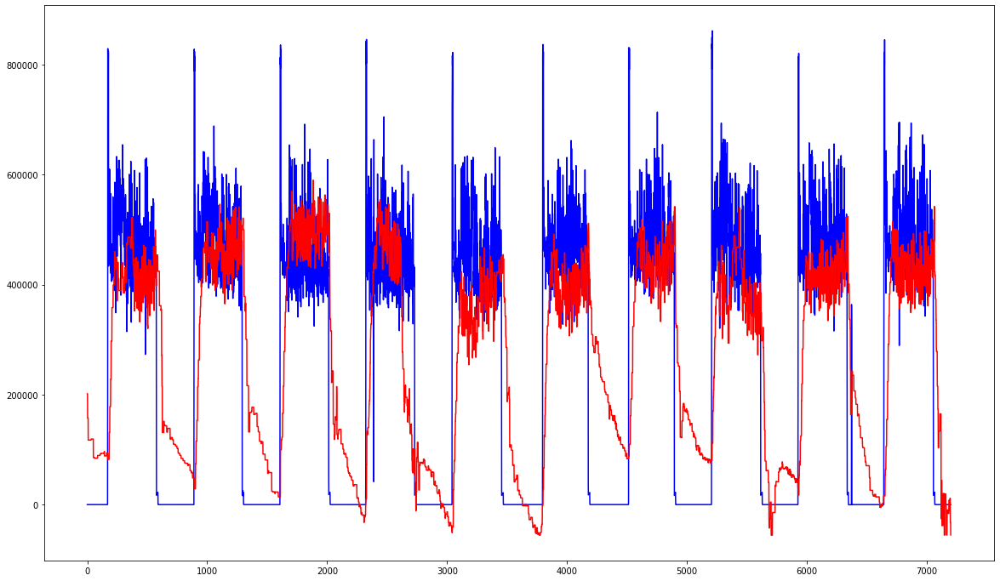

In [88]:
plt.figure(figsize=(20,12))
t = np.arange(len(y_train))
#plt.plot(t, pred, 'r') # plotting t, a separately 
plt.plot(t, y_train, 'b')
plt.plot(t, y_pred, 'r')
 # plotting t, b separately 

#plt.plot(t, c, 'g') # plotting t, c separately 
plt.show()

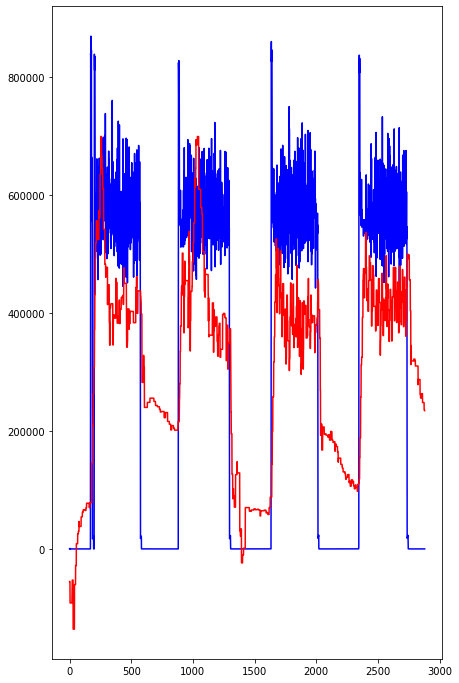

In [92]:
plt.figure(figsize=(7, 12))
t = np.arange(len(test_predictions))
#plt.plot(t, pred, 'r') # plotting t, a separately 
plt.plot(t, y_test, 'b')
plt.plot(t, test_predictions, 'r')
 # plotting t, b separately 

#plt.plot(t, c, 'g') # plotting t, c separately 
plt.show()